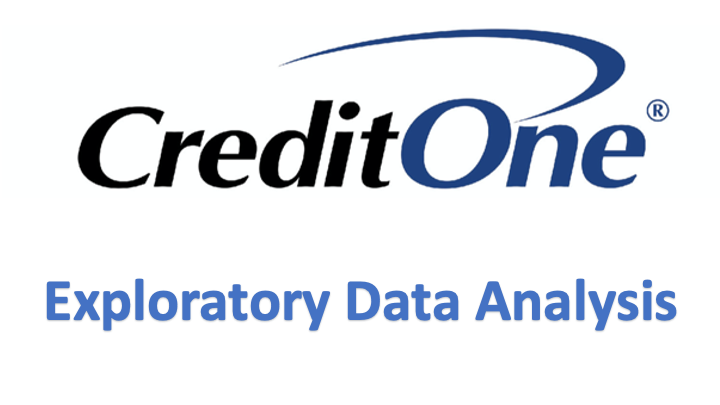

In [1]:
from IPython.display import Image
Image('Credit One EDA.png')

# Importing the Libraries Needed

In [110]:
import pandas as pd
import matplotlib as mtplb
import matplotlib.pyplot as plt
import seaborn as sns
import math as mt
import statistics as sts
import scipy.stats as scpsts
import numpy as np

# Reading in the Dataset

In [111]:
credit = pd.read_csv(r'/Users/michellesmith/Desktop/Data Analytics/Course 5/Task 1/default of credit card clients.csv', header =1)

# Getting Familiar with the Data

In [4]:
credit.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [5]:
credit.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,...,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,...,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,...,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,...,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,...,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


In [6]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   ID                          30000 non-null  int64
 1   LIMIT_BAL                   30000 non-null  int64
 2   SEX                         30000 non-null  int64
 3   EDUCATION                   30000 non-null  int64
 4   MARRIAGE                    30000 non-null  int64
 5   AGE                         30000 non-null  int64
 6   PAY_0                       30000 non-null  int64
 7   PAY_2                       30000 non-null  int64
 8   PAY_3                       30000 non-null  int64
 9   PAY_4                       30000 non-null  int64
 10  PAY_5                       30000 non-null  int64
 11  PAY_6                       30000 non-null  int64
 12  BILL_AMT1                   30000 non-null  int64
 13  BILL_AMT2                   30000 non-null  int64
 14  BILL_A

# Preprocessing the Dataset

## Updating the Data in Education "Other" Category to be the Same Value

In [112]:
credit['EDUCATION'].replace({0: 4, 5: 4, 6: 4}, inplace=True)

## Renaming the 'default payment next month' Attribute

In [113]:
credit = credit.rename(columns = {"default payment next month": "RISK_OF_DEFAULT"}) 

In [114]:
credit

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,1,3,1,39,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,1,3,2,43,-1,-1,-1,-1,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,1,2,2,37,4,3,2,-1,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,1,3,1,41,1,-1,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


## Calculating a Correllation Matrix & Graphing it Using a Heat Map

In [115]:
corrMatrix = credit.corr()
print('\n')
print(corrMatrix)



                       ID  LIMIT_BAL       SEX  EDUCATION  MARRIAGE       AGE  \
ID               1.000000   0.026179  0.018497   0.037659 -0.029079  0.018678   
LIMIT_BAL        0.026179   1.000000  0.024755  -0.231088 -0.108139  0.144713   
SEX              0.018497   0.024755  1.000000   0.013627 -0.031389 -0.090874   
EDUCATION        0.037659  -0.231088  0.013627   1.000000 -0.149134  0.182434   
MARRIAGE        -0.029079  -0.108139 -0.031389  -0.149134  1.000000 -0.414170   
AGE              0.018678   0.144713 -0.090874   0.182434 -0.414170  1.000000   
PAY_0           -0.030575  -0.271214 -0.057643   0.112593  0.019917 -0.039447   
PAY_2           -0.011215  -0.296382 -0.070771   0.129703  0.024199 -0.050148   
PAY_3           -0.018494  -0.286123 -0.066096   0.122425  0.032688 -0.053048   
PAY_4           -0.002735  -0.267460 -0.060173   0.116531  0.033122 -0.049722   
PAY_5           -0.022199  -0.249411 -0.055064   0.104088  0.035629 -0.053826   
PAY_6           -0.020270 

In [11]:
corrMatrix.to_csv("/Users/michellesmith/Desktop/Data Analytics/Course 5/Task 2/correlation matrix.csv")

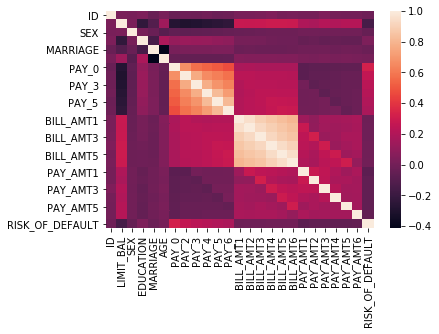

In [116]:
sns.heatmap(corrMatrix)

plt.show()

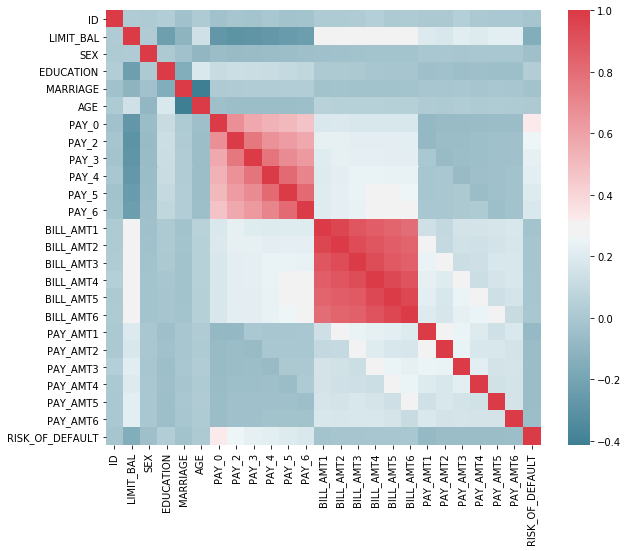

In [117]:
f, ax=plt.subplots(figsize=(10, 8))
sns.heatmap(corrMatrix, mask=np.zeros_like(corrMatrix, dtype=np.bool),cmap=sns.diverging_palette(220, 10, as_cmap=True), square=True, ax=ax)

plt.show()

## Calculating a Covariance Matrix & Graphing it Using a Heat Map

In [118]:
covMatrix = credit.cov()

print(covMatrix)

                           ID     LIMIT_BAL          SEX     EDUCATION  \
ID               7.500250e+07  2.941664e+07    78.356379    242.812194   
LIMIT_BAL        2.941664e+07  1.683446e+10  1571.050630 -22322.227579   
SEX              7.835638e+01  1.571051e+03     0.239247      0.004962   
EDUCATION        2.428122e+02 -2.232223e+04     0.004962      0.554272   
MARRIAGE        -1.314525e+02 -7.323670e+03    -0.008014     -0.057954   
AGE              1.491057e+03  1.730767e+05    -0.409726      1.251988   
PAY_0           -2.975726e+02 -3.954593e+04    -0.031685      0.094202   
PAY_2           -1.162770e+02 -4.603765e+04    -0.041442      0.115604   
PAY_3           -1.916922e+02 -4.443225e+04    -0.038694      0.109088   
PAY_4           -2.769132e+01 -4.057181e+04    -0.034411      0.101430   
PAY_5           -2.178600e+02 -3.667056e+04    -0.030521      0.087814   
PAY_6           -2.018774e+02 -3.509308e+04    -0.024754      0.076186   
BILL_AMT1        1.236447e+07  2.72702

In [15]:
covMatrix.to_csv("/Users/michellesmith/Desktop/Data Analytics/Course 5/Task 2/covariance matrix.csv")

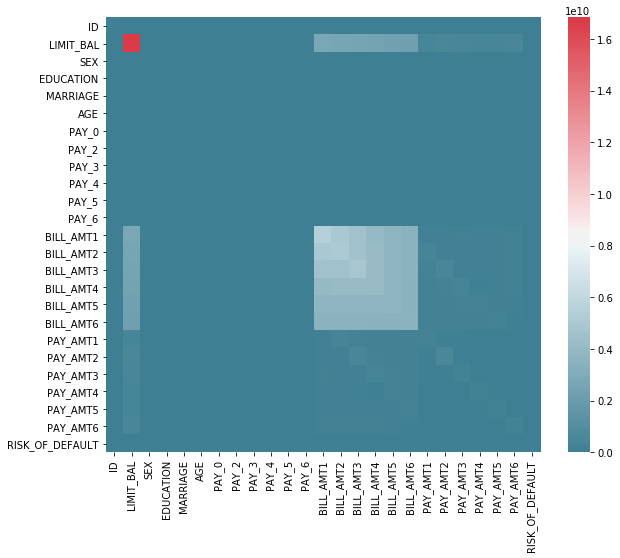

In [119]:
f, ax=plt.subplots(figsize=(10, 8))
sns.heatmap(covMatrix, mask=np.zeros_like(covMatrix, dtype=np.bool),cmap=sns.diverging_palette(220, 10, as_cmap=True), square=True, ax=ax)

plt.show()

## Calculating & Graphing the Variance for Each Attribute

In [120]:
varcredit = np.var(credit)
print(varcredit)

ID                 7.500000e+07
LIMIT_BAL          1.683389e+10
SEX                2.392394e-01
EDUCATION          5.542535e-01
MARRIAGE           2.724432e-01
AGE                8.496692e+01
PAY_0              1.262888e+00
PAY_2              1.433206e+00
PAY_3              1.432444e+00
PAY_4              1.366840e+00
PAY_5              1.284071e+00
PAY_6              1.322427e+00
BILL_AMT1          5.422059e+09
BILL_AMT2          5.065537e+09
BILL_AMT3          4.809177e+09
BILL_AMT4          4.138578e+09
BILL_AMT5          3.696171e+09
BILL_AMT6          3.546574e+09
PAY_AMT1           2.743331e+08
PAY_AMT2           5.308640e+08
PAY_AMT3           3.099948e+08
PAY_AMT4           2.454204e+08
PAY_AMT5           2.334188e+08
PAY_AMT6           3.160278e+08
RISK_OF_DEFAULT    1.722706e-01
dtype: float64


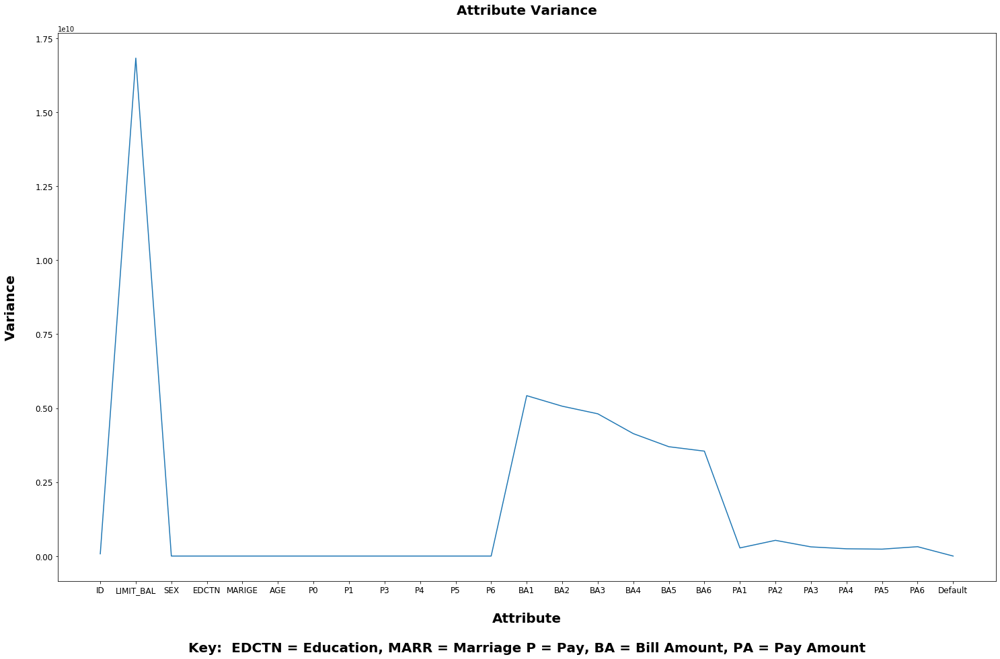

In [121]:
%matplotlib inline
plt.figure(figsize=(25,15))

plt.plot(varcredit)
plt.xticks(np.arange(25), ('ID', 'LIMIT_BAL', 'SEX', 'EDCTN', 'MARIGE', 'AGE', 'P0', 'P1', 'P3', 'P4', 'P5', 'P6', 'BA1', 'BA2', 'BA3', 'BA4', 'BA5', 'BA6', 'PA1', 'PA2', 'PA3', 'PA4', 'PA5', 'PA6', 'Default'))

plt.title("Attribute Variance\n",fontweight = 'bold', fontsize = 20 )
plt.xlabel('\nAttribute\n\nKey:  EDCTN = Education, MARR = Marriage P = Pay, BA = Bill Amount, PA = Pay Amount', fontweight = 'bold', fontsize = 20)
plt.ylabel('Variance\n', fontweight = 'bold', fontsize = 20)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.show()

## Calculating the Number of Unique Values in Each Attribute

In [122]:
credit_unique = credit

In [123]:
from sklearn import datasets
from sklearn.feature_selection import VarianceThreshold
thresholder = VarianceThreshold(threshold=.5)

In [124]:
credit_unique = thresholder.fit_transform(credit_unique)

In [125]:
from numpy import unique
for i in range(credit_unique.shape[1]):
    print(i, len(unique(credit_unique[:, i])))

0 30000
1 81
2 4
3 56
4 11
5 11
6 11
7 11
8 10
9 10
10 22723
11 22346
12 22026
13 21548
14 21010
15 20604
16 7943
17 7899
18 7518
19 6937
20 6897
21 6939




# Please note that the abbreviation "TWD" is used in multiple places in the cells below.  According to Investopedia.com, it is the abbreviation for the currency of the nation of Taiwan referred to as the "new Taiwan dollar".



## Investigating Ways to Discretize the 'LIMIT_BAL' Attribute

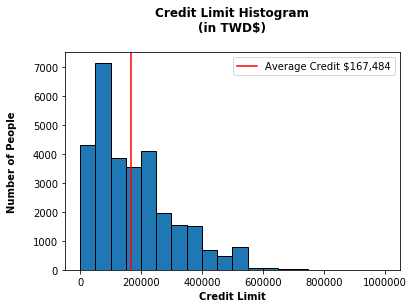

In [126]:
bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000, 550000, 600000, 650000, 700000, 750000, 800000, 850000, 900000, 950000, 1000000]
plt.hist(x=credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('Credit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

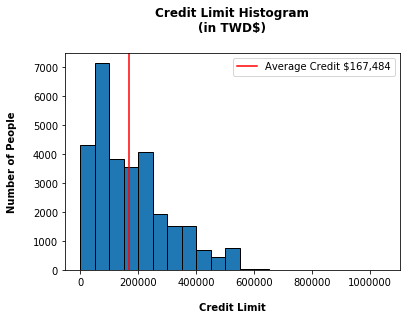

In [127]:
bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000, 550000, 600000, 650000, 700000, 750000, 800000, 850000, 900000, 950000, 1000000, 1050000]
plt.hist(x=credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('\nCredit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

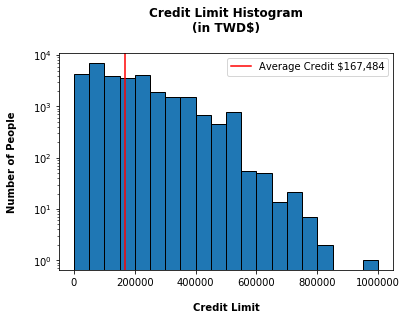

In [128]:
bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000, 550000, 600000, 650000, 700000, 750000, 800000, 850000, 900000, 950000, 1000000]
plt.hist(x=credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000, log = True)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('\nCredit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

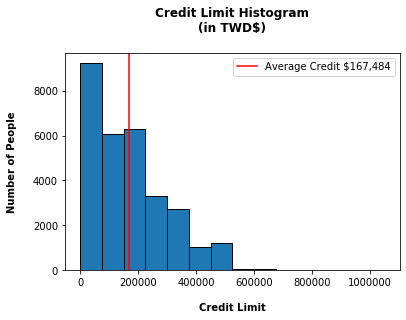

In [129]:
bins = [0, 75000, 150000, 225000, 300000, 375000, 450000, 525000, 600000, 675000, 750000, 825000, 900000, 975000, 1050000]
plt.hist(x=credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('\nCredit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

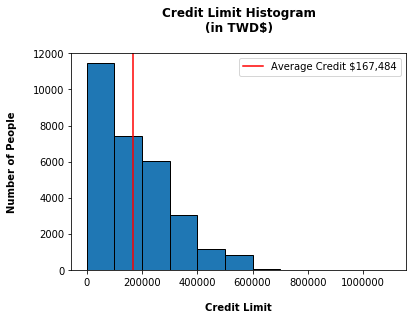

In [130]:
bins = [0, 100000, 200000, 300000, 400000, 500000, 600000, 700000, 800000, 900000, 1100000]
plt.hist(x=credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('\nCredit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

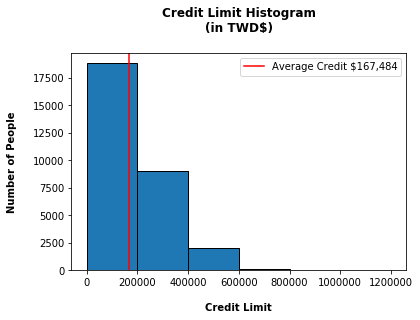

In [131]:
bins = [0, 200000, 400000, 600000, 800000, 1000000,1200000]
plt.hist(x=credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('\nCredit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

In [132]:
binned_credit = credit

In [139]:
pd.set_option("mode.chained_assignment", None)

## Discretizing the 'LIMIT_BAL' Attribute

In [133]:
bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000, 550000, 600000, 650000, 700000, 750000, 800000, 850000, 900000, 950000, 1000000]
bin_names = ["($0, $50K]", "($50K, $100K]", "($100K, $150K]", "($150K, $200K]", "($200K, $250K]", "($250K, $300K]", "($300K, $350K]", "($350K, $400K]", "($400K, $450K]", "($450K, $500K]", "($500K, $550K]", "($550K, $600K]", "($600K, $650K]", "($650K, $700K]", "($700K, $750K]", "($750K, $800K]", "($800K, $850K]", "($850K, $900K]", "($900K $950K]", "($950, $1M]"]

In [134]:
binned_credit['CREDIT_LEVEL'] = pd.cut(binned_credit['LIMIT_BAL'], bins, labels = bin_names)

## Moving the 'CREDIT_LEVEL' Attribute Next to the 'LIMIT_BAL' Attribute

In [135]:
binned_credit = binned_credit[['ID', 'LIMIT_BAL', 'CREDIT_LEVEL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'RISK_OF_DEFAULT']]

In [136]:
binned_credit

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT
0,1,20000,"($0, $50K]",2,2,1,24,2,2,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,"($100K, $150K]",2,2,2,26,-1,2,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,"($50K, $100K]",2,2,2,34,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,"($0, $50K]",2,2,1,37,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,"($0, $50K]",1,2,1,57,-1,0,-1,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,3,1,39,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,"($100K, $150K]",1,3,2,43,-1,-1,-1,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,"($0, $50K]",1,2,2,37,4,3,2,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,"($50K, $100K]",1,3,1,41,1,-1,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


## Adding Capability to Group the Data by the Terms of  "Male" and "Female"

In [140]:
gender_bins = [0, 1, 2]
gender_bins_names = ["MALE", "FEMALE"]

In [141]:
binned_credit['GENDER'] = pd.cut(binned_credit['SEX'], bins = gender_bins, labels = gender_bins_names)

## Moving the 'GENDER' Attribute Next to the 'SEX' Attribute

In [142]:
binned_credit = binned_credit[['ID', 'LIMIT_BAL', 'CREDIT_LEVEL', 'SEX', 'GENDER', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'RISK_OF_DEFAULT']]

In [143]:
binned_credit

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT
0,1,20000,"($0, $50K]",2,FEMALE,2,1,24,2,2,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,"($100K, $150K]",2,FEMALE,2,2,26,-1,2,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,"($50K, $100K]",2,FEMALE,2,2,34,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,"($0, $50K]",2,FEMALE,2,1,37,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,"($0, $50K]",1,MALE,2,1,57,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,1,39,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,"($100K, $150K]",1,MALE,3,2,43,-1,-1,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,"($0, $50K]",1,MALE,2,2,37,4,3,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,"($50K, $100K]",1,MALE,3,1,41,1,-1,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


## Adding Attribute for the Terms Representing the Education Levels

In [144]:
education_bins = [0,1, 2, 3, 4]
education_bins_names = ["GRADUATE SCHOOL", "UNIVERSITY","HIGH SCHOOL", "OTHER"]

In [145]:
binned_credit['ED_GROUP'] = pd.cut(binned_credit['EDUCATION'], bins = education_bins, labels = education_bins_names)

## Moving the 'EDCUATION_GROUP' Attribute Next to the 'EDUCATION' Attribute

In [146]:
binned_credit = binned_credit[['ID', 'LIMIT_BAL', 'CREDIT_LEVEL', 'SEX', 'GENDER', 'EDUCATION', 'ED_GROUP', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'RISK_OF_DEFAULT']]

In [147]:
binned_credit

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,AGE,PAY_0,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,24,2,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,26,-1,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,34,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,37,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,57,-1,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,39,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,43,-1,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,37,4,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,41,1,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


## Adding Attribute for the Terms Representing the Marital Status

In [148]:
marriage_bins = [-1, 0, 1, 2, 3]
marriage_bins_names = ["OTHER", "MARRIED","SINGLE", "DIVORCED"]

In [149]:
binned_credit['MARR_GROUP'] = pd.cut(binned_credit['MARRIAGE'], bins = marriage_bins, labels = marriage_bins_names)

## Moving the 'MARRIAGE_GROUP' Attribute Next to the 'MARRIAGE' Attribute

In [150]:
binned_credit = binned_credit[['ID', 'LIMIT_BAL', 'CREDIT_LEVEL', 'SEX', 'GENDER', 'EDUCATION', 'ED_GROUP', 'MARRIAGE', 'MARR_GROUP', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'RISK_OF_DEFAULT']]

In [151]:
binned_credit

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,SINGLE,37,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,41,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


## Discretizing the 'AGE' Attribute

In [154]:
age_bins = [18, 35, 55, 72, 100]
age_class = ['YOUNG ADULT', 'MIDDLE AGE', 'OLDER ADULT', 'SENIOR CITIZEN']

In [155]:
binned_credit['AGE_GROUP'] = pd.cut(binned_credit['AGE'], bins = age_bins, labels = age_class)

## Moving the 'AGE_GROUP' Attribute Next to the 'AGE' Attribute

In [156]:
binned_credit = binned_credit[['ID', 'LIMIT_BAL', 'CREDIT_LEVEL', 'SEX', 'GENDER', 'EDUCATION', 'ED_GROUP', 'MARRIAGE', 'MARR_GROUP', 'AGE', 'AGE_GROUP', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'RISK_OF_DEFAULT']]

In [157]:
binned_credit

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,SINGLE,37,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,41,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


## Adding Attribute Representing Default Risk

In [158]:
risk_bins = [-1, 0, 1]
risk_bins_names = ["NO", "YES"]

In [159]:
binned_credit['DEFAULT_RISK'] = pd.cut(binned_credit.RISK_OF_DEFAULT, bins = risk_bins, labels = risk_bins_names)

In [160]:
binned_credit

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,689,0,0,0,0,1,YES
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3455,3261,0,1000,1000,1000,0,2000,1,YES
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14948,15549,1518,1500,1000,1000,1000,5000,0,NO
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28959,29547,2000,2019,1200,1100,1069,1000,0,NO
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,19146,19131,2000,36681,10000,9000,689,679,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,31237,15980,8500,20000,5003,3047,5000,1000,0,NO
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,5190,0,1837,3526,8998,129,0,0,0,NO
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,SINGLE,37,...,20582,19357,0,0,22000,4200,2000,3100,1,YES
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,41,...,11855,48944,85900,3409,1178,1926,52964,1804,1,YES


## Downloading the Processed Dataset as a CSV File to Hard Drvie

In [161]:
binned_credit.to_csv("/Users/michellesmith/Desktop/Data Analytics/Course 5/Task 2/Binned Credit Data-rev5.csv")

## Investigating the Distribution of Three Key Attributes

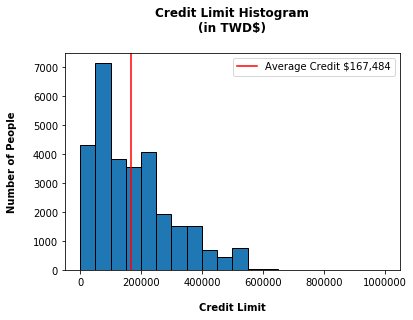

In [162]:
bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000, 550000, 600000, 650000, 700000, 750000, 800000, 850000, 900000, 950000, 1000000]
plt.hist(x=binned_credit.LIMIT_BAL, bins = bins, edgecolor = 'black', rwidth = 10000)

mean_credit = 167484
plt.axvline(mean_credit, color='red', label = 'Average Credit $167,484')

plt.xlabel('\nCredit Limit', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Credit Limit Histogram\n(in TWD$)\n', fontweight = 'bold')
plt.legend()

plt.show()

Number of Peopele Not at Risk of Default:  23,364 or 78%
Number of People at Risk of Default:  6,636 or 22%


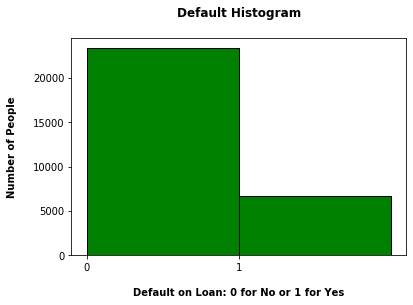

In [163]:
bins2 = [0,1,2]
plt.hist(x=binned_credit.RISK_OF_DEFAULT, bins = bins2, color = 'green', edgecolor = 'black')

plt.xticks(np.arange(0, 2))
plt.xlabel('\nDefault on Loan: 0 for No or 1 for Yes', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Default Histogram\n', fontweight = 'bold')

print('Number of Peopele Not at Risk of Default:  23,364 or 78%\nNumber of People at Risk of Default:  6,636 or 22%')

plt.show()

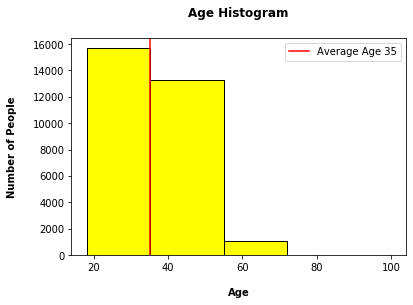

In [164]:
plt.hist(x=binned_credit.AGE, bins = age_bins, color = 'yellow', edgecolor = 'black', rwidth = 10000)

mean_age = 35
plt.axvline(mean_age, color='red', label = 'Average Age 35')

plt.xlabel('\nAge', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Age Histogram\n', fontweight = 'bold')
plt.legend()

plt.show()

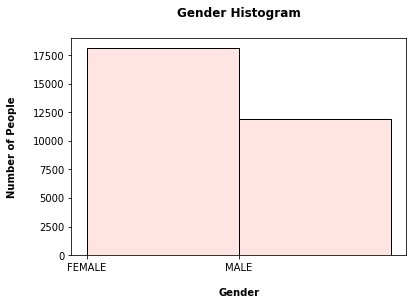

In [165]:
plt.hist(x=binned_credit.GENDER, bins = gender_bins, color = 'mistyrose', edgecolor = 'black', rwidth = 10000)


plt.xlabel('\nGender', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Gender Histogram\n', fontweight = 'bold')


plt.show()

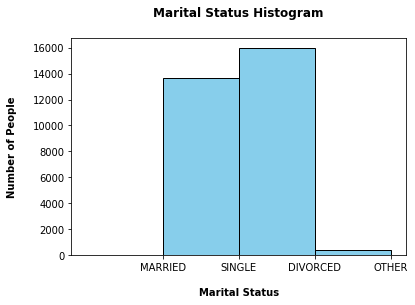

In [166]:
plt.hist(x=binned_credit.MARR_GROUP, bins = marriage_bins, color = 'skyblue', edgecolor = 'black', rwidth = 10000)


plt.xlabel('\nMarital Status', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Marital Status Histogram\n', fontweight = 'bold')

plt.show()

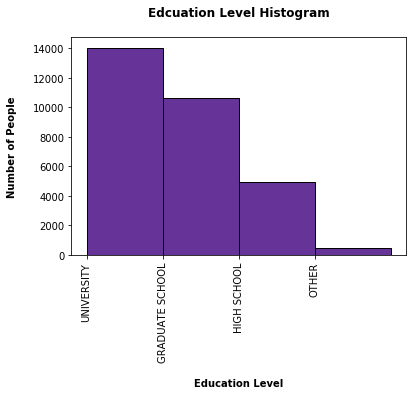

In [167]:
plt.hist(x=binned_credit.ED_GROUP, bins = education_bins, color = 'rebeccapurple', edgecolor = 'black', rwidth = 10000)

plt.xticks(rotation = 90)
plt.xlabel('\nEducation Level', fontweight = 'bold')
plt.ylabel('Number of People\n', fontweight = 'bold')
plt.title('Edcuation Level Histogram\n', fontweight = 'bold')


plt.show()




## *PLEASE NOTE...*

While we may not be able to impact spending behavior, it is being looked at this analysis in order to ascertain whether or not it is the primary reason behind the defaults or if they are equally influenced by other attributes that we can impact.




# Global View of the Dataset Before Subsetting

# Comparison of the Monthly Bill Statements to the Credit Limits

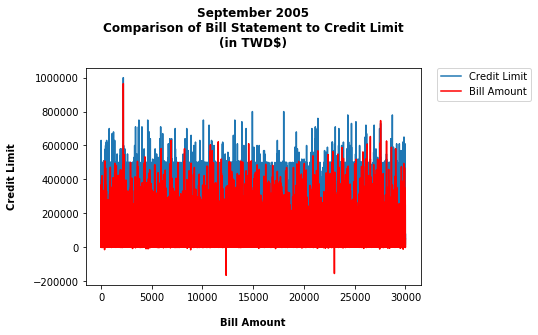

In [168]:
plt.plot(binned_credit.LIMIT_BAL, label = 'Credit Limit')
plt.plot(binned_credit.BILL_AMT1, color = 'red', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

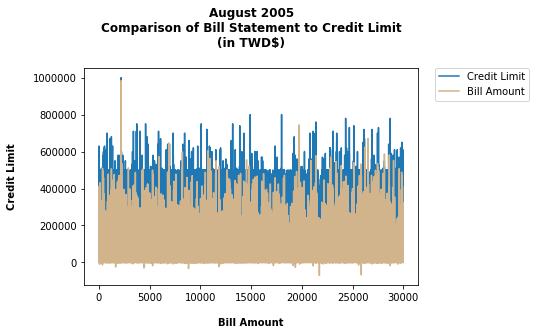

In [169]:
plt.plot(binned_credit.LIMIT_BAL, label = 'Credit Limit')
plt.plot(binned_credit.BILL_AMT2, color = 'tan', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

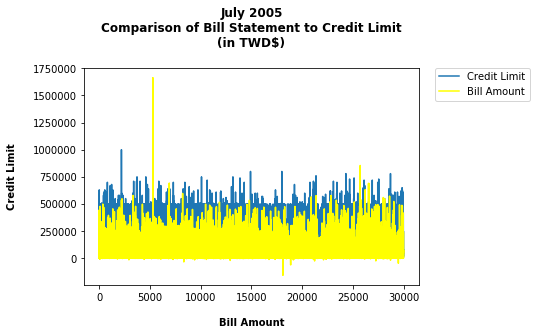

In [170]:
plt.plot(binned_credit.LIMIT_BAL, label = 'Credit Limit')
plt.plot(binned_credit.BILL_AMT3, color = 'yellow', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

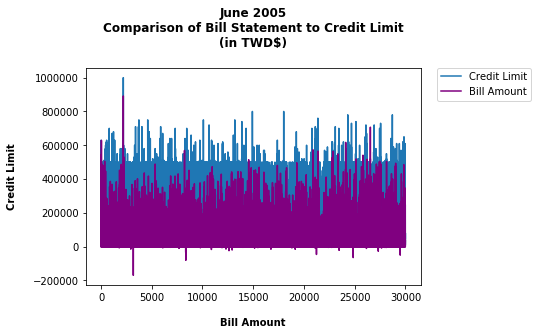

In [171]:
plt.plot(binned_credit.LIMIT_BAL, label = 'Credit Limit')
plt.plot(binned_credit.BILL_AMT4, color = 'purple', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

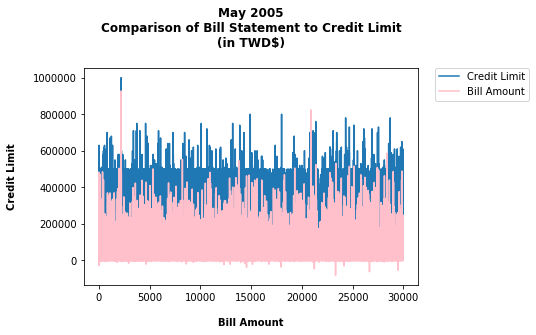

In [172]:
plt.plot(binned_credit.LIMIT_BAL, label = 'Credit Limit')
plt.plot(binned_credit.BILL_AMT5, color = 'pink', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

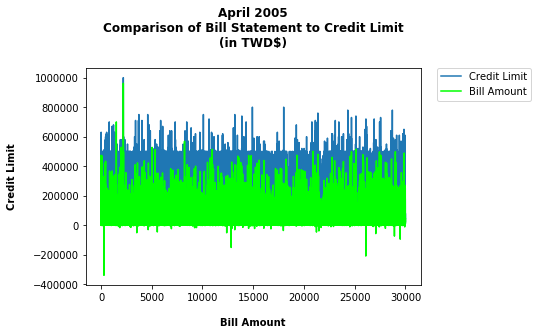

In [173]:
plt.plot(binned_credit.LIMIT_BAL, label = 'Credit Limit')
plt.plot(binned_credit.BILL_AMT6, color = 'lime', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

# Comparison of the Monthly Bill Statements & Paid Amounts

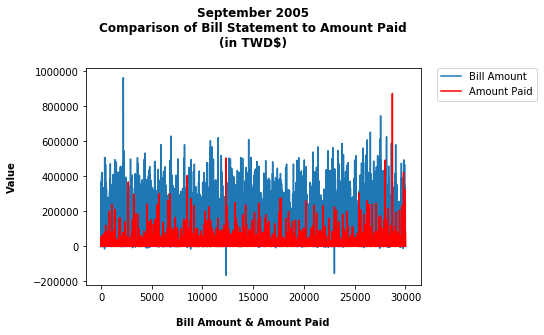

In [174]:
plt.plot(binned_credit.BILL_AMT1,label = 'Bill Amount')
plt.plot(binned_credit.PAY_AMT1,color='red',label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

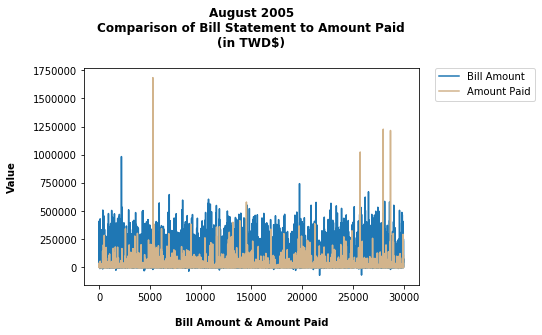

In [175]:
plt.plot(binned_credit.BILL_AMT2, label = 'Bill Amount')
plt.plot(binned_credit.PAY_AMT2,color='tan', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

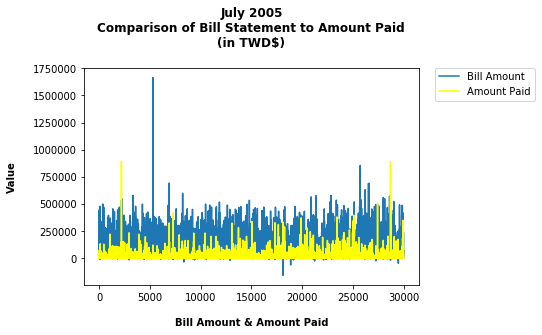

In [176]:
plt.plot(binned_credit.BILL_AMT3, label = 'Bill Amount')
plt.plot(binned_credit.PAY_AMT3, color = 'yellow', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

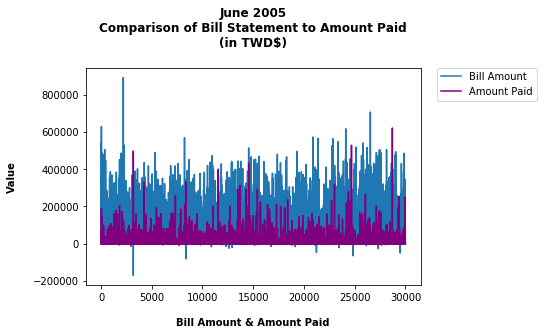

In [177]:
plt.plot(binned_credit.BILL_AMT4, label = 'Bill Amount')
plt.plot(binned_credit.PAY_AMT4, color = 'purple', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

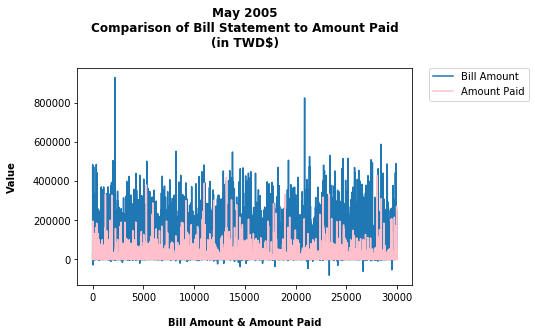

In [178]:
plt.plot(binned_credit.BILL_AMT5, label = 'Bill Amount')
plt.plot(binned_credit.PAY_AMT5, color = 'pink', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

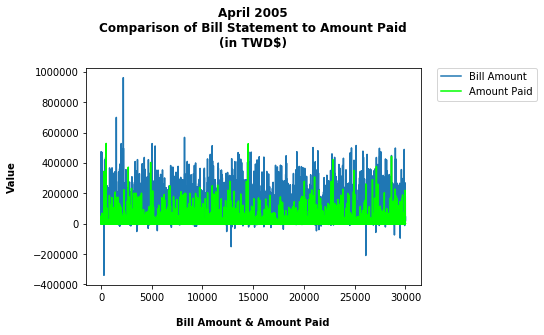

In [179]:
plt.plot(binned_credit.BILL_AMT6, label = 'Bill Amount')
plt.plot(binned_credit.PAY_AMT6, color = 'lime', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

# Breakdown of the "At Risk of Default" Attribute

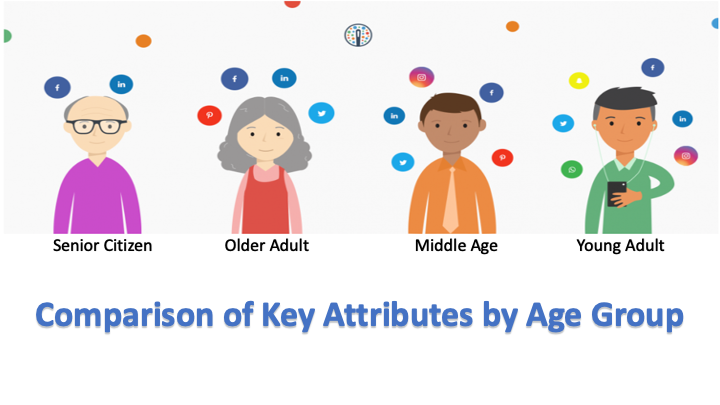

In [180]:
from IPython.display import Image
Image('Age Group.png')

# Defining the Age Groups

In [181]:
print('Young Adults:  18 to 35 years old\n\nMiddle Aged Adults:  36 to 55 years old\n\nOlder Adults:  56 to 72 years old\n\nSenior Citizens:  73+ years old')

Young Adults:  18 to 35 years old

Middle Aged Adults:  36 to 55 years old

Older Adults:  56 to 72 years old

Senior Citizens:  73+ years old


# Distribution of the Age Groups

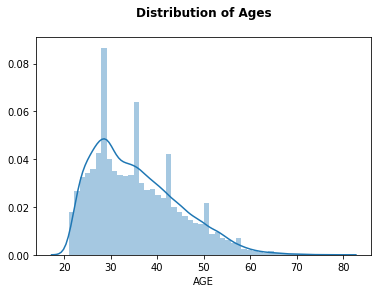

AGE_GROUP
YOUNG ADULT       16809
MIDDLE AGE        12347
OLDER ADULT         835
SENIOR CITIZEN        9
Name: AGE_GROUP, dtype: int64

In [182]:
age_dist = sns.distplot(binned_credit['AGE'])
age_dist.set_title("Distribution of Ages\n", fontweight = 'bold')

plt.show()

binned_credit.groupby('AGE_GROUP')['AGE_GROUP'].count()

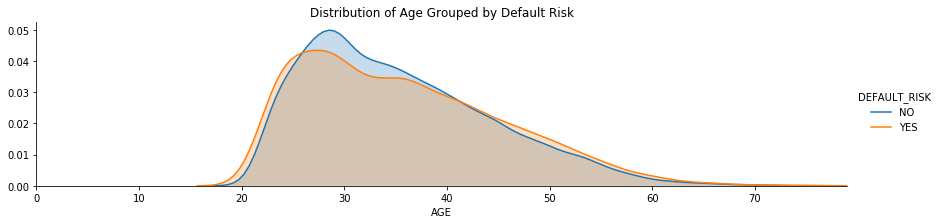

In [183]:
fig = sns.FacetGrid(binned_credit, hue='DEFAULT_RISK', aspect=4)
fig.map(sns.kdeplot, 'AGE', shade=True)
oldest = binned_credit['AGE'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Age Grouped by Default Risk')
fig.add_legend()

plt.show()

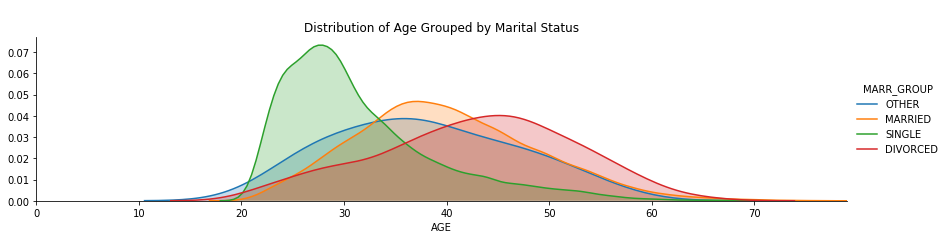

In [184]:
fig = sns.FacetGrid(binned_credit, hue='MARR_GROUP', aspect=4)
fig.map(sns.kdeplot, 'AGE', shade=True)
oldest = binned_credit['AGE'].max()
fig.set(xlim=(0,oldest))
fig.set(title='\nDistribution of Age Grouped by Marital Status')
fig.add_legend()

plt.show()

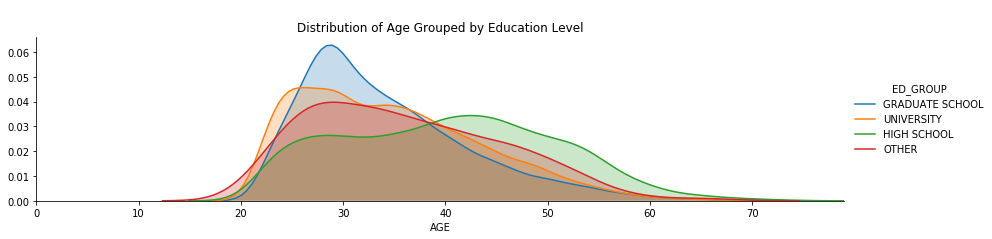

In [185]:
fig = sns.FacetGrid(binned_credit, hue='ED_GROUP', aspect=4)
fig.map(sns.kdeplot, 'AGE', shade=True)
oldest = binned_credit['AGE'].max()
fig.set(xlim=(0,oldest))
fig.set(title='\nDistribution of Age Grouped by Education Level')
fig.add_legend()

plt.show()

# Counting the Number of Defaults per Age Group

In [186]:
default_AG = binned_credit.loc[binned_credit['DEFAULT_RISK'] == "YES"]
default_AG.groupby('AGE_GROUP')['DEFAULT_RISK'].count()

AGE_GROUP
YOUNG ADULT       3597
MIDDLE AGE        2815
OLDER ADULT        220
SENIOR CITIZEN       4
Name: DEFAULT_RISK, dtype: int64

In [187]:
title = '\nNumber of People at Risk of Default by Age Group'

bolded_string = "\033[1m" + title + "\033[0m"

print(bolded_string)

default_AG.pivot_table('RISK_OF_DEFAULT', 'AGE_GROUP', aggfunc = pd.value_counts, margins = True)


Number of People at Risk of Default by Age Group


,RISK_OF_DEFAULT
AGE_GROUP,
YOUNG ADULT,3597
MIDDLE AGE,2815
OLDER ADULT,220
SENIOR CITIZEN,4
All,6636


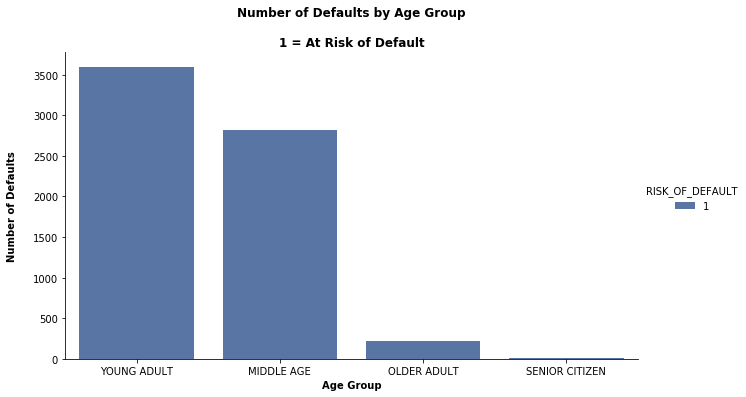

In [188]:
g = sns.catplot('AGE_GROUP', data = default_AG, hue='RISK_OF_DEFAULT', palette='deep', kind='count', aspect=1.75)
g.set_xlabels('Age Group', fontweight = 'bold')

plt.title("Number of Defaults by Age Group\n\n1 = At Risk of Default", fontweight = 'bold')
plt.ylabel('Number of Defaults\n', fontweight = 'bold')

plt.show()

# Creating the Age Group Subsets

In [189]:
young_adult = binned_credit.loc[binned_credit['AGE_GROUP'] == 'YOUNG ADULT']

middle_age = binned_credit.loc[binned_credit['AGE_GROUP'] == 'MIDDLE AGE']

older_adult = binned_credit.loc[binned_credit['AGE_GROUP'] == 'OLDER ADULT']

senior_citizen = binned_credit.loc[binned_credit['AGE_GROUP'] == 'SENIOR CITIZEN']

In [190]:
young_adult

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,689,0,0,0,0,1,YES
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3455,3261,0,1000,1000,1000,0,2000,1,YES
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14948,15549,1518,1500,1000,1000,1000,5000,0,NO
6,7,500000,"($450K, $500K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,29,...,483003,473944,55000,40000,38000,20239,13750,13770,0,NO
7,8,100000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,23,...,-159,567,380,601,0,581,1687,1542,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29987,29988,130000,"($100K, $150K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,34,...,93708,97353,3000,2000,93000,4000,5027,4005,0,NO
29988,29989,250000,"($200K, $250K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,34,...,175005,179687,65000,8800,9011,6000,7000,6009,0,NO
29989,29990,150000,"($100K, $150K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,35,...,0,0,9054,0,783,0,0,0,0,NO
29991,29992,210000,"($200K, $250K]",1,MALE,2,UNIVERSITY,1,MARRIED,34,...,2500,2500,0,0,0,0,0,0,1,YES


In [191]:
middle_age

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28959,29547,2000,2019,1200,1100,1069,1000,0,NO
5,6,50000,"($0, $50K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,37,...,19619,20024,2500,1815,657,1000,1000,800,0,NO
11,12,260000,"($250K, $300K]",2,FEMALE,1,GRADUATE SCHOOL,2,SINGLE,51,...,22287,13668,21818,9966,8583,22301,0,3640,0,NO
12,13,630000,"($600K, $650K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,41,...,6500,2870,1000,6500,6500,6500,2870,0,0,NO
17,18,320000,"($300K, $350K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,49,...,5856,195599,10358,10000,75940,20000,195599,50000,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,31237,15980,8500,20000,5003,3047,5000,1000,0,NO
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,5190,0,1837,3526,8998,129,0,0,0,NO
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,SINGLE,37,...,20582,19357,0,0,22000,4200,2000,3100,1,YES
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,41,...,11855,48944,85900,3409,1178,1926,52964,1804,1,YES


In [192]:
older_adult

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,19146,19131,2000,36681,10000,9000,689,679,0,NO
34,35,500000,"($450K, $500K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,58,...,0,5293,5006,31178,3180,0,5293,768,0,NO
65,66,200000,"($150K, $200K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,57,...,8198,7918,0,0,8222,300,0,1000,1,YES
66,67,10000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,56,...,4196,4326,2300,0,150,200,200,160,1,YES
102,103,480000,"($450K, $500K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,63,...,471145,469961,16078,55693,17000,0,18000,24200,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29177,29178,150000,"($100K, $150K]",2,FEMALE,3,HIGH SCHOOL,2,SINGLE,58,...,69424,70906,6251,5000,3903,2500,2600,2600,0,NO
29178,29179,90000,"($50K, $100K]",2,FEMALE,3,HIGH SCHOOL,2,SINGLE,60,...,27243,27799,63201,5322,26400,545,556,1274,0,NO
29180,29181,140000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,60,...,115590,118221,0,5600,6000,4200,4500,4600,1,YES
29181,29182,170000,"($150K, $200K]",2,FEMALE,3,HIGH SCHOOL,1,MARRIED,57,...,124387,120529,7300,8000,7800,4600,5000,5100,0,NO


In [193]:
senior_citizen

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
246,247,250000,"($200K, $250K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,75,...,5572,794,1631,1536,1010,5572,794,1184,0,NO
387,388,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,73,...,72870,75018,3500,4330,3500,3500,3500,5100,1,YES
10699,10700,140000,"($100K, $150K]",1,MALE,2,UNIVERSITY,1,MARRIED,73,...,138675,137197,5082,5008,5000,6016,5018,5264,0,NO
18245,18246,440000,"($400K, $450K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,79,...,438187,447543,15715,16519,16513,15800,16531,15677,0,NO
25136,25137,180000,"($150K, $200K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,75,...,0,0,0,0,0,0,0,0,1,YES
25141,25142,210000,"($200K, $250K]",1,MALE,2,UNIVERSITY,1,MARRIED,75,...,205901,210006,9700,8810,9000,7300,7500,7600,0,NO
29163,29164,360000,"($350K, $400K]",2,FEMALE,3,HIGH SCHOOL,1,MARRIED,73,...,0,0,0,0,0,0,0,0,1,YES
29175,29176,160000,"($150K, $200K]",2,FEMALE,3,HIGH SCHOOL,1,MARRIED,74,...,0,19789,3783,2268,16905,0,19789,26442,0,NO
29179,29180,500000,"($450K, $500K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,73,...,8896,3850,2826,2652,2835,8896,3850,711,1,YES


# Comparison of Credit Limits by Age Group

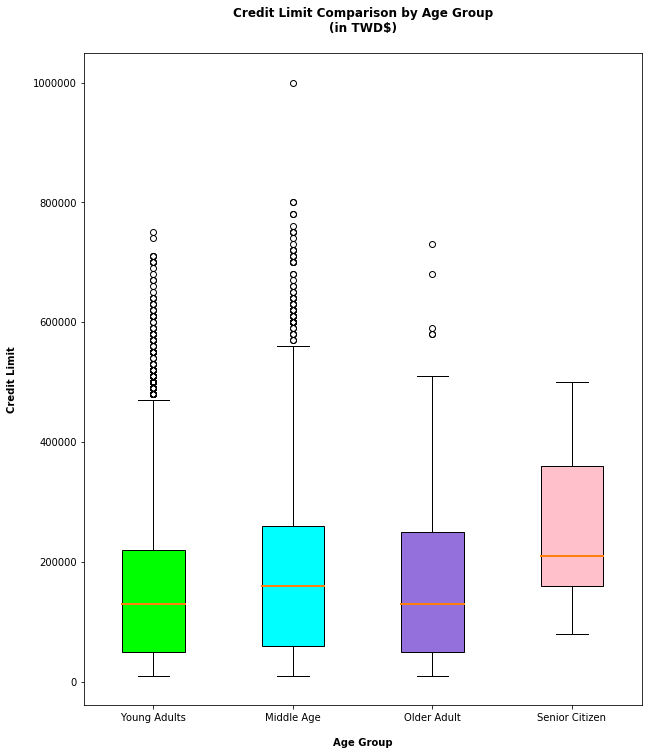

In [194]:
plt.figure(figsize = (10,12))

young_adult = young_adult.LIMIT_BAL
middle_age = middle_age.LIMIT_BAL
older_adult = older_adult.LIMIT_BAL
senior_citizen = senior_citizen.LIMIT_BAL

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Credit Limit Comparison by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparison of Bill Statements by Age Group

## September 2005

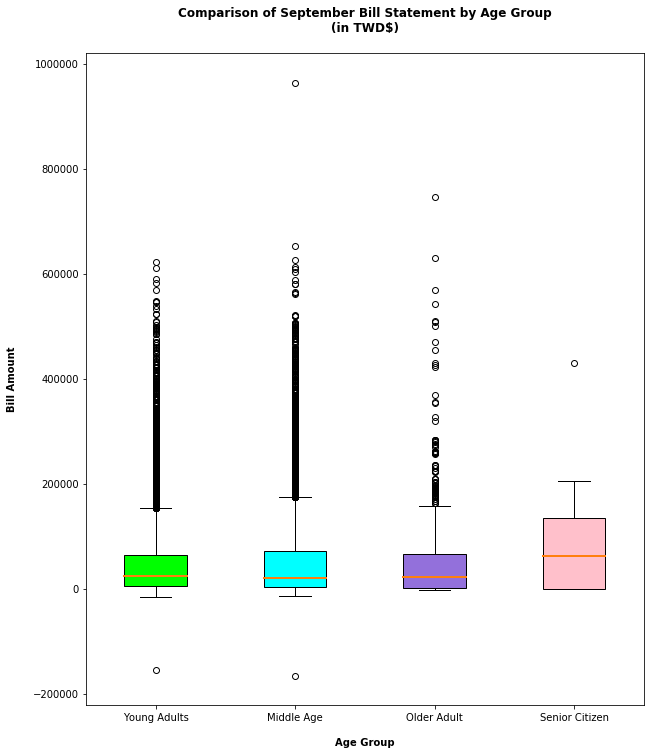

In [196]:
plt.figure(figsize = (10,12))

young_adult = young_adult.BILL_AMT1
middle_age = middle_age.BILL_AMT1
older_adult = older_adult.BILL_AMT1
senior_citizen = senior_citizen.BILL_AMT1

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Comparison of September Bill Statement by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

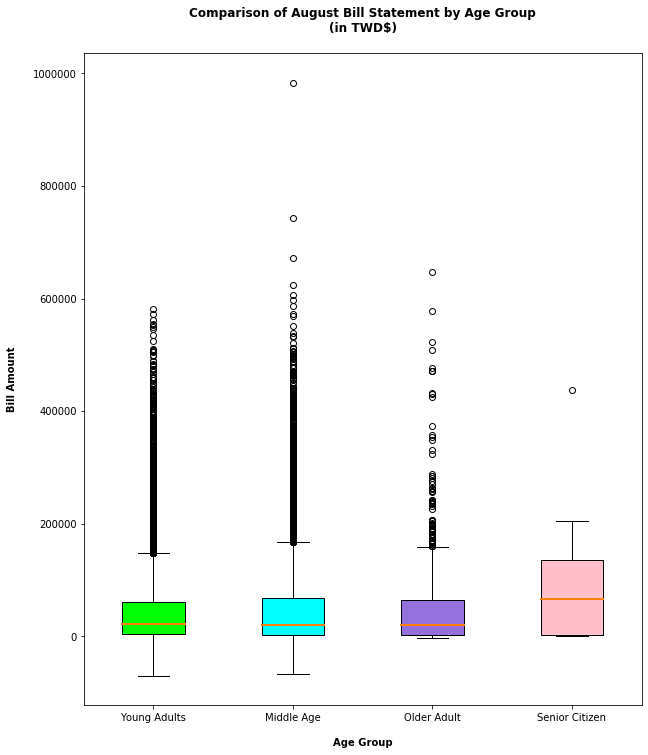

In [198]:
plt.figure(figsize = (10,12))

young_adult = young_adult.BILL_AMT2
middle_age = middle_age.BILL_AMT2
older_adult = older_adult.BILL_AMT2
senior_citizen = senior_citizen.BILL_AMT2

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Comparison of August Bill Statement by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## July 2005

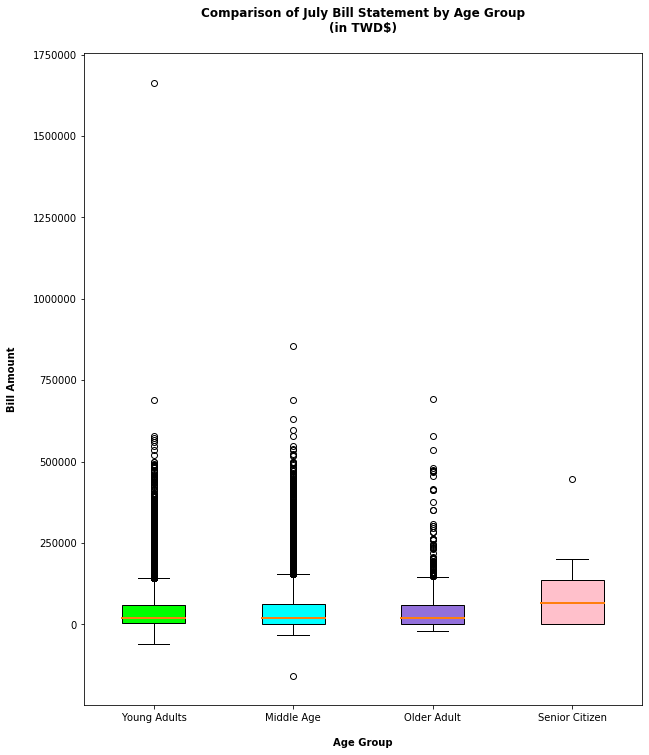

In [200]:
plt.figure(figsize = (10,12))

young_adult = young_adult.BILL_AMT3
middle_age = middle_age.BILL_AMT3
older_adult = older_adult.BILL_AMT3
senior_citizen = senior_citizen.BILL_AMT3

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Comparison of July Bill Statement by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## June 2005

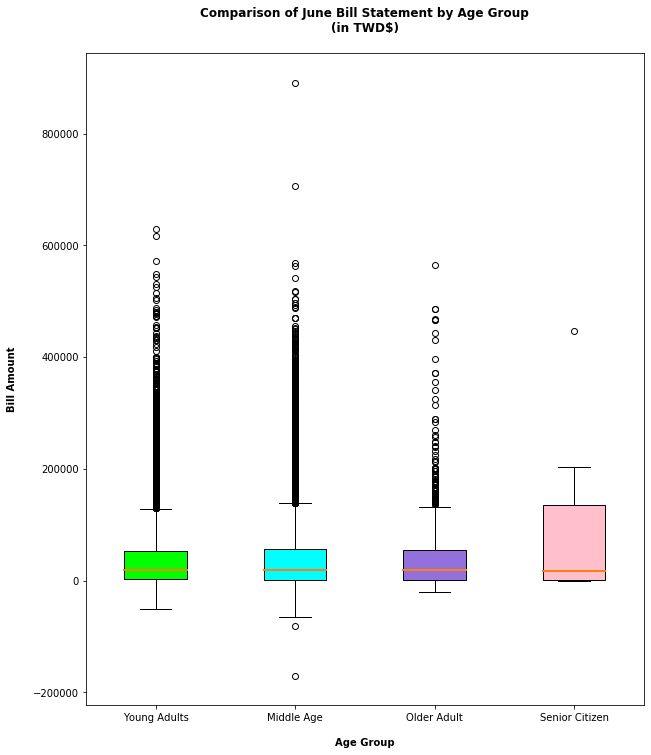

In [202]:
plt.figure(figsize = (10,12))

young_adult = young_adult.BILL_AMT4
middle_age = middle_age.BILL_AMT4
older_adult = older_adult.BILL_AMT4
senior_citizen = senior_citizen.BILL_AMT4

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Comparison of June Bill Statement by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## May 2005

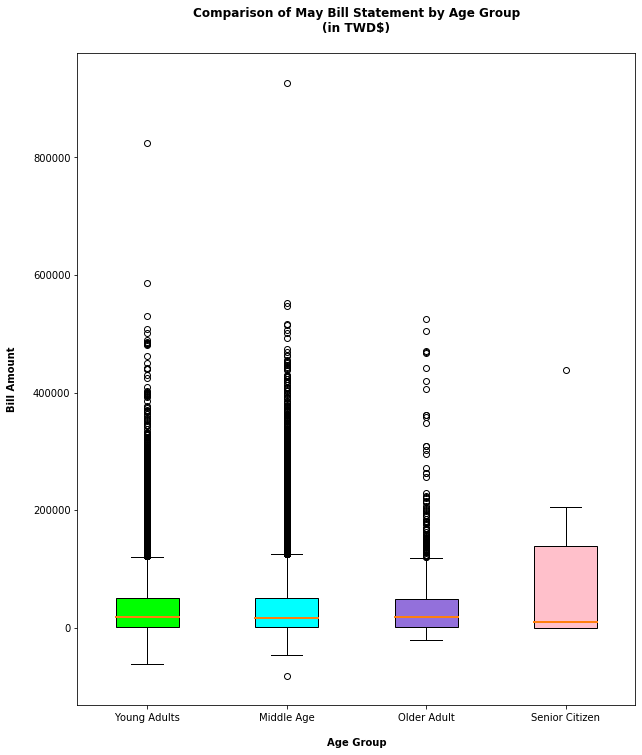

In [204]:
plt.figure(figsize = (10,12))

young_adult = young_adult.BILL_AMT5
middle_age = middle_age.BILL_AMT5
older_adult = older_adult.BILL_AMT5
senior_citizen = senior_citizen.BILL_AMT5

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Comparison of May Bill Statement by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## April 2005

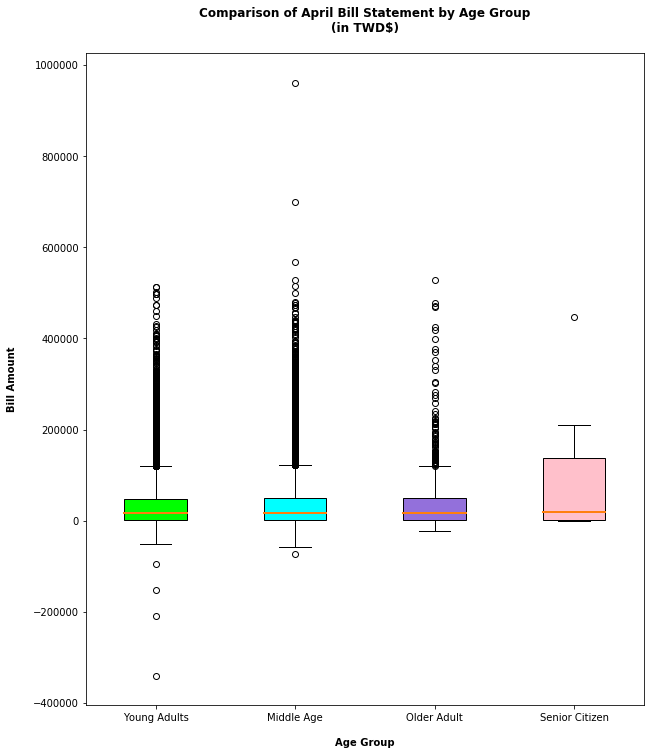

In [206]:
plt.figure(figsize = (10,12))

young_adult = young_adult.BILL_AMT6
middle_age = middle_age.BILL_AMT6
older_adult = older_adult.BILL_AMT6
senior_citizen = senior_citizen.BILL_AMT6

labels = ['Young Adults','Middle Age','Older Adult','Senior Citizen']
plt.title('Comparison of April Bill Statement by Age Group\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nAge Group',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([young_adult, middle_age, older_adult, senior_citizen], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparing Bill Statements and Credit Limits by Age Group

## September 2005

### Line Plots

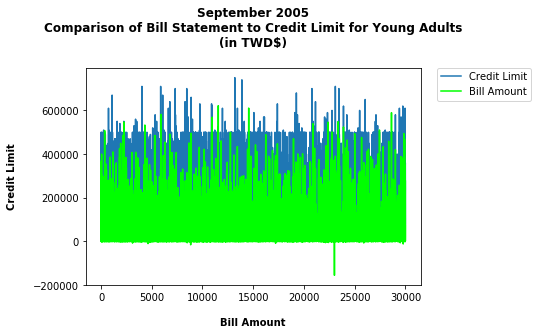

In [208]:
plt.plot(young_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(young_adult.BILL_AMT1, color = 'lime', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

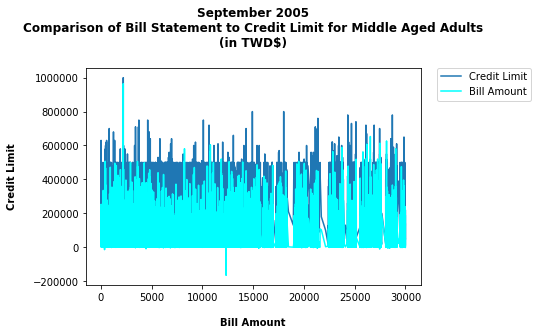

In [209]:
plt.plot(middle_age.LIMIT_BAL, label = 'Credit Limit')
plt.plot(middle_age.BILL_AMT1, color = 'cyan', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

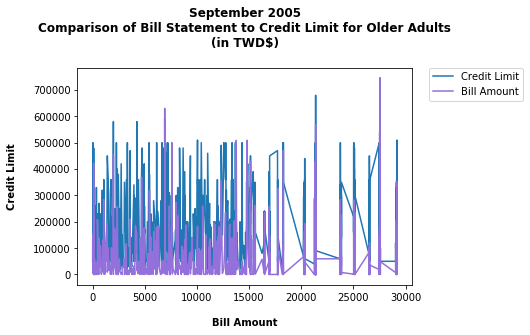

In [210]:
plt.plot(older_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(older_adult.BILL_AMT1, color = 'mediumpurple', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

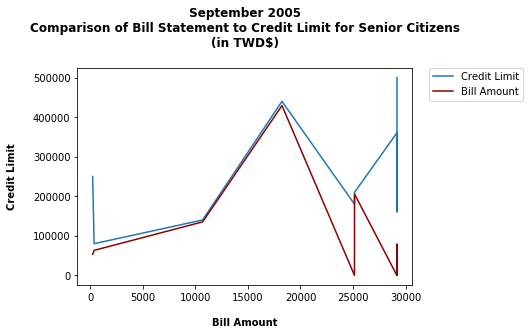

In [211]:
plt.plot(senior_citizen.LIMIT_BAL, label = 'Credit Limit')
plt.plot(senior_citizen.BILL_AMT1, color = 'darkred', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

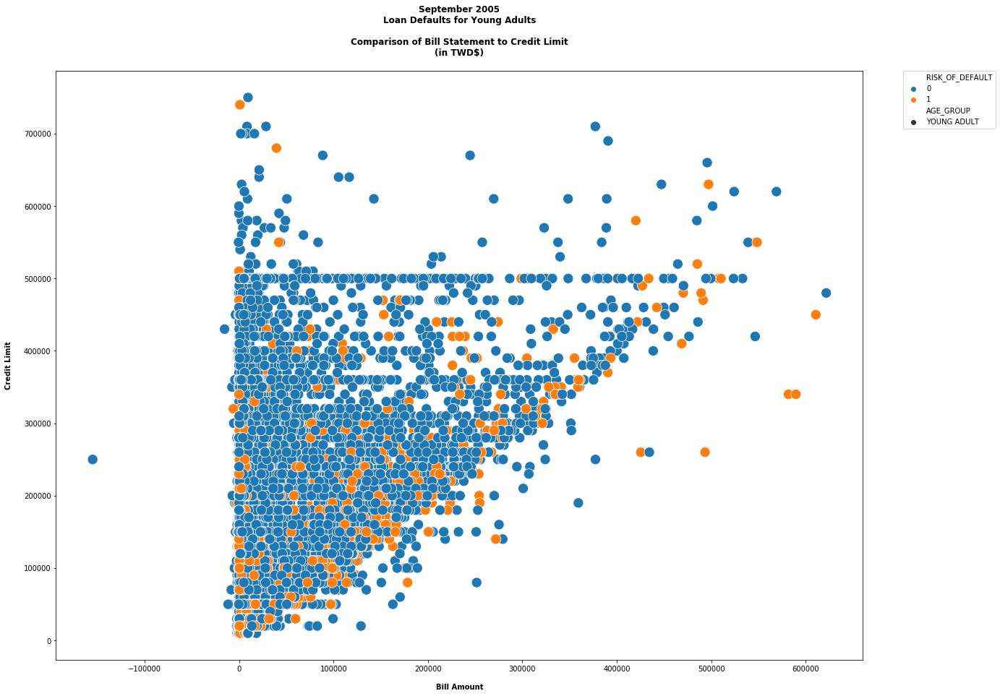

In [212]:
x = young_adult.BILL_AMT1
y = young_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('September 2005\nLoan Defaults for Young Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

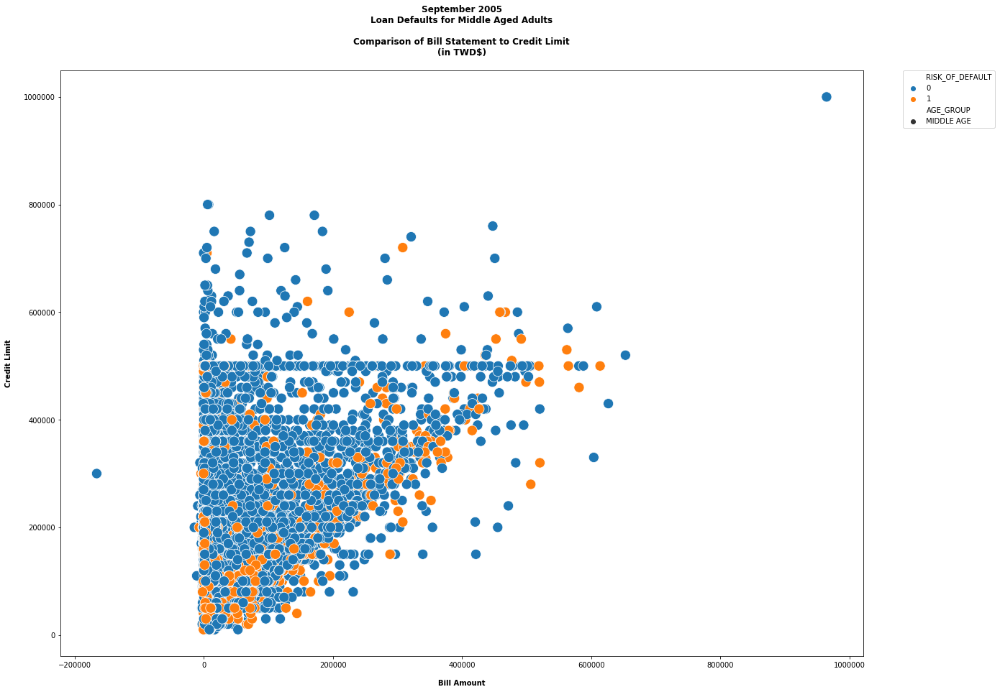

In [213]:
x = middle_age.BILL_AMT1
y = middle_age.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('September 2005\nLoan Defaults for Middle Aged Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

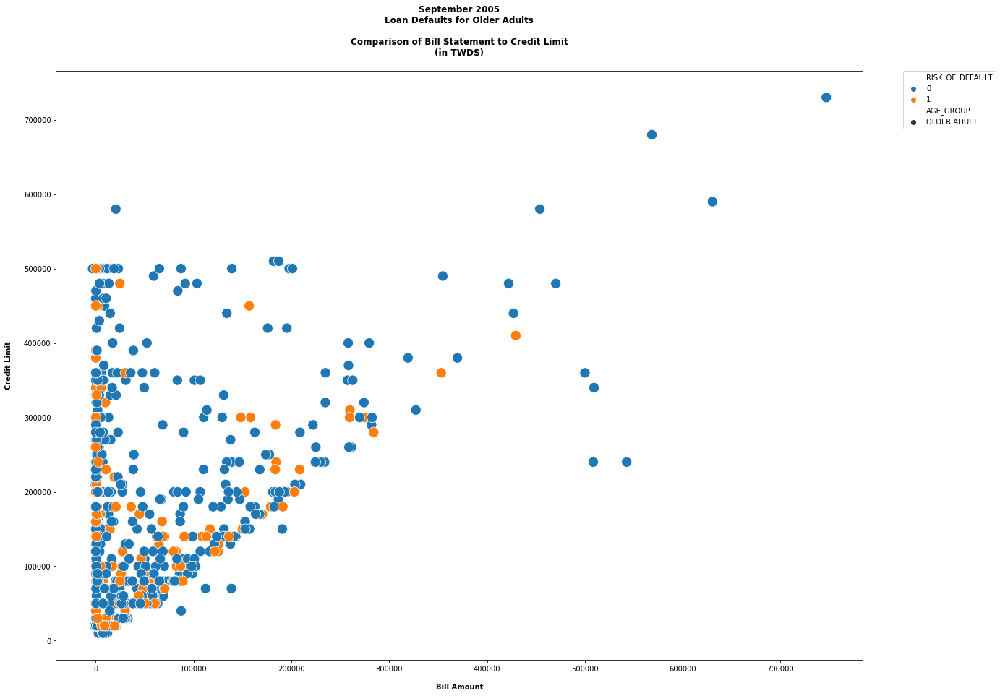

In [214]:
x = older_adult.BILL_AMT1
y = older_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('September 2005\nLoan Defaults for Older Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

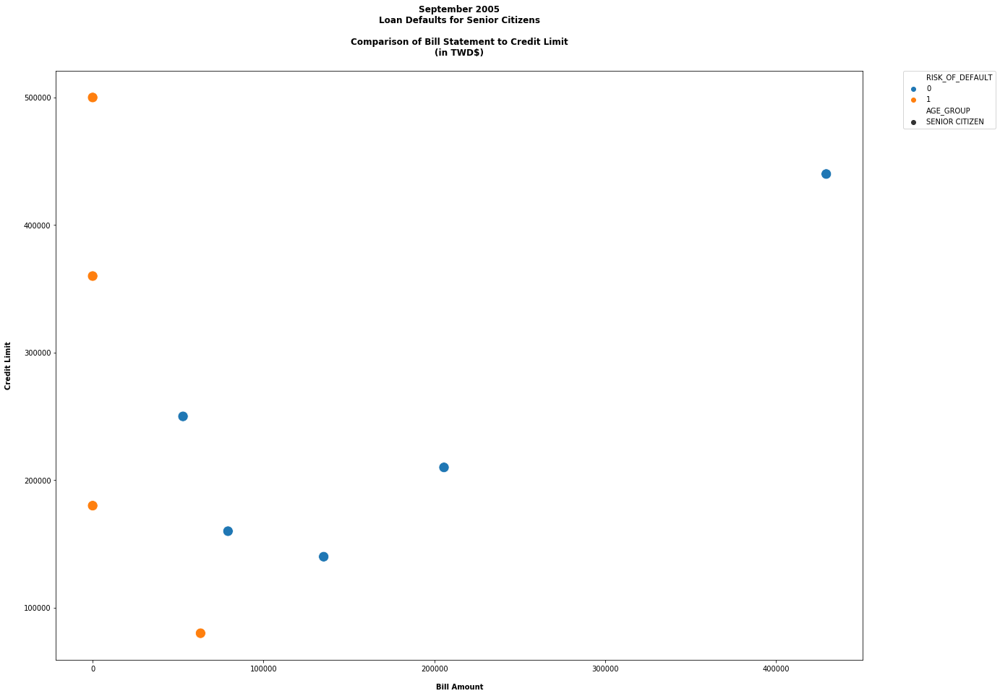

In [215]:
x = senior_citizen.BILL_AMT1
y = senior_citizen.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('September 2005\nLoan Defaults for Senior Citizens\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

## August 2005

### Line Plots

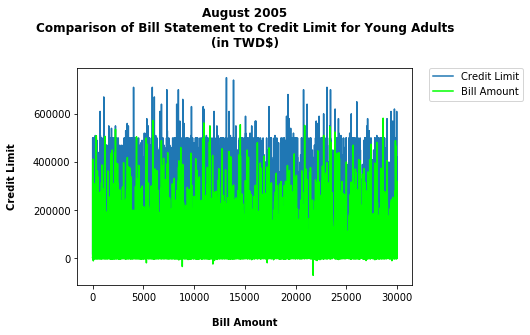

In [216]:
plt.plot(young_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(young_adult.BILL_AMT2, color = 'lime', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

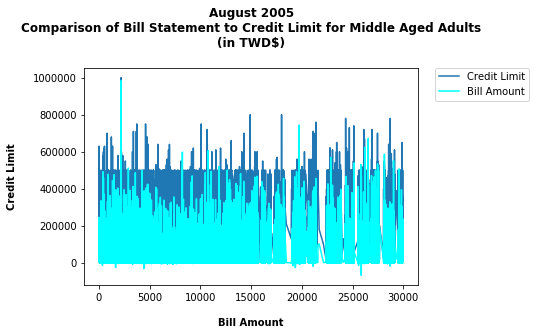

In [217]:
plt.plot(middle_age.LIMIT_BAL, label = 'Credit Limit')
plt.plot(middle_age.BILL_AMT2, color = 'cyan', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

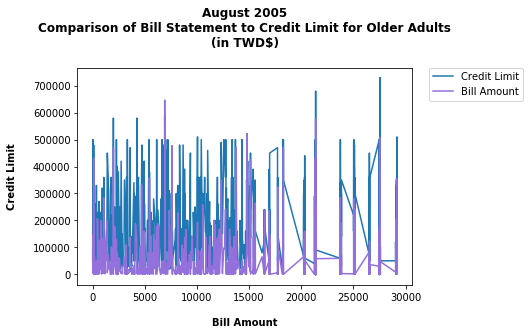

In [218]:
plt.plot(older_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(older_adult.BILL_AMT2, color = 'mediumpurple', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

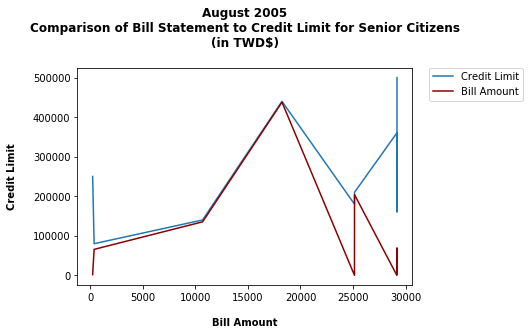

In [219]:
plt.plot(senior_citizen.LIMIT_BAL, label = 'Credit Limit')
plt.plot(senior_citizen.BILL_AMT2, color = 'darkred', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

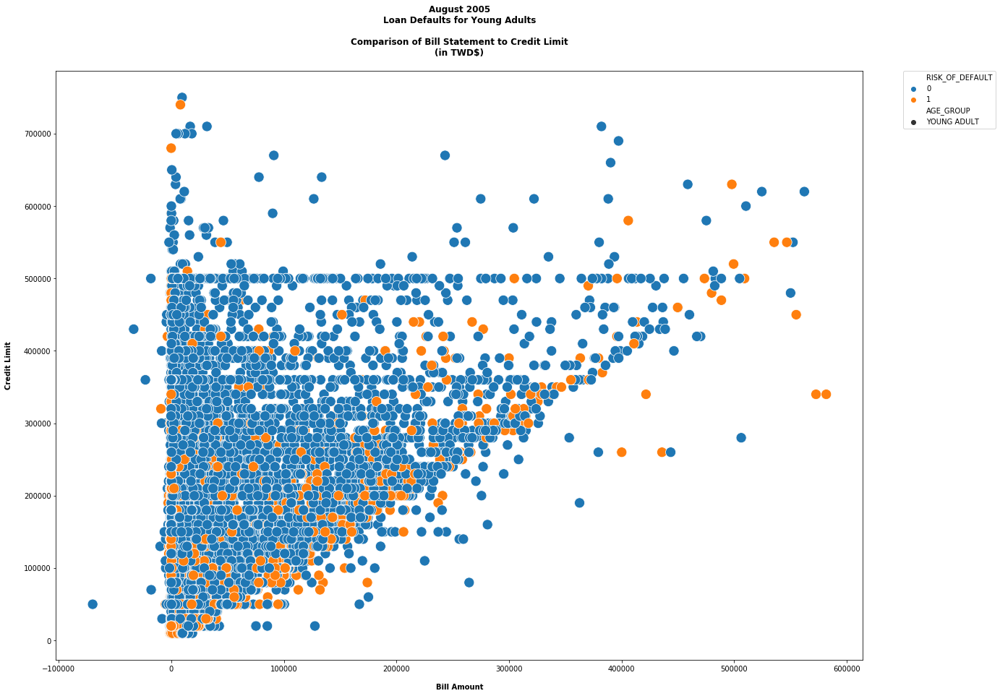

In [220]:
x = young_adult.BILL_AMT2
y = young_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('August 2005\nLoan Defaults for Young Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

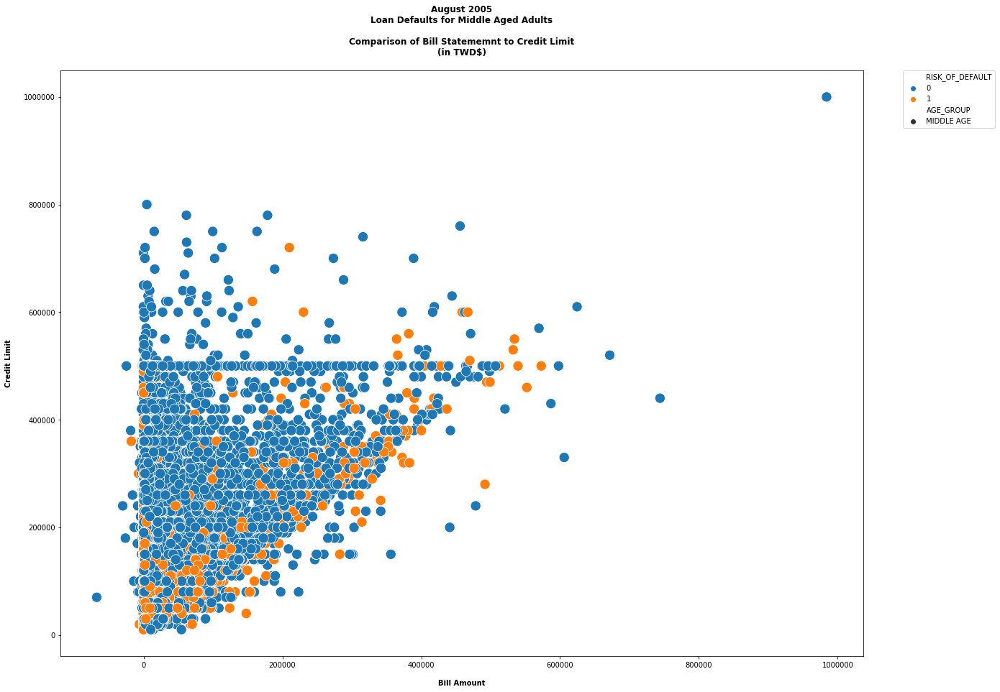

In [221]:
x = middle_age.BILL_AMT2
y = middle_age.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('August 2005\nLoan Defaults for Middle Aged Adults\n\nComparison of Bill Statememnt to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

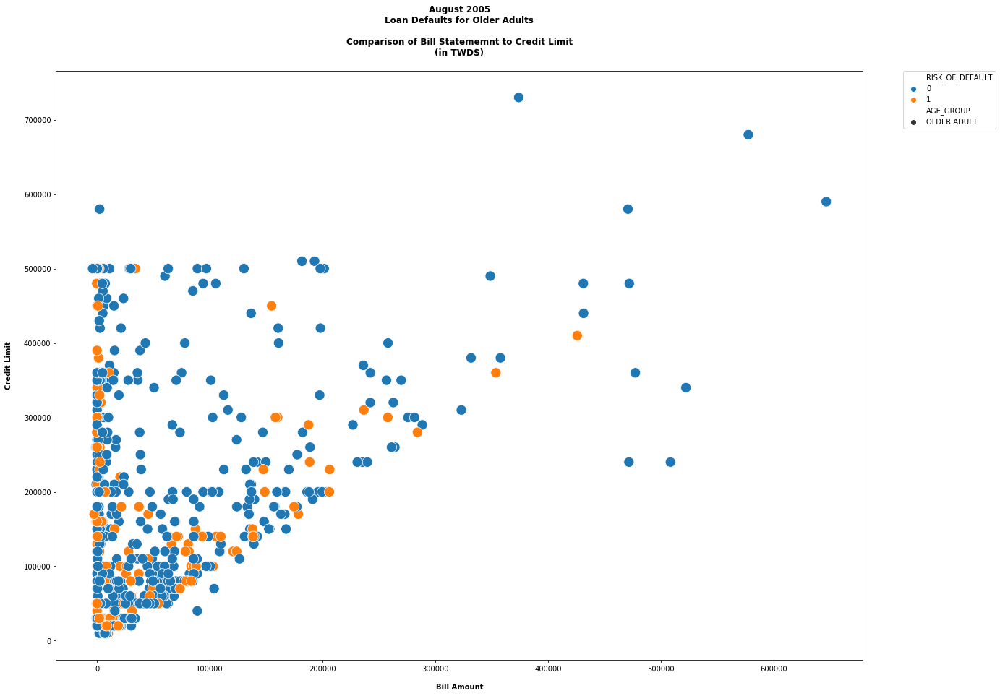

In [222]:
x = older_adult.BILL_AMT2
y = older_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('August 2005\nLoan Defaults for Older Adults\n\nComparison of Bill Statememnt to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

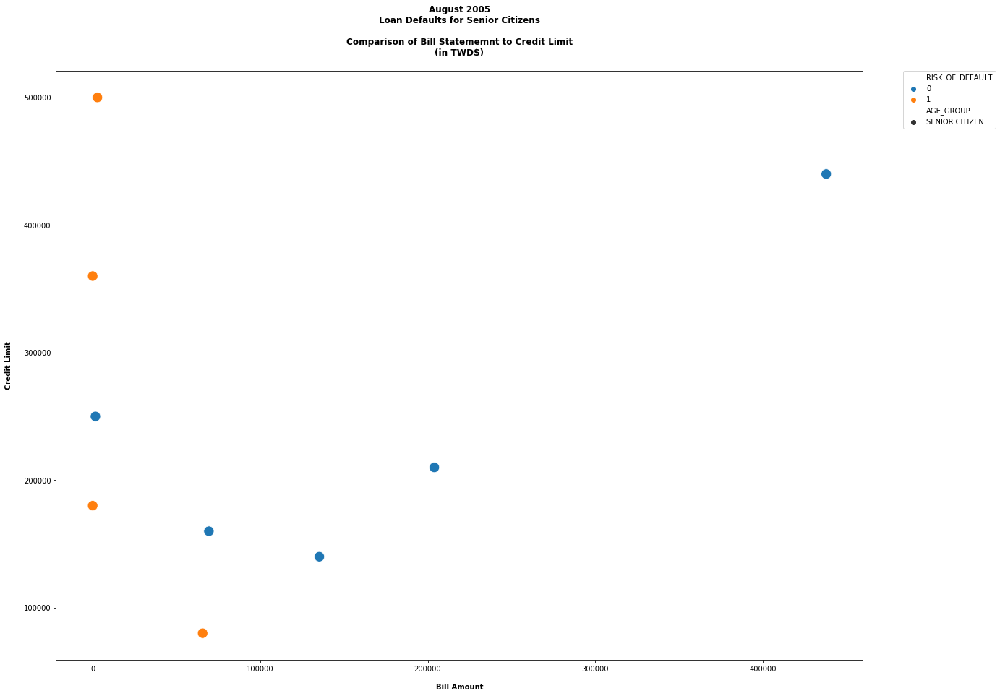

In [223]:
x = senior_citizen.BILL_AMT2
y = senior_citizen.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('August 2005\nLoan Defaults for Senior Citizens\n\nComparison of Bill Statememnt to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

## July 2005

### Line Plots

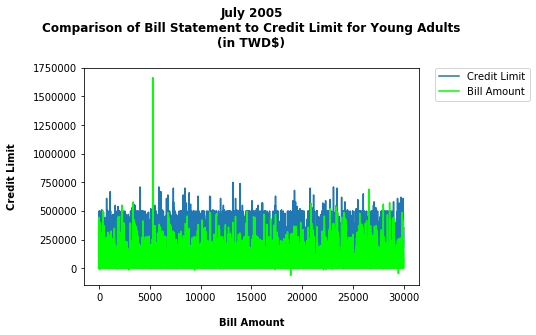

In [224]:
plt.plot(young_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(young_adult.BILL_AMT3, color = 'lime', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

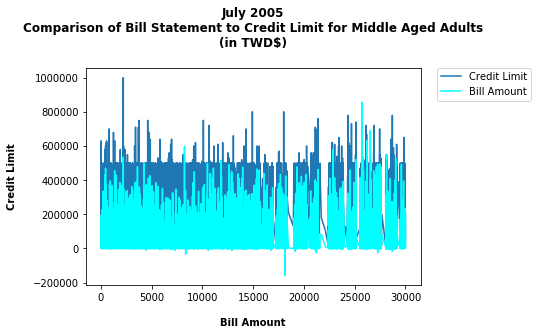

In [225]:
plt.plot(middle_age.LIMIT_BAL, label = 'Credit Limit')
plt.plot(middle_age.BILL_AMT3, color = 'cyan', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

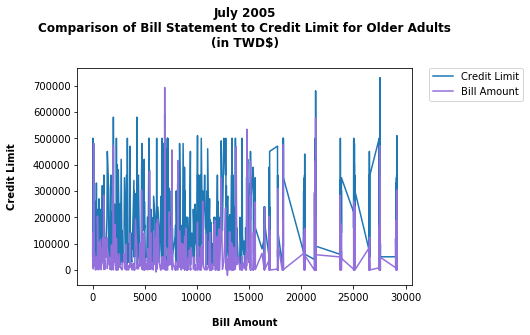

In [226]:
plt.plot(older_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(older_adult.BILL_AMT3, color = 'mediumpurple', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

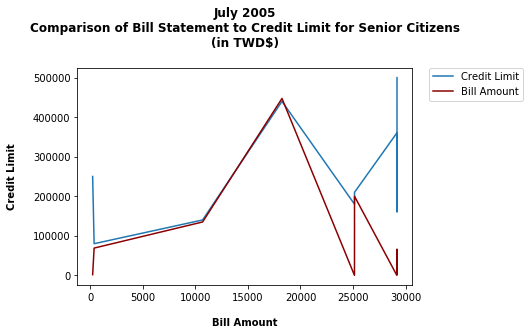

In [227]:
plt.plot(senior_citizen.LIMIT_BAL, label = 'Credit Limit')
plt.plot(senior_citizen.BILL_AMT3, color = 'darkred', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

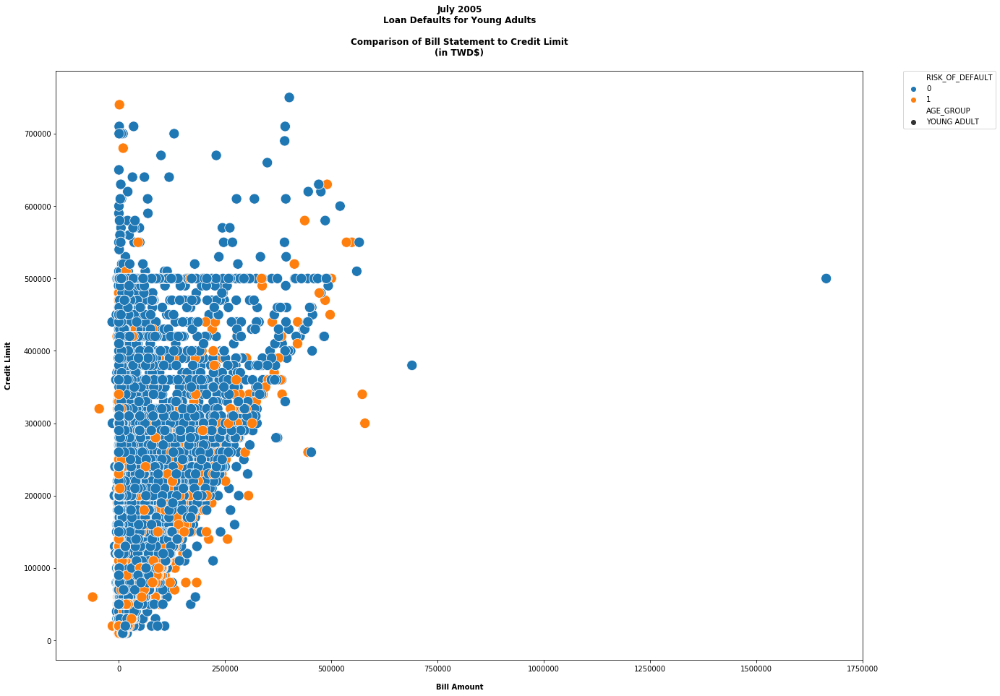

In [228]:
x = young_adult.BILL_AMT3
y = young_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('July 2005\nLoan Defaults for Young Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

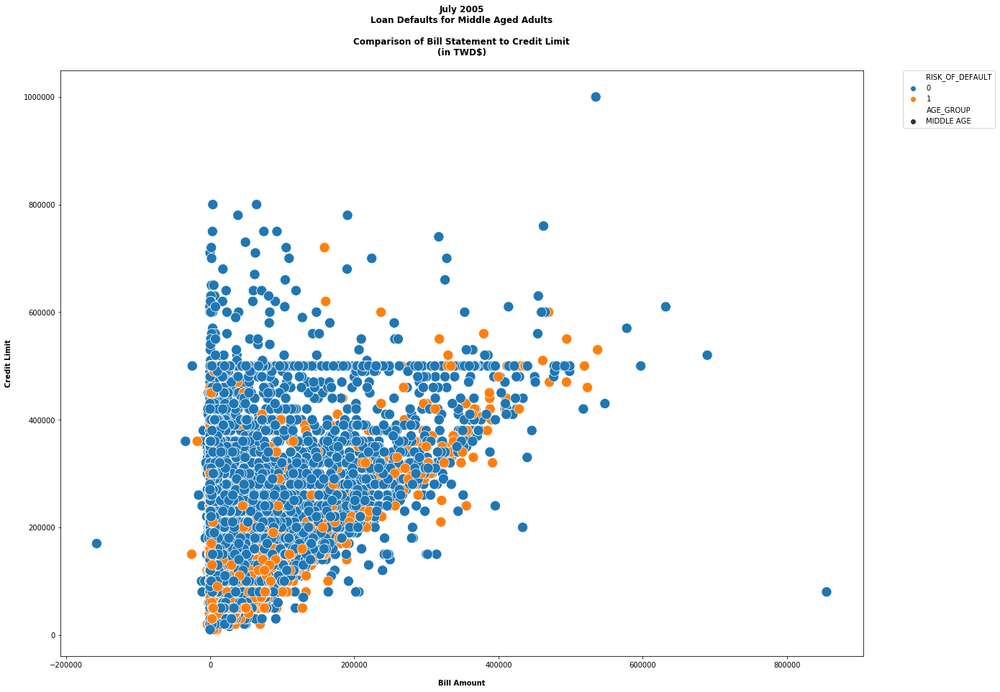

In [229]:
x = middle_age.BILL_AMT3
y = middle_age.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('July 2005\nLoan Defaults for Middle Aged Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

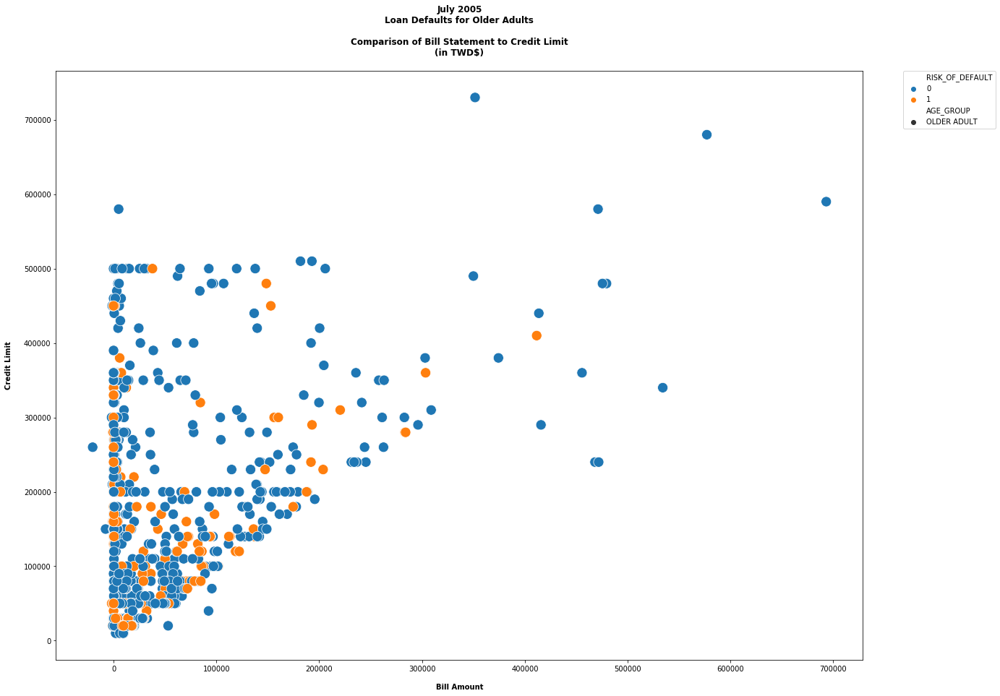

In [230]:
x = older_adult.BILL_AMT3
y = older_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('July 2005\nLoan Defaults for Older Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

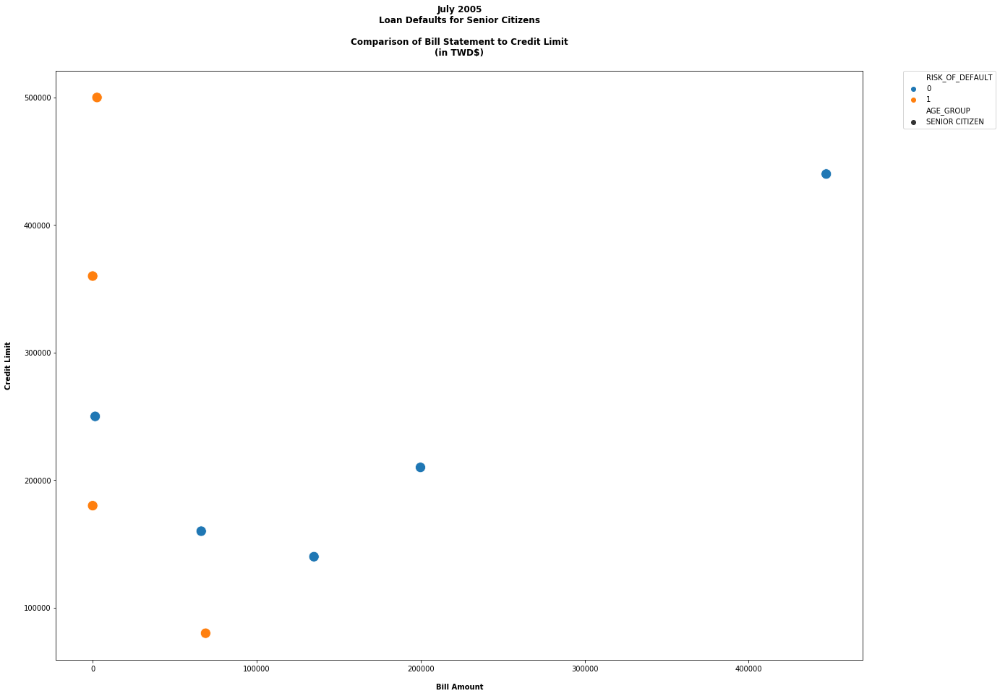

In [231]:
x = senior_citizen.BILL_AMT3
y = senior_citizen.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('July 2005\nLoan Defaults for Senior Citizens\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

## June 2005

### Line Plots

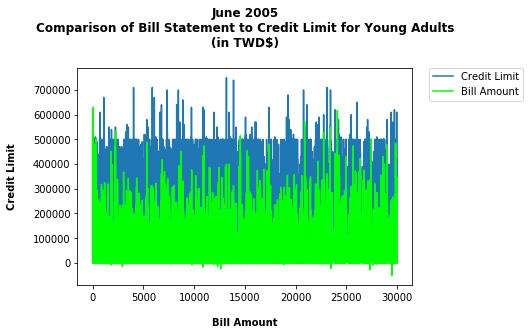

In [232]:
plt.plot(young_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(young_adult.BILL_AMT4, color = 'lime', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

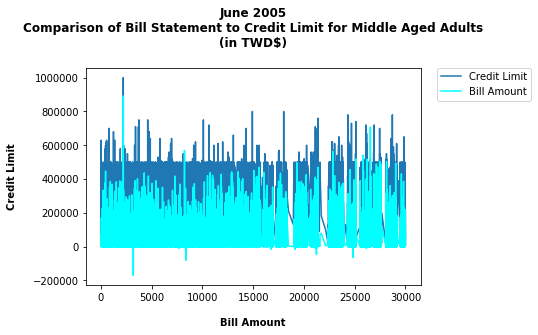

In [233]:
plt.plot(middle_age.LIMIT_BAL, label = 'Credit Limit')
plt.plot(middle_age.BILL_AMT4, color = 'cyan', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

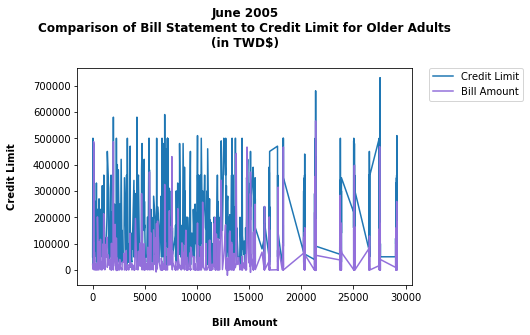

In [234]:
plt.plot(older_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(older_adult.BILL_AMT4, color = 'mediumpurple', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

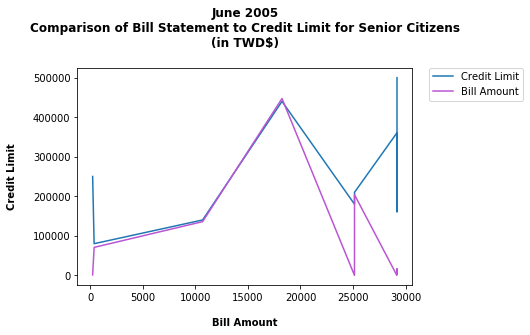

In [235]:
plt.plot(senior_citizen.LIMIT_BAL, label = 'Credit Limit')
plt.plot(senior_citizen.BILL_AMT4, color = 'mediumorchid', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

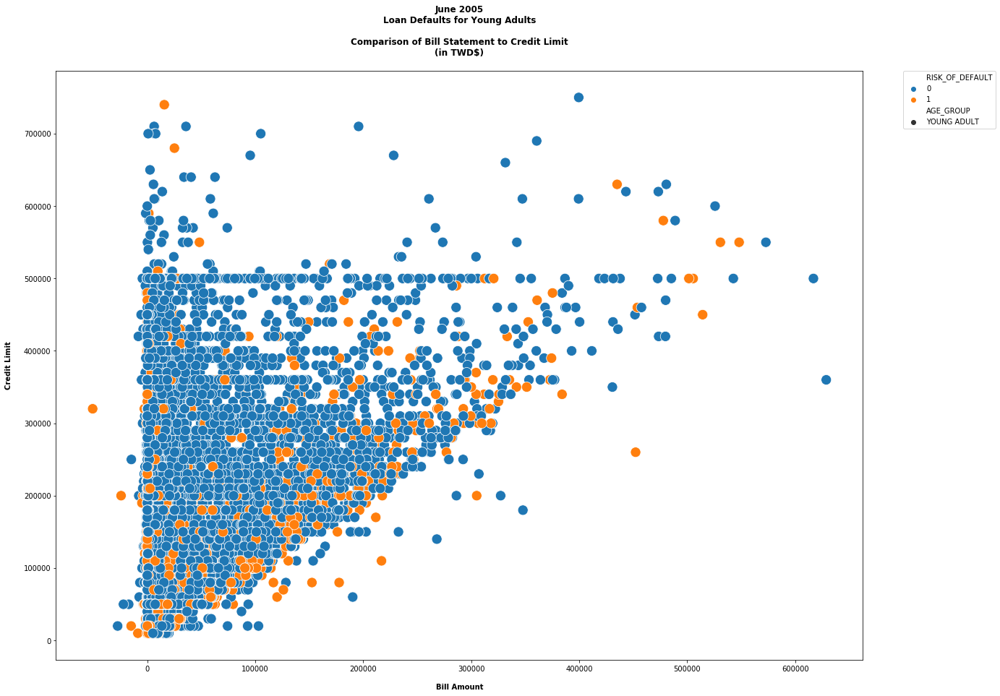

In [236]:
x = young_adult.BILL_AMT4
y = young_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('June 2005\nLoan Defaults for Young Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

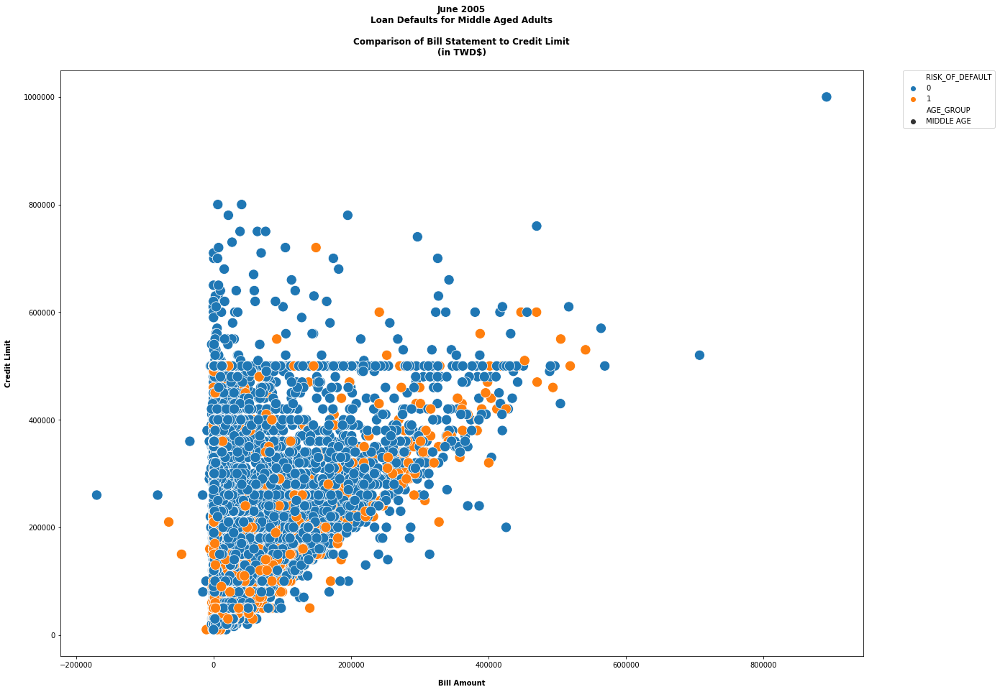

In [237]:
x = middle_age.BILL_AMT4
y = middle_age.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('June 2005\nLoan Defaults for Middle Aged Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

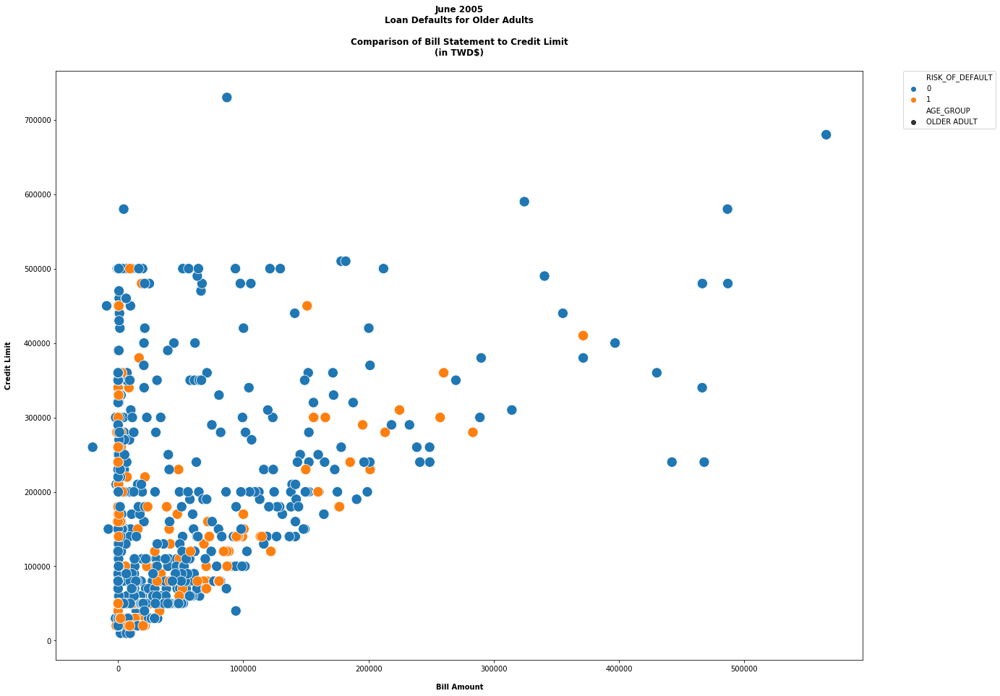

In [238]:
x = older_adult.BILL_AMT4
y = older_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('June 2005\nLoan Defaults for Older Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

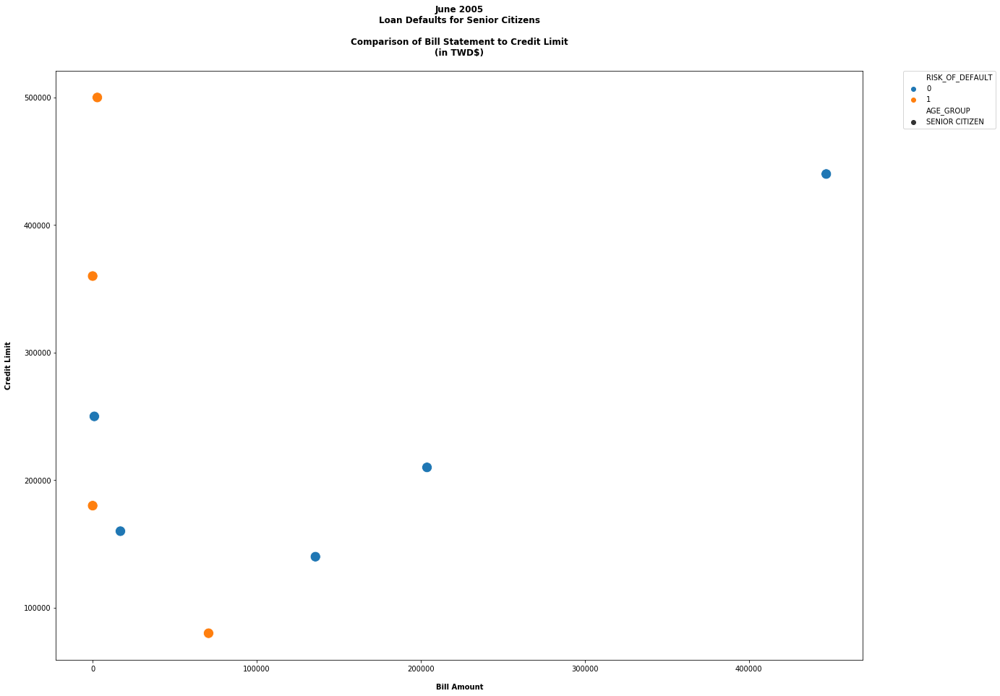

In [239]:
x = senior_citizen.BILL_AMT4
y = senior_citizen.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('June 2005\nLoan Defaults for Senior Citizens\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

## May 2005

### Line Plots

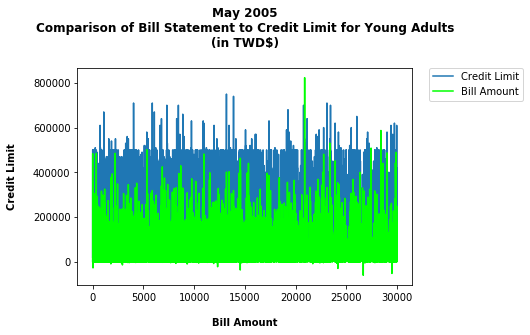

In [240]:
plt.plot(young_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(young_adult.BILL_AMT5, color = 'lime', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

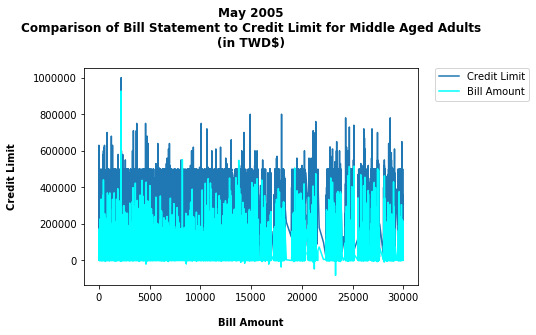

In [241]:
plt.plot(middle_age.LIMIT_BAL, label = 'Credit Limit')
plt.plot(middle_age.BILL_AMT5, color = 'cyan', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

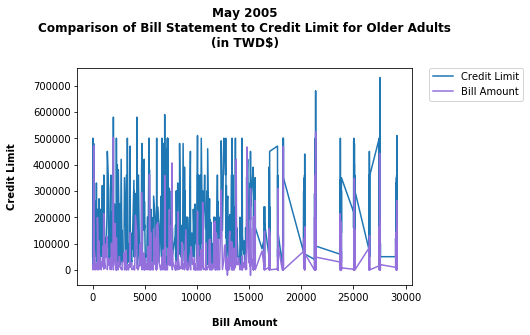

In [242]:
plt.plot(older_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(older_adult.BILL_AMT5, color = 'mediumpurple', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

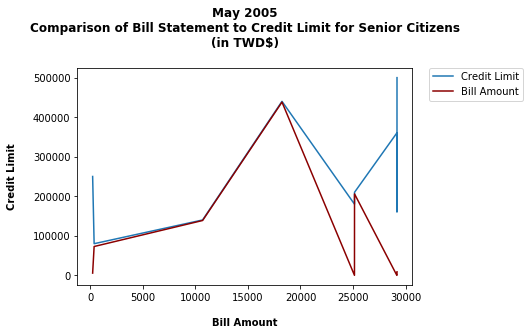

In [243]:
plt.plot(senior_citizen.LIMIT_BAL, label = 'Credit Limit')
plt.plot(senior_citizen.BILL_AMT5, color = 'darkred', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

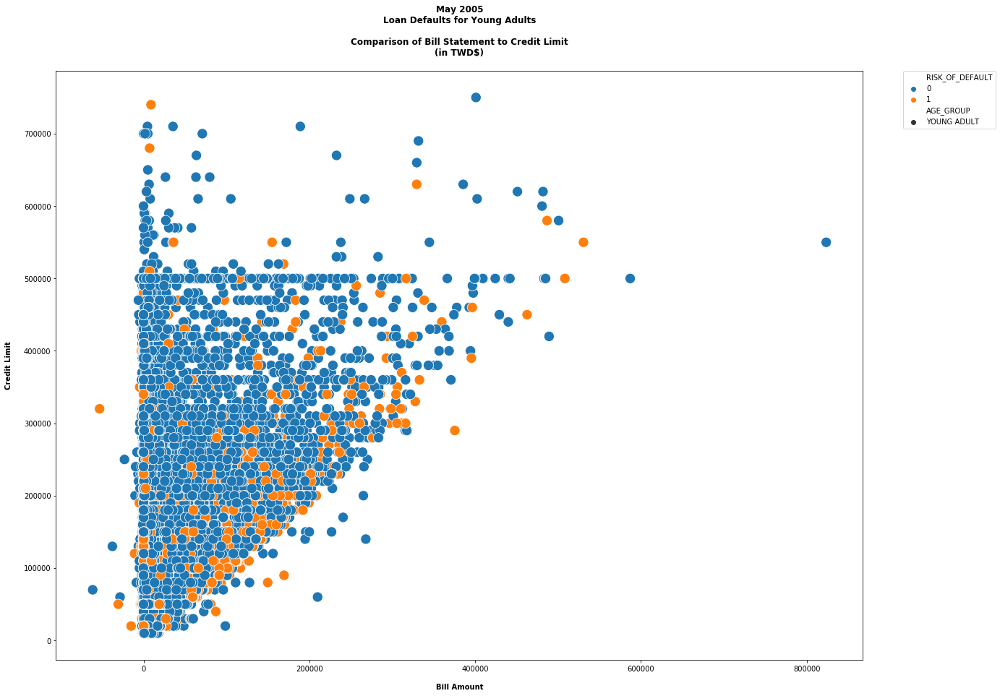

In [244]:
x = young_adult.BILL_AMT5
y = young_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('May 2005\nLoan Defaults for Young Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

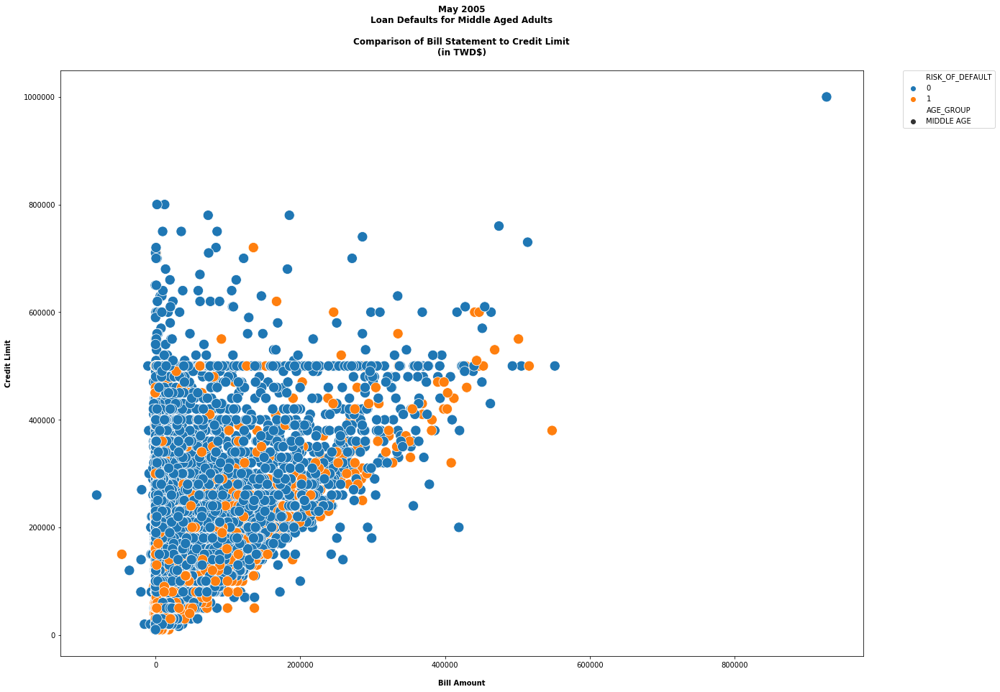

In [245]:
x = middle_age.BILL_AMT5
y = middle_age.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('May 2005\nLoan Defaults for Middle Aged Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

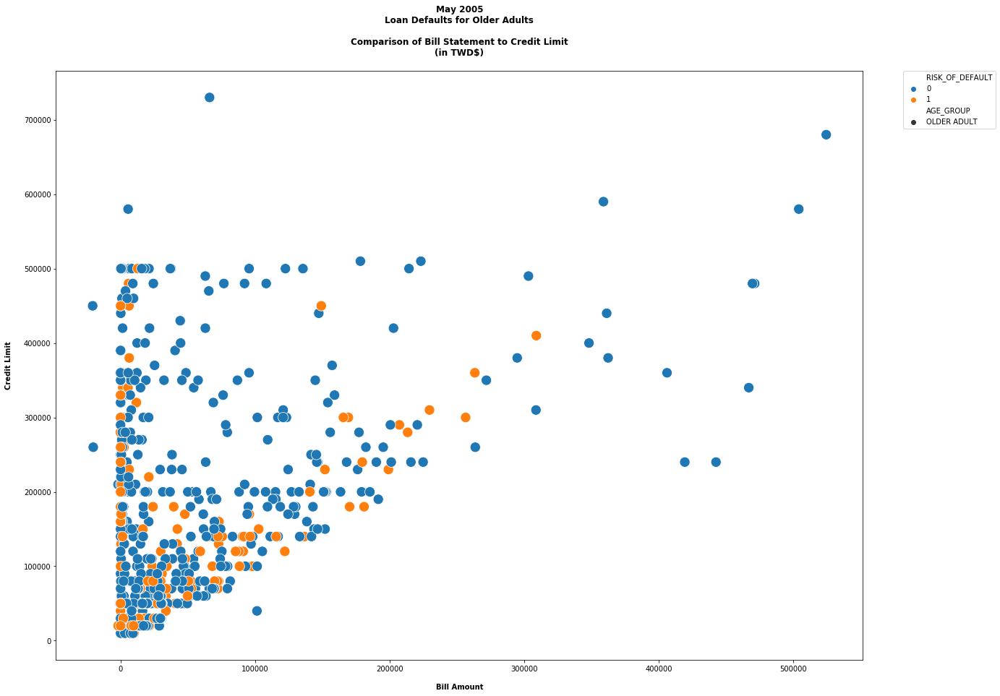

In [246]:
x = older_adult.BILL_AMT5
y = older_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('May 2005\nLoan Defaults for Older Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

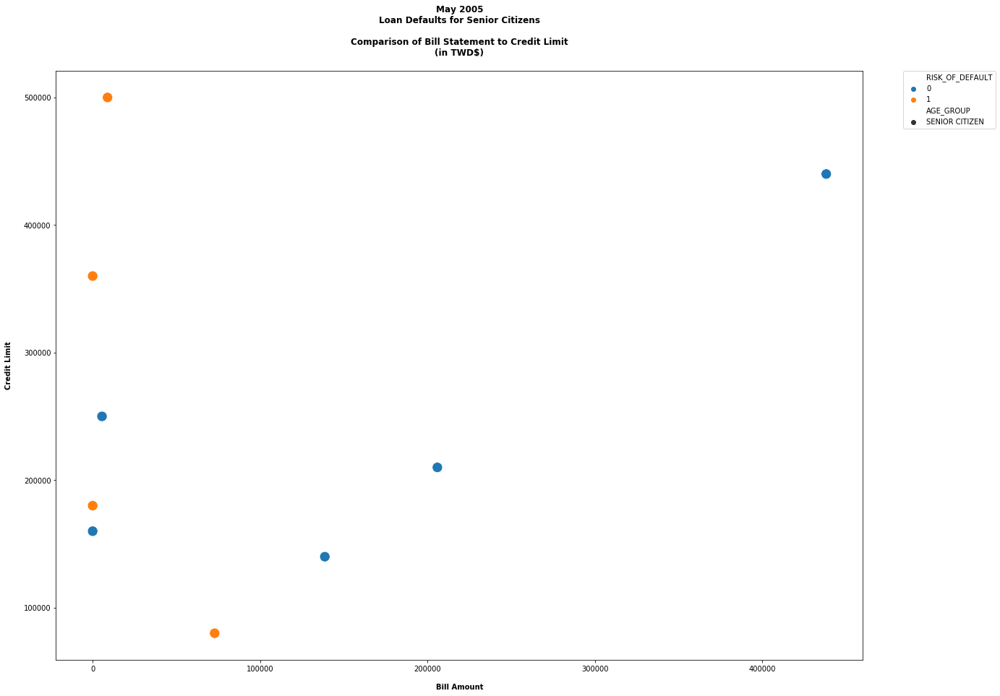

In [247]:
x = senior_citizen.BILL_AMT5
y = senior_citizen.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('May 2005\nLoan Defaults for Senior Citizens\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

## April 2005

### Line Plots

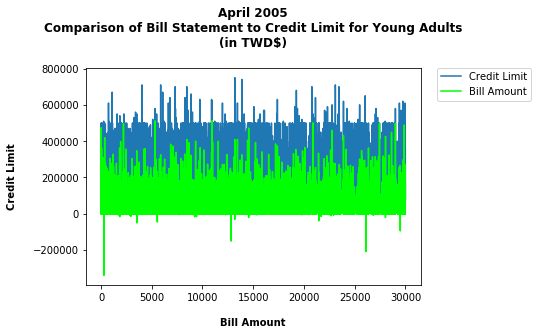

In [248]:
plt.plot(young_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(young_adult.BILL_AMT6, color = 'lime', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

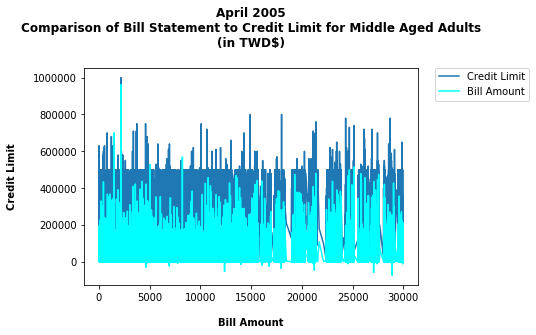

In [249]:
plt.plot(middle_age.LIMIT_BAL, label = 'Credit Limit')
plt.plot(middle_age.BILL_AMT6, color = 'cyan', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

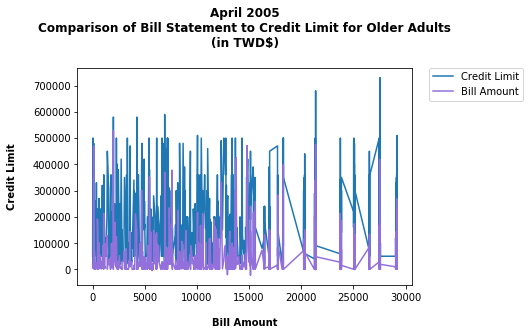

In [250]:
plt.plot(older_adult.LIMIT_BAL, label = 'Credit Limit')
plt.plot(older_adult.BILL_AMT6, color = 'mediumpurple', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

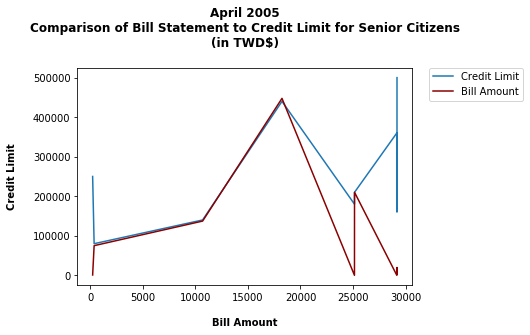

In [251]:
plt.plot(senior_citizen.LIMIT_BAL, label = 'Credit Limit')
plt.plot(senior_citizen.BILL_AMT6, color = 'darkred', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

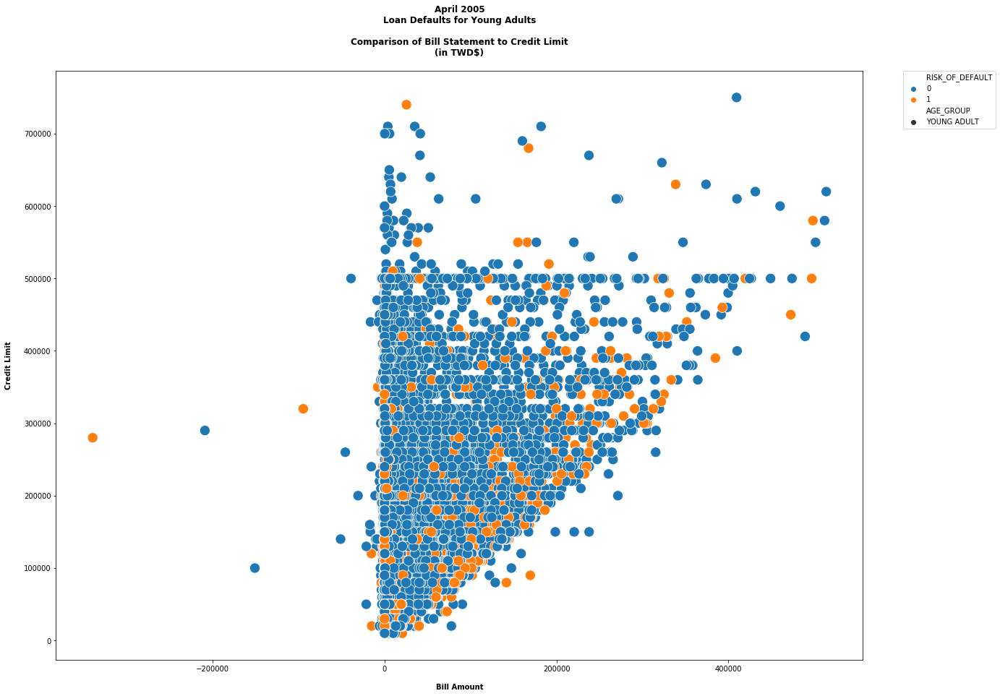

In [252]:
x = young_adult.BILL_AMT6
y = young_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('April 2005\nLoan Defaults for Young Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

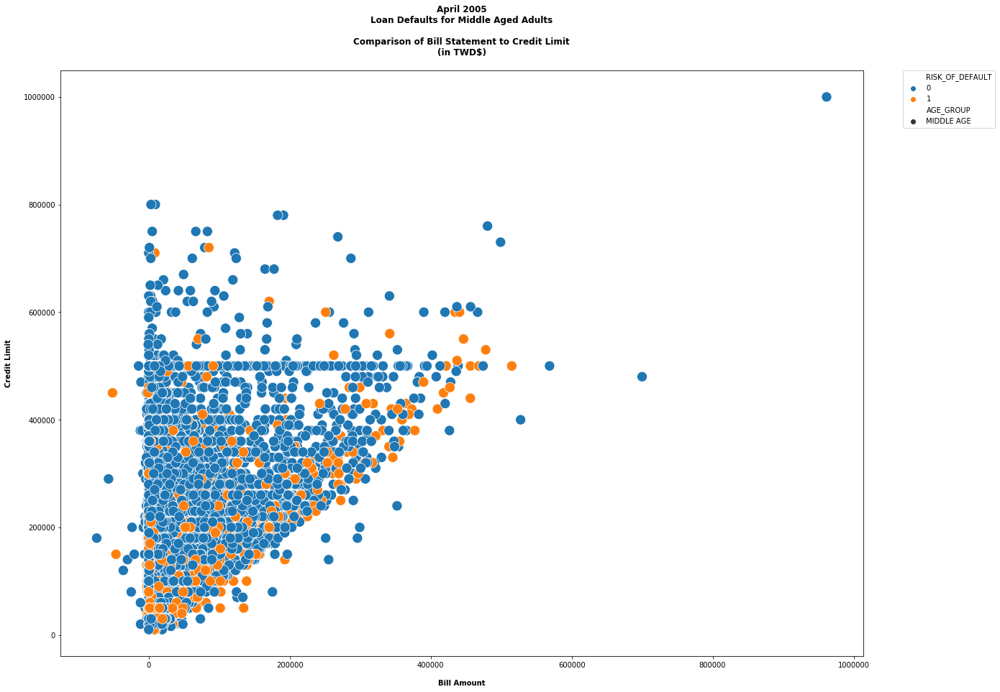

In [253]:
x = middle_age.BILL_AMT6
y = middle_age.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('April 2005\nLoan Defaults for Middle Aged Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

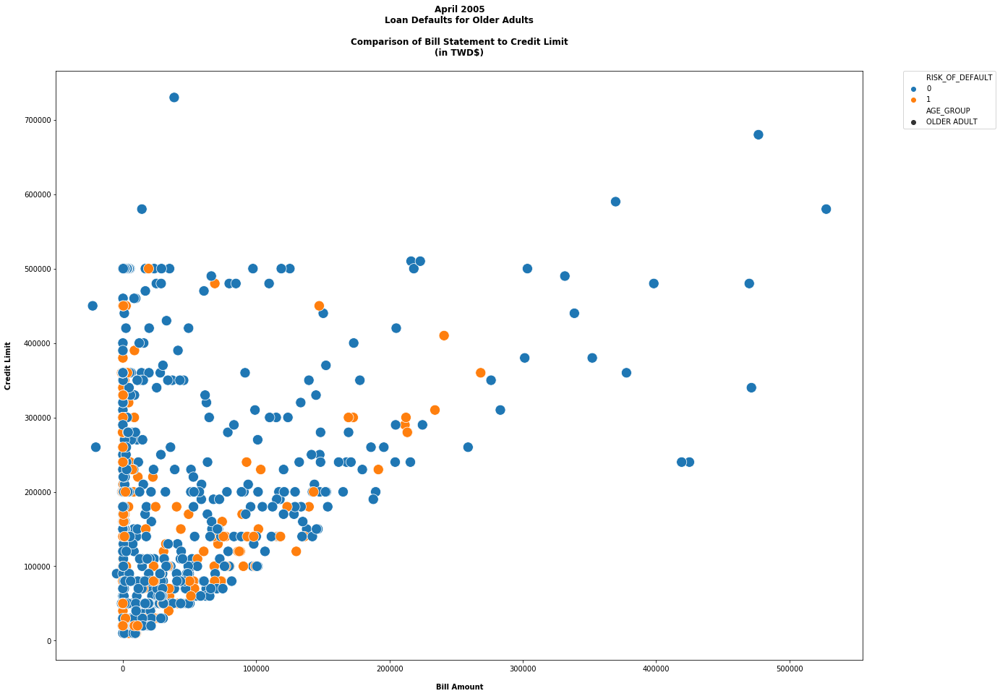

In [254]:
x = older_adult.BILL_AMT6
y = older_adult.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('April 2005\nLoan Defaults for Older Adults\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

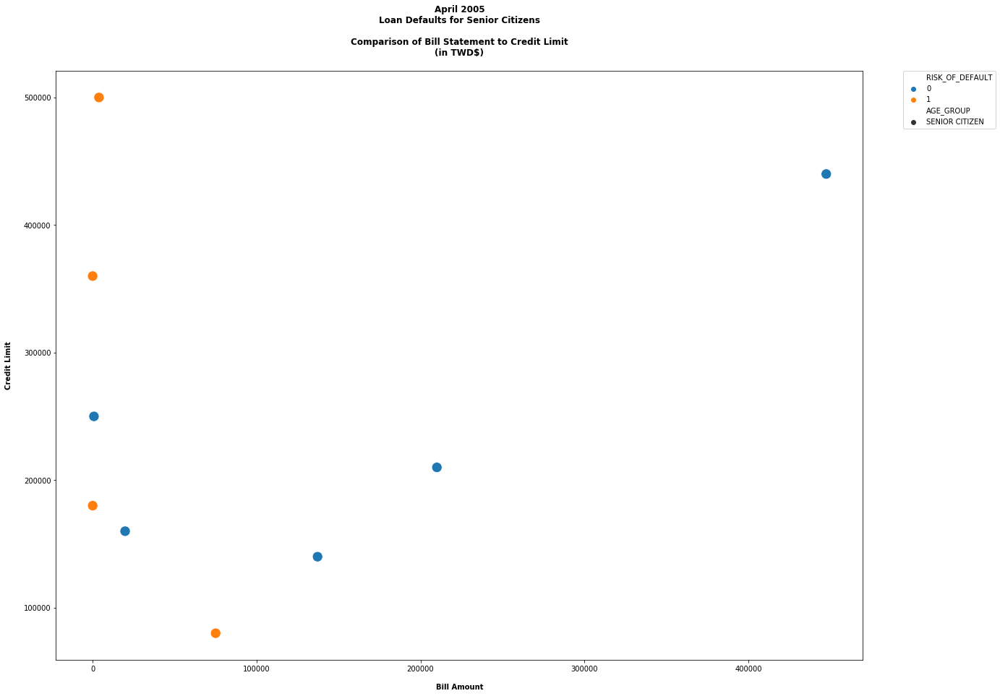

In [255]:
x = senior_citizen.BILL_AMT6
y = senior_citizen.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('April 2005\nLoan Defaults for Senior Citizens\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

# Comparing the Bill & Pay Statements by Age Group

## September 2005

### Line Plots

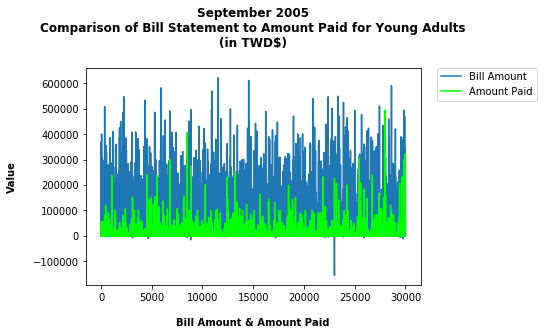

In [256]:
plt.plot(young_adult.BILL_AMT1, label = 'Bill Amount')
plt.plot(young_adult.PAY_AMT1, color = 'lime', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

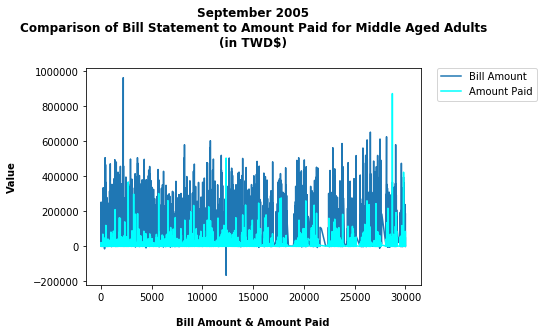

In [257]:
plt.plot(middle_age.BILL_AMT1, label = 'Bill Amount')
plt.plot(middle_age.PAY_AMT1, color = 'cyan', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

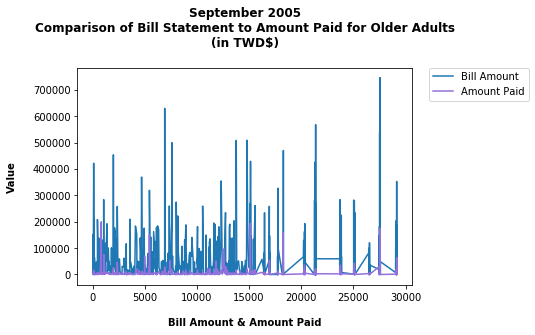

In [258]:
plt.plot(older_adult.BILL_AMT1, label = 'Bill Amount')
plt.plot(older_adult.PAY_AMT1, color = 'mediumpurple', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

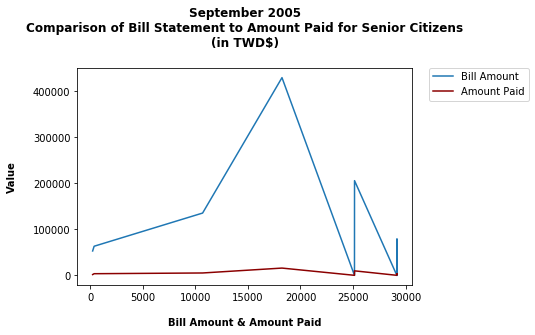

In [259]:
plt.plot(senior_citizen.BILL_AMT1, label = 'Bill Amount')
plt.plot(senior_citizen.PAY_AMT1, color = 'darkred', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

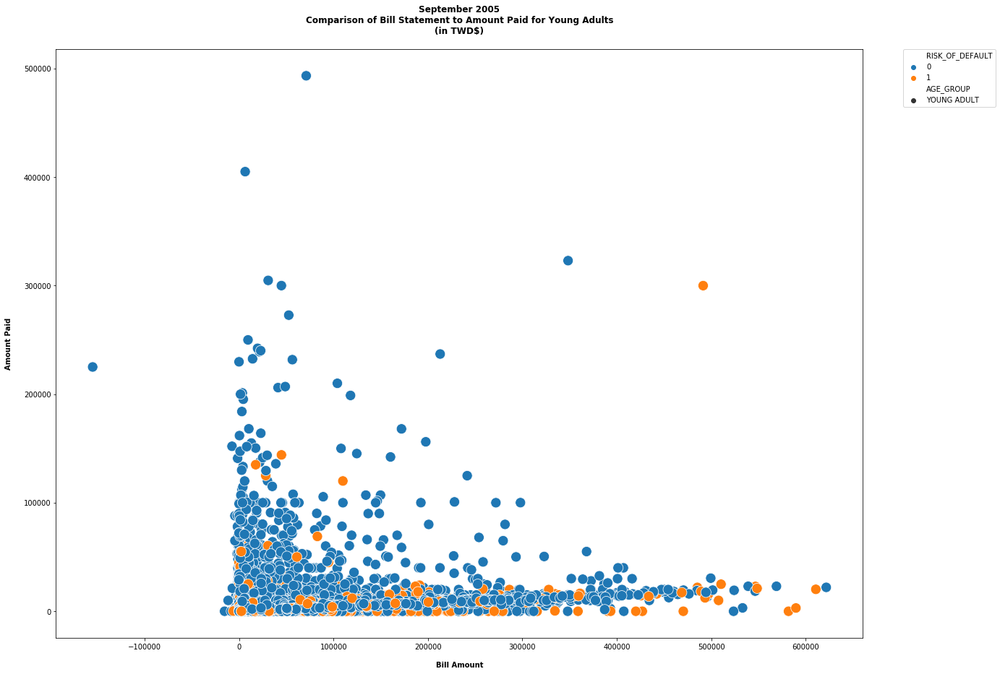

In [260]:
x = young_adult.BILL_AMT1
y = young_adult.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

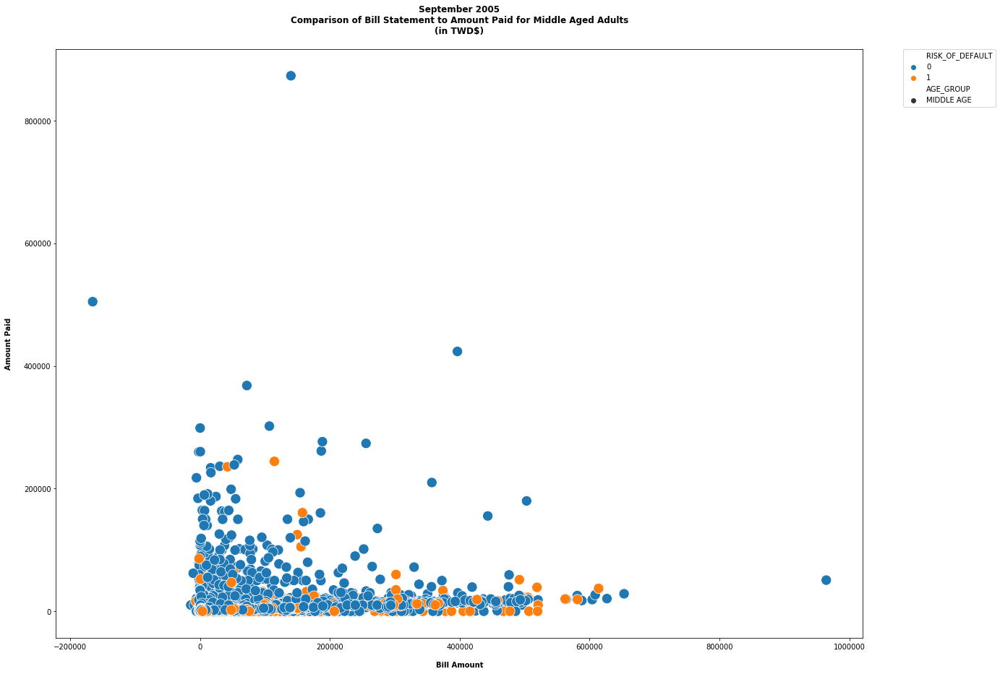

In [261]:
x = middle_age.BILL_AMT1
y = middle_age.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

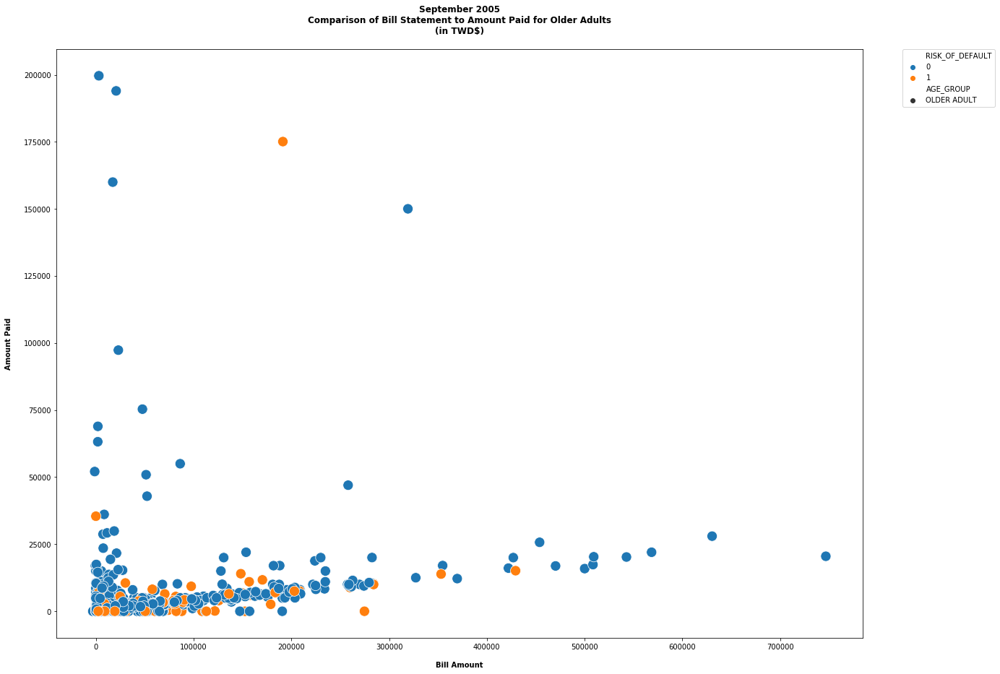

In [262]:
x = older_adult.BILL_AMT1
y = older_adult.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

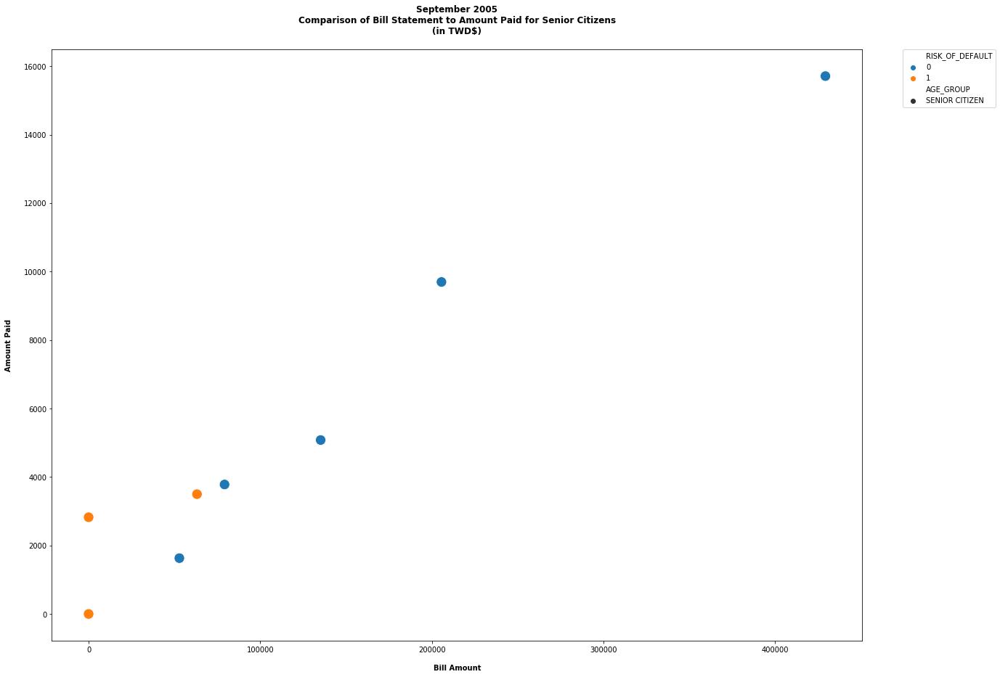

In [263]:
x = senior_citizen.BILL_AMT1
y = senior_citizen.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

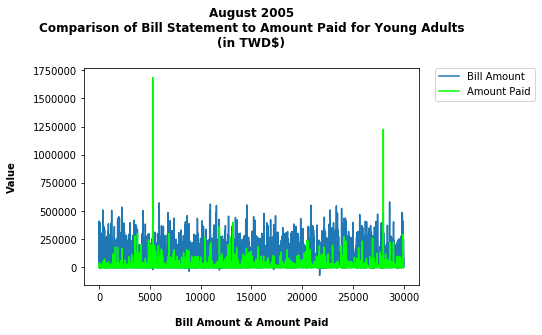

In [264]:
plt.plot(young_adult.BILL_AMT2, label = 'Bill Amount')
plt.plot(young_adult.PAY_AMT2, color = 'lime', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

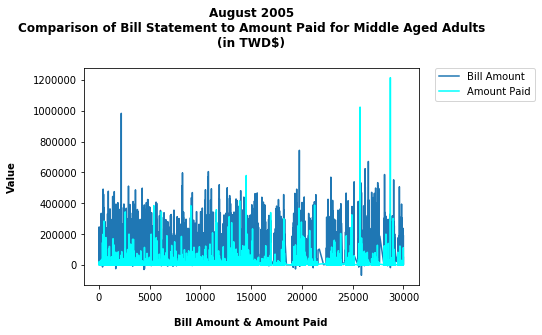

In [265]:
plt.plot(middle_age.BILL_AMT2, label = 'Bill Amount')
plt.plot(middle_age.PAY_AMT2, color = 'cyan', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

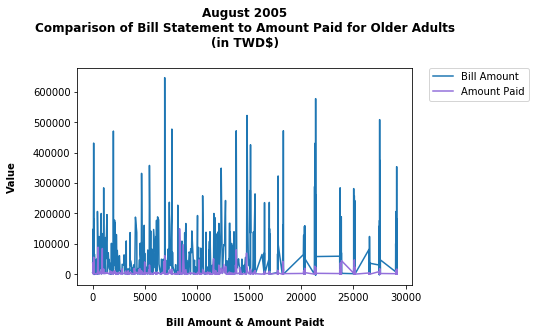

In [266]:
plt.plot(older_adult.BILL_AMT2, label = 'Bill Amount')
plt.plot(older_adult.PAY_AMT2, color = 'mediumpurple', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paidt',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

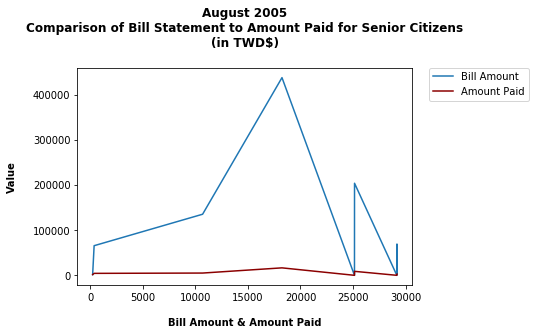

In [267]:
plt.plot(senior_citizen.BILL_AMT2, label = 'Bill Amount')
plt.plot(senior_citizen.PAY_AMT2, color = 'darkred', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

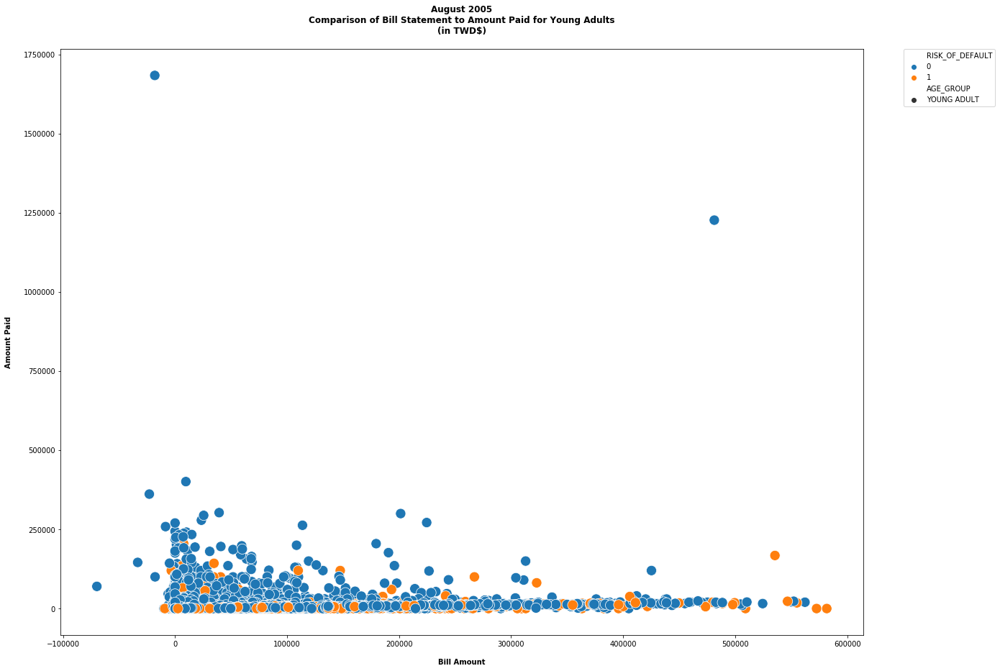

In [268]:
x = young_adult.BILL_AMT2
y = young_adult.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

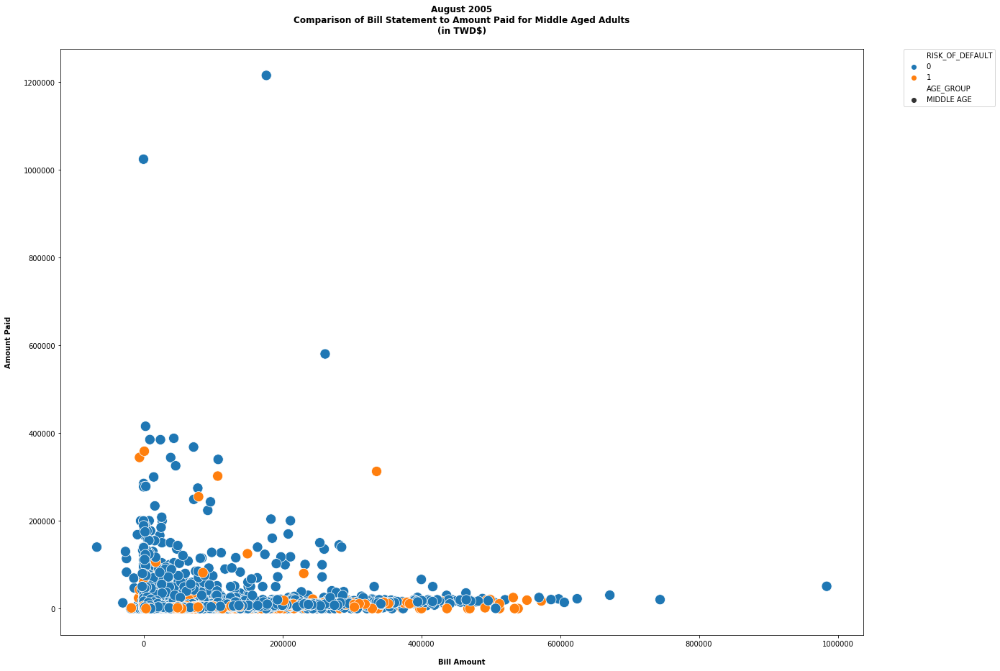

In [269]:
x = middle_age.BILL_AMT2
y = middle_age.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

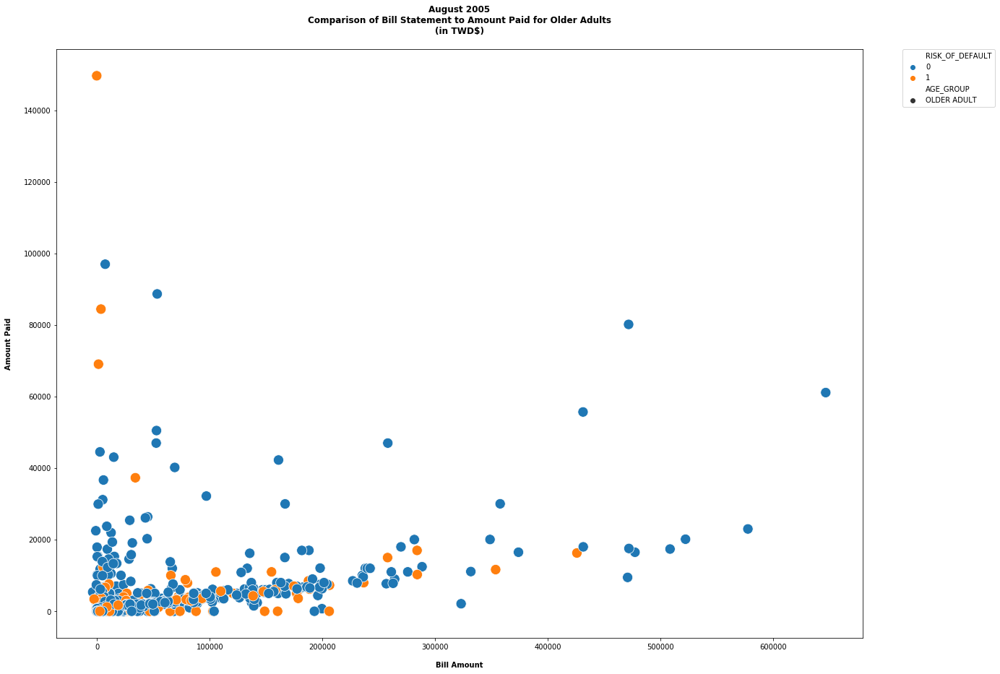

In [270]:
x = older_adult.BILL_AMT2
y = older_adult.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

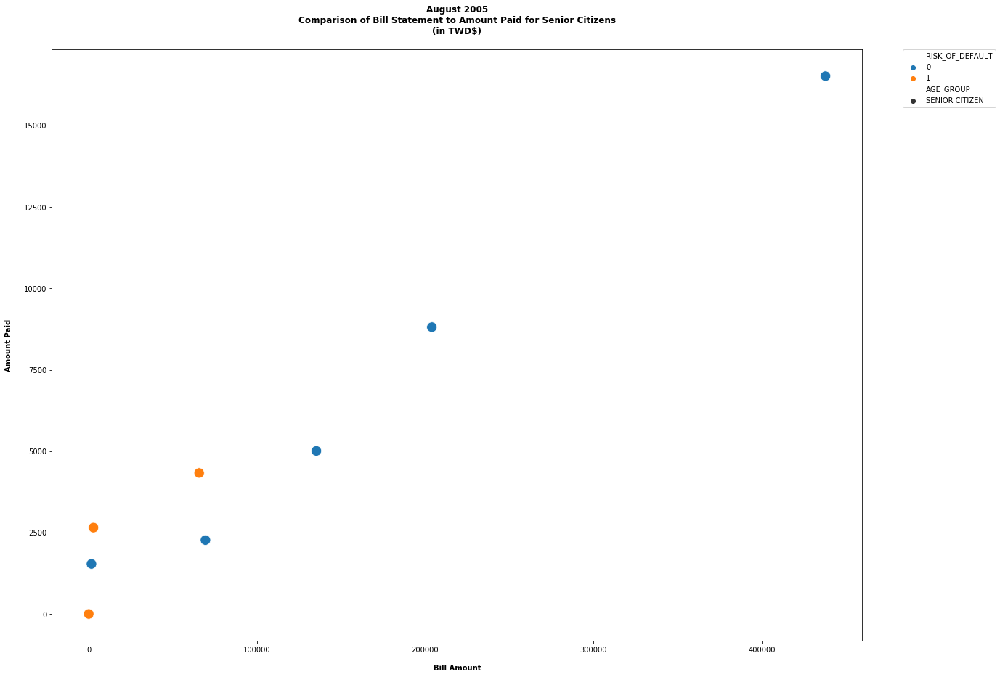

In [271]:
x = senior_citizen.BILL_AMT2
y = senior_citizen.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

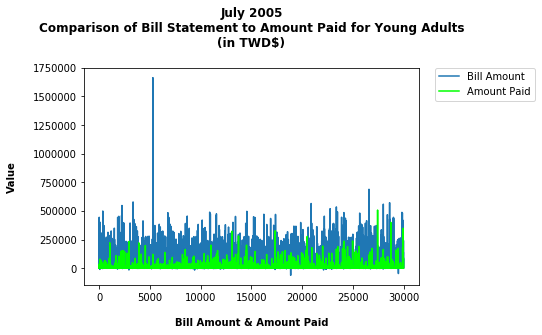

In [272]:
plt.plot(young_adult.BILL_AMT3, label = 'Bill Amount')
plt.plot(young_adult.PAY_AMT3, color = 'lime', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

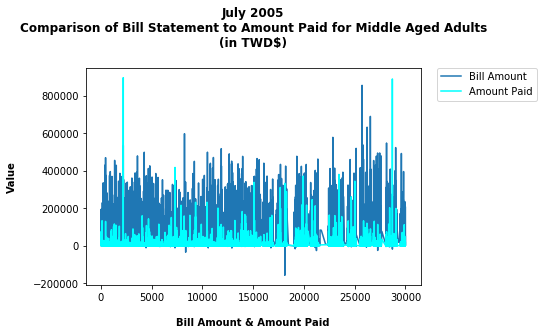

In [273]:
plt.plot(middle_age.BILL_AMT3, label = 'Bill Amount')
plt.plot(middle_age.PAY_AMT3, color = 'cyan', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

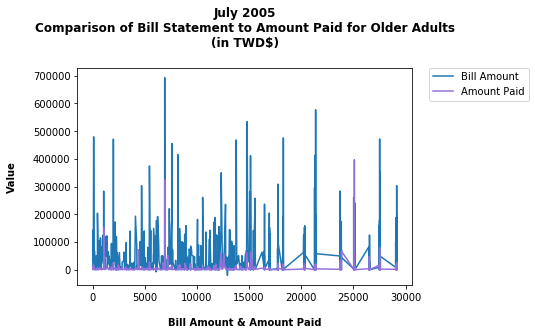

In [274]:
plt.plot(older_adult.BILL_AMT3, label = 'Bill Amount')
plt.plot(older_adult.PAY_AMT3, color = 'mediumpurple', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

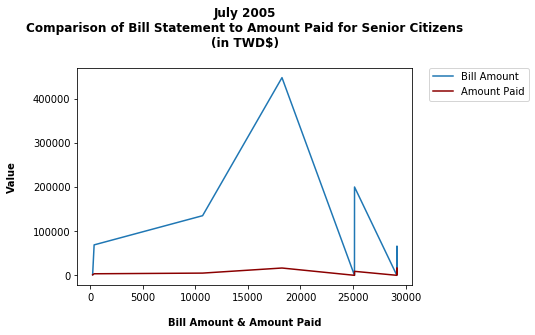

In [275]:
plt.plot(senior_citizen.BILL_AMT3, label = 'Bill Amount')
plt.plot(senior_citizen.PAY_AMT3, color = 'darkred', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

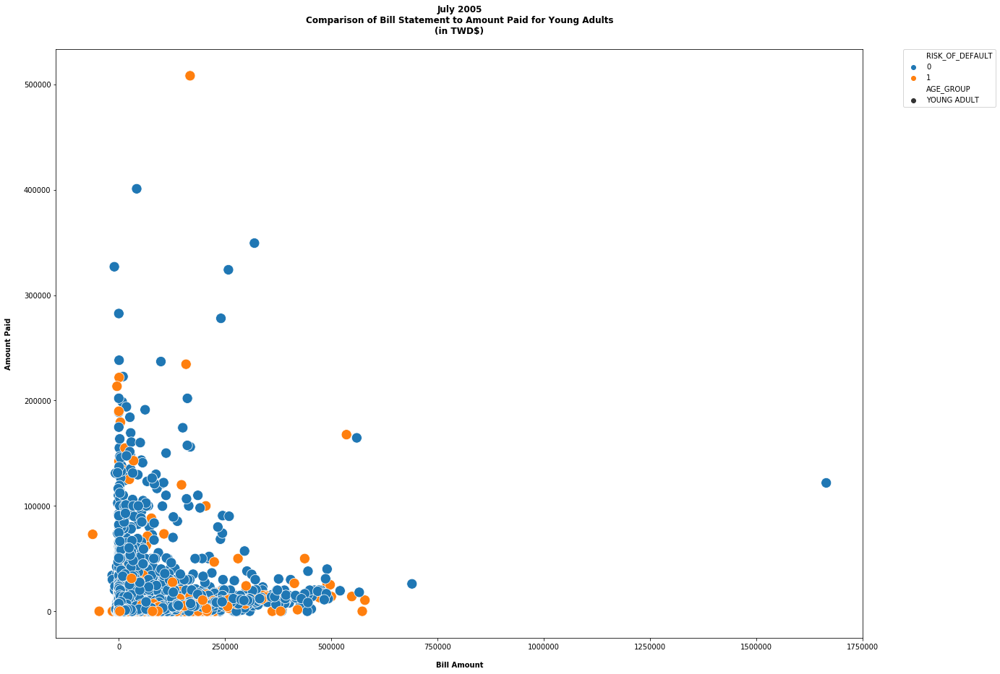

In [276]:
x = young_adult.BILL_AMT3
y = young_adult.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

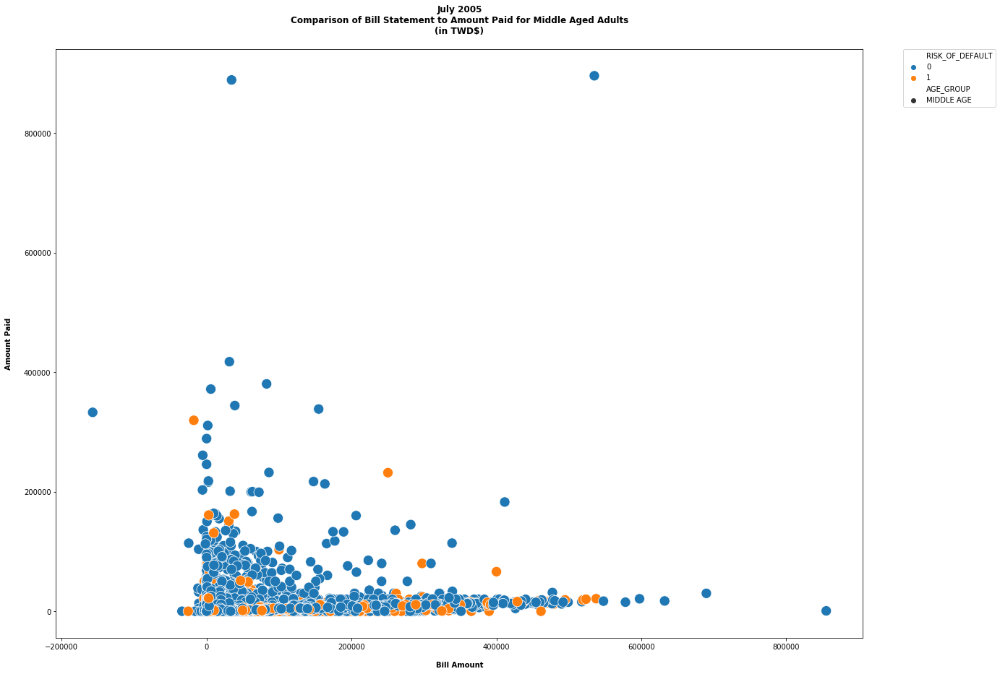

In [277]:
x = middle_age.BILL_AMT3
y = middle_age.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

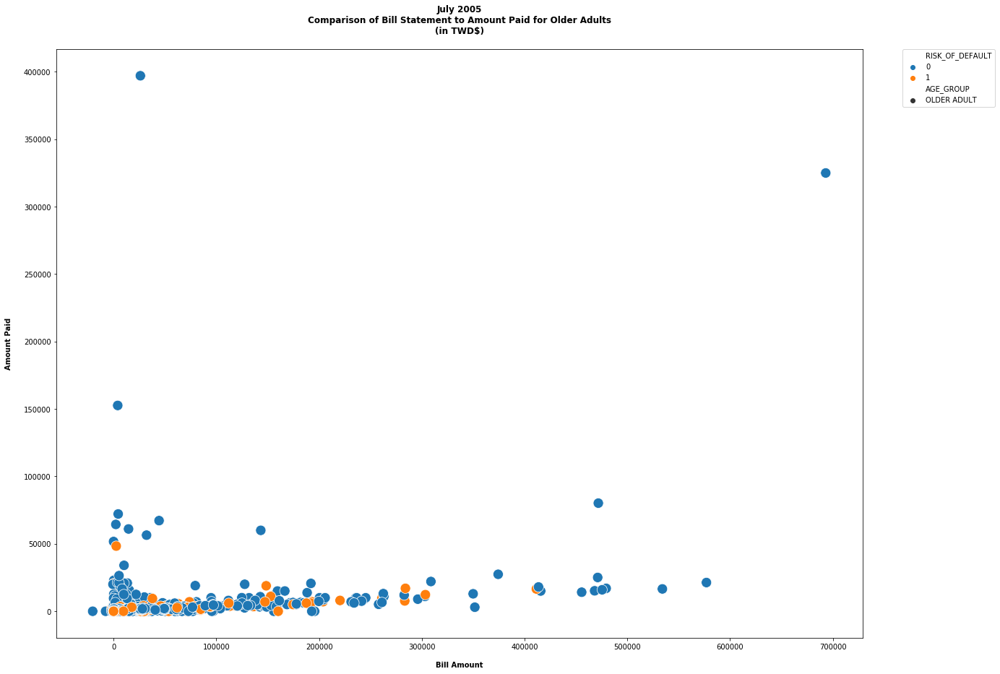

In [278]:
x = older_adult.BILL_AMT3
y = older_adult.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

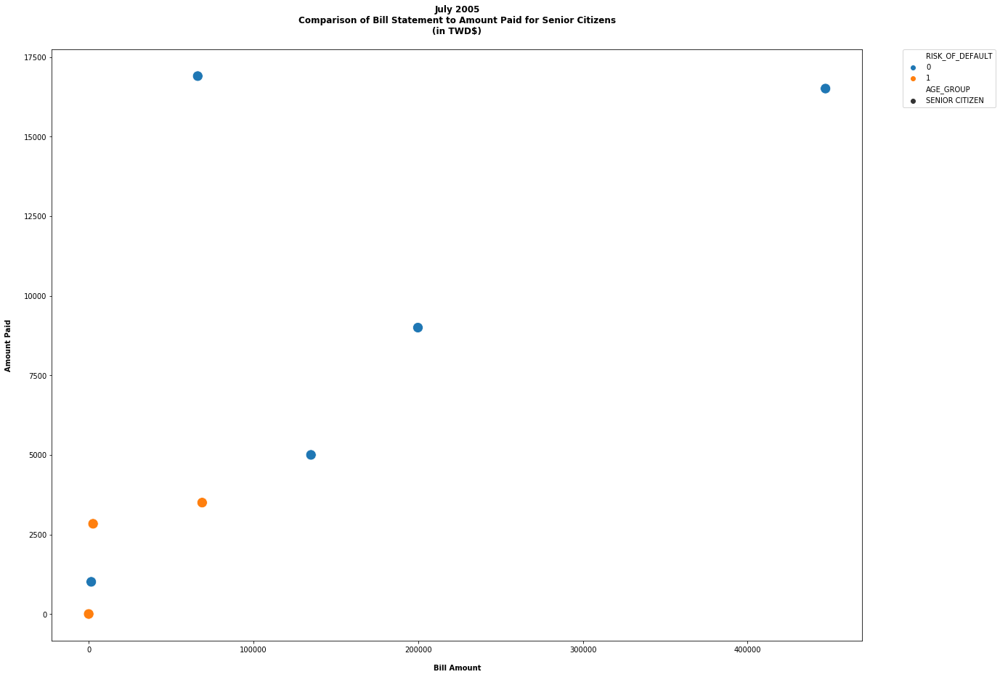

In [279]:
x = senior_citizen.BILL_AMT3
y = senior_citizen.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

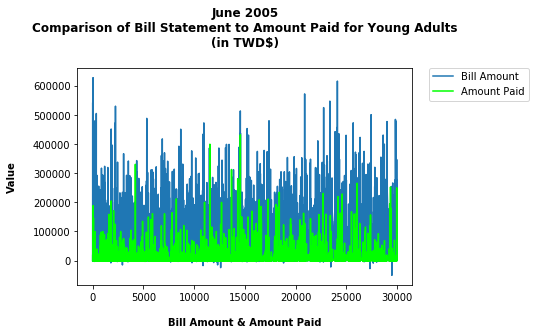

In [280]:
plt.plot(young_adult.BILL_AMT4, label = 'Bill Amount')
plt.plot(young_adult.PAY_AMT4, color = 'lime', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

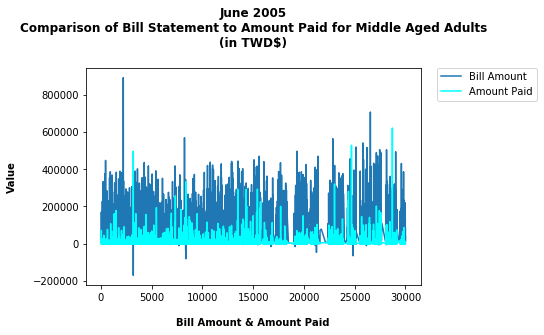

In [281]:
plt.plot(middle_age.BILL_AMT4, label = 'Bill Amount')
plt.plot(middle_age.PAY_AMT4, color = 'cyan', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

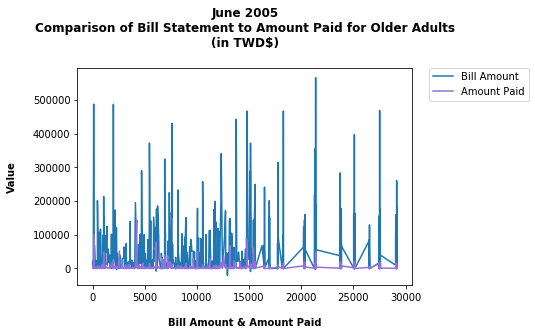

In [282]:
plt.plot(older_adult.BILL_AMT4, label = 'Bill Amount')
plt.plot(older_adult.PAY_AMT4, color = 'mediumpurple', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

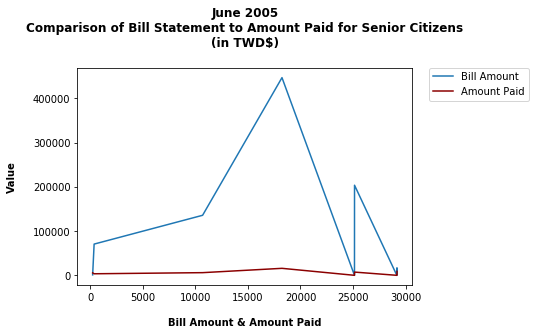

In [283]:
plt.plot(senior_citizen.BILL_AMT4, label = 'Bill Amount')
plt.plot(senior_citizen.PAY_AMT4, color = 'darkred', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

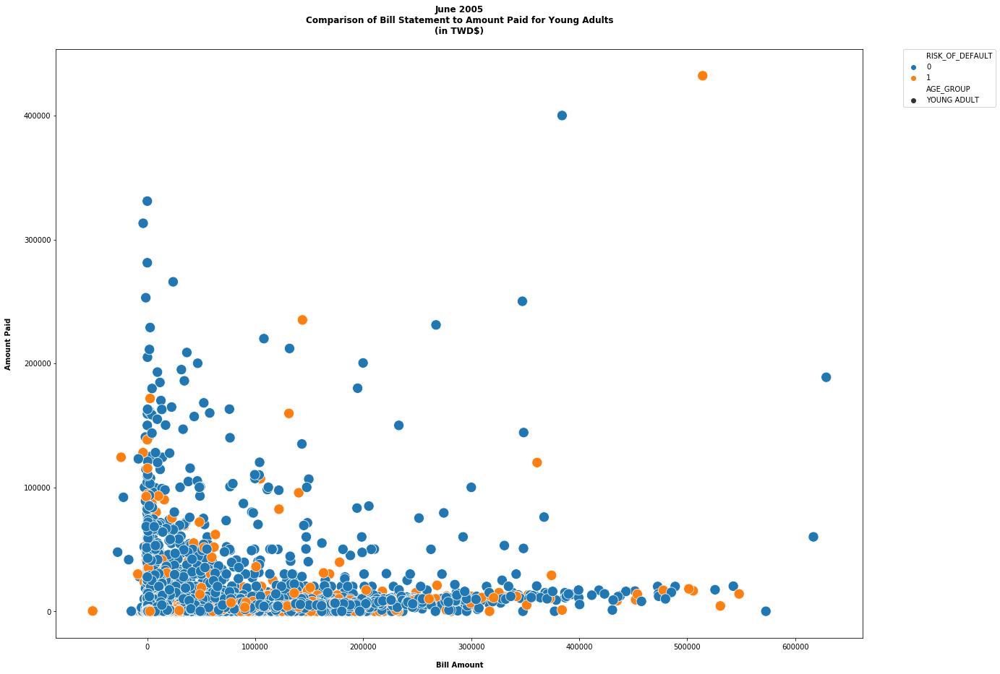

In [284]:
x = young_adult.BILL_AMT4
y = young_adult.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

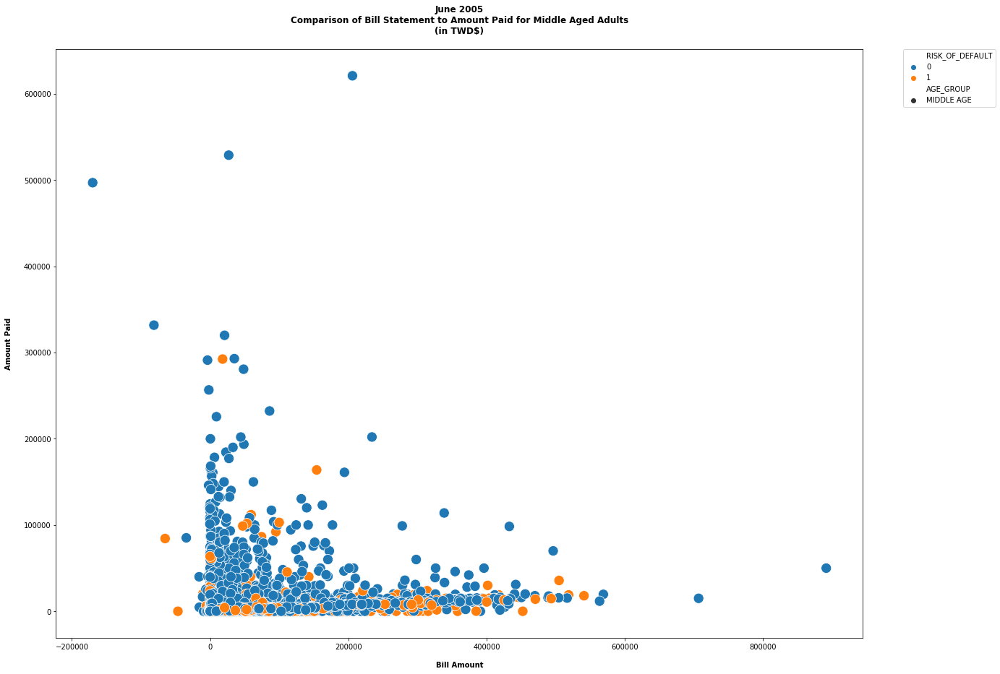

In [285]:
x = middle_age.BILL_AMT4
y = middle_age.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

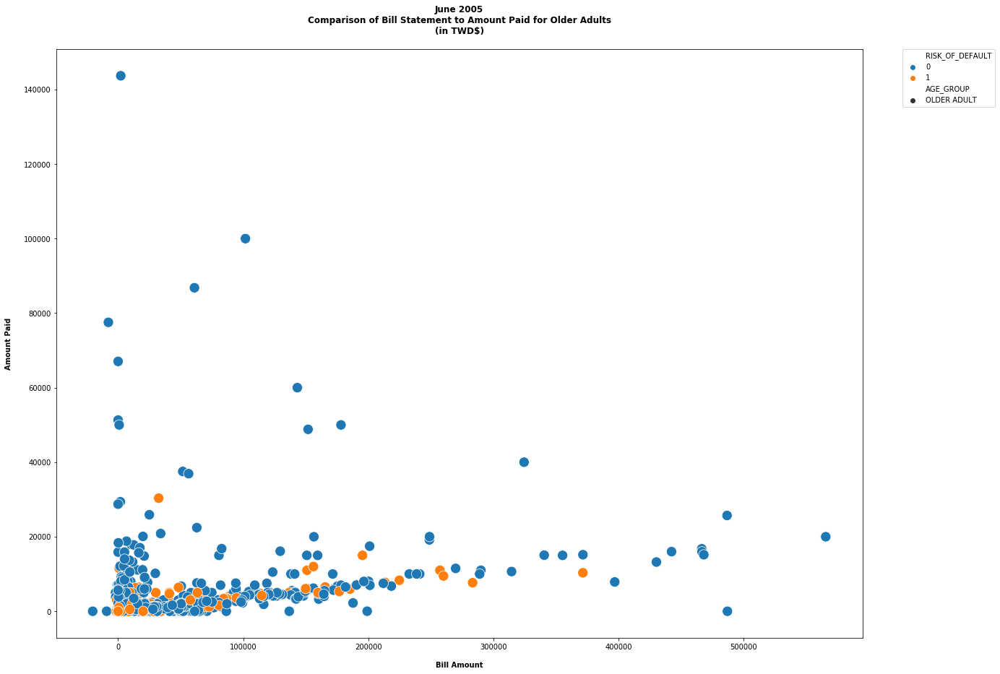

In [286]:
x = older_adult.BILL_AMT4
y = older_adult.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

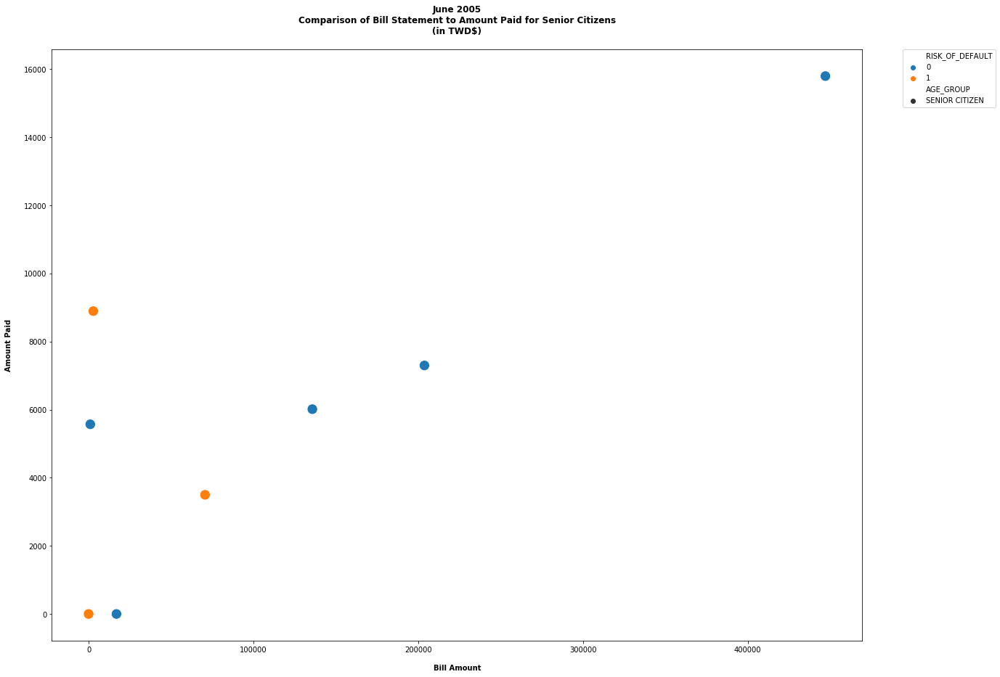

In [287]:
x = senior_citizen.BILL_AMT4
y = senior_citizen.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

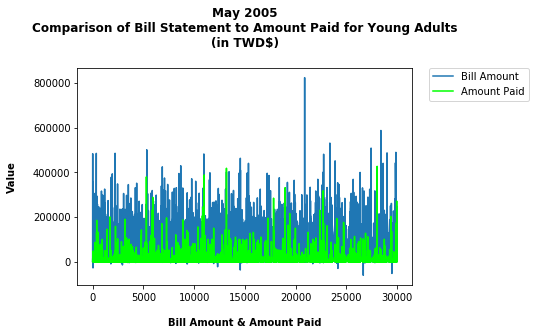

In [288]:
plt.plot(young_adult.BILL_AMT5, label = 'Bill Amount')
plt.plot(young_adult.PAY_AMT5, color = 'lime', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

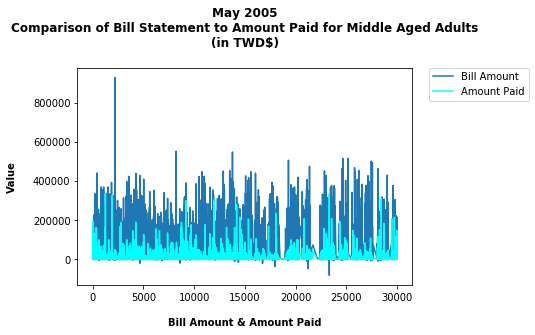

In [289]:
plt.plot(middle_age.BILL_AMT5, label = 'Bill Amount')
plt.plot(middle_age.PAY_AMT5, color = 'cyan', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

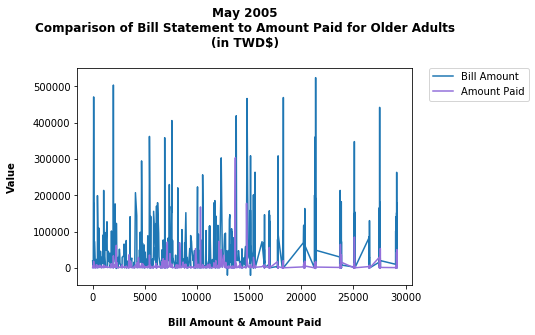

In [290]:
plt.plot(older_adult.BILL_AMT5, label = 'Bill Amount')
plt.plot(older_adult.PAY_AMT5, color = 'mediumpurple', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

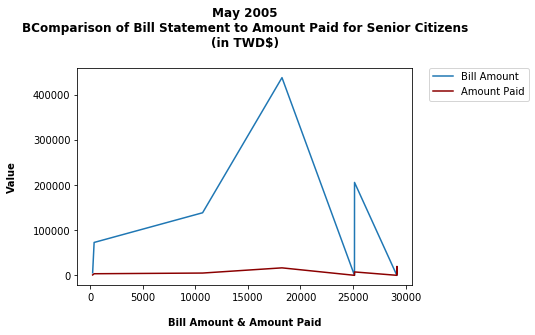

In [291]:
plt.plot(senior_citizen.BILL_AMT5, label = 'Bill Amount')
plt.plot(senior_citizen.PAY_AMT5, color = 'darkred', label = 'Amount Paid')

plt.title('May 2005\nBComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

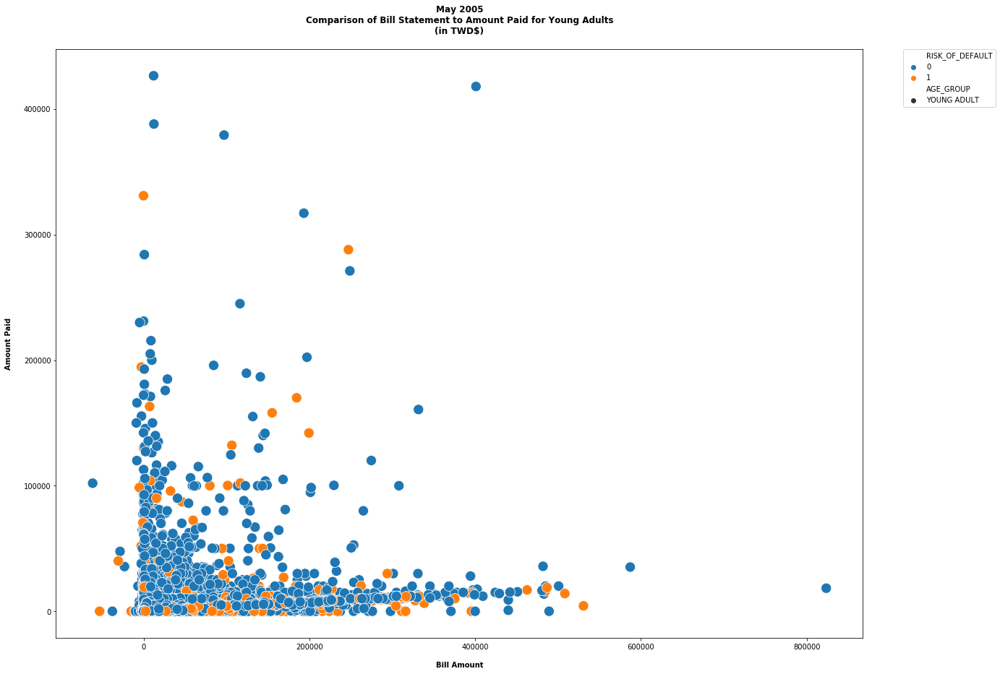

In [292]:
x = young_adult.BILL_AMT5
y = young_adult.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

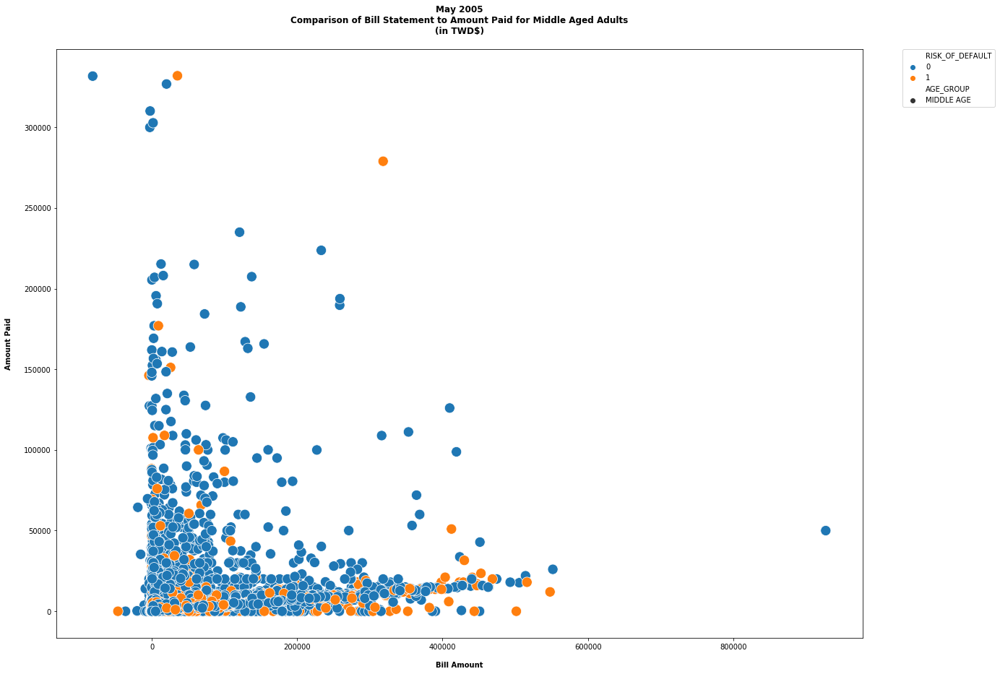

In [293]:
x = middle_age.BILL_AMT5
y = middle_age.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

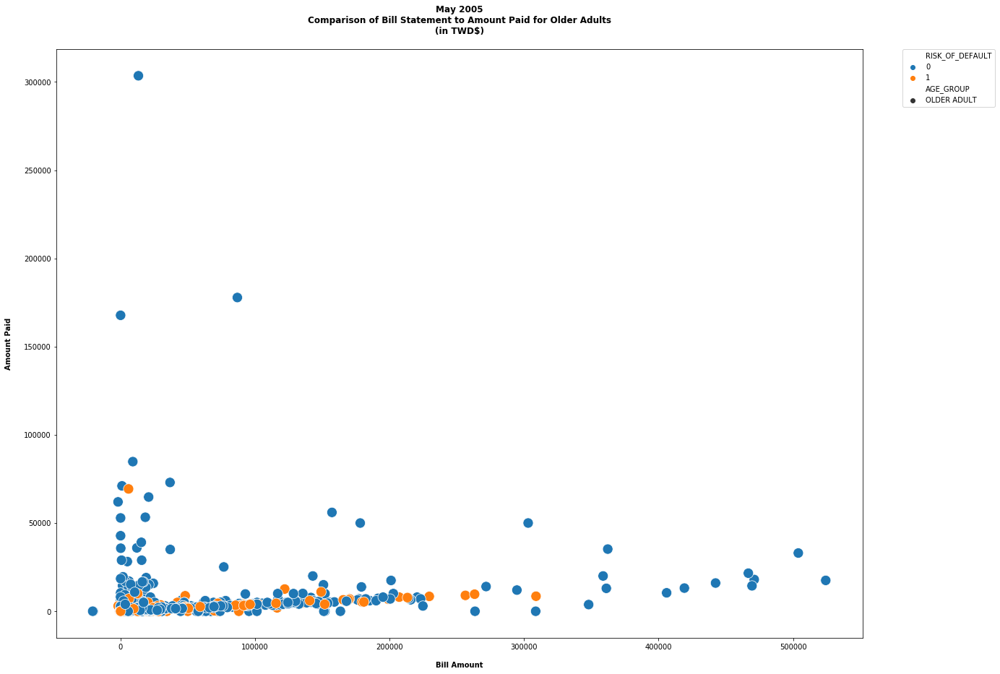

In [294]:
x = older_adult.BILL_AMT5
y = older_adult.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

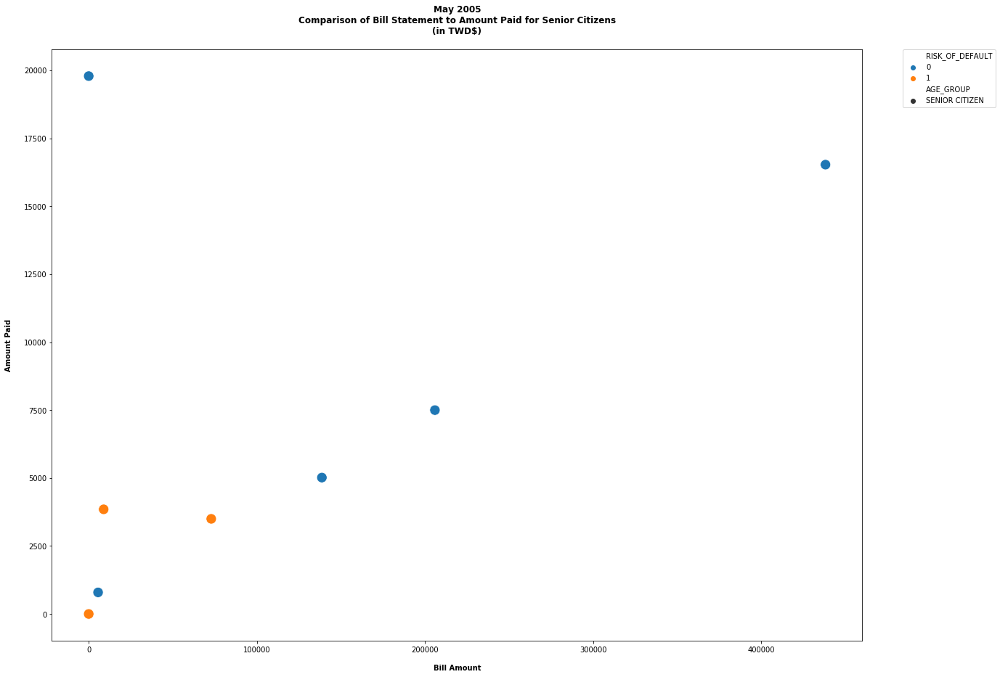

In [295]:
x = senior_citizen.BILL_AMT5
y = senior_citizen.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

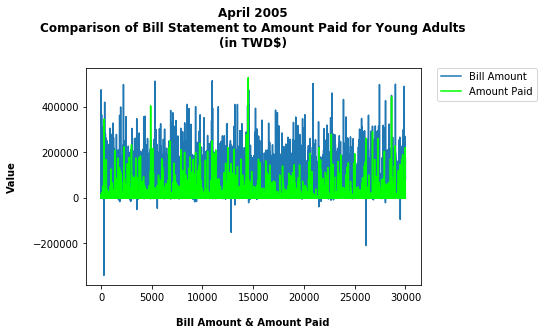

In [296]:
plt.plot(young_adult.BILL_AMT6, label = 'Bill Amount')
plt.plot(young_adult.PAY_AMT6, color = 'lime', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

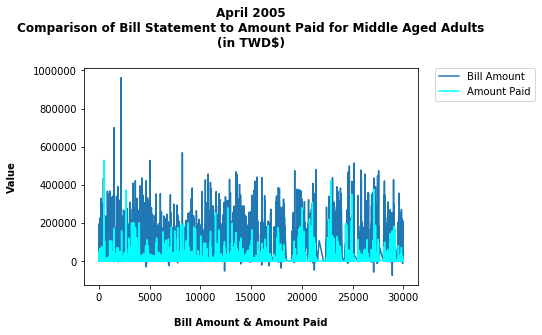

In [297]:
plt.plot(middle_age.BILL_AMT6, label = 'Bill Amount')
plt.plot(middle_age.PAY_AMT6, color = 'cyan', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

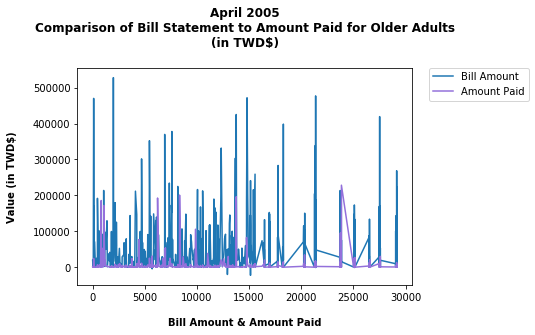

In [298]:
plt.plot(older_adult.BILL_AMT6, label = 'Bill Amount')
plt.plot(older_adult.PAY_AMT6, color = 'mediumpurple', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value (in TWD$)\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

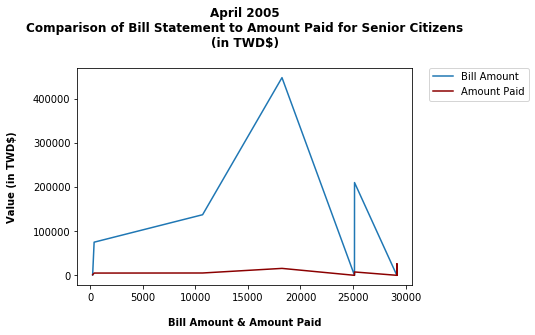

In [299]:
plt.plot(senior_citizen.BILL_AMT6, label = 'Bill Amount')
plt.plot(senior_citizen.PAY_AMT6, color = 'darkred', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value (in TWD$)\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

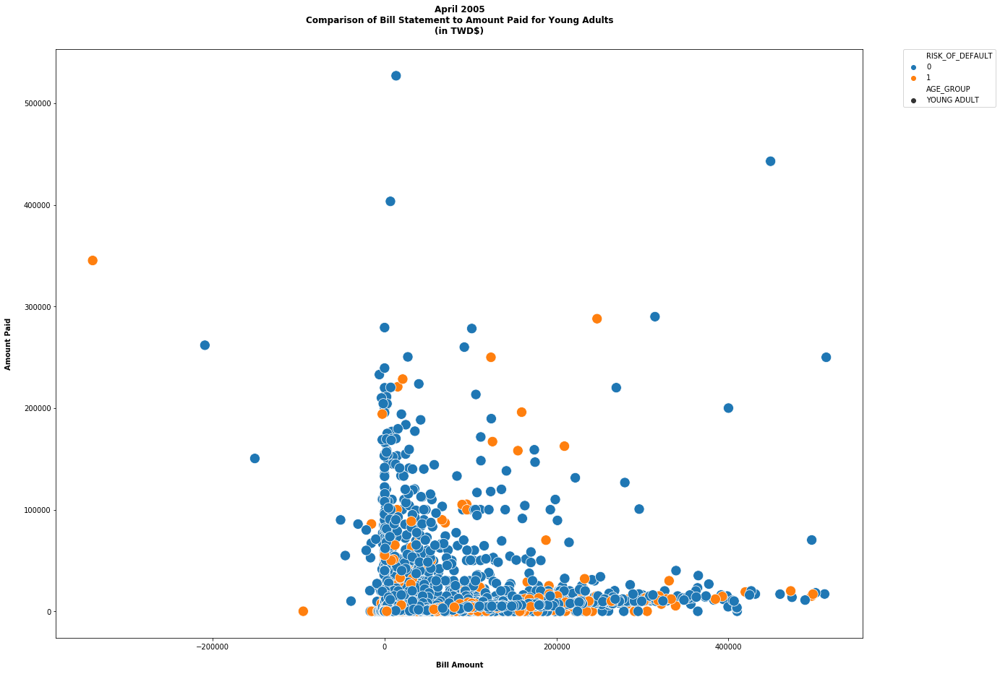

In [300]:
x = young_adult.BILL_AMT6
y = young_adult.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = young_adult)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Young Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

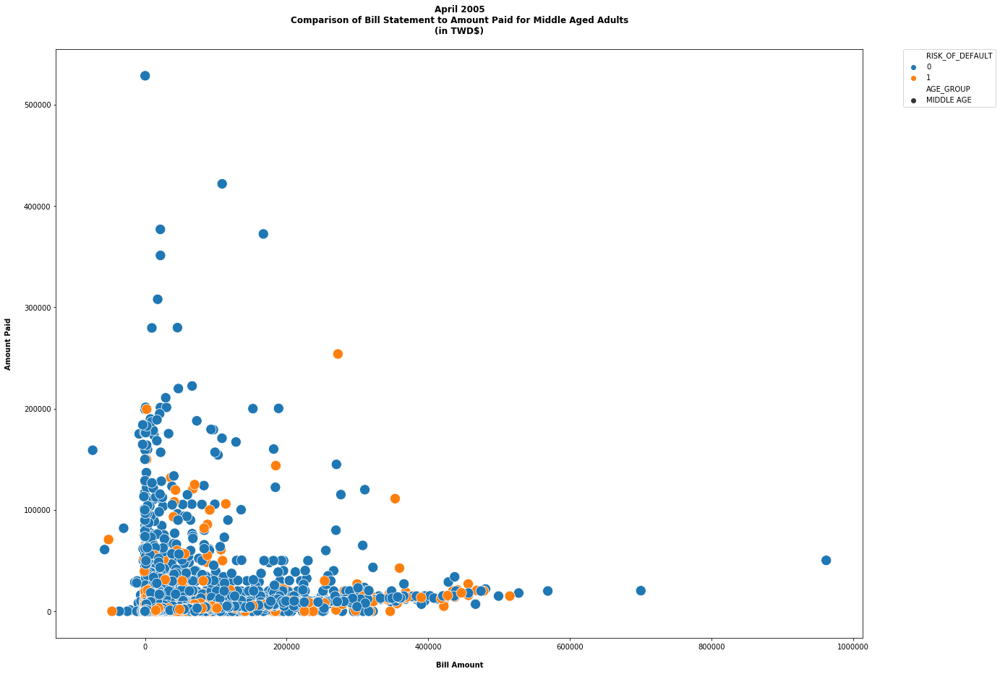

In [301]:
x = middle_age.BILL_AMT6
y = middle_age.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = middle_age)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Middle Aged Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

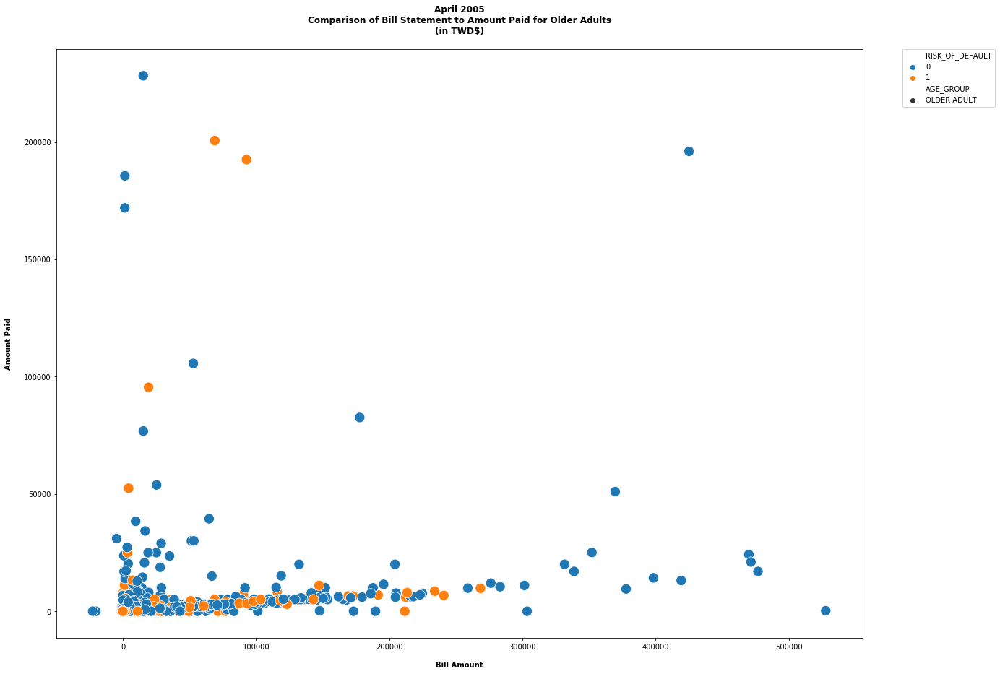

In [302]:
x = older_adult.BILL_AMT6
y = older_adult.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = older_adult)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Older Adults\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

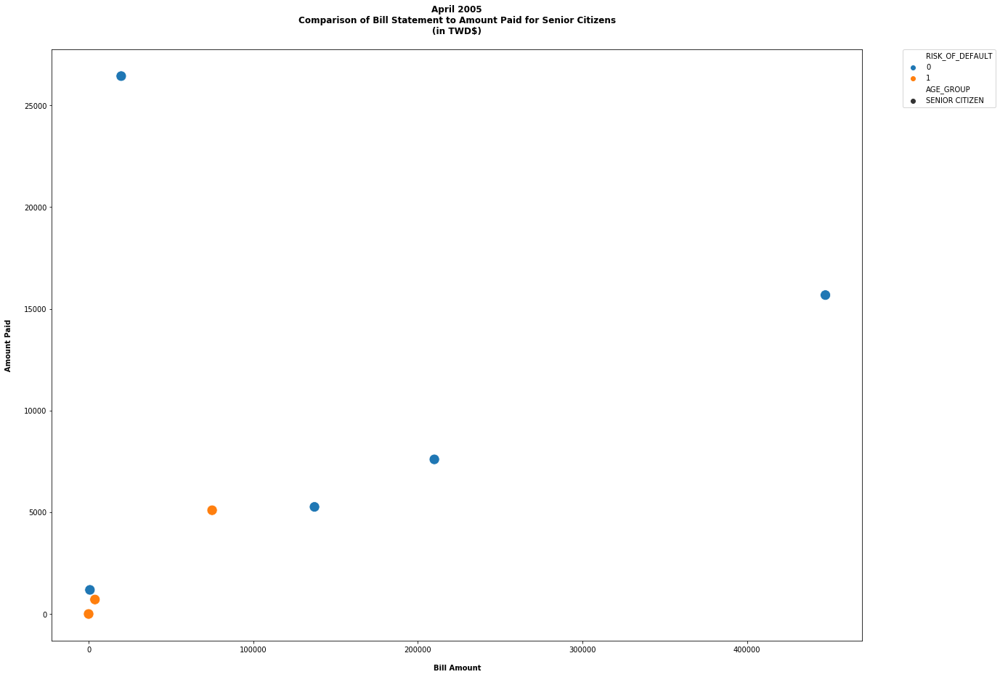

In [303]:
x = senior_citizen.BILL_AMT6
y = senior_citizen.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'AGE_GROUP', s = 200, data = senior_citizen)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Senior Citizens\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

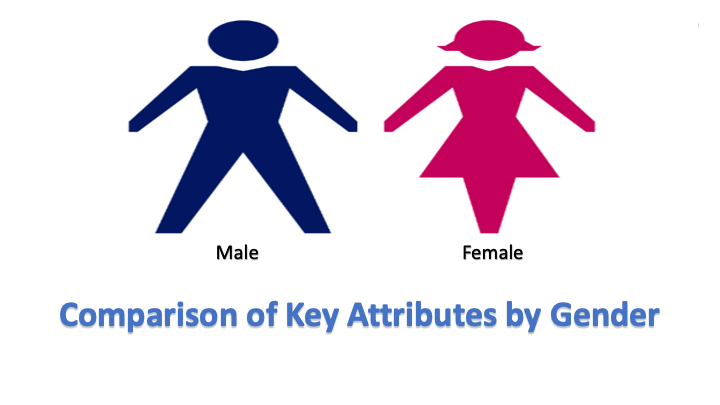

In [304]:
from IPython.display import Image
Image('Gender.png')

# Distribution of Gender

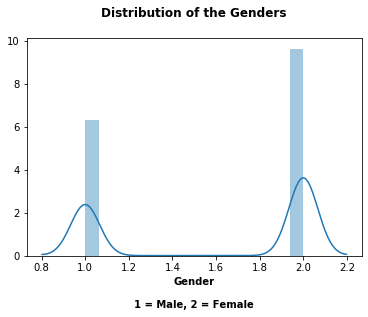

GENDER
MALE      11888
FEMALE    18112
Name: RISK_OF_DEFAULT, dtype: int64

In [305]:
gd = sns.distplot(binned_credit['SEX'])
gd.set_title("Distribution of the Genders\n", fontweight = 'bold')

plt.xlabel("Gender\n\n1 = Male, 2 = Female", fontweight = 'bold')

plt.show()


binned_credit.groupby('GENDER')['RISK_OF_DEFAULT'].count()




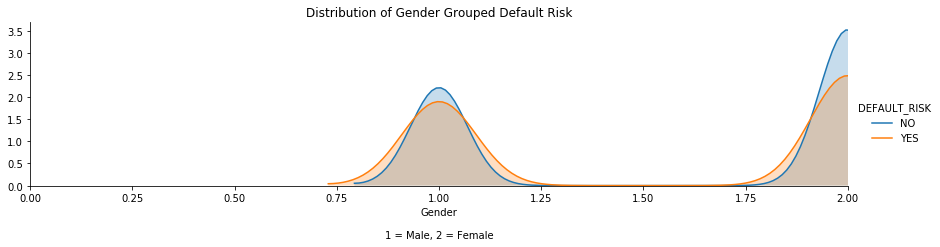

In [306]:
fig = sns.FacetGrid(binned_credit, hue='DEFAULT_RISK', aspect=4)
fig.map(sns.kdeplot, 'SEX', shade=True)
oldest = binned_credit['SEX'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Gender Grouped Default Risk')
fig.add_legend()
plt.xlabel('Gender\n\n1 = Male, 2 = Female')

plt.show()

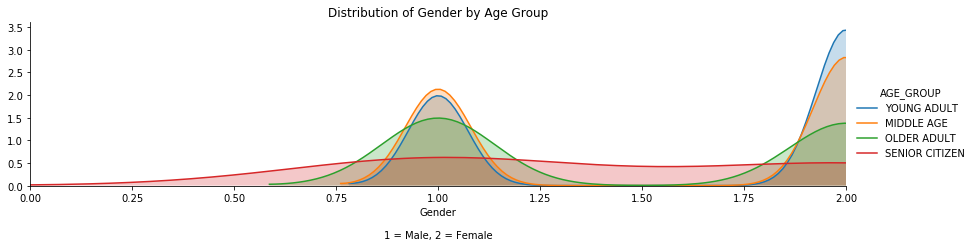

In [307]:
fig = sns.FacetGrid(binned_credit, hue='AGE_GROUP', aspect=4)
fig.map(sns.kdeplot, 'SEX', shade=True)
oldest = binned_credit['SEX'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Gender by Age Group')
fig.add_legend()
plt.xlabel('Gender\n\n1 = Male, 2 = Female')

plt.show()

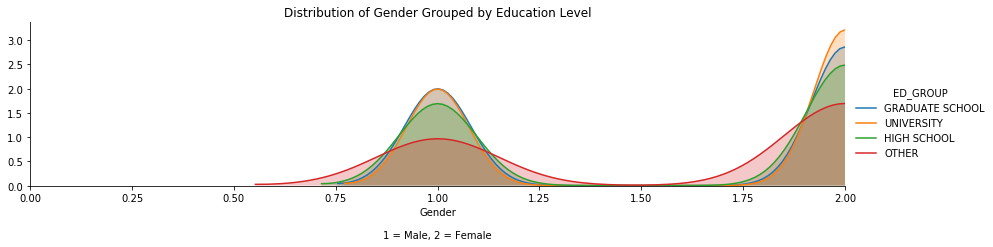

In [308]:
fig = sns.FacetGrid(binned_credit, hue='ED_GROUP', aspect=4)
fig.map(sns.kdeplot, 'SEX', shade=True)
oldest = binned_credit['SEX'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Gender Grouped by Education Level')
fig.add_legend()
plt.xlabel('Gender\n\n1 = Male, 2 = Female')

plt.show()

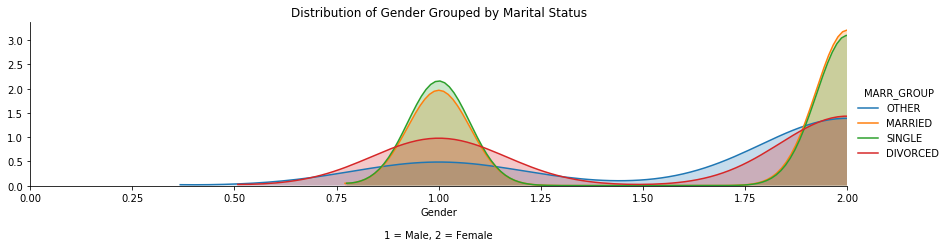

In [309]:
fig = sns.FacetGrid(binned_credit, hue='MARR_GROUP', aspect=4)
fig.map(sns.kdeplot, 'SEX', shade=True)
oldest = binned_credit['SEX'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Gender Grouped by Marital Status')
fig.add_legend()
plt.xlabel('Gender\n\n1 = Male, 2 = Female')

plt.show()

# Counting the Number of Defaults per Gender

In [310]:
default_gender = binned_credit.loc[binned_credit['DEFAULT_RISK'] == "YES"]
default_gender.groupby('GENDER')['RISK_OF_DEFAULT'].count()

GENDER
MALE      2873
FEMALE    3763
Name: RISK_OF_DEFAULT, dtype: int64

In [311]:
title = '\nNumber of People at Risk of Default by Gender'

bolded_string = "\033[1m" + title + "\033[0m"

print(bolded_string)

default_gender.pivot_table('RISK_OF_DEFAULT', 'SEX', aggfunc = pd.value_counts, margins = True)


Number of People at Risk of Default by Gender


,RISK_OF_DEFAULT
SEX,
1,2873
2,3763
All,6636


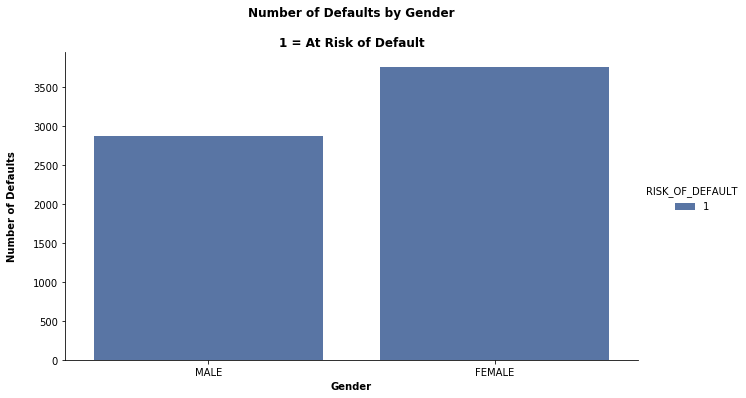

In [312]:
gender = sns.catplot('GENDER', data = default_gender, hue='RISK_OF_DEFAULT', palette='deep', kind='count', aspect=1.75)
gender.set_xlabels('Gender', fontweight = 'bold')

plt.title("Number of Defaults by Gender\n\n1 = At Risk of Default", fontweight = 'bold')
plt.ylabel('Number of Defaults\n', fontweight = 'bold')

plt.show()

# Creating the Gender Subsets

In [313]:
male = binned_credit.loc[binned_credit['SEX'] == 1]

female = binned_credit.loc[binned_credit['SEX'] == 2]

In [314]:
male

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,19146,19131,2000,36681,10000,9000,689,679,0,NO
5,6,50000,"($0, $50K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,37,...,19619,20024,2500,1815,657,1000,1000,800,0,NO
6,7,500000,"($450K, $500K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,29,...,483003,473944,55000,40000,38000,20239,13750,13770,0,NO
9,10,20000,"($0, $50K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,35,...,13007,13912,0,0,0,13007,1122,0,0,NO
13,14,70000,"($50K, $100K]",1,MALE,2,UNIVERSITY,2,SINGLE,30,...,36137,36894,3200,0,3000,3000,1500,0,1,YES
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,31237,15980,8500,20000,5003,3047,5000,1000,0,NO
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,5190,0,1837,3526,8998,129,0,0,0,NO
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,SINGLE,37,...,20582,19357,0,0,22000,4200,2000,3100,1,YES
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,41,...,11855,48944,85900,3409,1178,1926,52964,1804,1,YES


In [315]:
female

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,689,0,0,0,0,1,YES
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3455,3261,0,1000,1000,1000,0,2000,1,YES
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14948,15549,1518,1500,1000,1000,1000,5000,0,NO
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28959,29547,2000,2019,1200,1100,1069,1000,0,NO
7,8,100000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,23,...,-159,567,380,601,0,581,1687,1542,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29180,29181,140000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,60,...,115590,118221,0,5600,6000,4200,4500,4600,1,YES
29181,29182,170000,"($150K, $200K]",2,FEMALE,3,HIGH SCHOOL,1,MARRIED,57,...,124387,120529,7300,8000,7800,4600,5000,5100,0,NO
29182,29183,280000,"($250K, $300K]",2,FEMALE,1,GRADUATE SCHOOL,1,MARRIED,56,...,3464,3936,4811,9957,12492,3469,3936,3845,0,NO
29185,29186,50000,"($0, $50K]",2,FEMALE,3,HIGH SCHOOL,2,SINGLE,55,...,17119,17602,1243,1267,1580,612,758,700,0,NO


# Comparison of Credit Limits by Gender

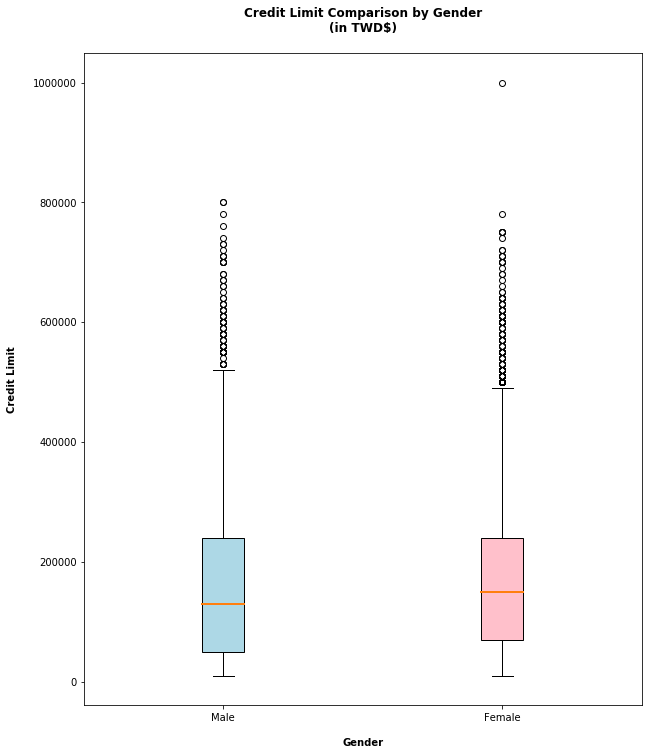

In [316]:
plt.figure(figsize = (10,12))

male = male.LIMIT_BAL
female = female.LIMIT_BAL

labels = ['Male','Female']
plt.title('Credit Limit Comparison by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparison of Bill Statements by Gender

## September 2005

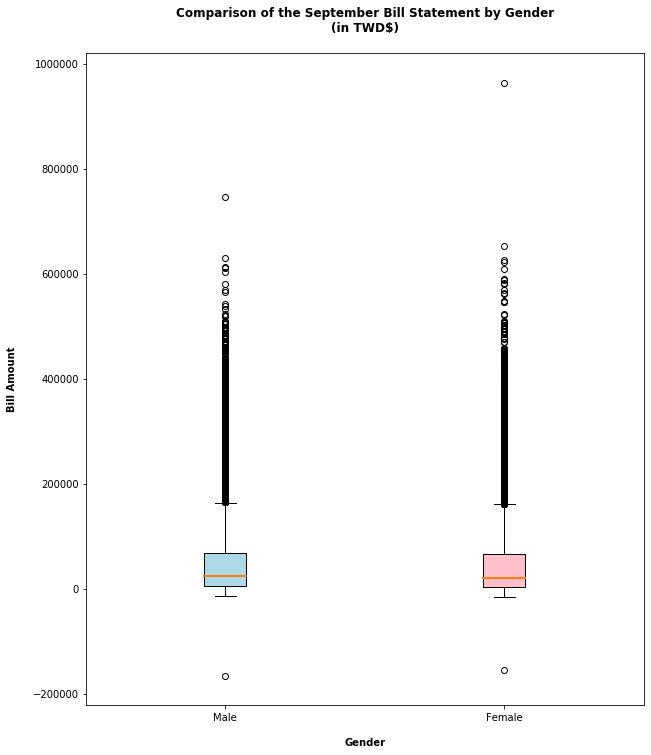

In [318]:
plt.figure(figsize = (10,12))

male = male.BILL_AMT1
female = female.BILL_AMT1

labels = ['Male','Female']
plt.title('Comparison of the September Bill Statement by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## August 2005

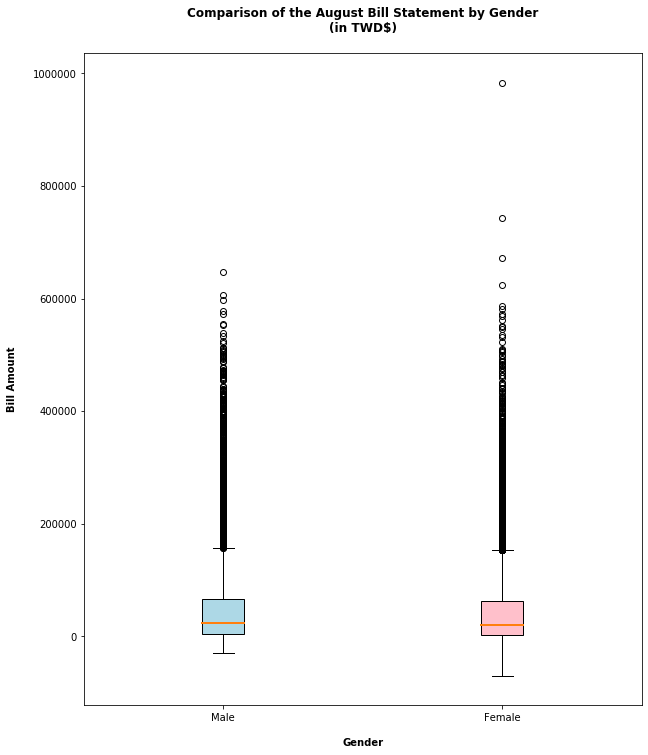

In [320]:
plt.figure(figsize = (10,12))

male = male.BILL_AMT2
female = female.BILL_AMT2

labels = ['Male','Female']
plt.title('Comparison of the August Bill Statement by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## July 2005

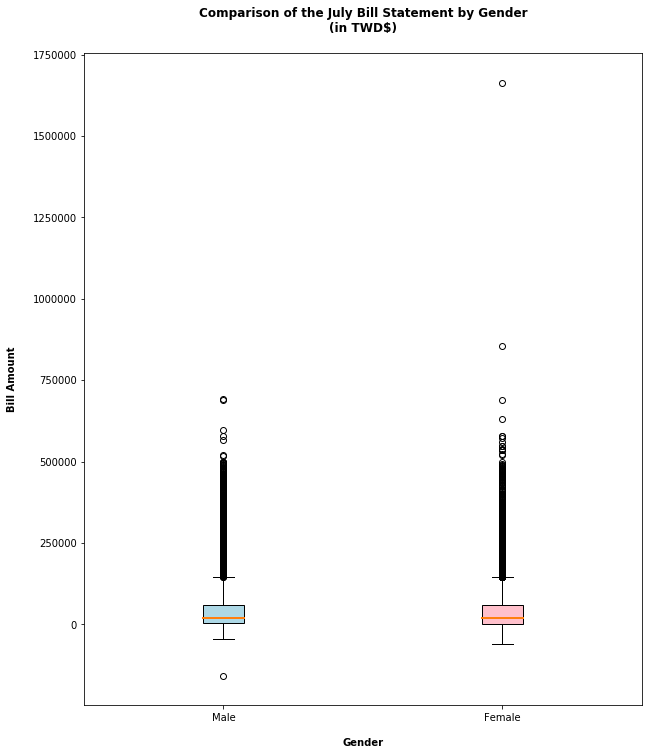

In [322]:
plt.figure(figsize = (10,12))

male = male.BILL_AMT3
female = female.BILL_AMT3

labels = ['Male','Female']
plt.title('Comparison of the July Bill Statement by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## June 2005

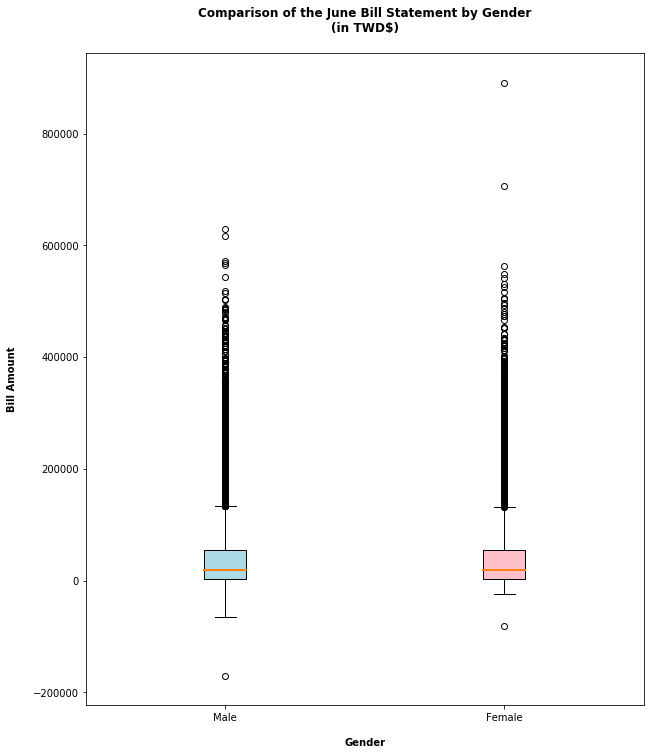

In [324]:
plt.figure(figsize = (10,12))

male = male.BILL_AMT4
female = female.BILL_AMT4

labels = ['Male','Female']
plt.title('Comparison of the June Bill Statement by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## May 2005

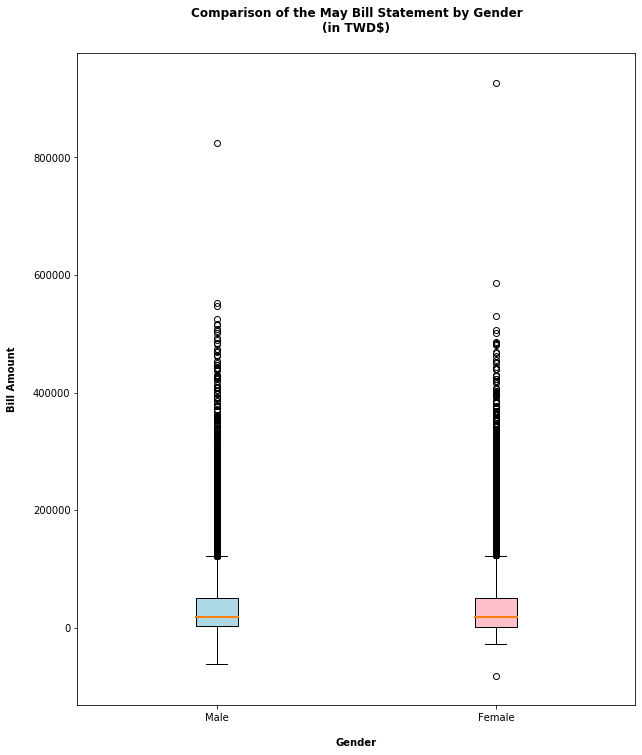

In [326]:
plt.figure(figsize = (10,12))

male = male.BILL_AMT5
female = female.BILL_AMT5

labels = ['Male','Female']
plt.title('Comparison of the May Bill Statement by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## April 2005

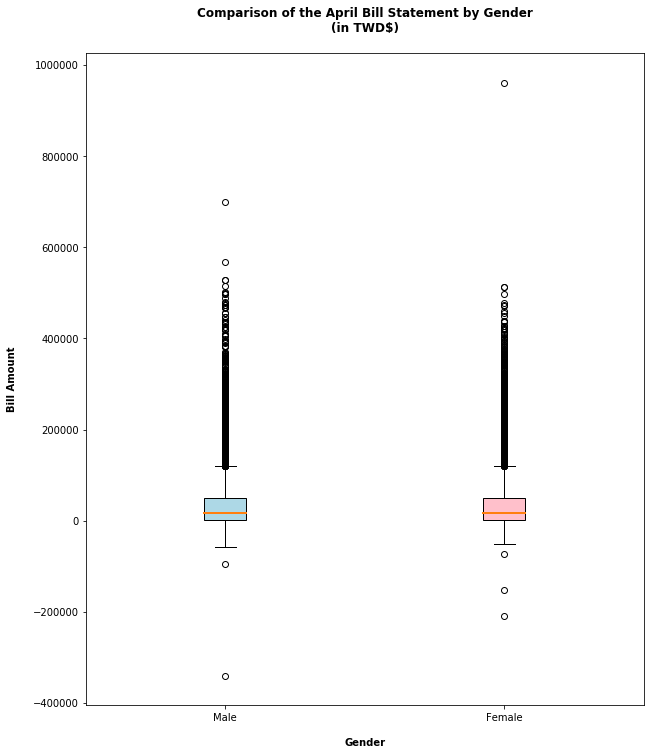

In [328]:
plt.figure(figsize = (10,12))

male = male.BILL_AMT6
female = female.BILL_AMT6

labels = ['Male','Female']
plt.title('Comparison of the April Bill Statement by Gender\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nGender',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([male, female], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lightblue', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparing Bill Statements to the Credit Limit by Gender

## September 2005

### Line Plots

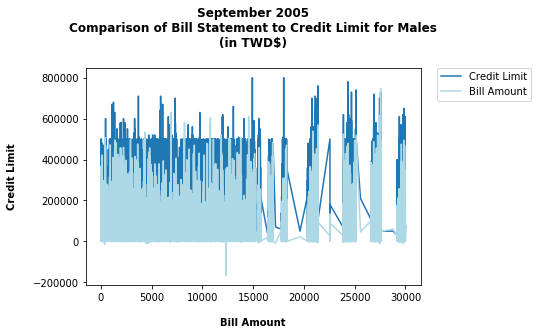

In [330]:
plt.plot(male.LIMIT_BAL, label = 'Credit Limit')
plt.plot(male.BILL_AMT1, color = 'lightblue', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

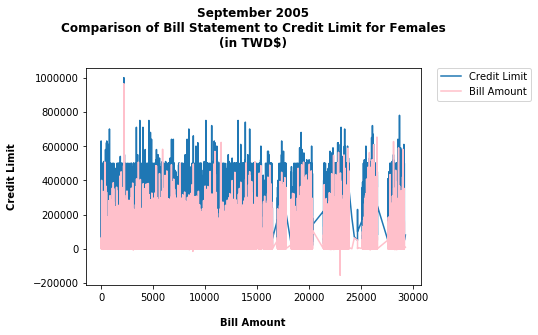

In [331]:
plt.plot(female.LIMIT_BAL, label = 'Credit Limit')
plt.plot(female.BILL_AMT1, color = 'pink', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

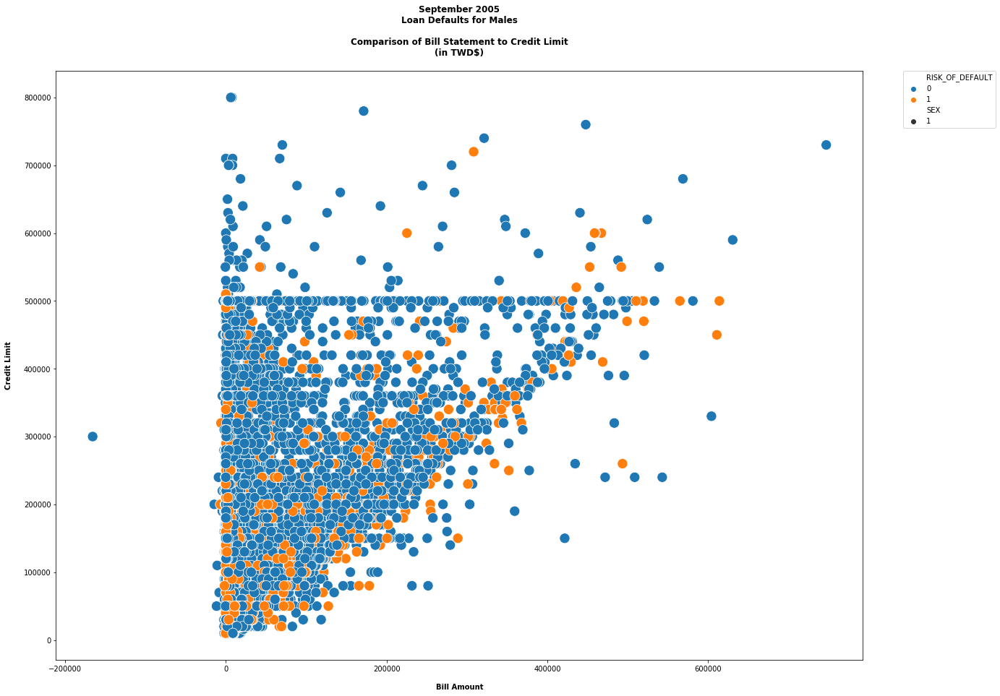

In [332]:
x = male.BILL_AMT1
y = male.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('September 2005\nLoan Defaults for Males\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

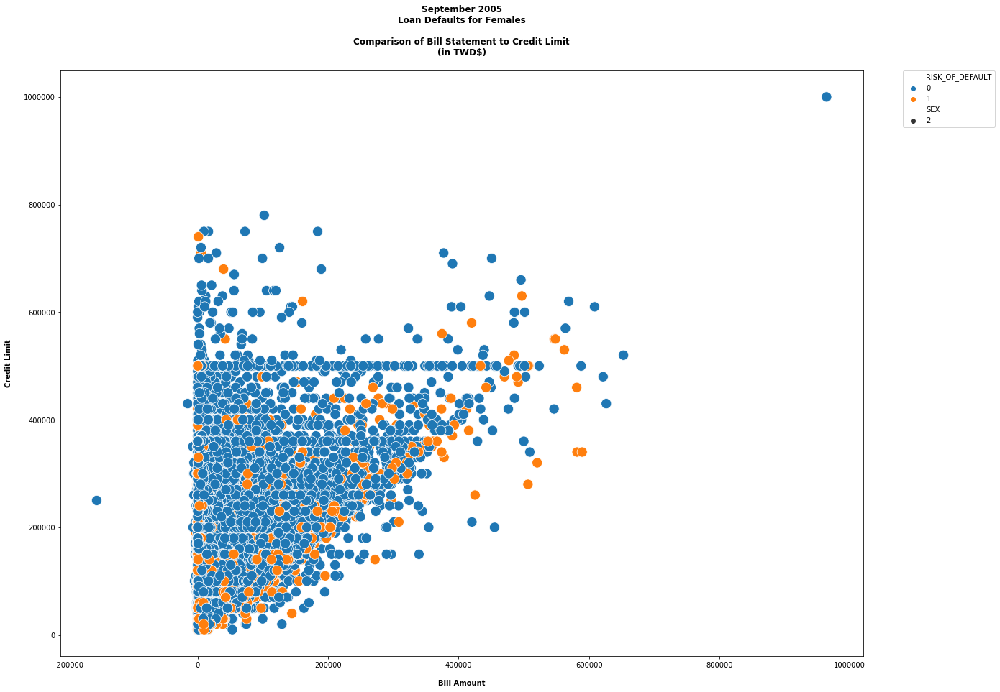

In [333]:
x = female.BILL_AMT1
y = female.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('September 2005\nLoan Defaults for Females\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

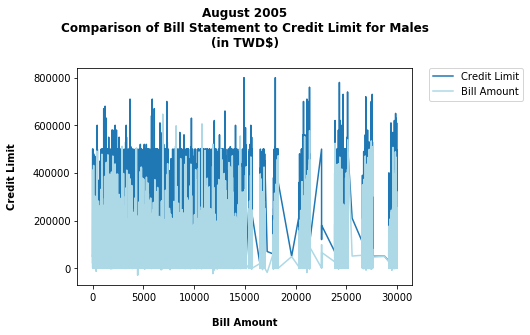

In [334]:
plt.plot(male.LIMIT_BAL, label = 'Credit Limit')
plt.plot(male.BILL_AMT2, color = 'lightblue', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

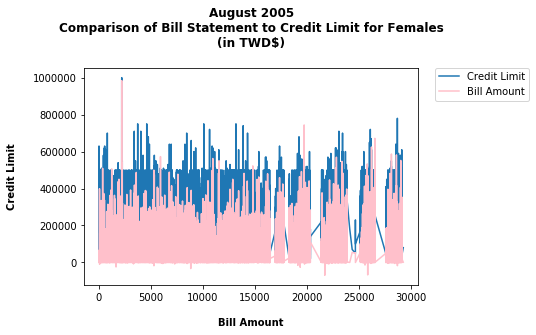

In [335]:
plt.plot(female.LIMIT_BAL, label = 'Credit Limit')
plt.plot(female.BILL_AMT2, color = 'pink', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

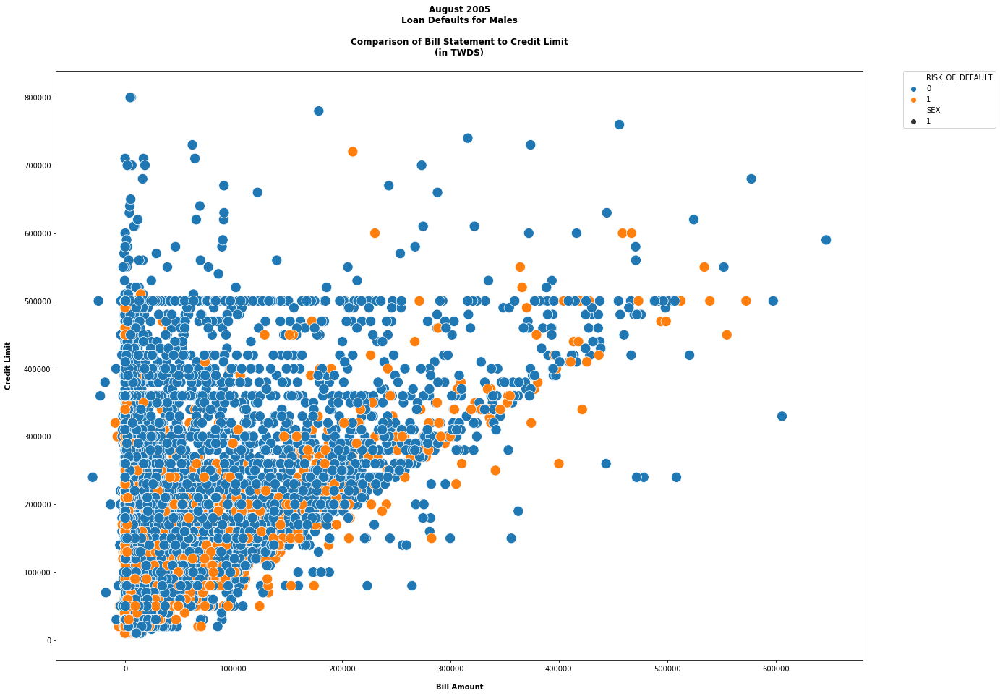

In [336]:
x = male.BILL_AMT2
y = male.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('August 2005\nLoan Defaults for Males\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

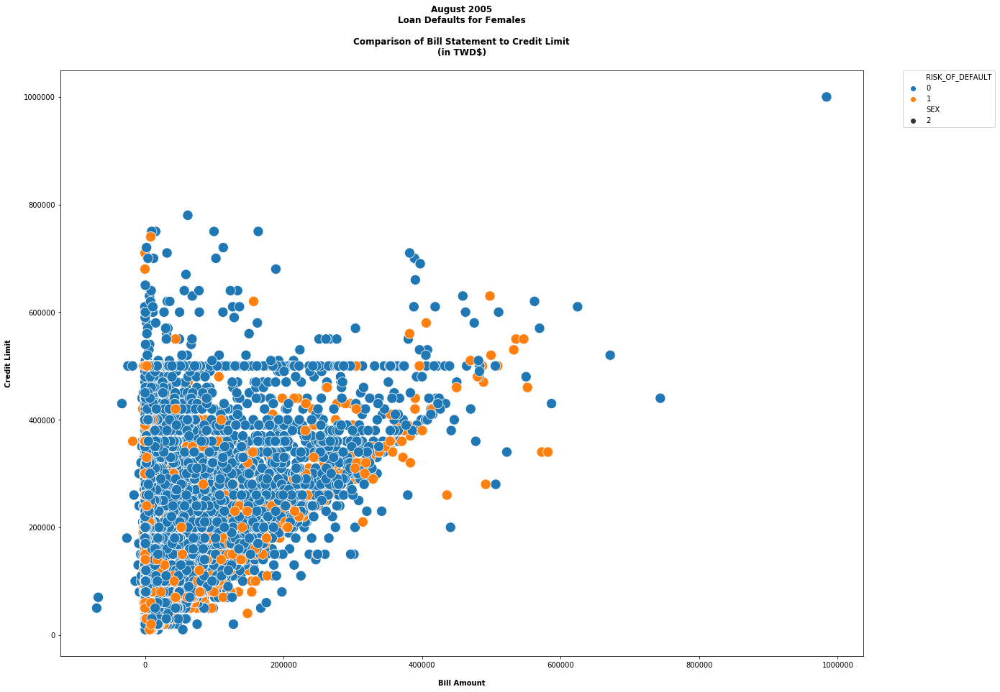

In [337]:
x = female.BILL_AMT2
y = female.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('August 2005\nLoan Defaults for Females\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

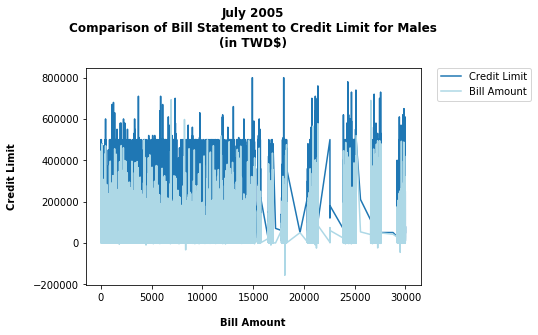

In [338]:
plt.plot(male.LIMIT_BAL, label = 'Credit Limit')
plt.plot(male.BILL_AMT3, color = 'lightblue', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

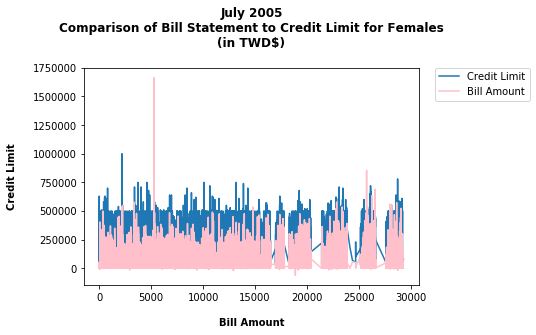

In [339]:
plt.plot(female.LIMIT_BAL, label = 'Credit Limit')
plt.plot(female.BILL_AMT3, color = 'pink', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

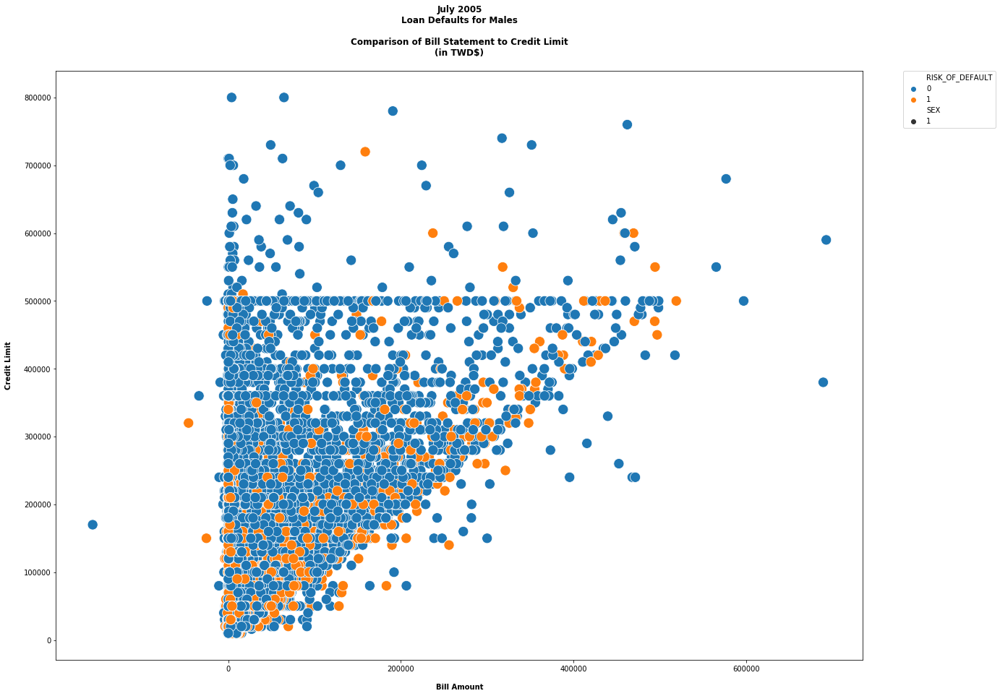

In [340]:
x = male.BILL_AMT3
y = male.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('July 2005\nLoan Defaults for Males\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

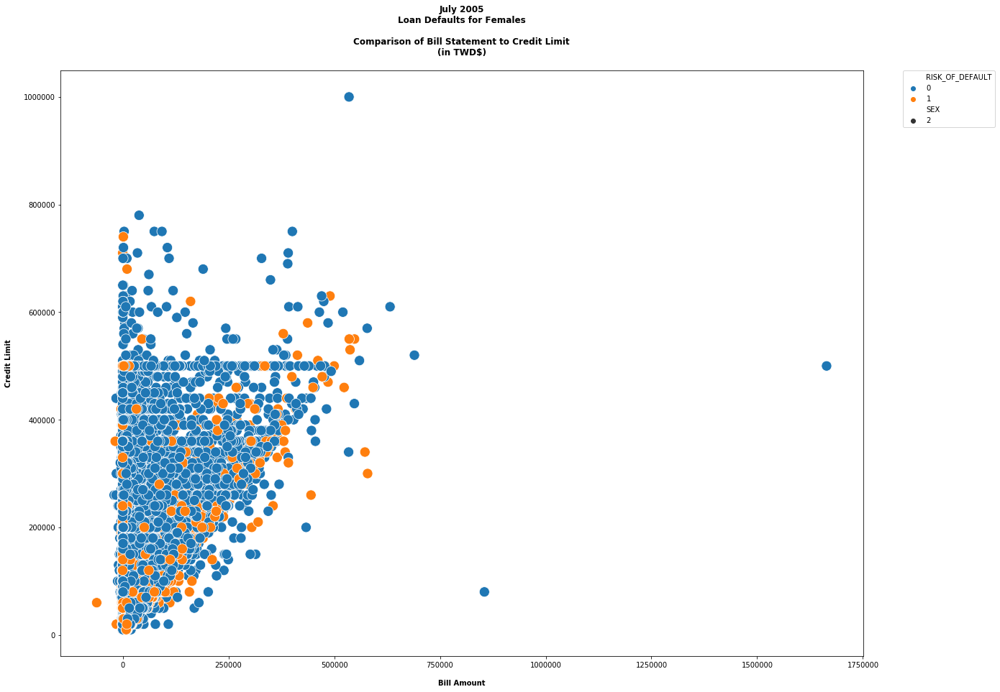

In [341]:
x = female.BILL_AMT3
y = female.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('July 2005\nLoan Defaults for Females\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

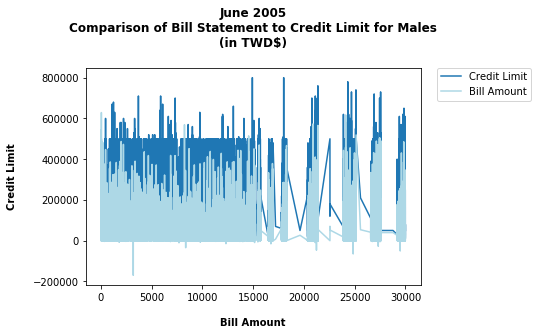

In [342]:
plt.plot(male.LIMIT_BAL, label = 'Credit Limit')
plt.plot(male.BILL_AMT4, color = 'lightblue', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

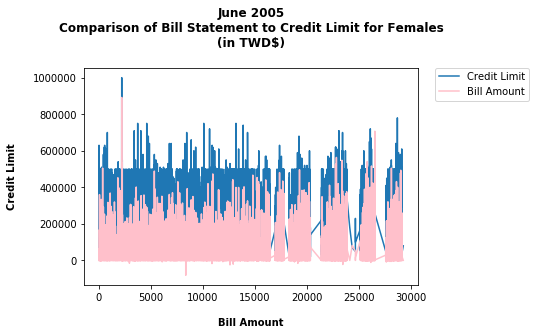

In [343]:
plt.plot(female.LIMIT_BAL, label = 'Credit Limit')
plt.plot(female.BILL_AMT4, color = 'pink', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

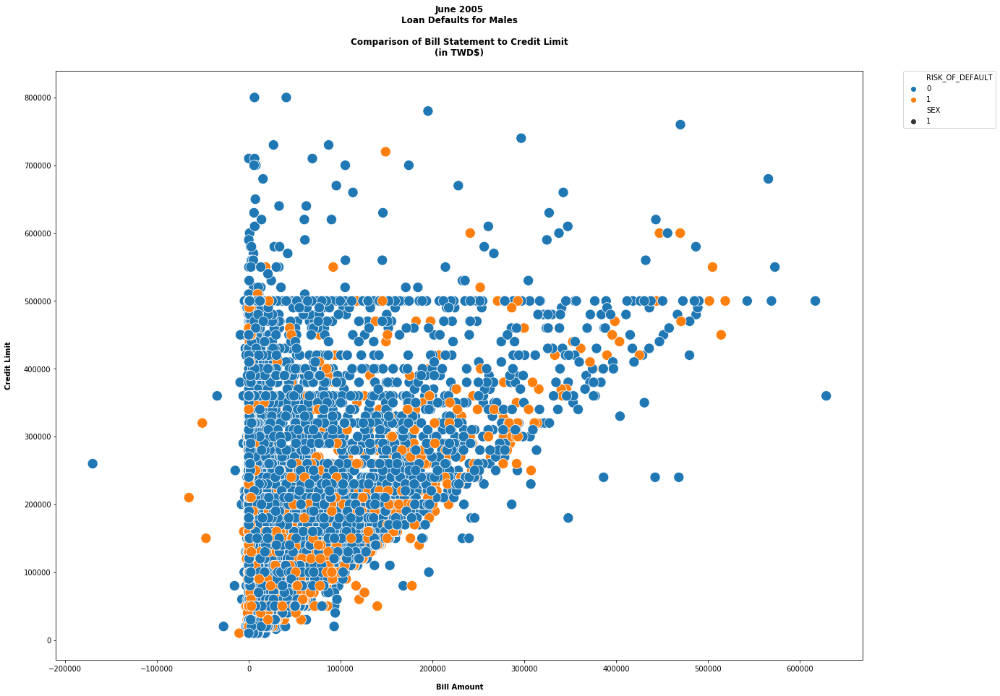

In [344]:
x = male.BILL_AMT4
y = male.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('June 2005\nLoan Defaults for Males\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

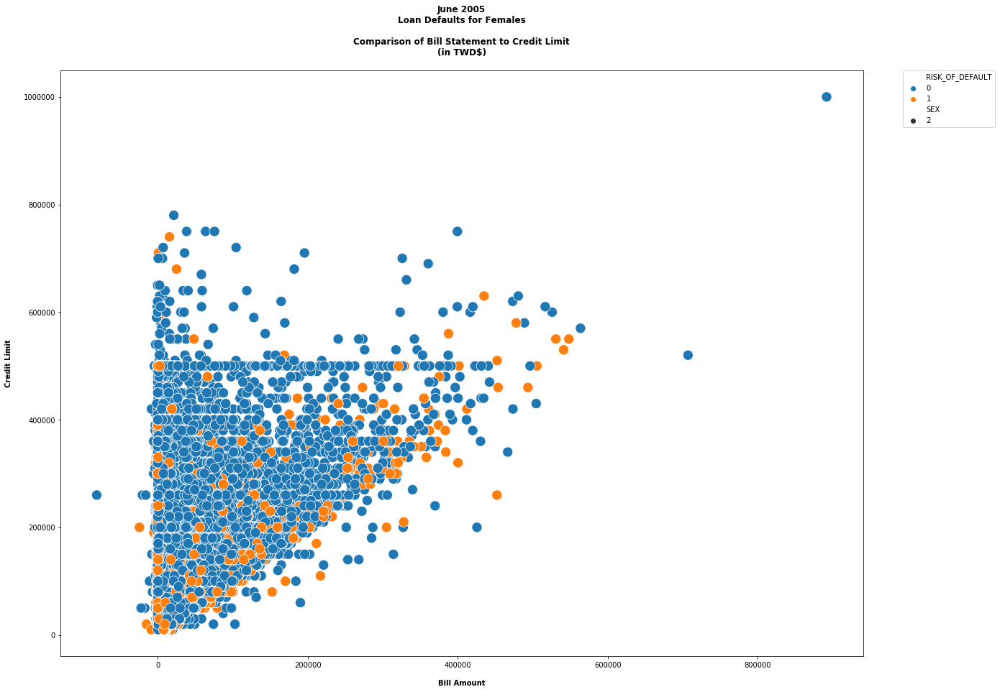

In [345]:
x = female.BILL_AMT4
y = female.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('June 2005\nLoan Defaults for Females\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

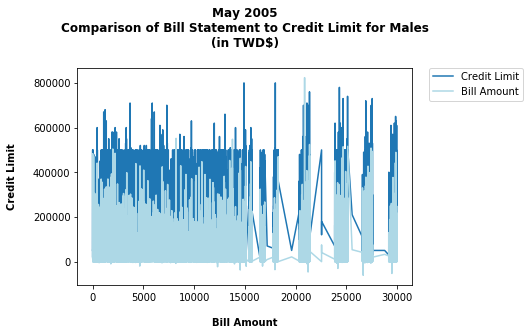

In [346]:
plt.plot(male.LIMIT_BAL, label = 'Credit Limit')
plt.plot(male.BILL_AMT5, color = 'lightblue', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

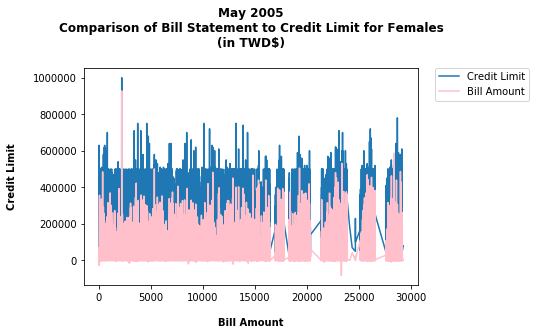

In [347]:
plt.plot(female.LIMIT_BAL, label = 'Credit Limit')
plt.plot(female.BILL_AMT5, color = 'pink', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

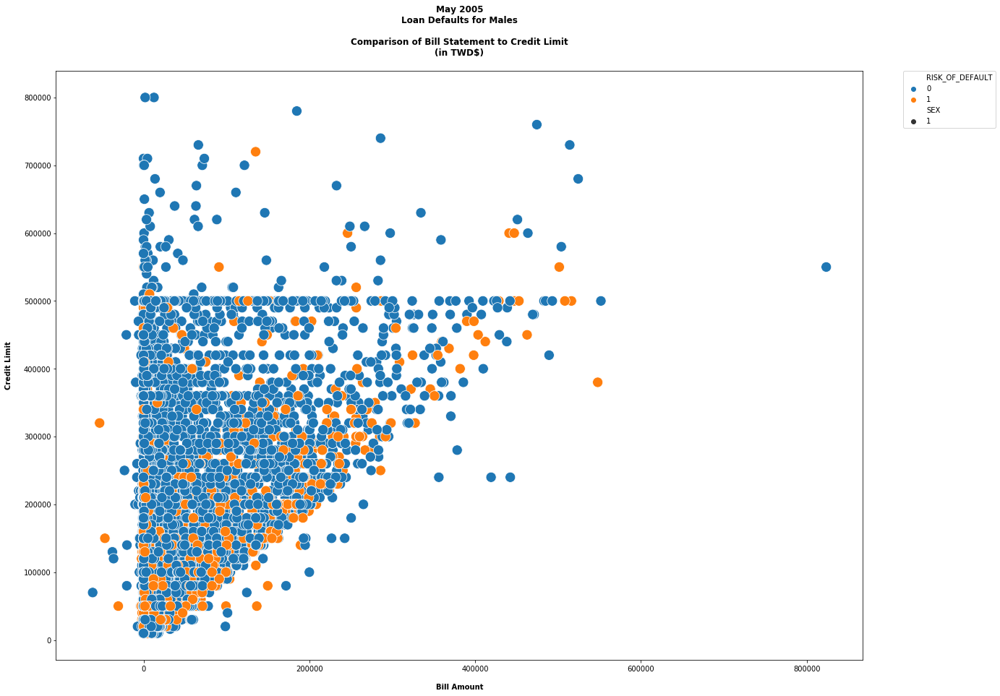

In [348]:
x = male.BILL_AMT5
y = male.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('May 2005\nLoan Defaults for Males\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

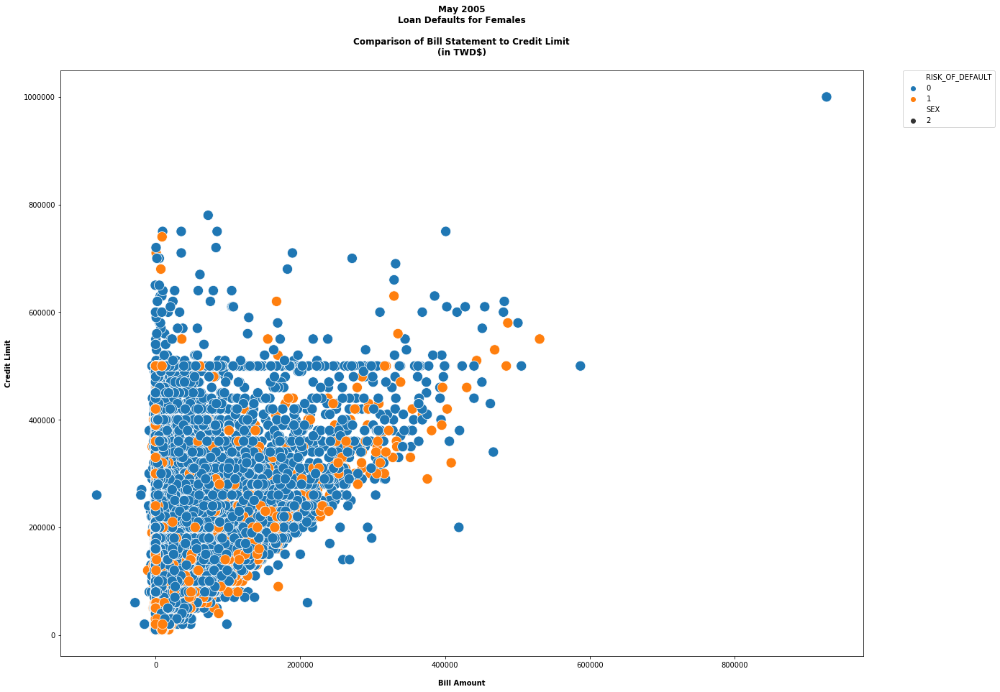

In [349]:
x = female.BILL_AMT5
y = female.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('May 2005\nLoan Defaults for Females\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

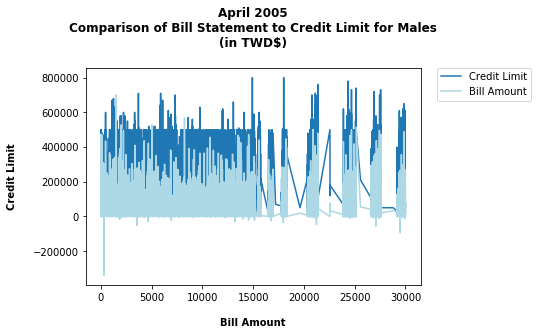

In [350]:
plt.plot(male.LIMIT_BAL, label = 'Credit Limit')
plt.plot(male.BILL_AMT6, color = 'lightblue', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

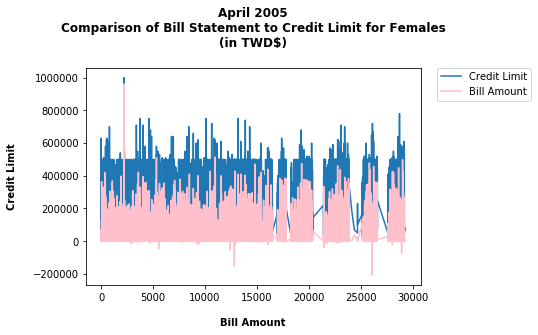

In [351]:
plt.plot(female.LIMIT_BAL, label = 'Credit Limit')
plt.plot(female.BILL_AMT6, color = 'pink', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

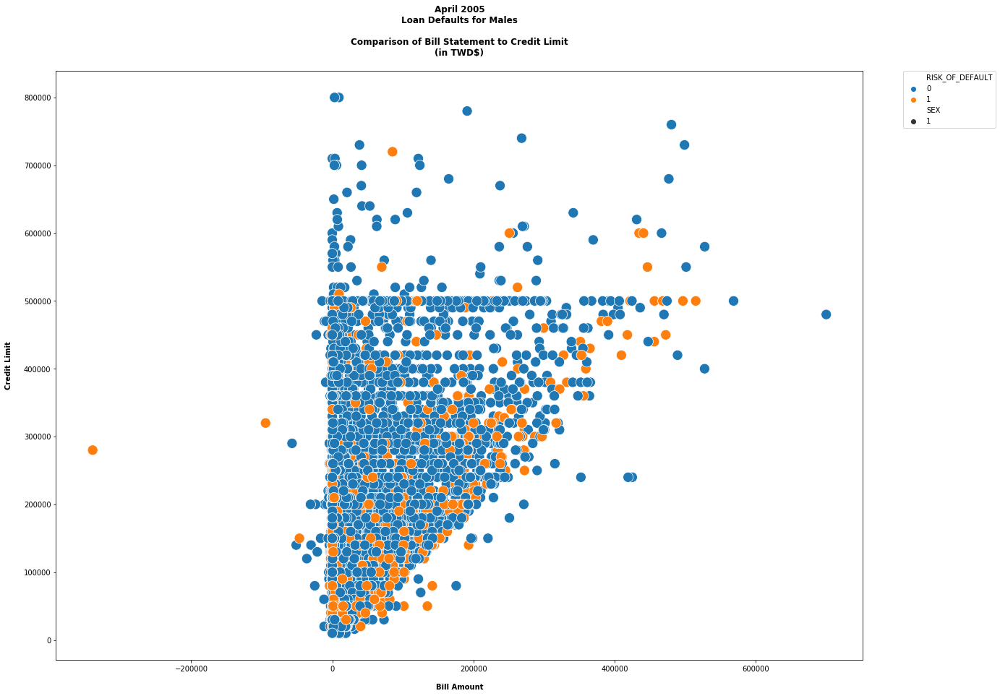

In [352]:
x = male.BILL_AMT6
y = male.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('April 2005\nLoan Defaults for Males\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

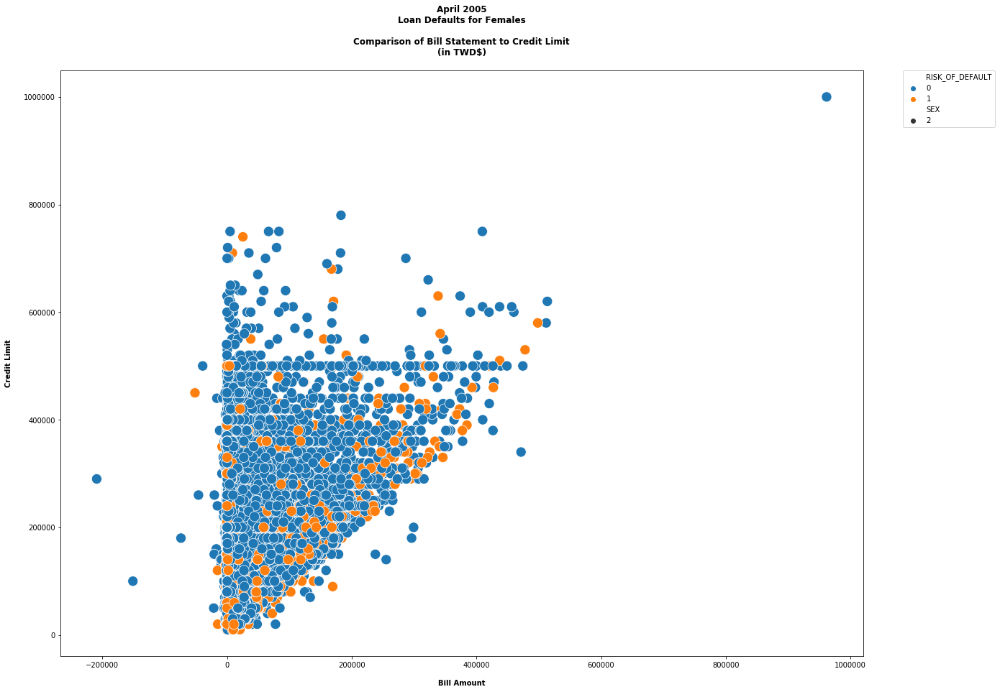

In [353]:
x = female.BILL_AMT6
y = female.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('April 2005\nLoan Defaults for Females\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

# Comparing the Bill & Pay Statements by Gender

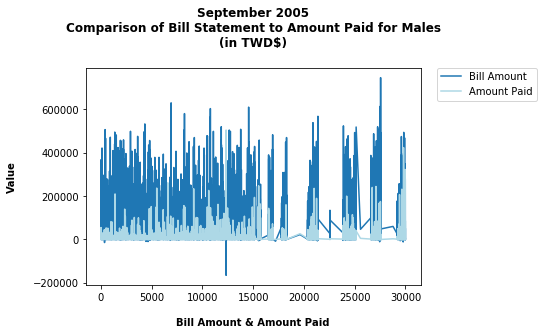

In [354]:
plt.plot(male.BILL_AMT1, label = 'Bill Amount')
plt.plot(male.PAY_AMT1, color = 'lightblue', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

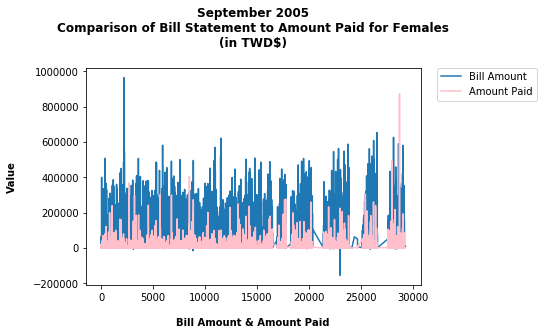

In [355]:
plt.plot(female.BILL_AMT1, label = 'Bill Amount')
plt.plot(female.PAY_AMT1, color = 'pink', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

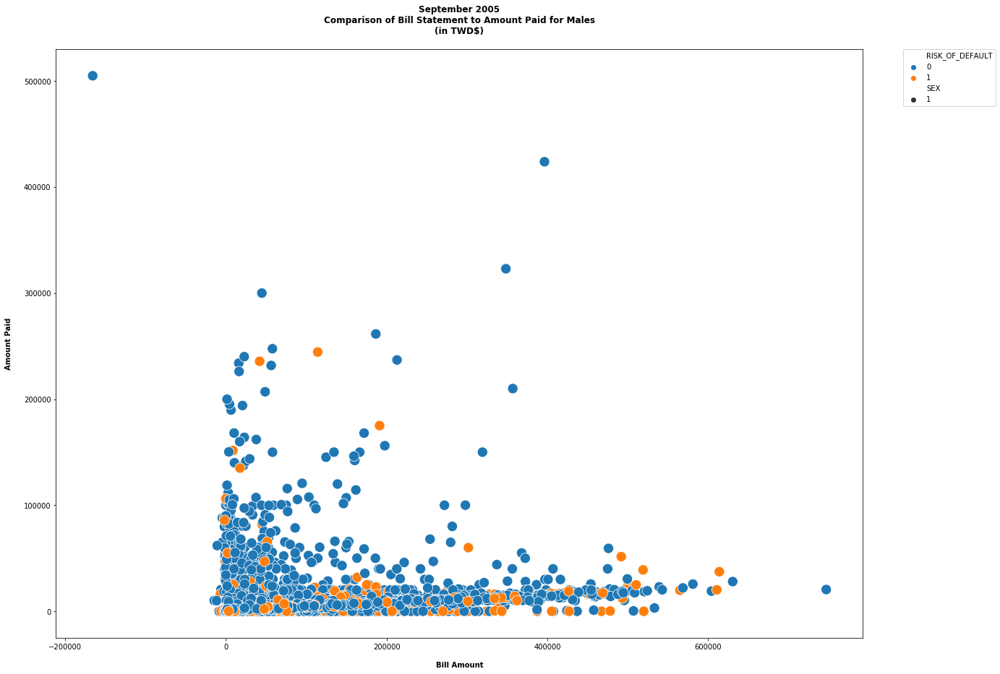

In [356]:
x = male.BILL_AMT1
y = male.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

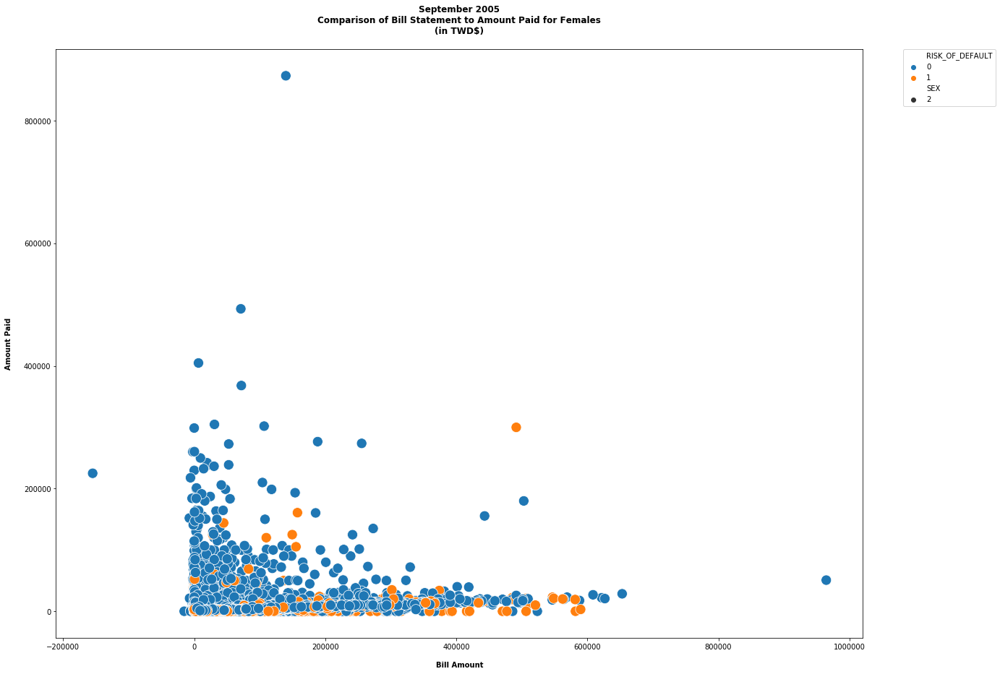

In [357]:
x = female.BILL_AMT1
y = female.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

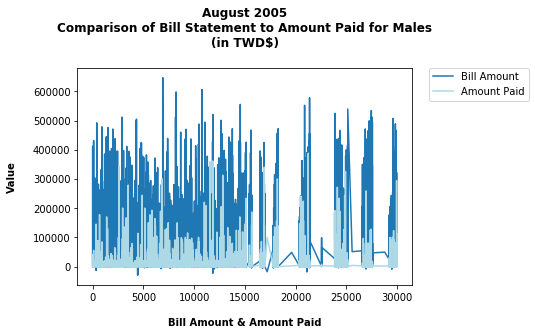

In [358]:
plt.plot(male.BILL_AMT2, label = 'Bill Amount')
plt.plot(male.PAY_AMT2, color = 'lightblue', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

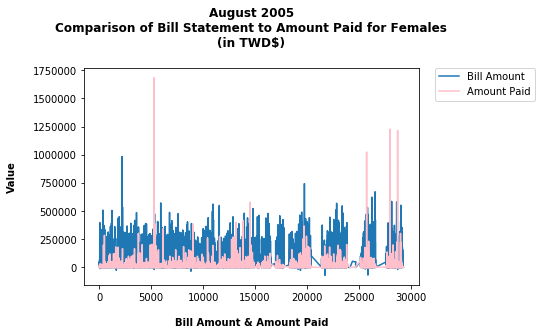

In [359]:
plt.plot(female.BILL_AMT2, label = 'Bill Amount')
plt.plot(female.PAY_AMT2, color = 'pink', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

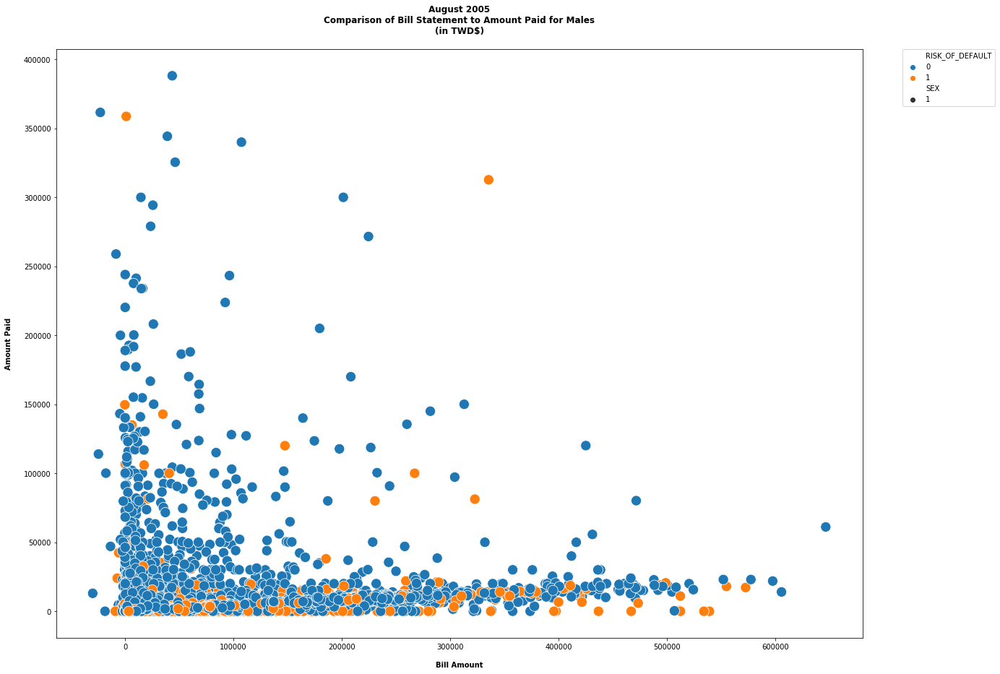

In [360]:
x = male.BILL_AMT2
y = male.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

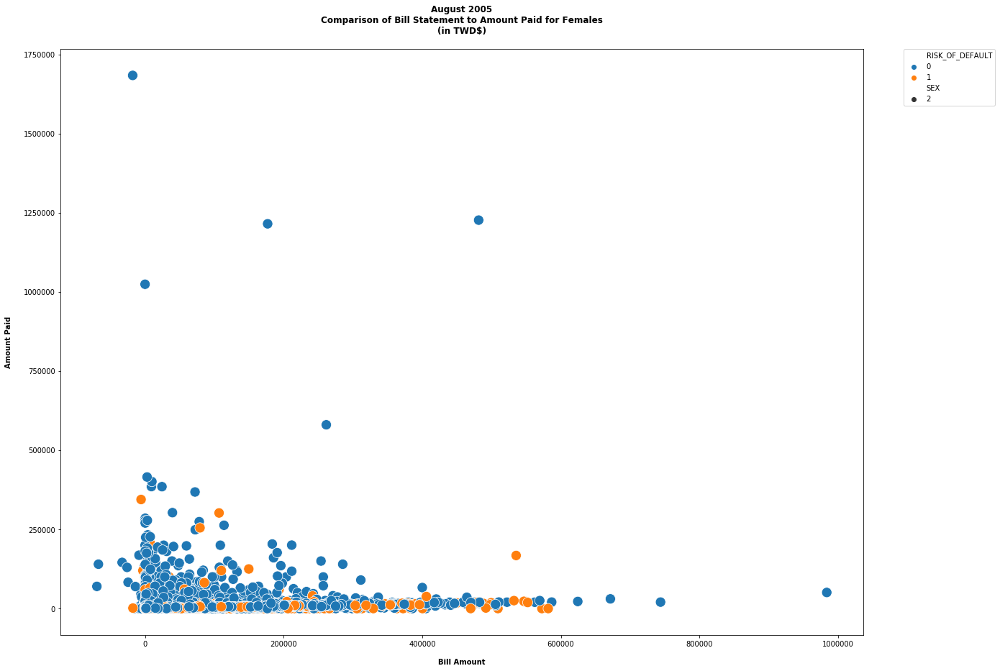

In [361]:
x = female.BILL_AMT2
y = female.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

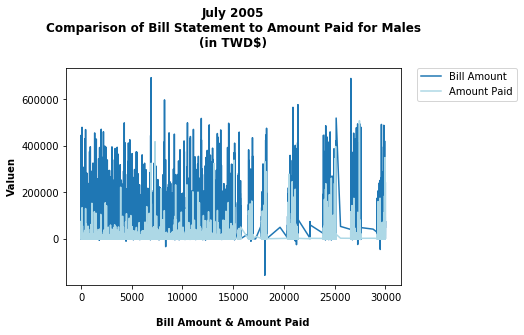

In [362]:
plt.plot(male.BILL_AMT3, label = 'Bill Amount')
plt.plot(male.PAY_AMT3, color = 'lightblue', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Valuen',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

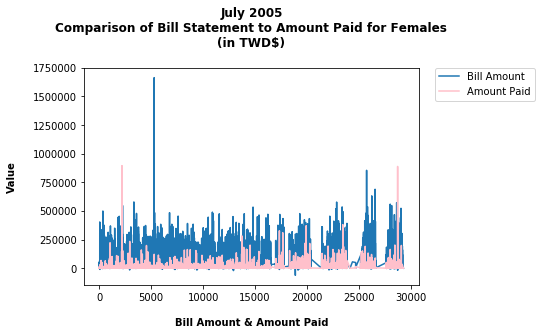

In [363]:
plt.plot(female.BILL_AMT3, label = 'Bill Amount')
plt.plot(female.PAY_AMT3, color = 'pink', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

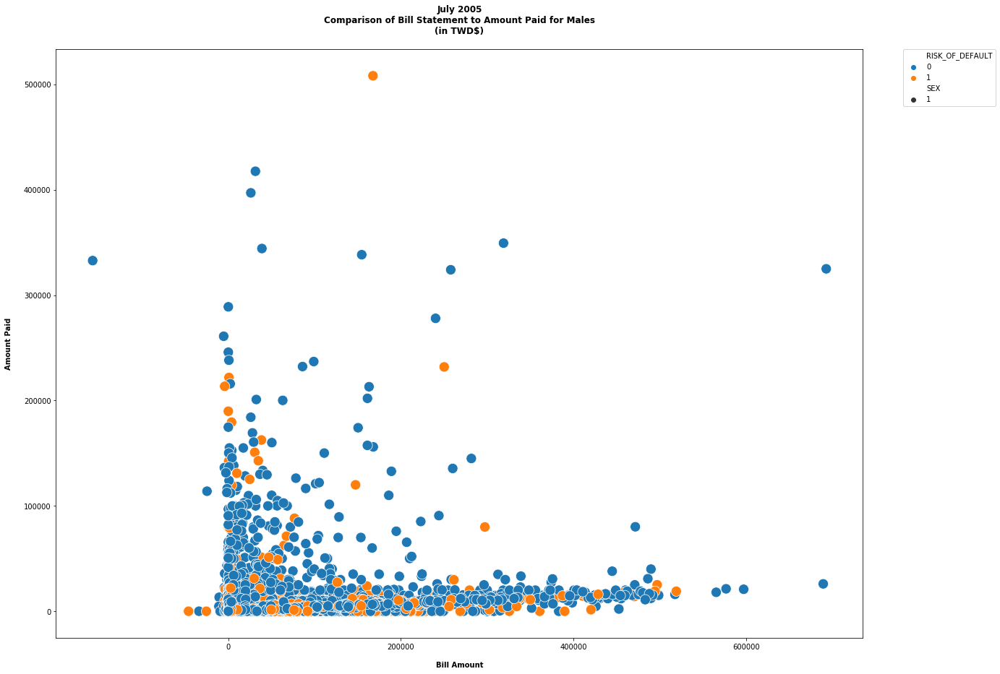

In [364]:
x = male.BILL_AMT3
y = male.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

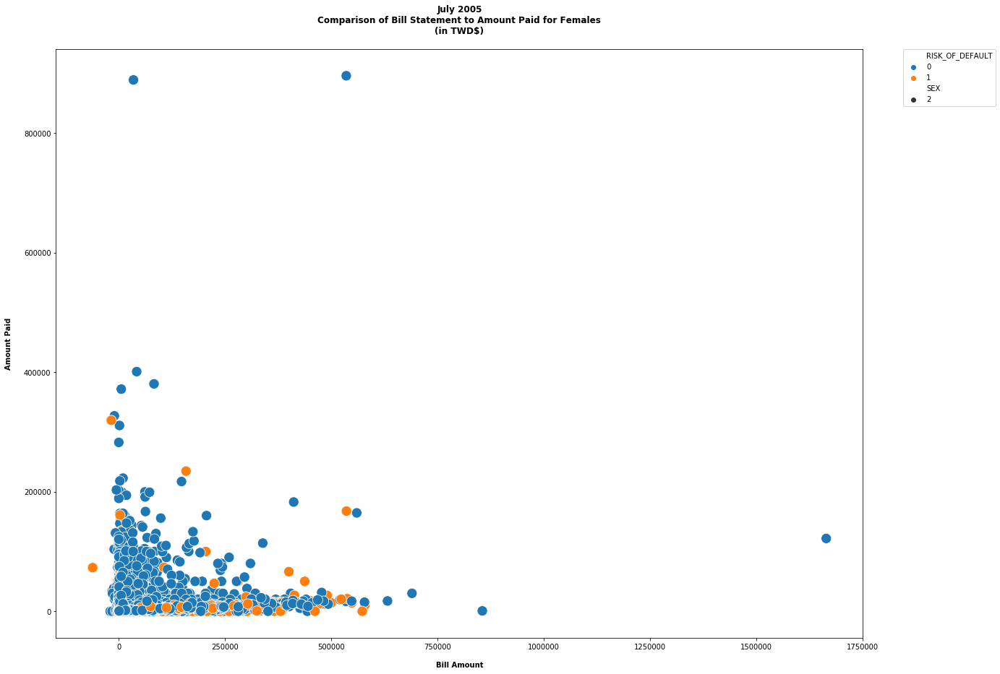

In [365]:
x = female.BILL_AMT3
y = female.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

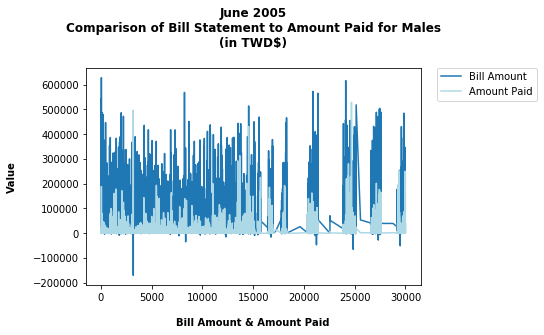

In [366]:
plt.plot(male.BILL_AMT4, label = 'Bill Amount')
plt.plot(male.PAY_AMT4, color = 'lightblue', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

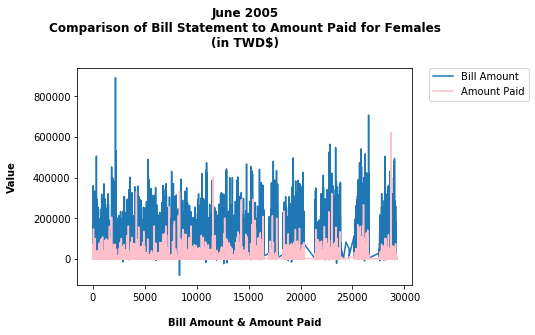

In [367]:
plt.plot(female.BILL_AMT4, label = 'Bill Amount')
plt.plot(female.PAY_AMT4, color = 'pink', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

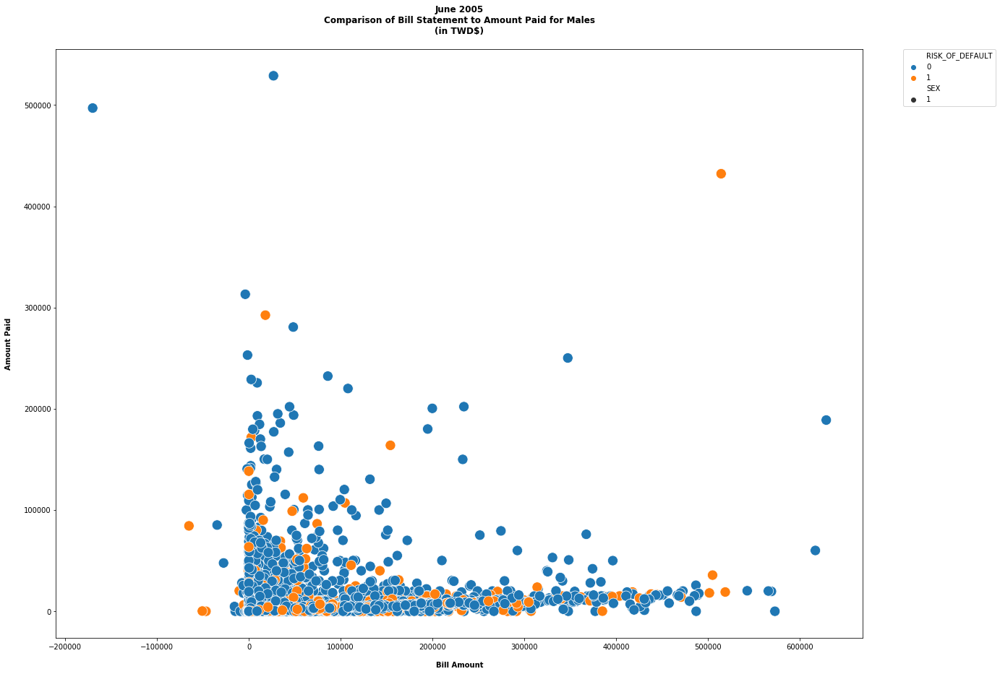

In [368]:
x = male.BILL_AMT4
y = male.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

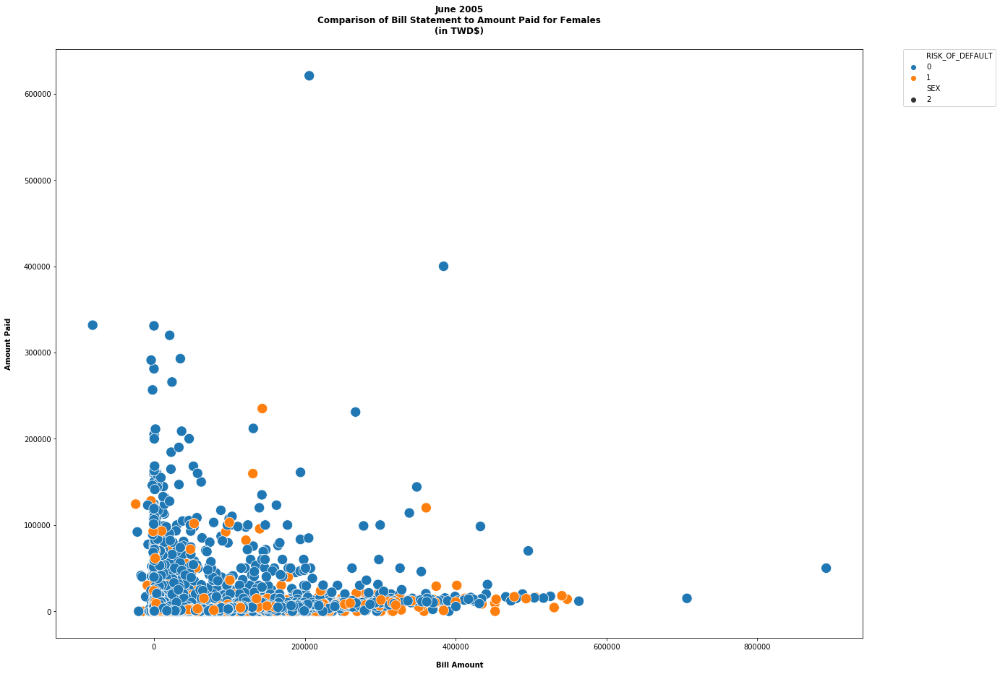

In [369]:
x = female.BILL_AMT4
y = female.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

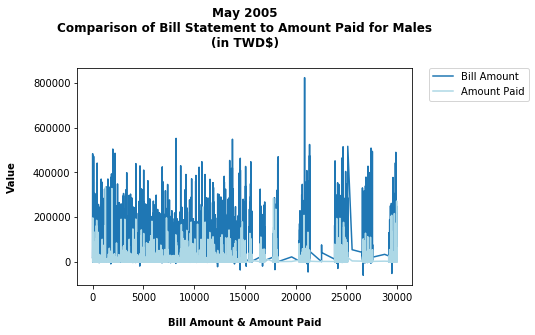

In [370]:
plt.plot(male.BILL_AMT5, label = 'Bill Amount')
plt.plot(male.PAY_AMT5, color = 'lightblue', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

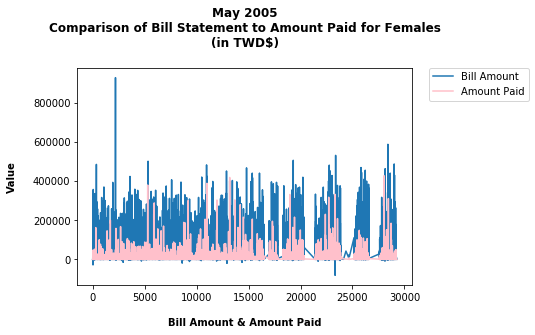

In [371]:
plt.plot(female.BILL_AMT5, label = 'Bill Amount')
plt.plot(female.PAY_AMT5, color = 'pink', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

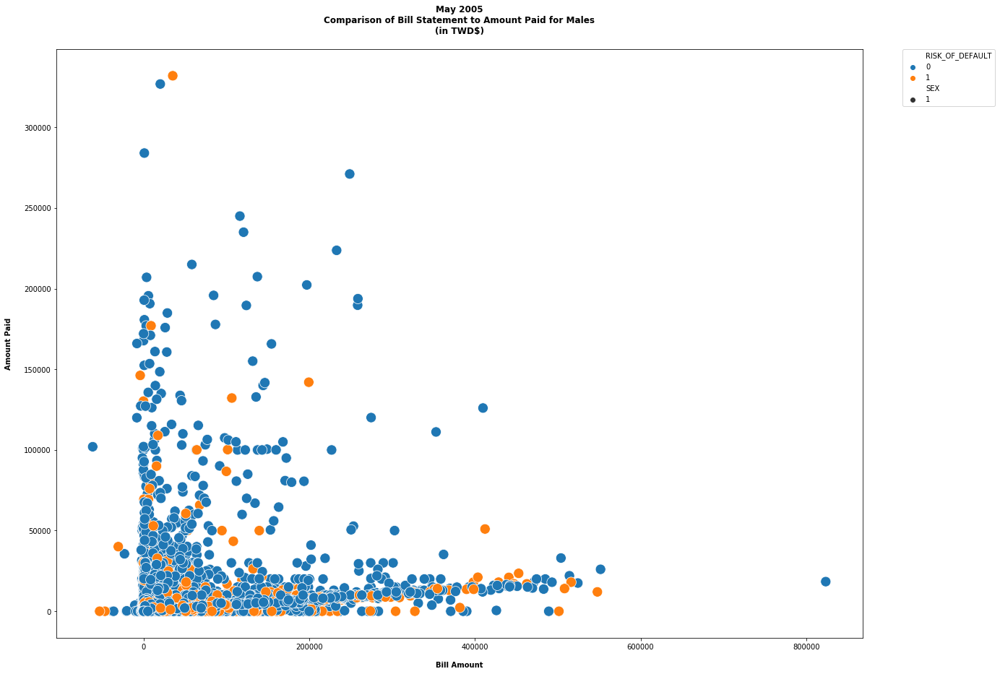

In [372]:
x = male.BILL_AMT5
y = male.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

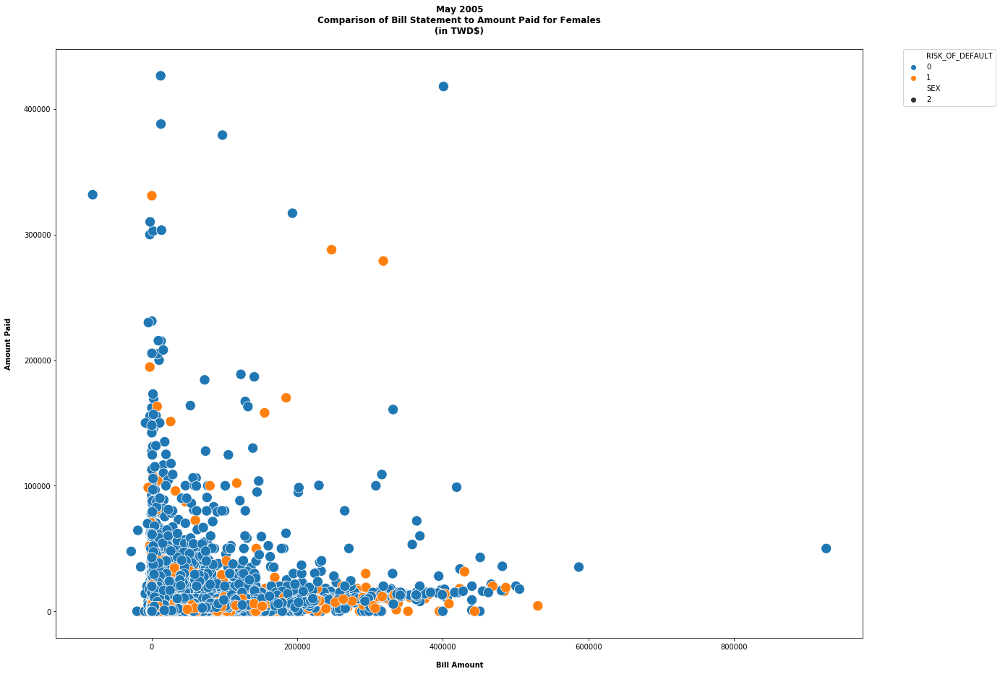

In [373]:
x = female.BILL_AMT5
y = female.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

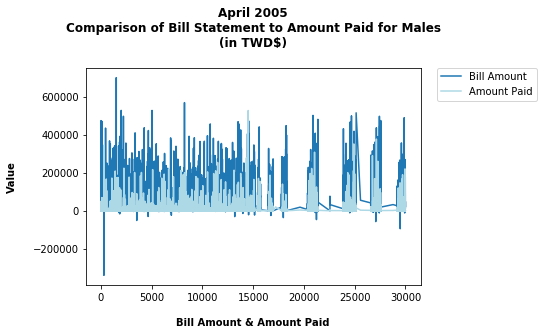

In [374]:
plt.plot(male.BILL_AMT6, label = 'Bill Amount')
plt.plot(male.PAY_AMT6, color = 'lightblue', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

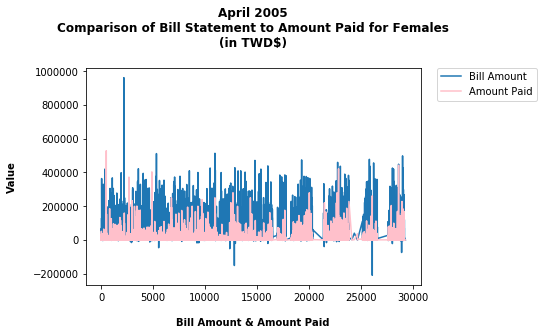

In [375]:
plt.plot(female.BILL_AMT6, label = 'Bill Amount')
plt.plot(female.PAY_AMT6, color = 'pink', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

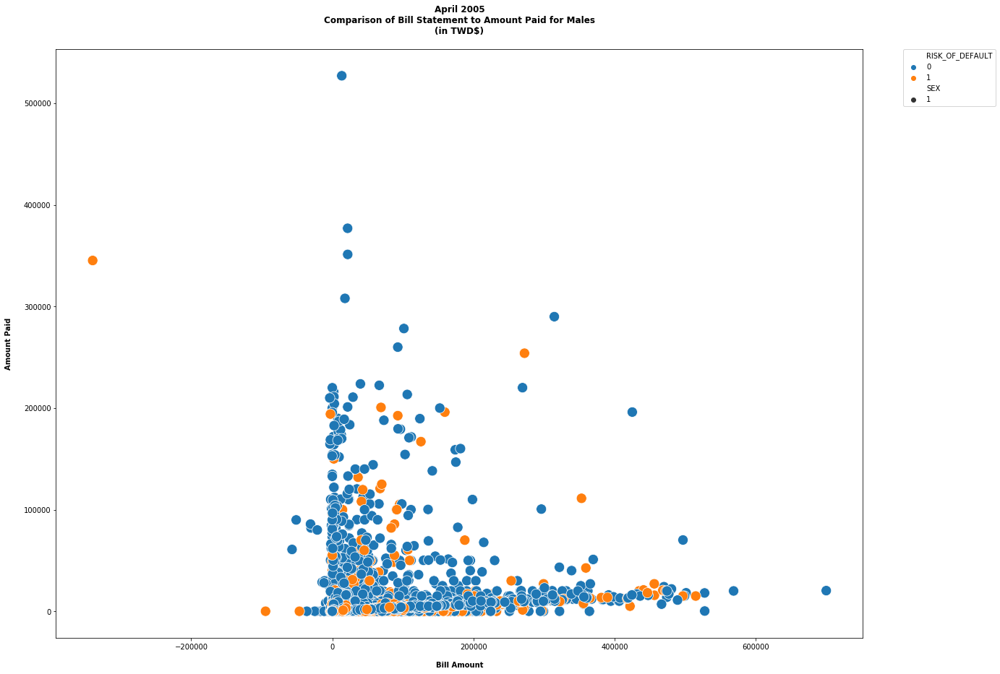

In [376]:
x = male.BILL_AMT6
y = male.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = male)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Males\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

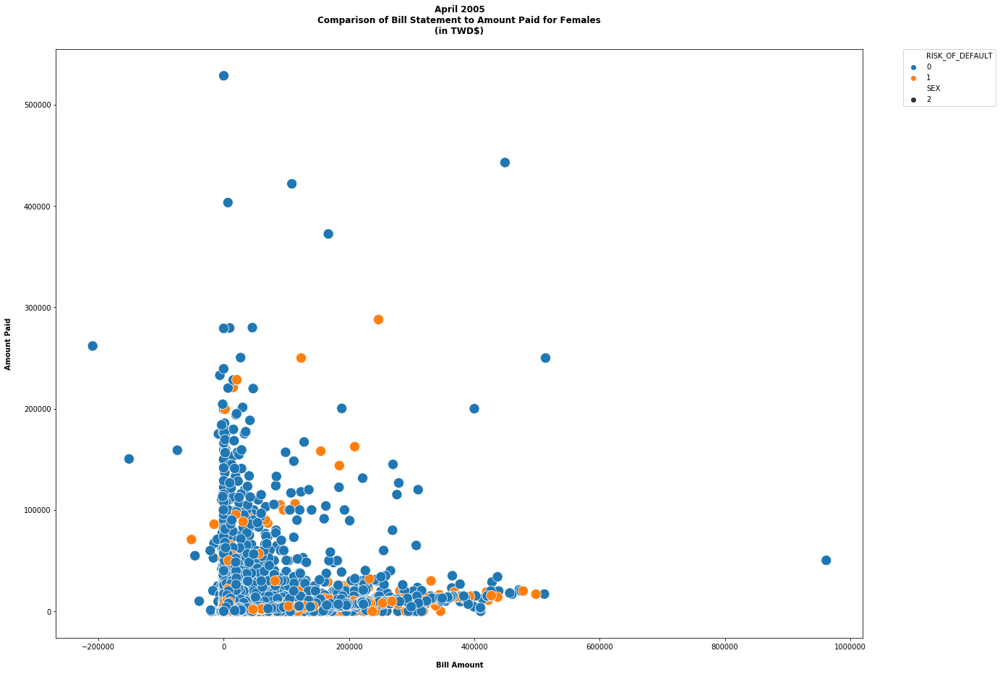

In [377]:
x = female.BILL_AMT6
y = female.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'SEX', s = 200, data = female)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Females\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

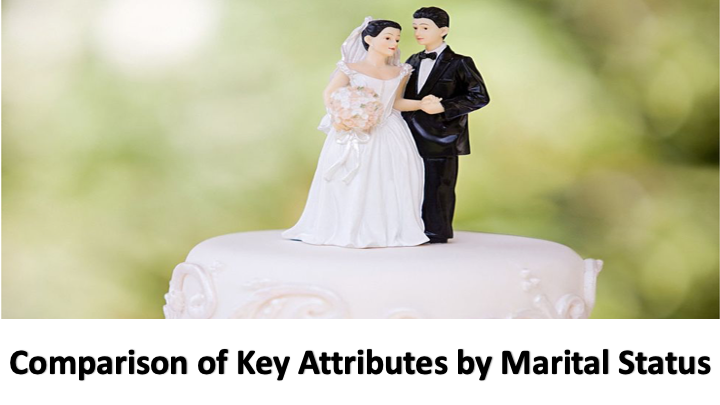

In [379]:
from IPython.display import Image
Image('Marital Status.png')

# Distribution of Marital Status

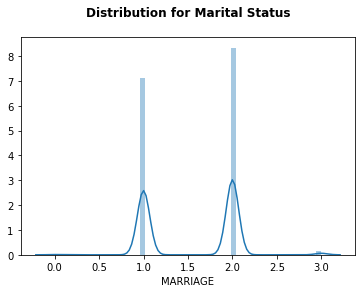

MARR_GROUP
OTHER          54
MARRIED     13659
SINGLE      15964
DIVORCED      323
Name: MARRIAGE, dtype: int64

In [380]:
marital_dist = sns.distplot(binned_credit['MARRIAGE'])
marital_dist.set_title("Distribution for Marital Status\n", fontweight = 'bold')

plt.show()

binned_credit.groupby('MARR_GROUP')['MARRIAGE'].count()

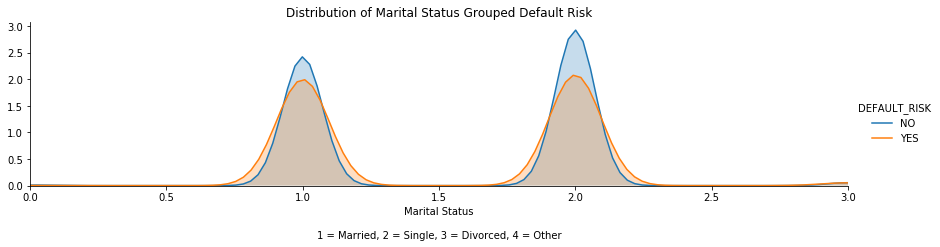

In [381]:
fig = sns.FacetGrid(binned_credit, hue='DEFAULT_RISK', aspect=4)
fig.map(sns.kdeplot, 'MARRIAGE', shade=True)
oldest = binned_credit['MARRIAGE'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Marital Status Grouped Default Risk')
fig.add_legend()
plt.xlabel('Marital Status\n\n1 = Married, 2 = Single, 3 = Divorced, 4 = Other')


plt.show()

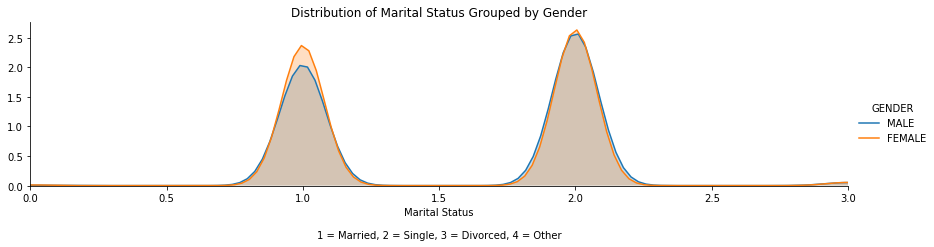

In [382]:
fig = sns.FacetGrid(binned_credit, hue='GENDER', aspect=4)
fig.map(sns.kdeplot, 'MARRIAGE', shade=True)
oldest = binned_credit['MARRIAGE'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Marital Status Grouped by Gender')
fig.add_legend()
plt.xlabel('Marital Status\n\n1 = Married, 2 = Single, 3 = Divorced, 4 = Other')

plt.show()

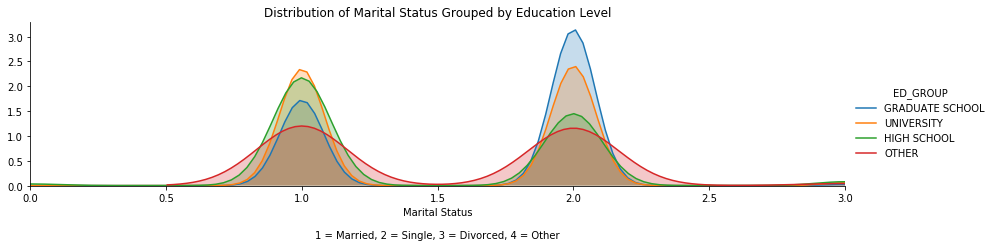

In [383]:
fig = sns.FacetGrid(binned_credit, hue='ED_GROUP', aspect=4)
fig.map(sns.kdeplot, 'MARRIAGE', shade=True)
oldest = binned_credit['MARRIAGE'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Marital Status Grouped by Education Level')
fig.add_legend()
plt.xlabel('Marital Status\n\n1 = Married, 2 = Single, 3 = Divorced, 4 = Other')

plt.show()

# Counting the Number of Defaults per Marital Status

In [384]:
default_MS = binned_credit.loc[binned_credit['RISK_OF_DEFAULT'] == 1]

default_MS.groupby('MARR_GROUP')['DEFAULT_RISK'].count()

MARR_GROUP
OTHER          5
MARRIED     3206
SINGLE      3341
DIVORCED      84
Name: DEFAULT_RISK, dtype: int64

In [385]:
title = '\nNumber of People at Risk of Default by Marital Status'

bolded_string = "\033[1m" + title + "\033[0m"

print(bolded_string)

default_MS.pivot_table('RISK_OF_DEFAULT', 'MARR_GROUP', aggfunc = pd.value_counts, margins = True)


Number of People at Risk of Default by Marital Status


,RISK_OF_DEFAULT
MARR_GROUP,
OTHER,5
MARRIED,3206
SINGLE,3341
DIVORCED,84
All,6636


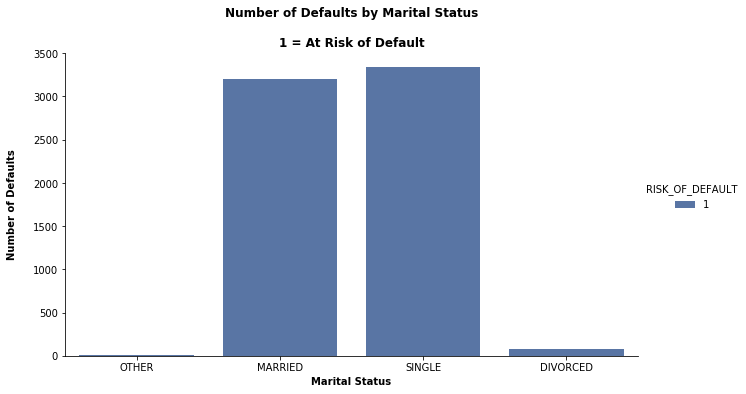

In [386]:
ms = sns.catplot('MARR_GROUP', data = default_MS, hue='RISK_OF_DEFAULT', palette='deep', kind='count', aspect=1.75)
ms.set_xlabels('Marital Status', fontweight = 'bold')

plt.title("Number of Defaults by Marital Status\n\n1 = At Risk of Default", fontweight = 'bold')
plt.ylabel('Number of Defaults\n', fontweight = 'bold')

plt.show()

# Creating the Marital Status Subsets

In [387]:
married = binned_credit.loc[binned_credit['MARRIAGE'] == 1]

single = binned_credit.loc[binned_credit['MARRIAGE'] == 2]

divorced = binned_credit.loc[binned_credit['MARRIAGE'] == 3]

otherM = binned_credit.loc[binned_credit['MARRIAGE'] == 0]

In [388]:
married

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,689,0,0,0,0,1,YES
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28959,29547,2000,2019,1200,1100,1069,1000,0,NO
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,19146,19131,2000,36681,10000,9000,689,679,0,NO
8,9,140000,"($100K, $150K]",2,FEMALE,3,HIGH SCHOOL,1,MARRIED,28,...,11793,3719,3329,0,432,1000,1000,1000,0,NO
17,18,320000,"($300K, $350K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,49,...,5856,195599,10358,10000,75940,20000,195599,50000,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29991,29992,210000,"($200K, $250K]",1,MALE,2,UNIVERSITY,1,MARRIED,34,...,2500,2500,0,0,0,0,0,0,1,YES
29992,29993,10000,"($0, $50K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,43,...,0,0,2000,0,0,0,0,0,0,NO
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,31237,15980,8500,20000,5003,3047,5000,1000,0,NO
29998,29999,80000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,41,...,11855,48944,85900,3409,1178,1926,52964,1804,1,YES


In [389]:
single

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3455,3261,0,1000,1000,1000,0,2000,1,YES
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14948,15549,1518,1500,1000,1000,1000,5000,0,NO
5,6,50000,"($0, $50K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,37,...,19619,20024,2500,1815,657,1000,1000,800,0,NO
6,7,500000,"($450K, $500K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,29,...,483003,473944,55000,40000,38000,20239,13750,13770,0,NO
7,8,100000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,23,...,-159,567,380,601,0,581,1687,1542,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29989,29990,150000,"($100K, $150K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,35,...,0,0,9054,0,783,0,0,0,0,NO
29993,29994,100000,"($50K, $100K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,38,...,69473,55004,2000,111784,4000,3000,2000,2000,0,NO
29994,29995,80000,"($50K, $100K]",1,MALE,2,UNIVERSITY,2,SINGLE,34,...,82607,81158,7000,3500,0,7000,0,4000,1,YES
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,5190,0,1837,3526,8998,129,0,0,0,NO


In [390]:
divorced

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
15,16,50000,"($0, $50K]",2,FEMALE,3,HIGH SCHOOL,3,DIVORCED,23,...,29531,30211,0,1500,1100,1200,1300,1100,0,NO
51,52,100000,"($50K, $100K]",2,FEMALE,3,HIGH SCHOOL,3,DIVORCED,43,...,35762,33258,2000,1606,1500,2000,1500,1000,0,NO
80,81,470000,"($450K, $500K]",2,FEMALE,3,HIGH SCHOOL,3,DIVORCED,33,...,29271,29889,6400,7566,3000,960,1000,3000,0,NO
239,240,140000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,3,DIVORCED,41,...,16409,16383,3000,2000,2198,1000,3000,2399,1,YES
373,374,30000,"($0, $50K]",1,MALE,3,HIGH SCHOOL,3,DIVORCED,54,...,24339,25943,2500,2000,1500,4000,2000,0,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29282,29283,80000,"($50K, $100K]",2,FEMALE,1,GRADUATE SCHOOL,3,DIVORCED,25,...,219,0,1136,727,478,219,0,0,0,NO
29509,29510,200000,"($150K, $200K]",1,MALE,2,UNIVERSITY,3,DIVORCED,41,...,128087,125931,3864,14269,0,13808,0,4600,0,NO
29612,29613,20000,"($0, $50K]",1,MALE,2,UNIVERSITY,3,DIVORCED,47,...,780,0,780,0,0,780,0,0,1,YES
29745,29746,20000,"($0, $50K]",1,MALE,2,UNIVERSITY,3,DIVORCED,40,...,0,780,1500,1000,20000,0,390,0,0,NO


In [391]:
otherM

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
218,219,110000,"($100K, $150K]",2,FEMALE,3,HIGH SCHOOL,0,OTHER,31,...,63818,63208,4000,5000,3000,3000,3000,8954,0,NO
809,810,160000,"($150K, $200K]",2,FEMALE,2,UNIVERSITY,0,OTHER,37,...,27268,28021,35888,1325,891,1000,1098,426,0,NO
820,821,200000,"($150K, $200K]",2,FEMALE,3,HIGH SCHOOL,0,OTHER,51,...,390,390,0,390,780,0,390,390,0,NO
1019,1020,180000,"($150K, $200K]",2,FEMALE,3,HIGH SCHOOL,0,OTHER,45,...,0,0,0,0,0,0,0,0,0,NO
1443,1444,200000,"($150K, $200K]",1,MALE,3,HIGH SCHOOL,0,OTHER,51,...,1036,4430,5020,9236,2529,0,4430,6398,0,NO
2146,2147,150000,"($100K, $150K]",2,FEMALE,3,HIGH SCHOOL,0,OTHER,55,...,3396,1870,17498,9160,2939,3396,1870,6800,0,NO
2554,2555,220000,"($200K, $250K]",2,FEMALE,1,GRADUATE SCHOOL,0,OTHER,33,...,1738,277,1531,942,608,1738,277,492,0,NO
3056,3057,200000,"($150K, $200K]",1,MALE,3,HIGH SCHOOL,0,OTHER,36,...,9140,0,89187,14178,41359,9140,0,0,0,NO
4470,4471,70000,"($50K, $100K]",1,MALE,3,HIGH SCHOOL,0,OTHER,35,...,51658,52758,2200,1900,2000,2100,2100,2000,0,NO
5005,5006,90000,"($50K, $100K]",2,FEMALE,3,HIGH SCHOOL,0,OTHER,24,...,6800,1830,20108,4000,13574,14,5,13162,0,NO


# Comparison of Credit Limits by Marital Status

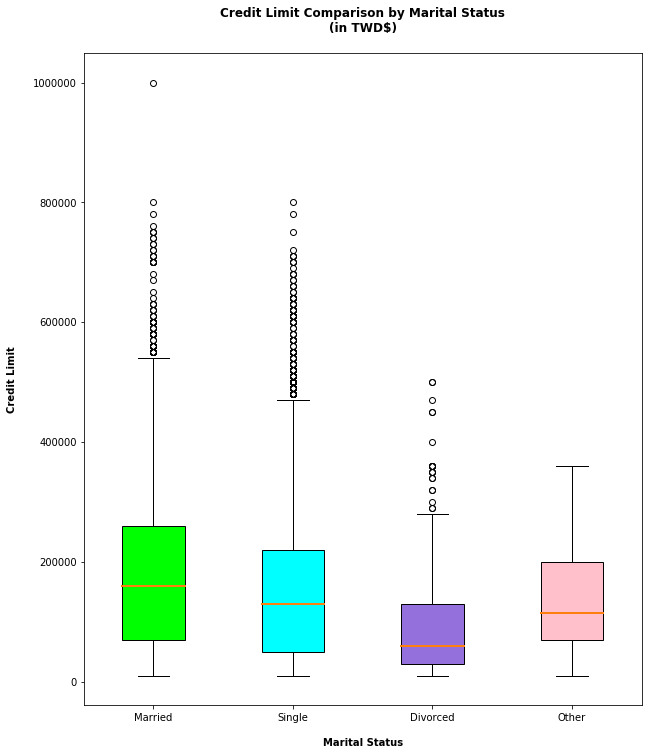

In [392]:
plt.figure(figsize = (10,12))

married = married.LIMIT_BAL
single = single.LIMIT_BAL
divorce = divorced.LIMIT_BAL
otherM = otherM.LIMIT_BAL

labels = ['Married','Single','Divorced','Other']
plt.title('Credit Limit Comparison by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparison of Bill Statements by Marital Status

## September 2005

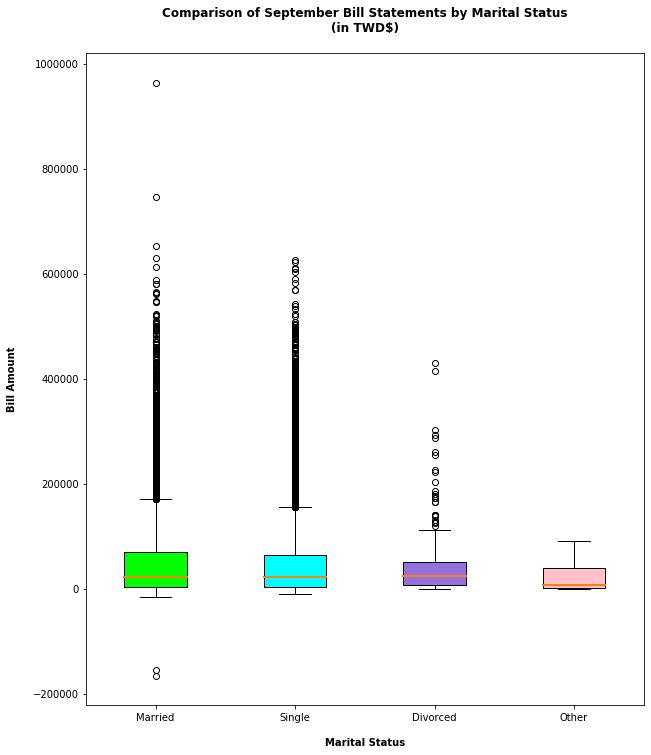

In [394]:
plt.figure(figsize = (10,12))

married = married.BILL_AMT1
single = single.BILL_AMT1
divorce = divorced.BILL_AMT1
otherM = otherM.BILL_AMT1

labels = ['Married','Single','Divorced','Other']
plt.title('Comparison of September Bill Statements by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## August 2005

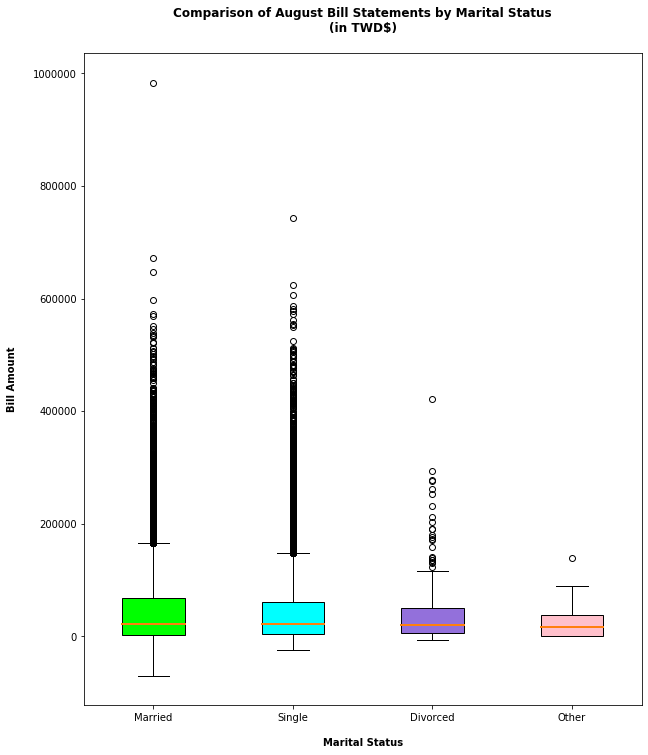

In [396]:
plt.figure(figsize = (10,12))

married = married.BILL_AMT2
single = single.BILL_AMT2
divorce = divorced.BILL_AMT2
otherM = otherM.BILL_AMT2

labels = ['Married','Single','Divorced','Other']
plt.title('Comparison of August Bill Statements by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## July 2005

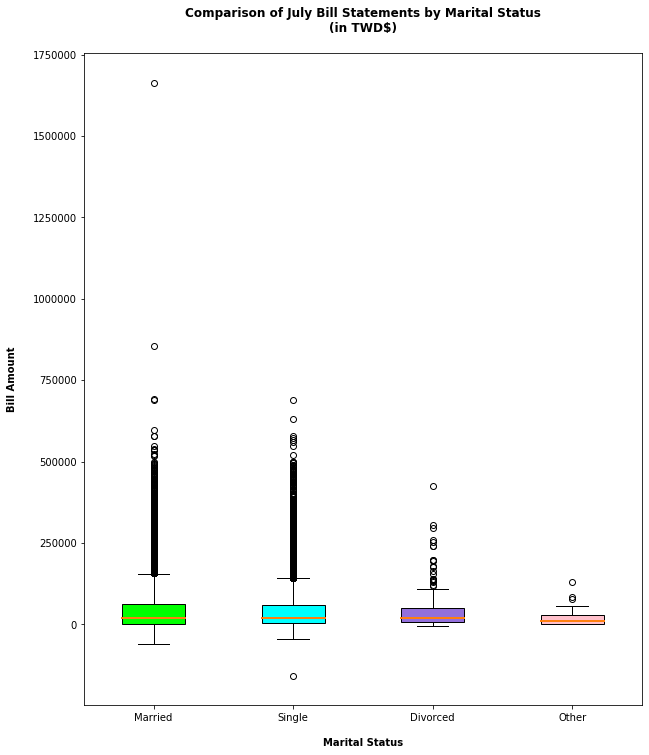

In [398]:
plt.figure(figsize = (10,12))

married = married.BILL_AMT3
single = single.BILL_AMT3
divorce = divorced.BILL_AMT3
otherM = otherM.BILL_AMT3

labels = ['Married','Single','Divorced','Other']
plt.title('Comparison of July Bill Statements by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## June 2005

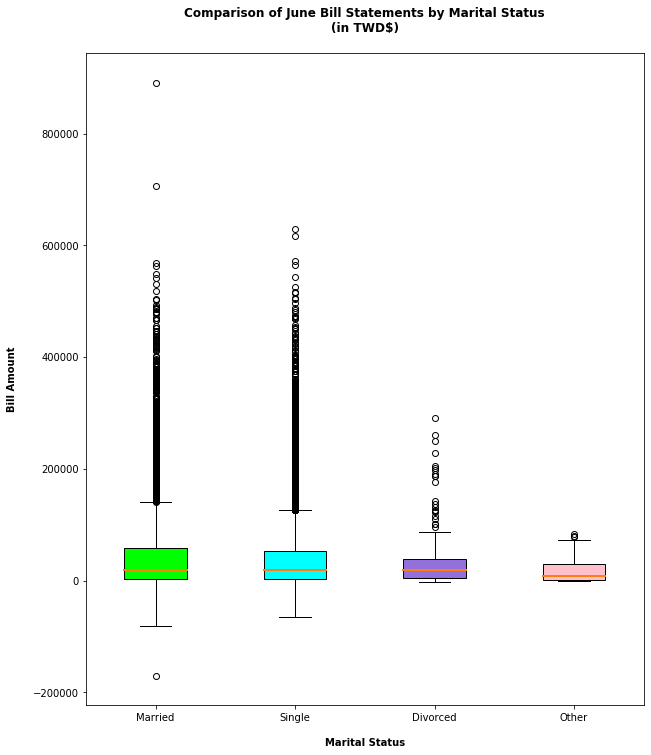

In [400]:
plt.figure(figsize = (10,12))

married = married.BILL_AMT4
single = single.BILL_AMT4
divorce = divorced.BILL_AMT4
otherM = otherM.BILL_AMT4

labels = ['Married','Single','Divorced','Other']
plt.title('Comparison of June Bill Statements by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## May 2005

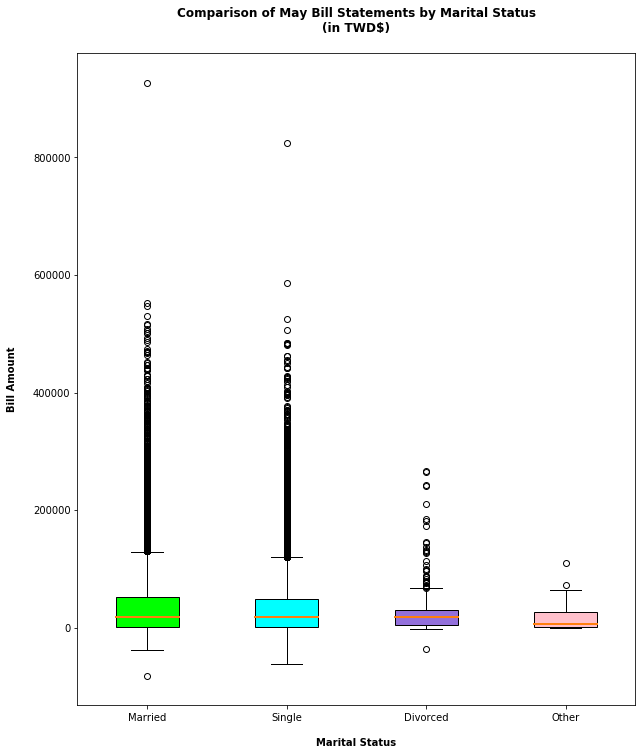

In [402]:
plt.figure(figsize = (10,12))

married = married.BILL_AMT5
single = single.BILL_AMT5
divorce = divorced.BILL_AMT5
otherM = otherM.BILL_AMT5

labels = ['Married','Single','Divorced','Other']
plt.title('Comparison of May Bill Statements by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

## April 2005

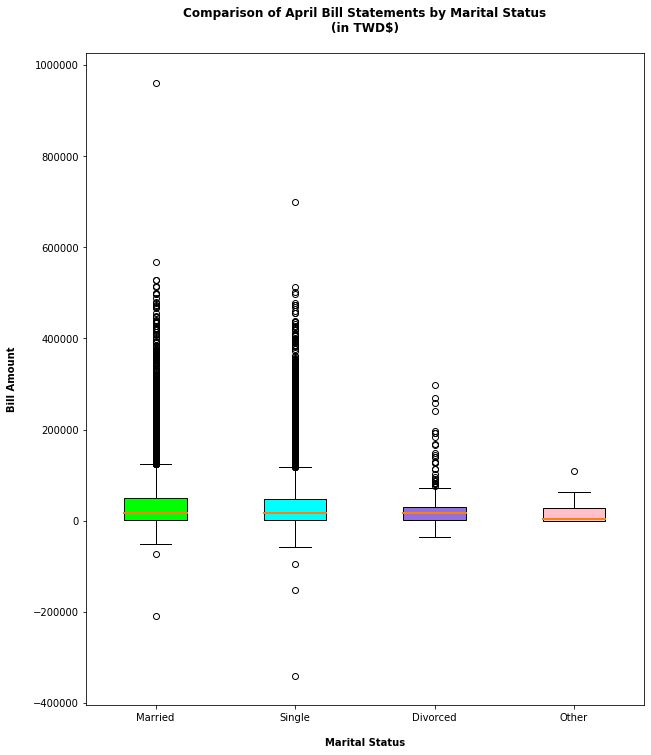

In [404]:
plt.figure(figsize = (10,12))

married = married.BILL_AMT6
single = single.BILL_AMT6
divorce = divorced.BILL_AMT6
otherM = otherM.BILL_AMT6

labels = ['Married','Single','Divorced','Other']
plt.title('Comparison of April Bill Statements by Marital Status\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([married, single, divorce, otherM], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparison - Monthly Bill Statements to Credit Limits by Marital Status

## September 2005

### Line Plots

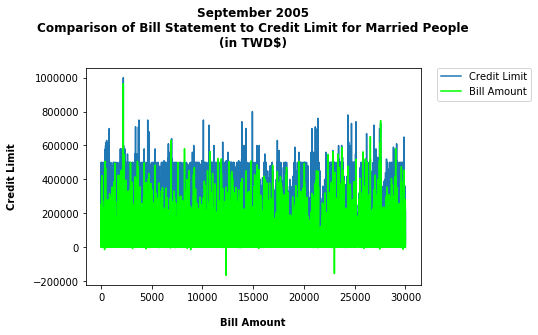

In [406]:
plt.plot(married.LIMIT_BAL, label = 'Credit Limit')
plt.plot(married.BILL_AMT1, color = 'lime', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

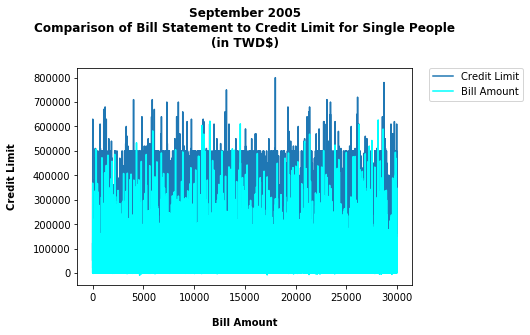

In [407]:
plt.plot(single.LIMIT_BAL, label = 'Credit Limit')
plt.plot(single.BILL_AMT1, color = 'cyan', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

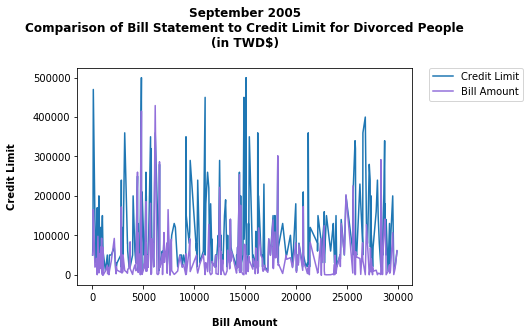

In [408]:
plt.plot(divorced.LIMIT_BAL, label = 'Credit Limit')
plt.plot(divorced.BILL_AMT1, color = 'mediumpurple', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

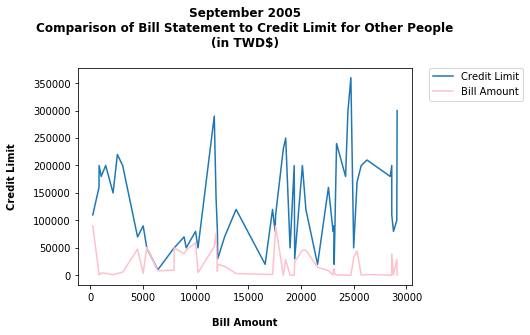

In [409]:
plt.plot(otherM.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherM.BILL_AMT1, color = 'pink', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

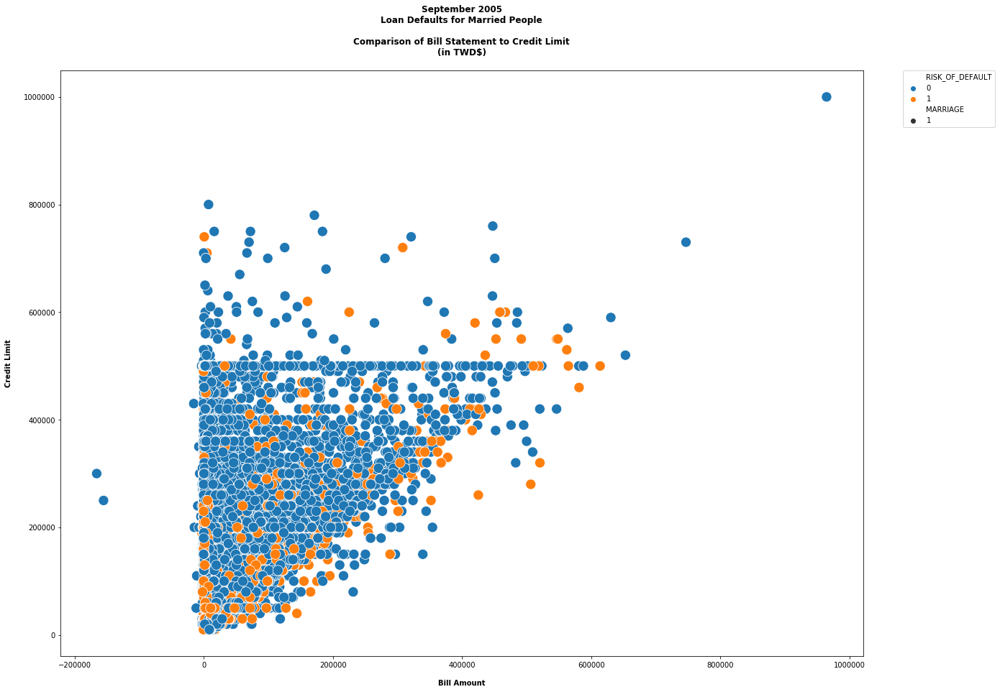

In [410]:
x = married.BILL_AMT1
y = married.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('September 2005\nLoan Defaults for Married People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

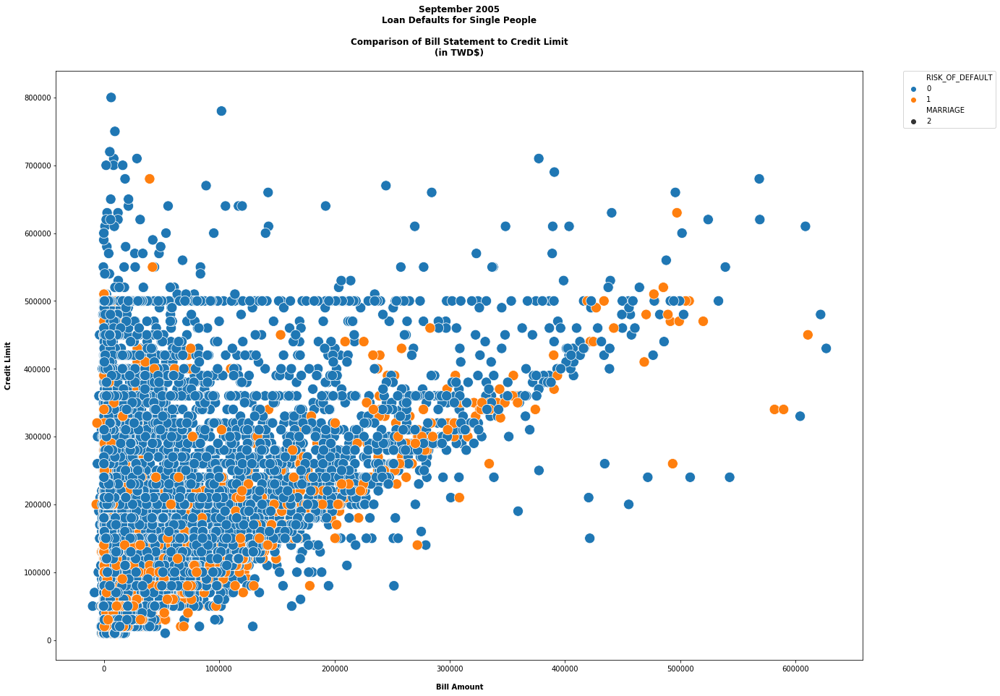

In [411]:
x = single.BILL_AMT1
y = single.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('September 2005\nLoan Defaults for Single People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

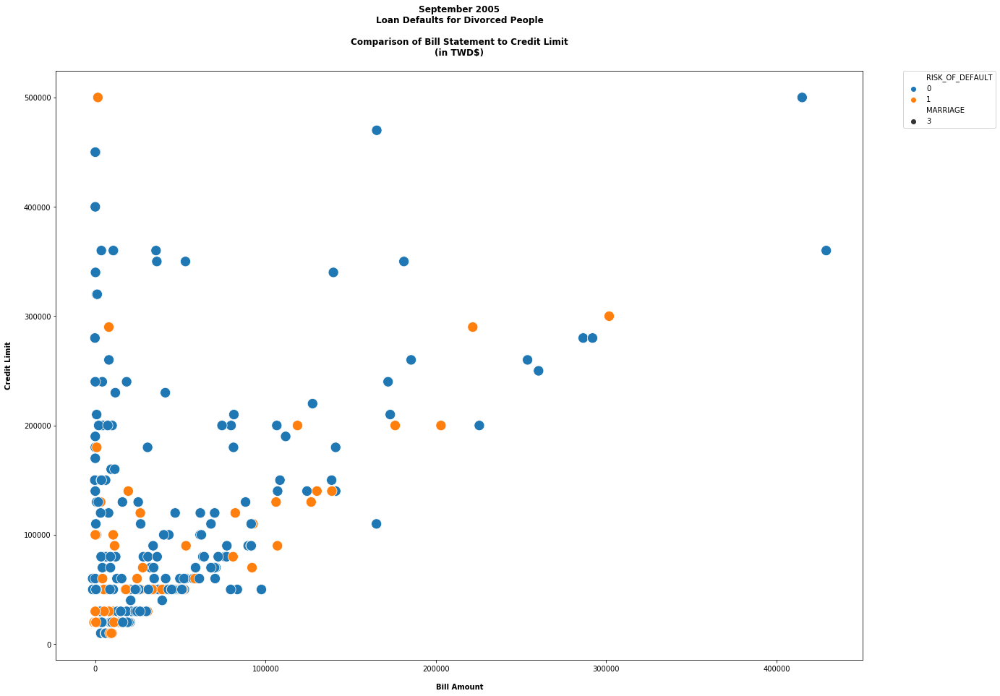

In [412]:
x = divorced.BILL_AMT1
y = divorced.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('September 2005\nLoan Defaults for Divorced People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

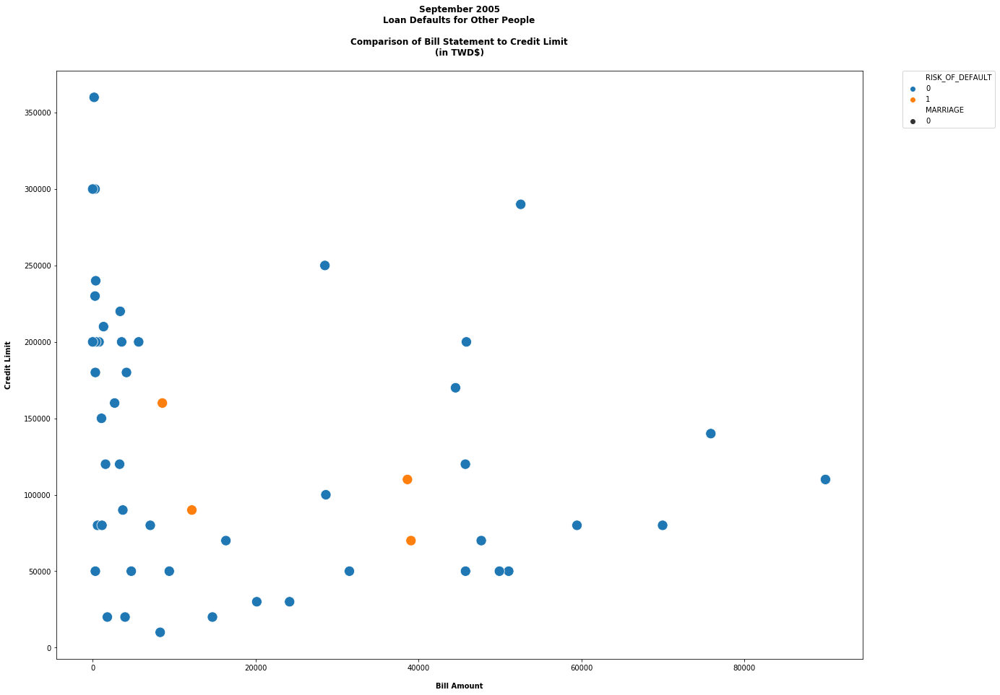

In [413]:
x = otherM.BILL_AMT1
y = otherM.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('September 2005\nLoan Defaults for Other People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

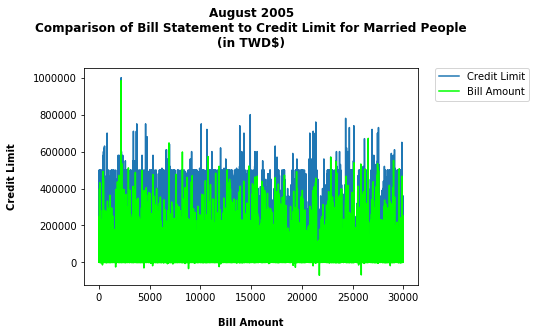

In [414]:
plt.plot(married.LIMIT_BAL, label = 'Credit Limit')
plt.plot(married.BILL_AMT2, color = 'lime', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

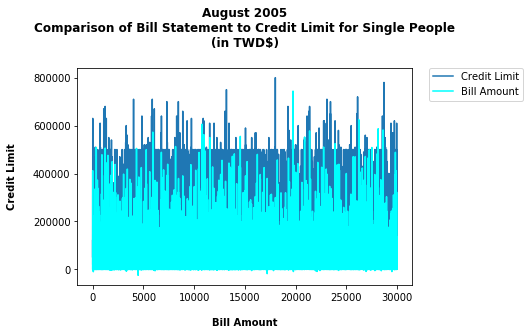

In [415]:
plt.plot(single.LIMIT_BAL, label = 'Credit Limit')
plt.plot(single.BILL_AMT2, color = 'cyan', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

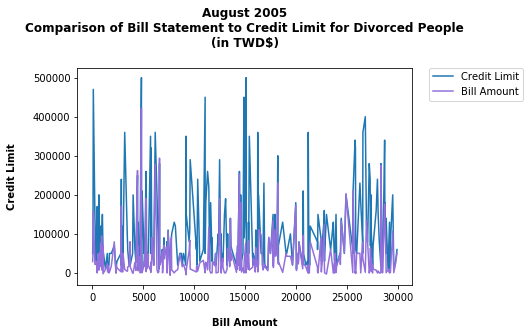

In [416]:
plt.plot(divorced.LIMIT_BAL, label = 'Credit Limit')
plt.plot(divorced.BILL_AMT2, color = 'mediumpurple', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

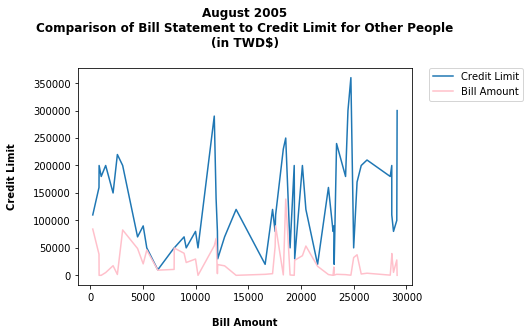

In [417]:
plt.plot(otherM.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherM.BILL_AMT2, color = 'pink', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

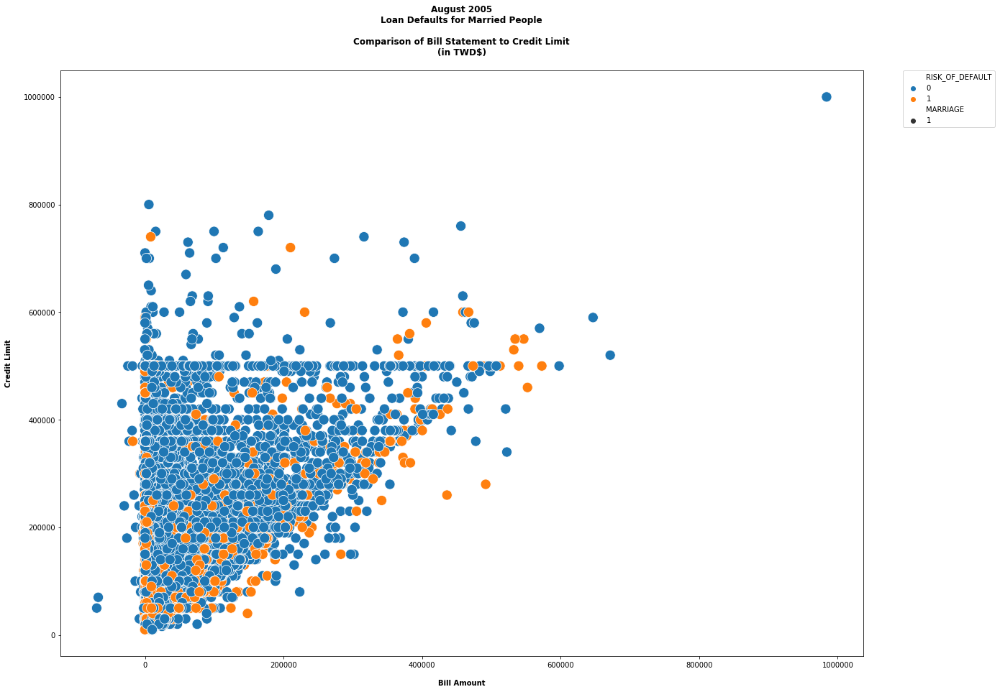

In [418]:
x = married.BILL_AMT2
y = married.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('August 2005\nLoan Defaults for Married People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

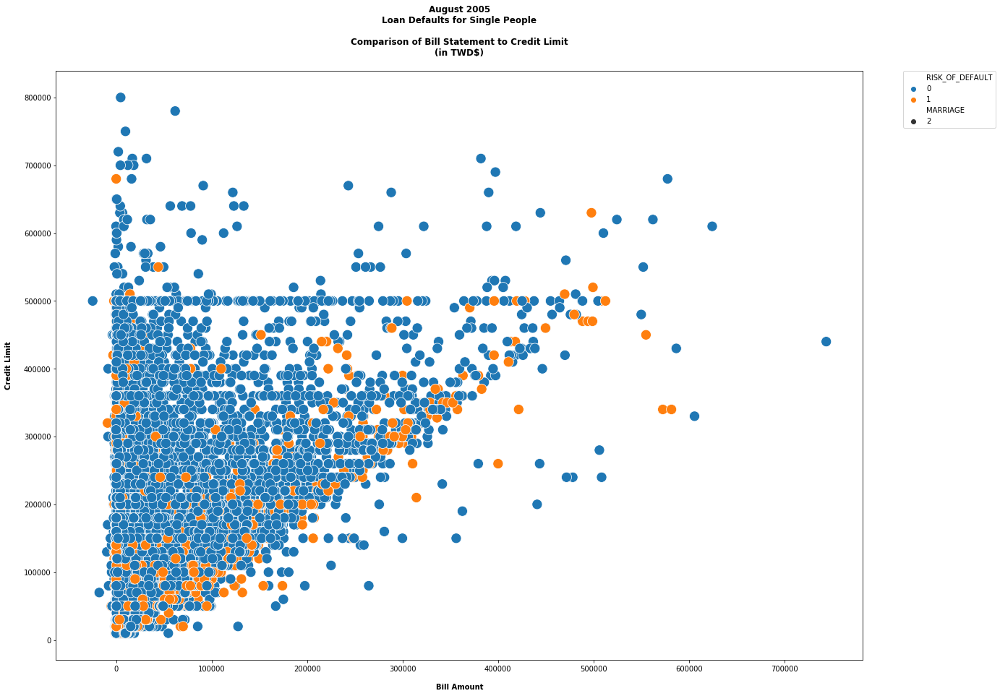

In [419]:
x = single.BILL_AMT2
y = single.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('August 2005\nLoan Defaults for Single People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

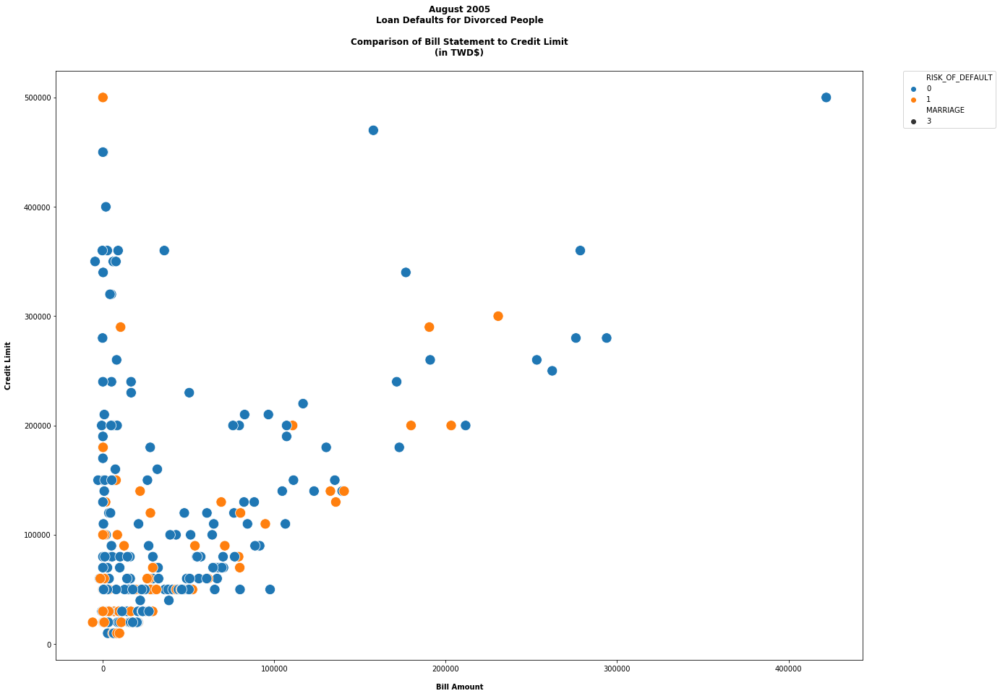

In [420]:
x = divorced.BILL_AMT2
y = divorced.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('August 2005\nLoan Defaults for Divorced People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

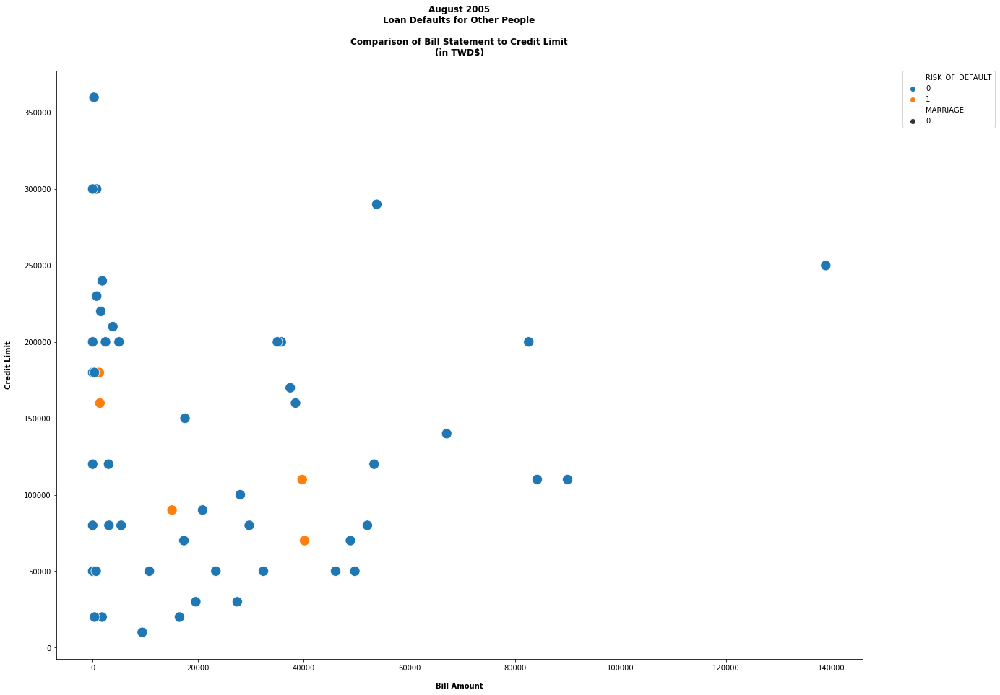

In [421]:
x = otherM.BILL_AMT2
y = otherM.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('August 2005\nLoan Defaults for Other People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

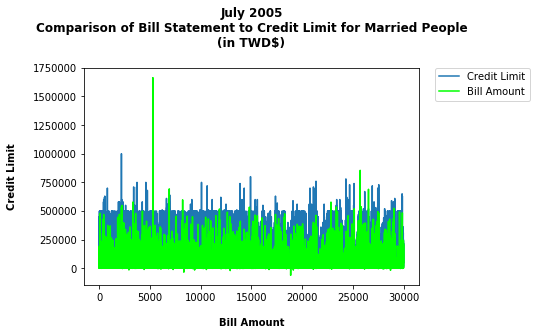

In [422]:
plt.plot(married.LIMIT_BAL, label = 'Credit Limit')
plt.plot(married.BILL_AMT3, color = 'lime', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

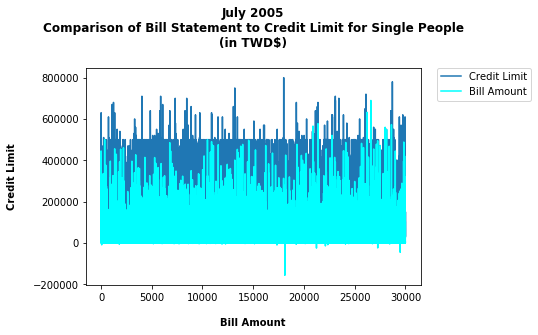

In [423]:
plt.plot(single.LIMIT_BAL, label = 'Credit Limit')
plt.plot(single.BILL_AMT3, color = 'cyan', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

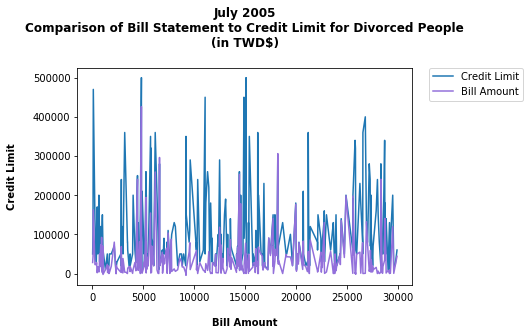

In [424]:
plt.plot(divorced.LIMIT_BAL, label = 'Credit Limit')
plt.plot(divorced.BILL_AMT3, color = 'mediumpurple', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

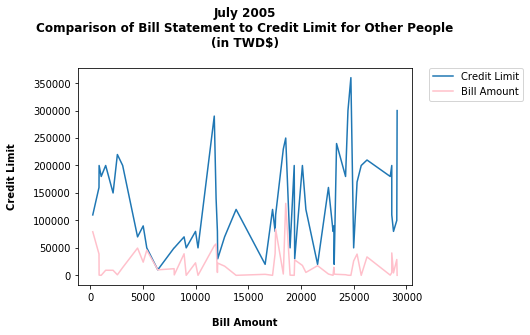

In [425]:
plt.plot(otherM.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherM.BILL_AMT3, color = 'pink', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

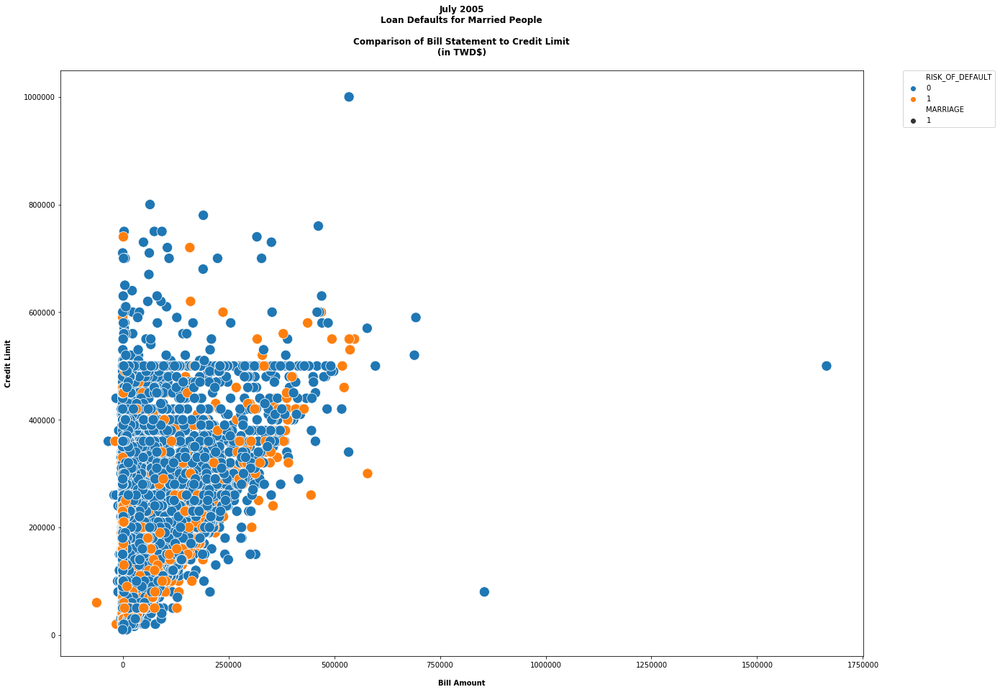

In [426]:
x = married.BILL_AMT3
y = married.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('July 2005\nLoan Defaults for Married People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

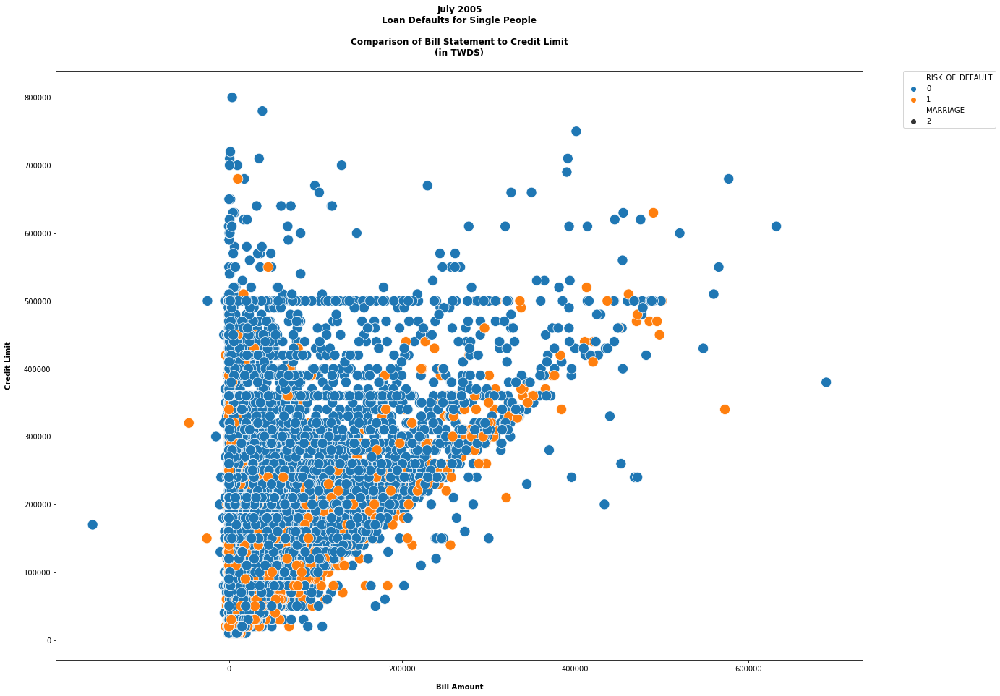

In [427]:
x = single.BILL_AMT3
y = single.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('July 2005\nLoan Defaults for Single People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

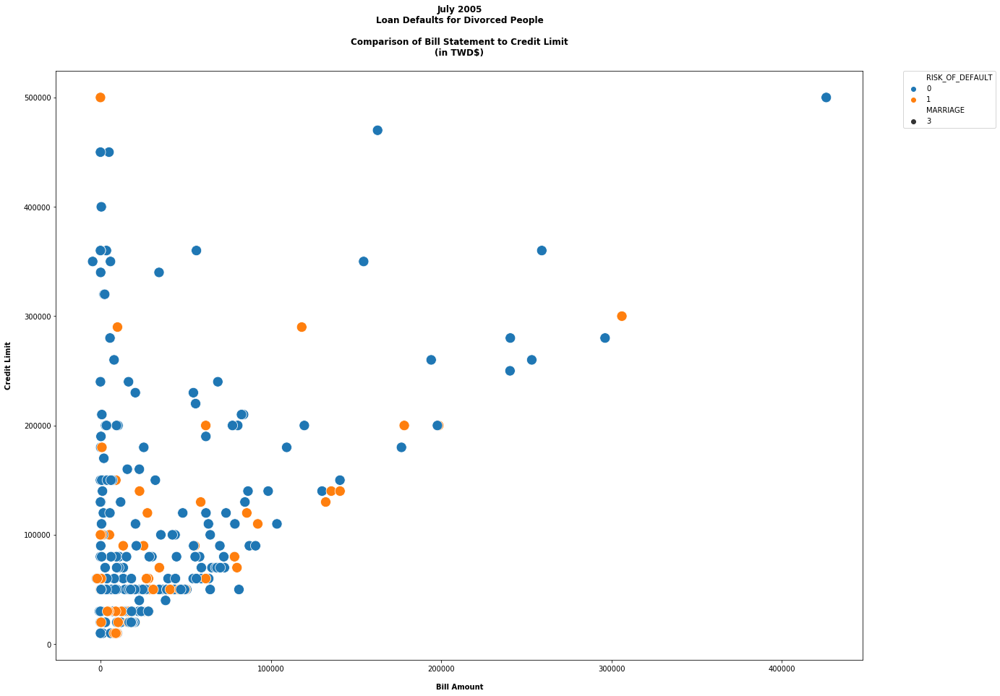

In [428]:
x = divorced.BILL_AMT3
y = divorced.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('July 2005\nLoan Defaults for Divorced People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

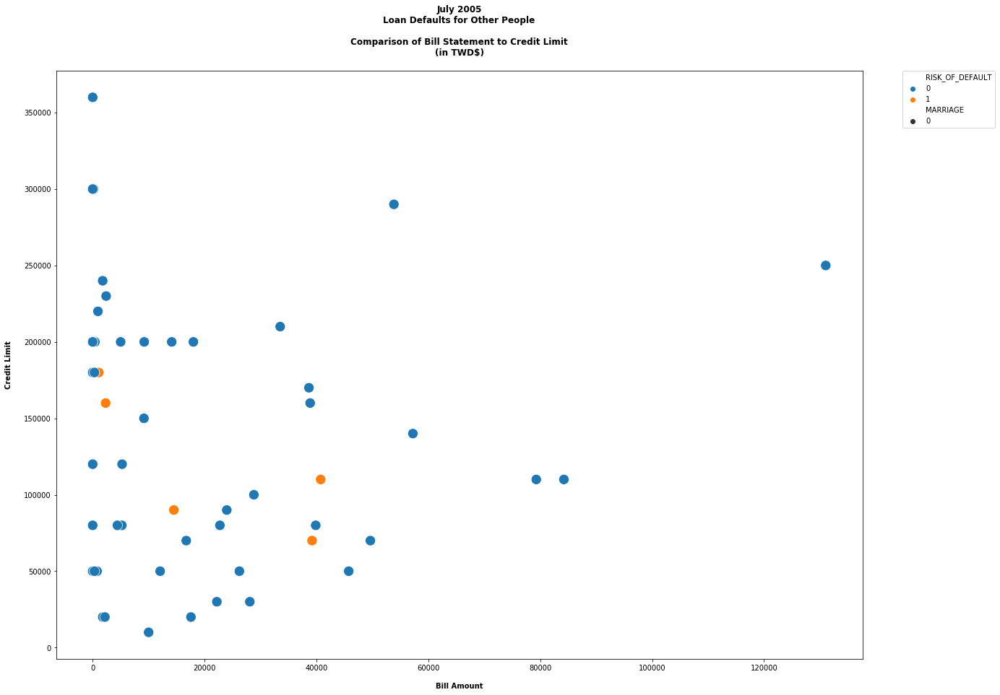

In [429]:
x = otherM.BILL_AMT3
y = otherM.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('July 2005\nLoan Defaults for Other People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

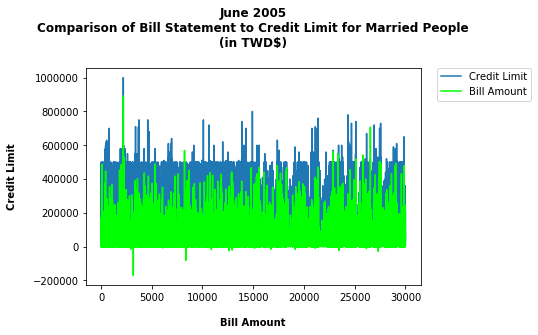

In [430]:
plt.plot(married.LIMIT_BAL, label = 'Credit Limit')
plt.plot(married.BILL_AMT4, color = 'lime', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

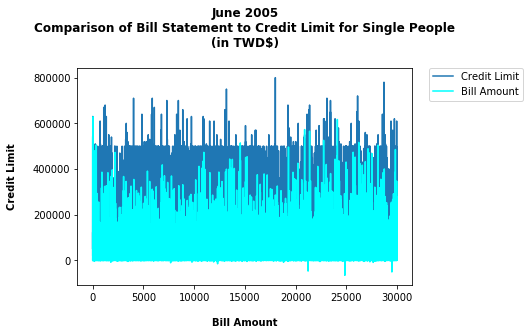

In [431]:
plt.plot(single.LIMIT_BAL, label = 'Credit Limit')
plt.plot(single.BILL_AMT4, color = 'cyan', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

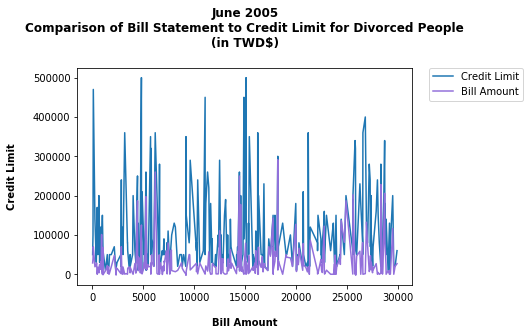

In [432]:
plt.plot(divorced.LIMIT_BAL, label = 'Credit Limit')
plt.plot(divorced.BILL_AMT4, color = 'mediumpurple', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

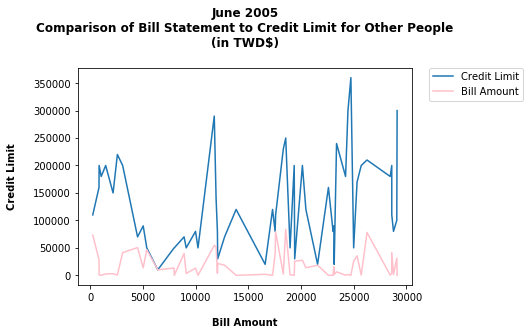

In [433]:
plt.plot(otherM.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherM.BILL_AMT4, color = 'pink', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

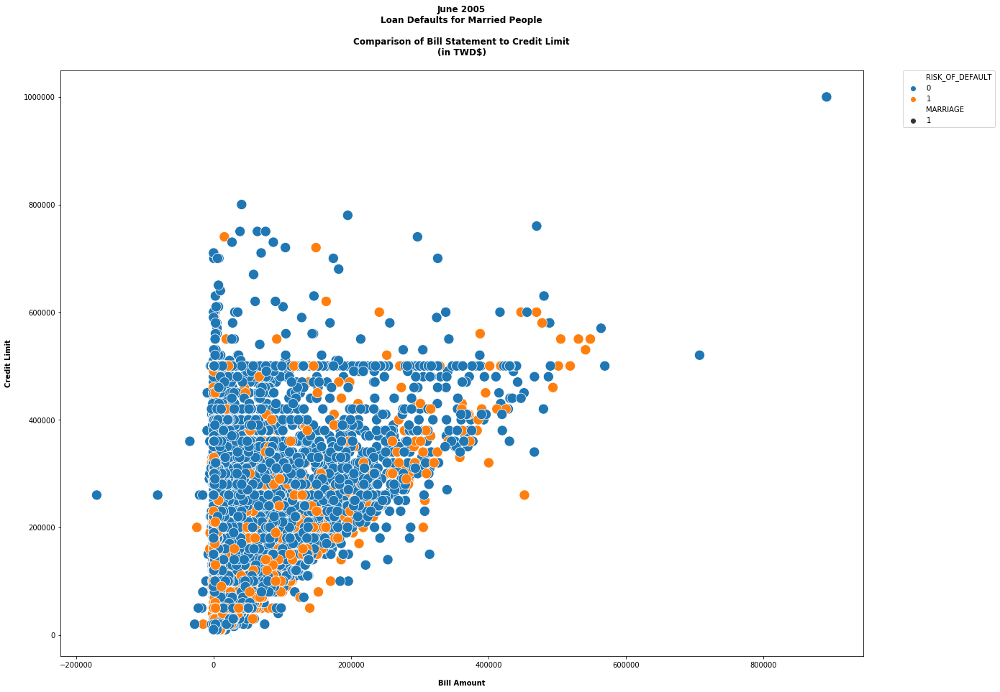

In [434]:
x = married.BILL_AMT4
y = married.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('June 2005\nLoan Defaults for Married People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

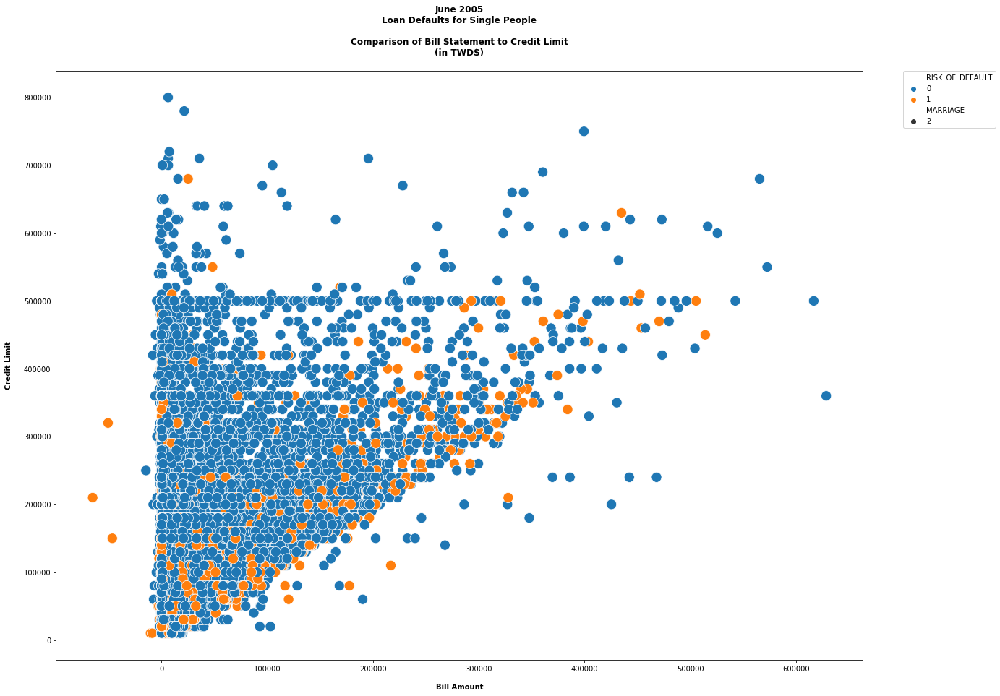

In [435]:
x = single.BILL_AMT4
y = single.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('June 2005\nLoan Defaults for Single People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

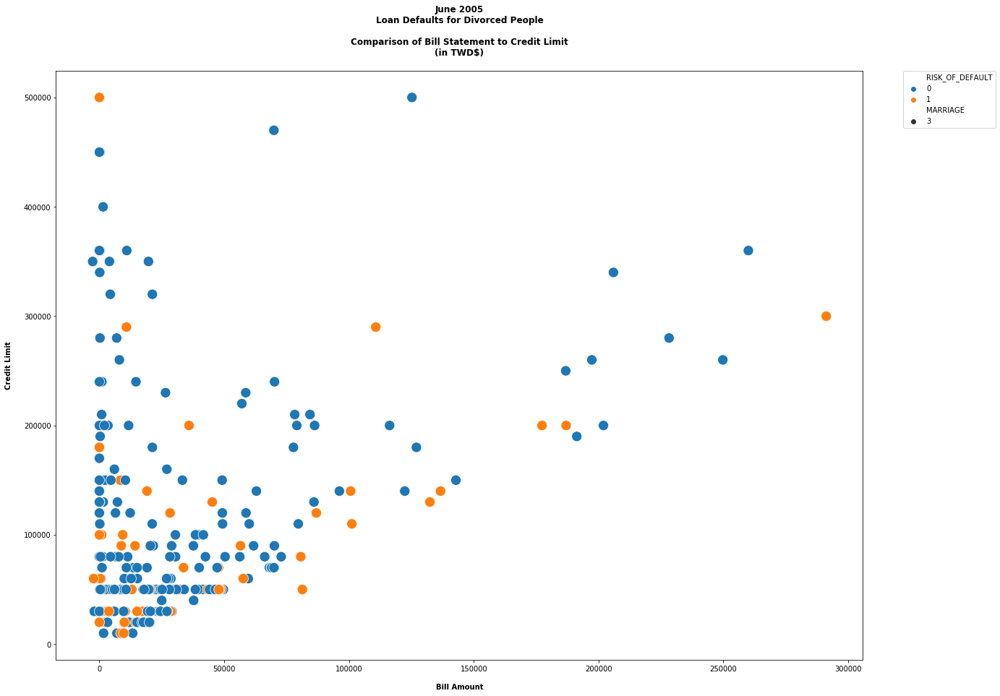

In [436]:
x = divorced.BILL_AMT4
y = divorced.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('June 2005\nLoan Defaults for Divorced People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

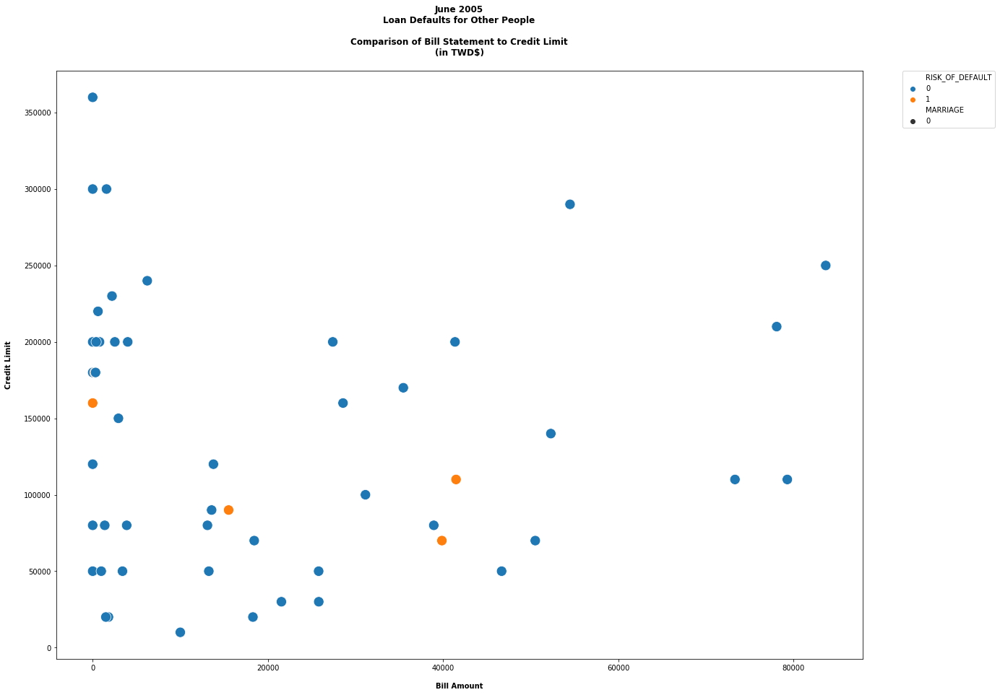

In [437]:
x = otherM.BILL_AMT4
y = otherM.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('June 2005\nLoan Defaults for Other People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

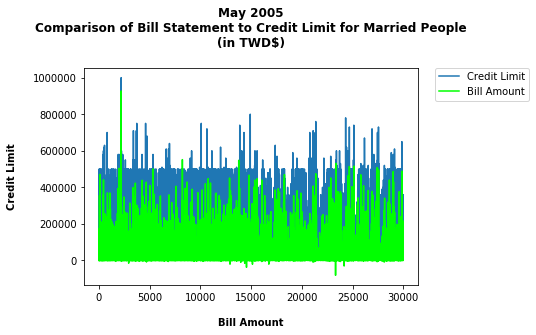

In [438]:
plt.plot(married.LIMIT_BAL, label = 'Credit Limit')
plt.plot(married.BILL_AMT5, color = 'lime', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

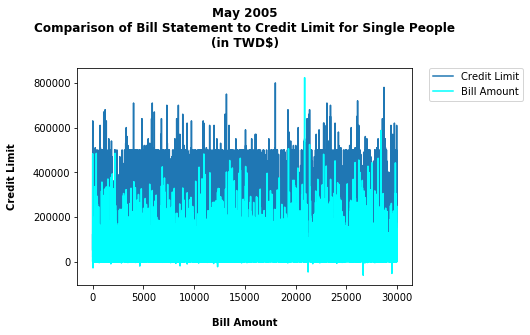

In [439]:
plt.plot(single.LIMIT_BAL, label = 'Credit Limit')
plt.plot(single.BILL_AMT5, color = 'cyan', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

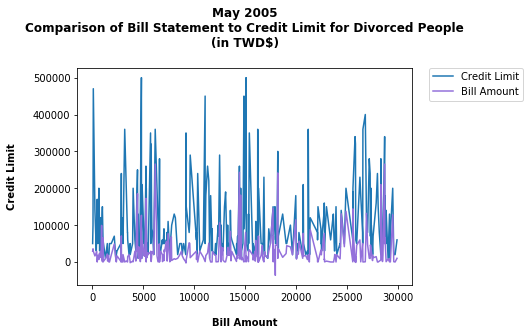

In [440]:
plt.plot(divorced.LIMIT_BAL, label = 'Credit Limit')
plt.plot(divorced.BILL_AMT5, color = 'mediumpurple', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

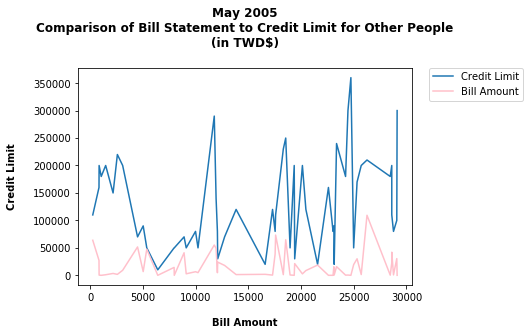

In [441]:
plt.plot(otherM.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherM.BILL_AMT5, color = 'pink', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

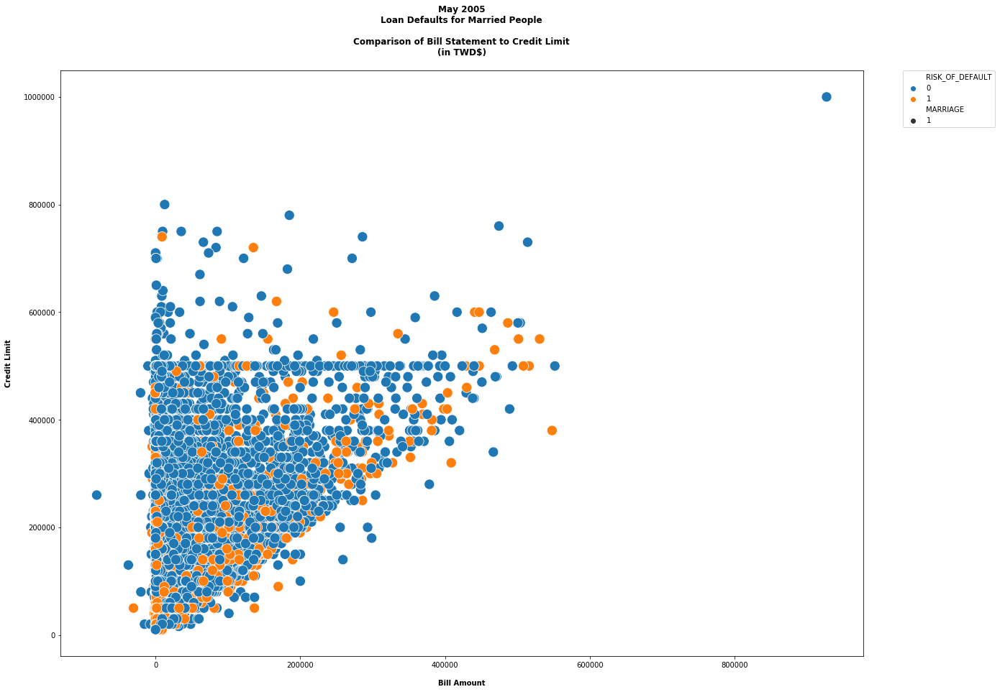

In [442]:
x = married.BILL_AMT5
y = married.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('May 2005\nLoan Defaults for Married People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

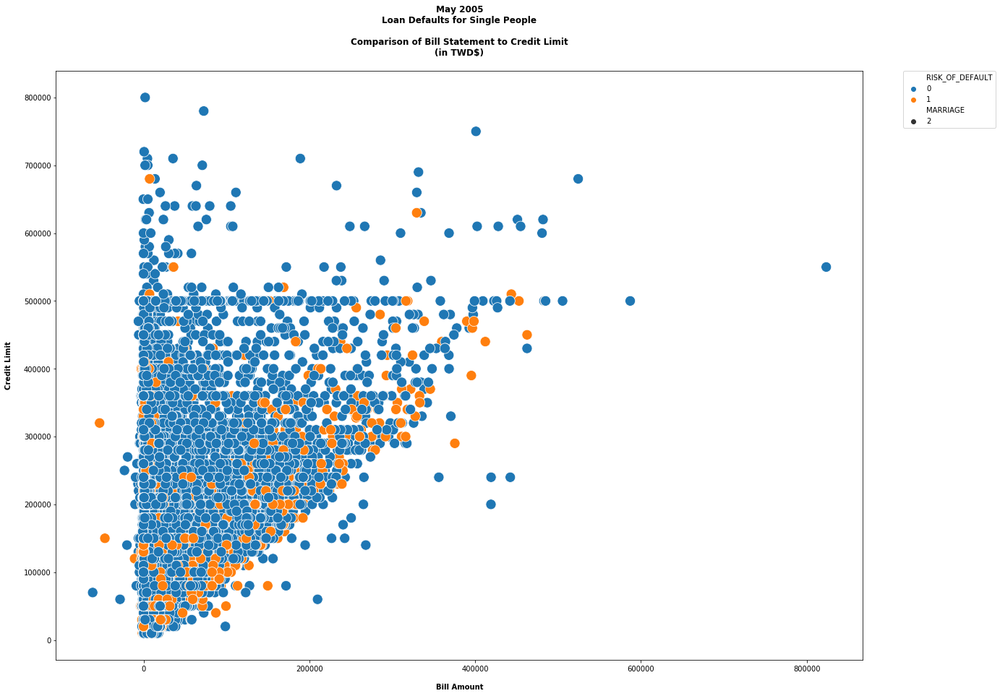

In [443]:
x = single.BILL_AMT5
y = single.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('May 2005\nLoan Defaults for Single People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

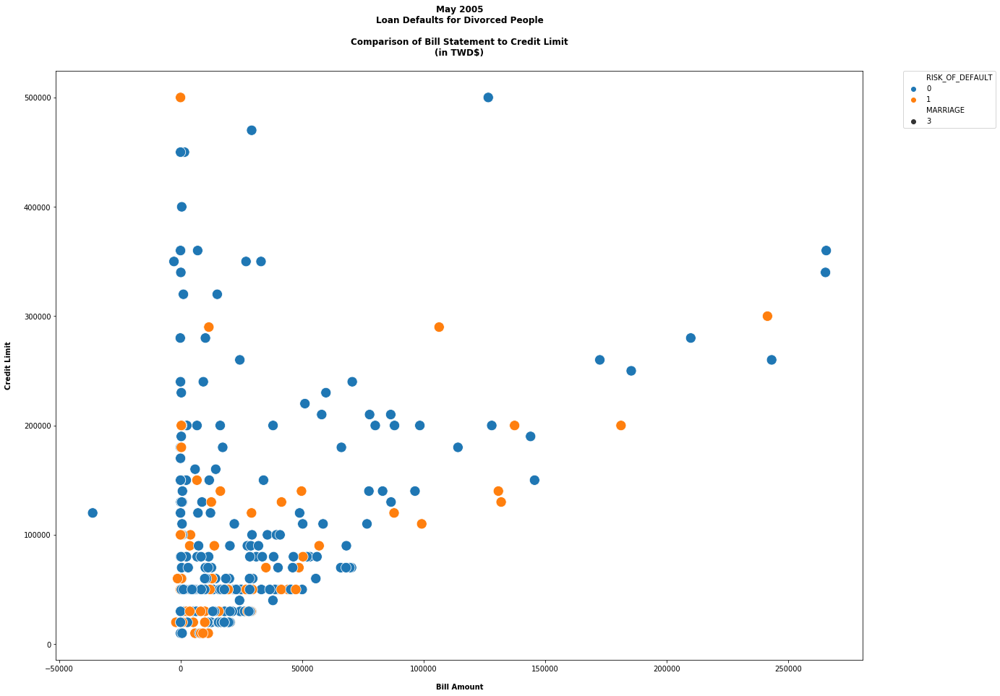

In [444]:
x = divorced.BILL_AMT5
y = divorced.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('May 2005\nLoan Defaults for Divorced People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

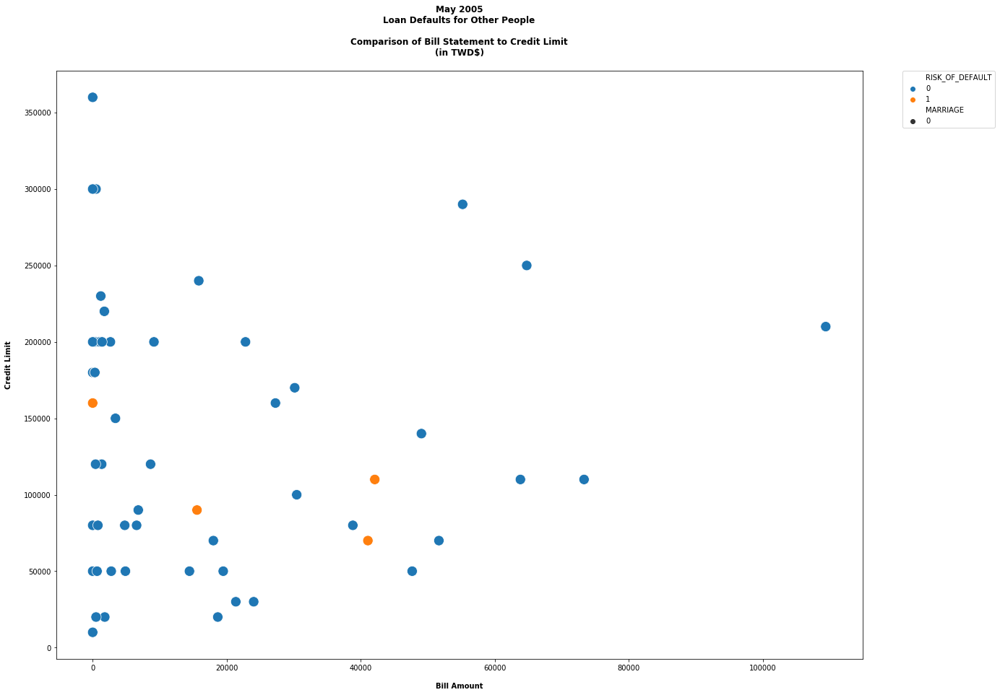

In [445]:
x = otherM.BILL_AMT5
y = otherM.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('May 2005\nLoan Defaults for Other People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

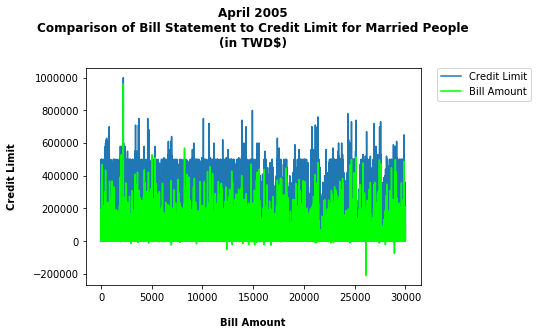

In [446]:
plt.plot(married.LIMIT_BAL, label = 'Credit Limit')
plt.plot(married.BILL_AMT6, color = 'lime', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

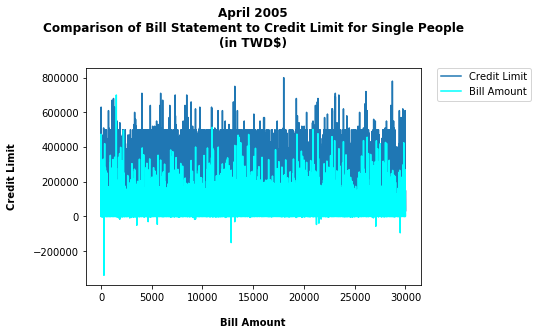

In [447]:
plt.plot(single.LIMIT_BAL, label = 'Credit Limit')
plt.plot(single.BILL_AMT6, color = 'cyan', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

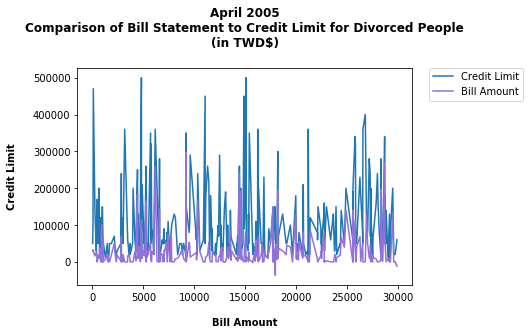

In [448]:
plt.plot(divorced.LIMIT_BAL, label = 'Credit Limit')
plt.plot(divorced.BILL_AMT6, color = 'mediumpurple', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

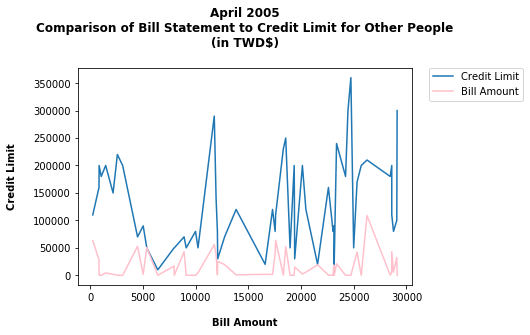

In [449]:
plt.plot(otherM.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherM.BILL_AMT6, color = 'pink', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

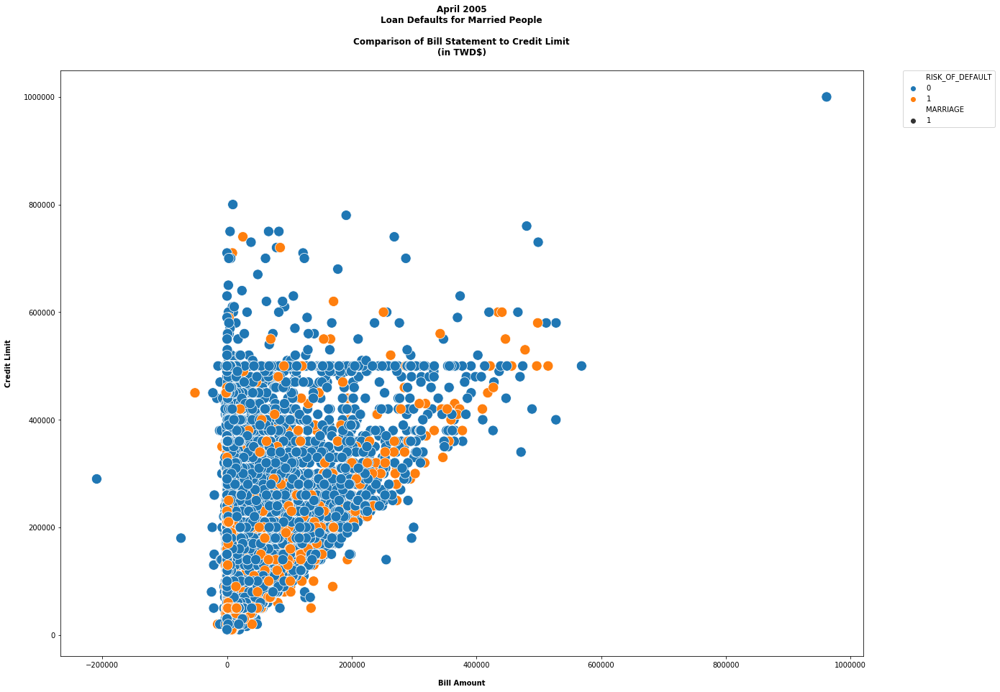

In [450]:
x = married.BILL_AMT6
y = married.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('April 2005\nLoan Defaults for Married People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

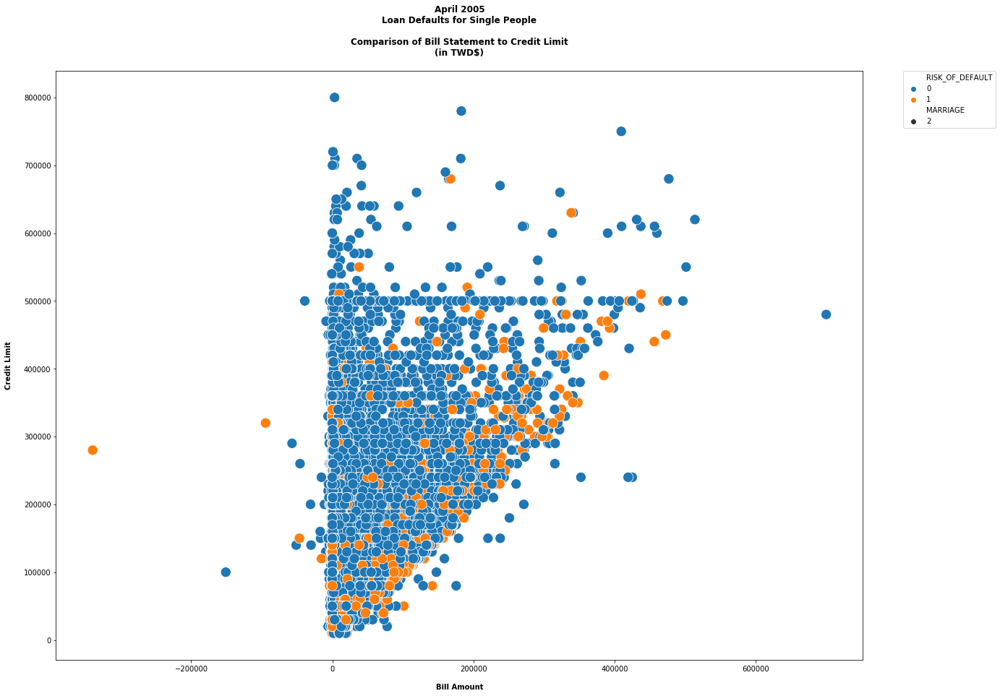

In [451]:
x = single.BILL_AMT6
y = single.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('April 2005\nLoan Defaults for Single People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

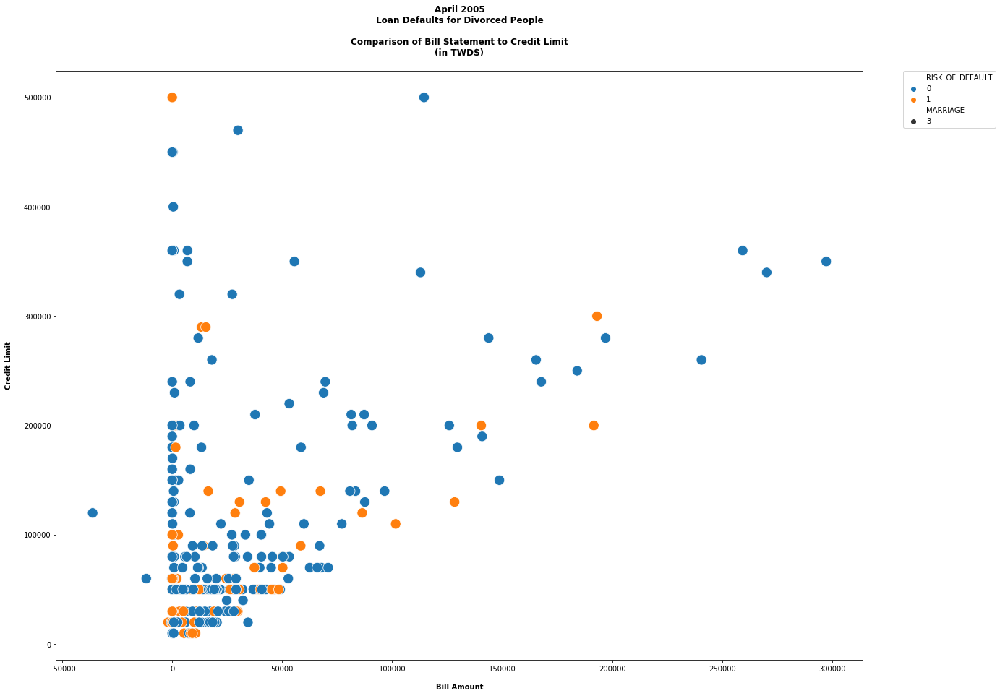

In [452]:
x = divorced.BILL_AMT6
y = divorced.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('April 2005\nLoan Defaults for Divorced People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

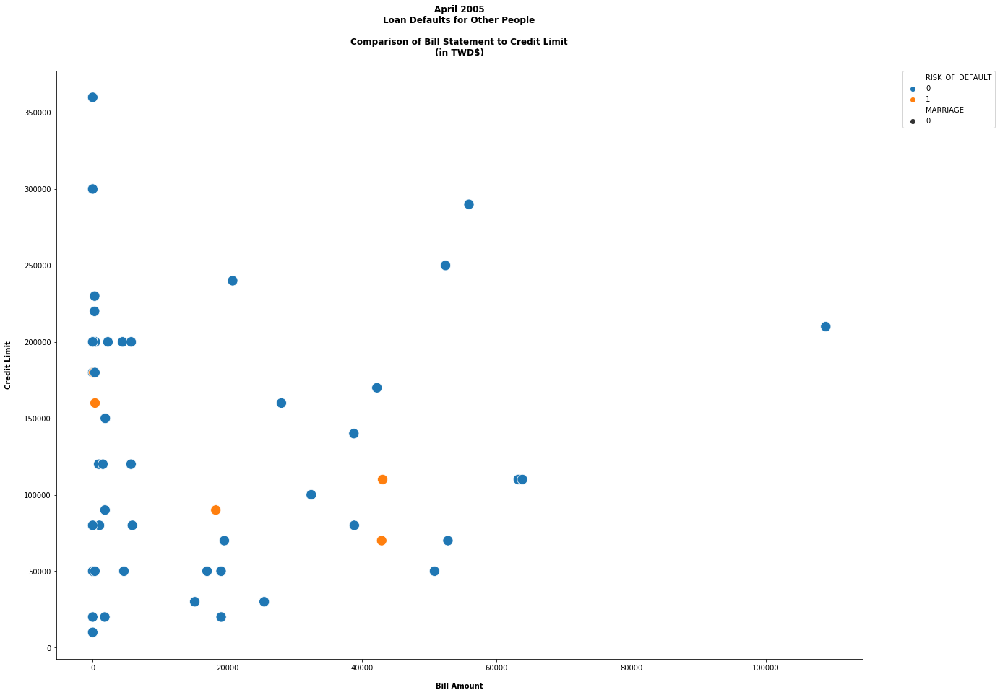

In [453]:
x = otherM.BILL_AMT6
y = otherM.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('April 2005\nLoan Defaults for Other People\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

# Comparison - Monthly Bill Statements & Paid Amounts by Marital Status

## September 2005

### Line Plots

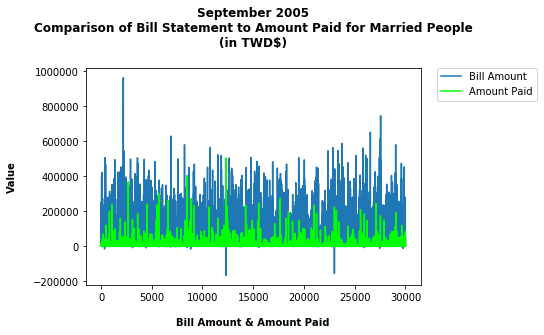

In [454]:
plt.plot(married.BILL_AMT1, label = 'Bill Amount')
plt.plot(married.PAY_AMT1, color = 'lime', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

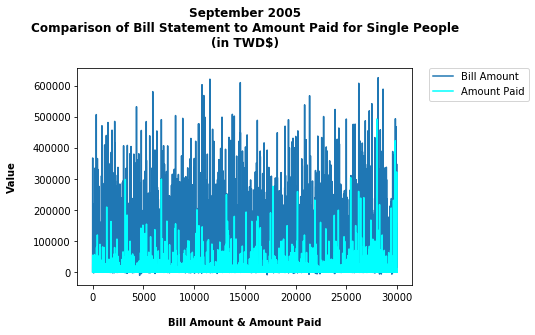

In [455]:
plt.plot(single.BILL_AMT1, label = 'Bill Amount')
plt.plot(single.PAY_AMT1, color = 'cyan', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

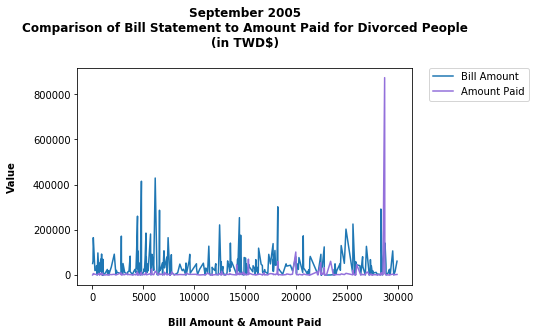

In [456]:
plt.plot(divorced.BILL_AMT1, label = 'Bill Amount')
plt.plot(divorced.PAY_AMT1, color = 'mediumpurple', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

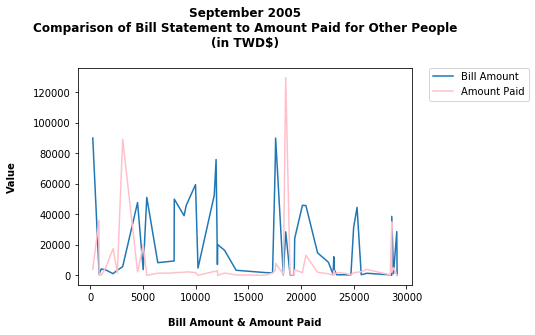

In [457]:
plt.plot(otherM.BILL_AMT1, label = 'Bill Amount')
plt.plot(otherM.PAY_AMT1, color = 'pink', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

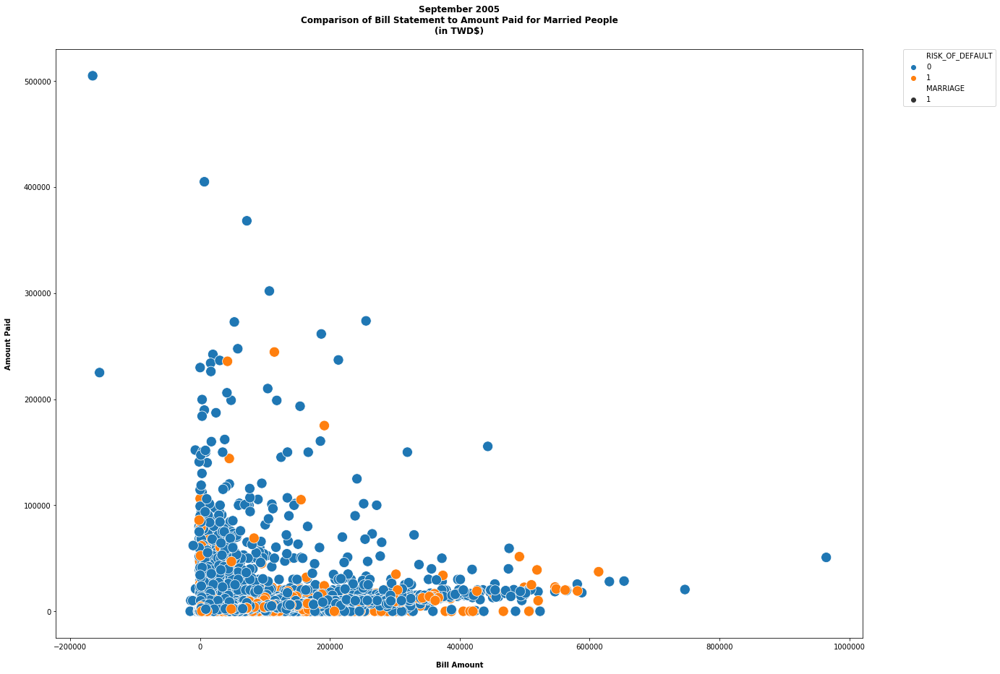

In [458]:
x = married.BILL_AMT1
y = married.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

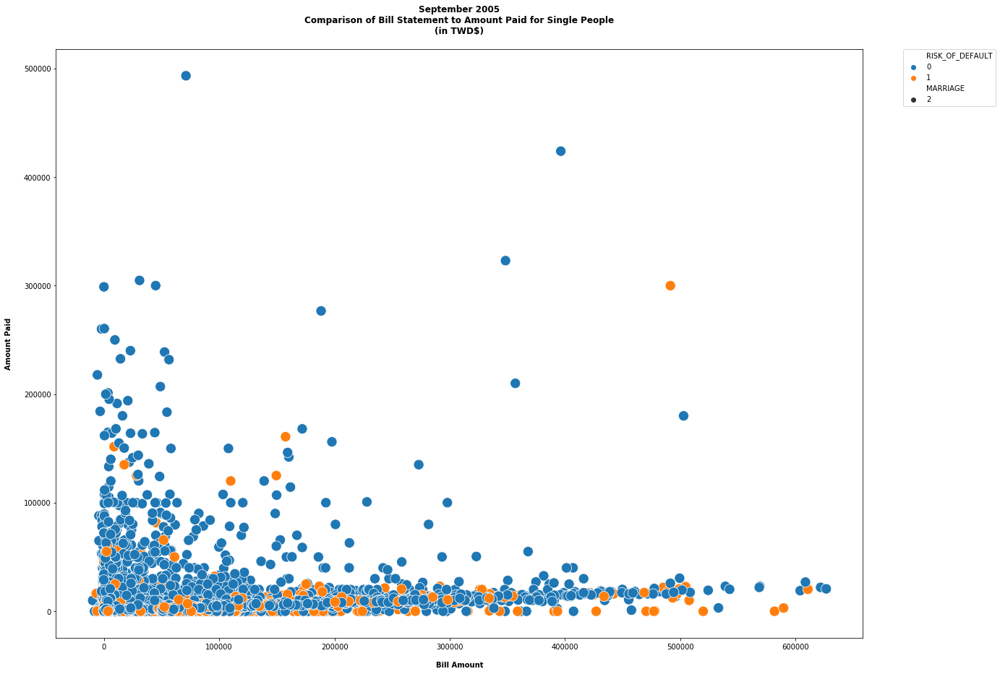

In [459]:
x = single.BILL_AMT1
y = single.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

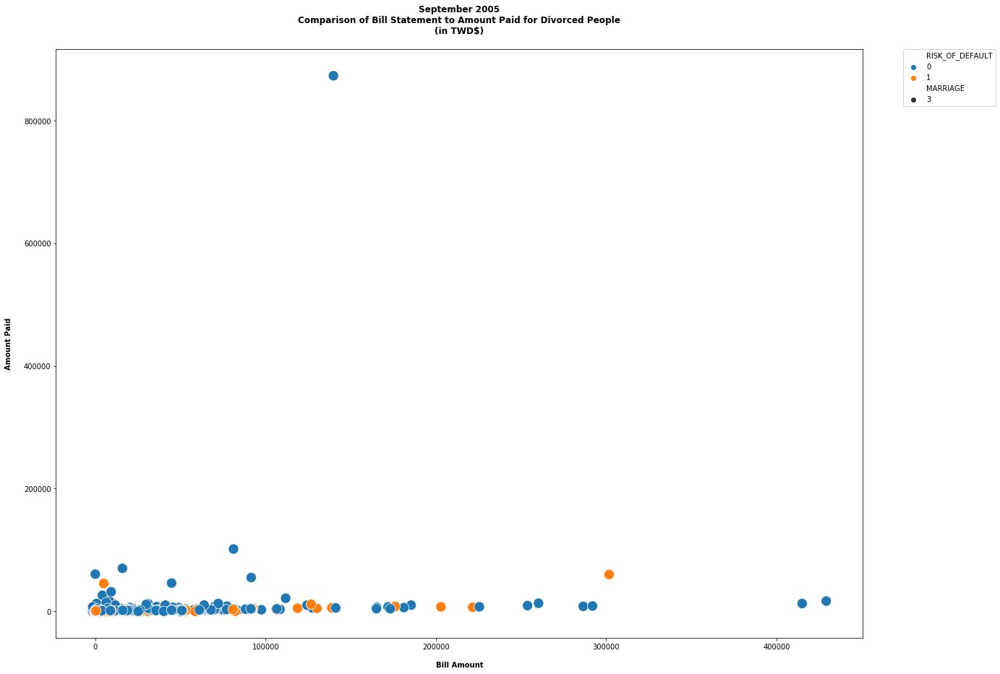

In [460]:
x = divorced.BILL_AMT1
y = divorced.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

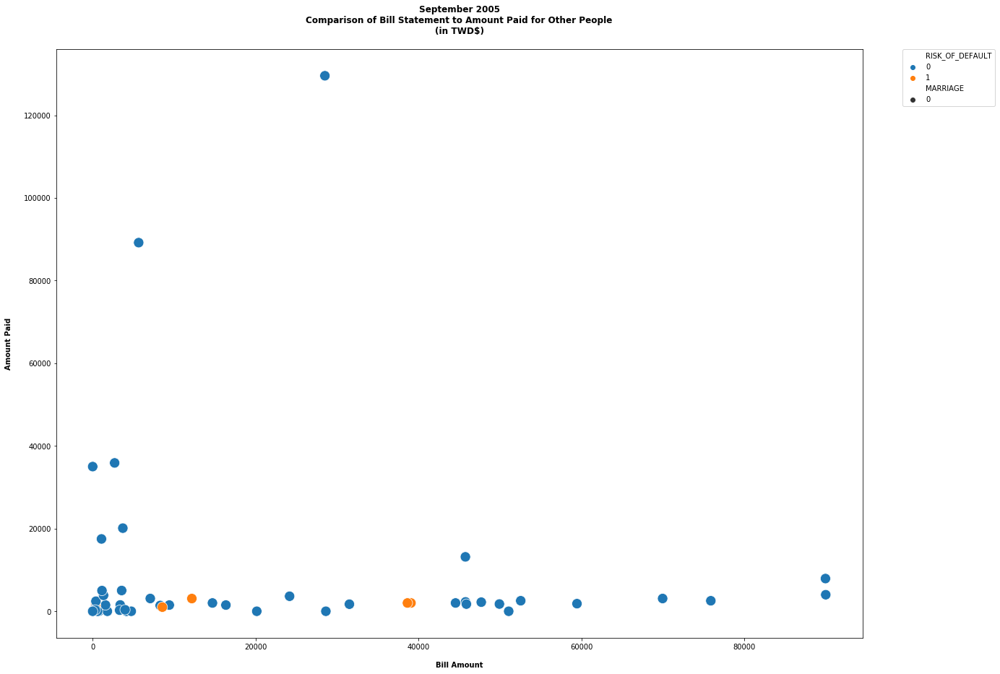

In [461]:
x = otherM.BILL_AMT1
y = otherM.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

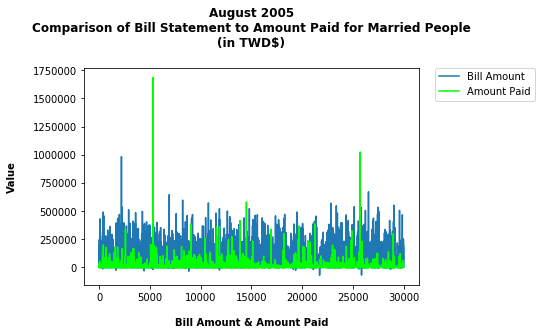

In [462]:
plt.plot(married.BILL_AMT2, label = 'Bill Amount')
plt.plot(married.PAY_AMT2, color = 'lime', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

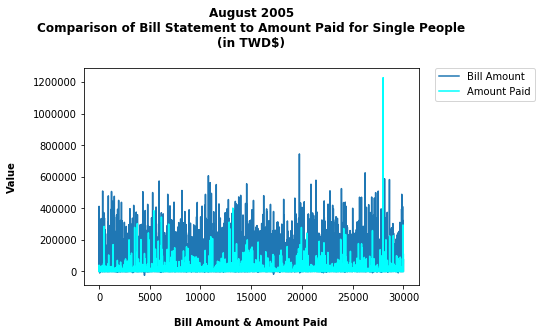

In [463]:
plt.plot(single.BILL_AMT2, label = 'Bill Amount')
plt.plot(single.PAY_AMT2, color = 'cyan', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

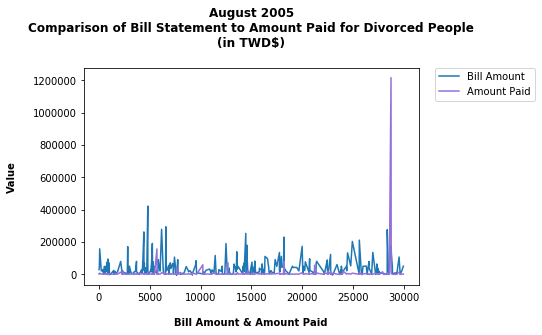

In [464]:
plt.plot(divorced.BILL_AMT2, label = 'Bill Amount')
plt.plot(divorced.PAY_AMT2, color = 'mediumpurple', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

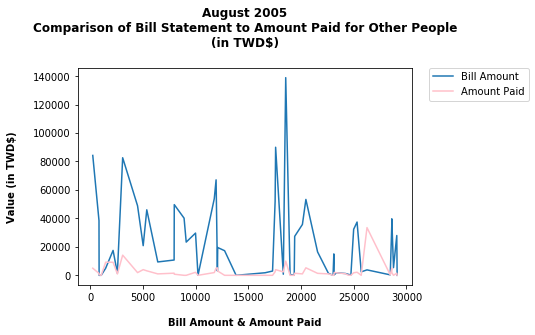

In [465]:
plt.plot(otherM.BILL_AMT2, label = 'Bill Amount')
plt.plot(otherM.PAY_AMT2, color = 'pink', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value (in TWD$)\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

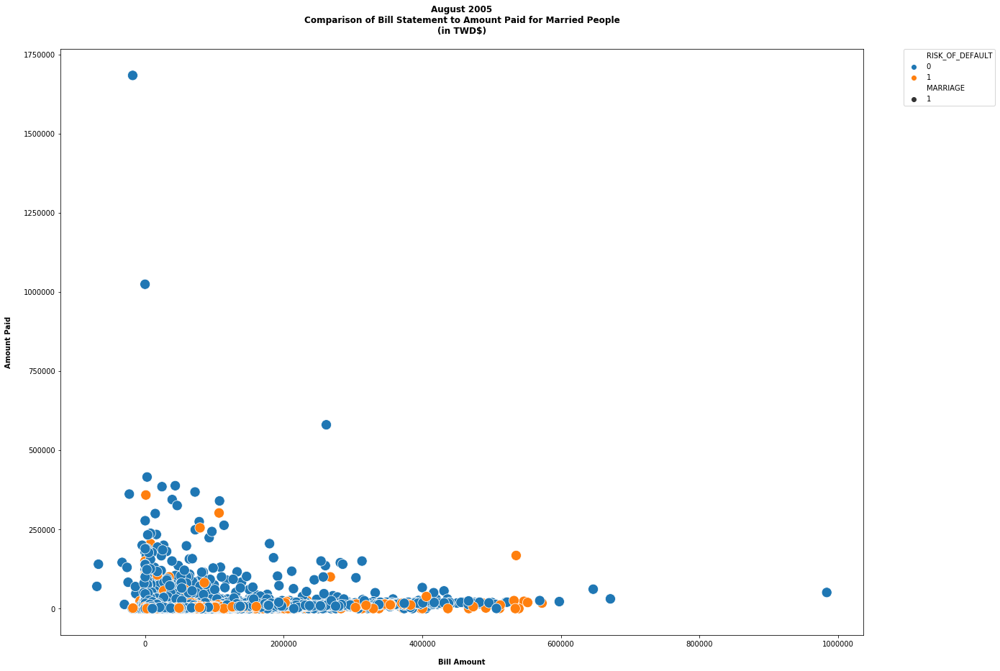

In [466]:
x = married.BILL_AMT2
y = married.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

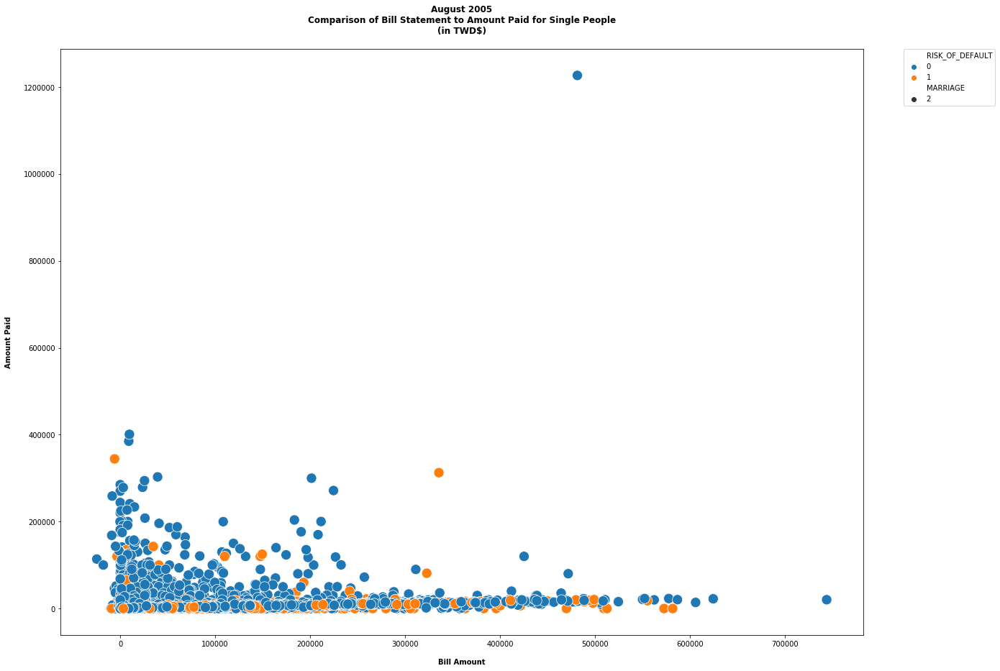

In [467]:
x = single.BILL_AMT2
y = single.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

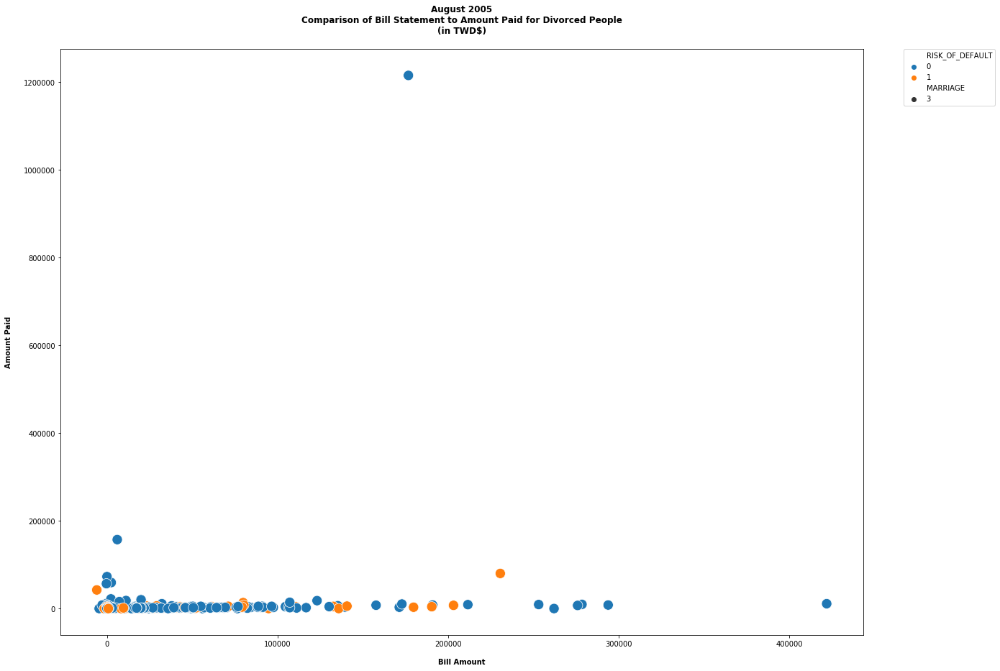

In [468]:
x = divorced.BILL_AMT2
y = divorced.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

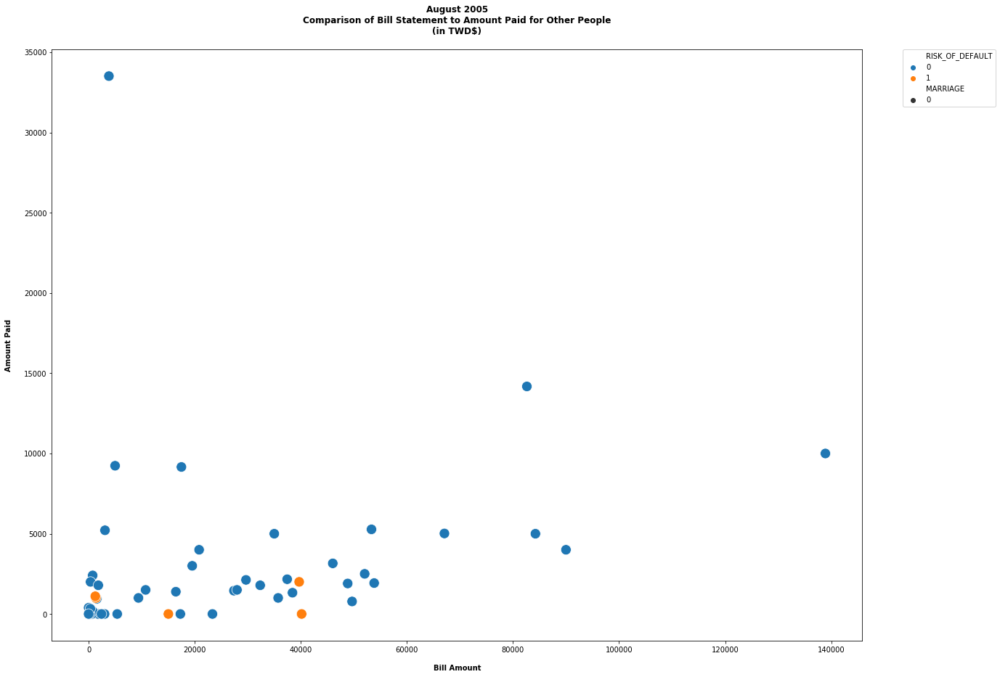

In [469]:
x = otherM.BILL_AMT2
y = otherM.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

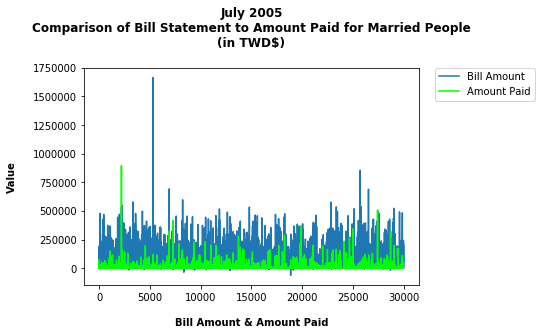

In [470]:
plt.plot(married.BILL_AMT3, label = 'Bill Amount')
plt.plot(married.PAY_AMT3, color = 'lime', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

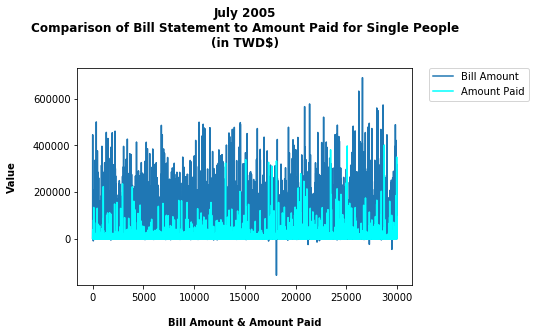

In [471]:
plt.plot(single.BILL_AMT3, label = 'Bill Amount')
plt.plot(single.PAY_AMT3, color = 'cyan', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

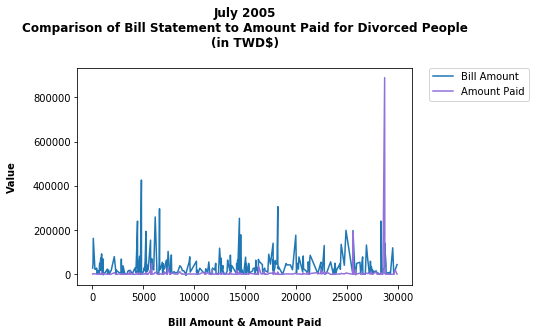

In [472]:
plt.plot(divorced.BILL_AMT3, label = 'Bill Amount')
plt.plot(divorced.PAY_AMT3, color = 'mediumpurple', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

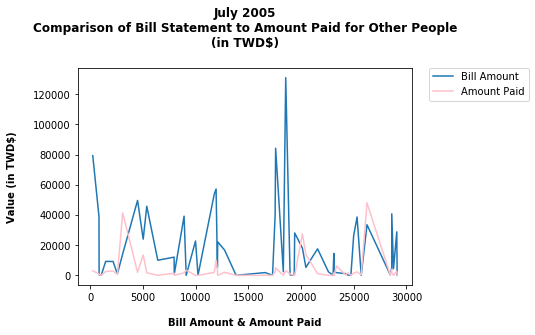

In [473]:
plt.plot(otherM.BILL_AMT3, label = 'Bill Amount')
plt.plot(otherM.PAY_AMT3, color = 'pink', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value (in TWD$)\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

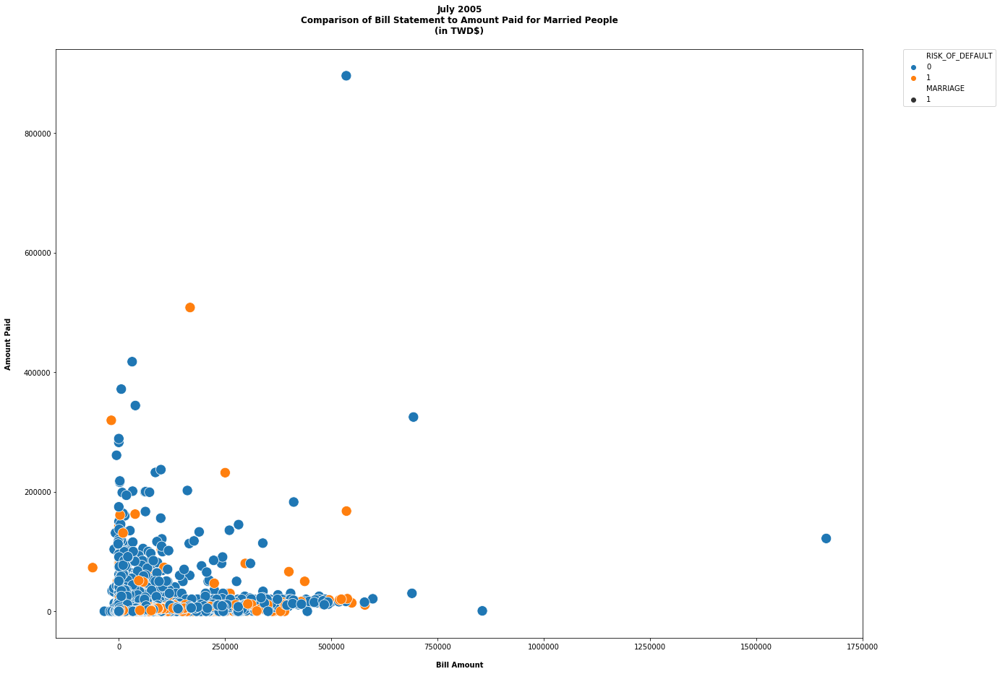

In [474]:
x = married.BILL_AMT3
y = married.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

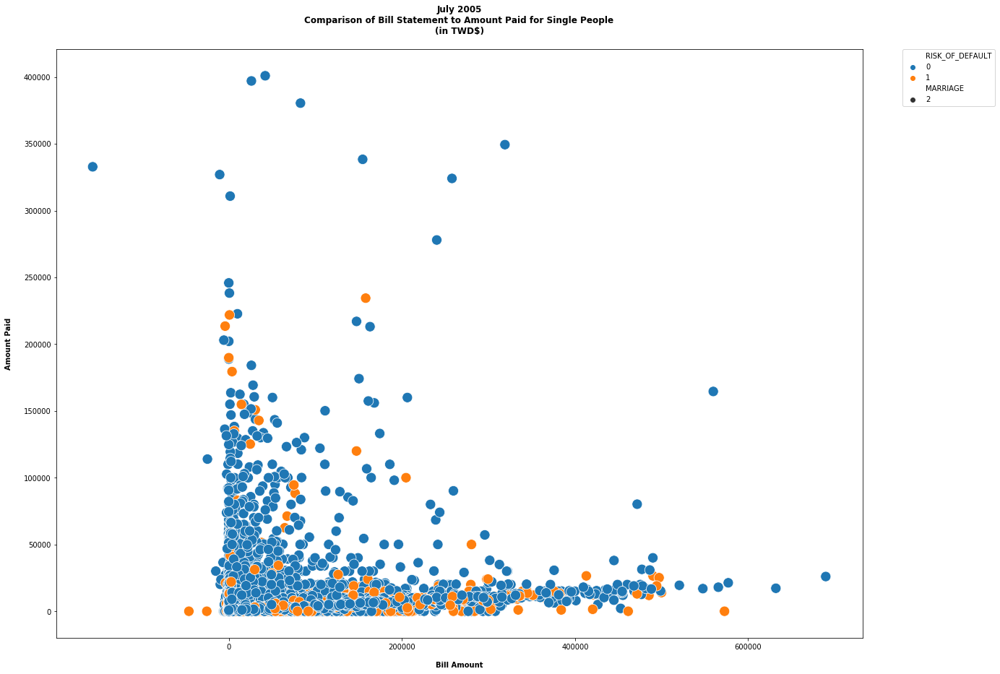

In [475]:
x = single.BILL_AMT3
y = single.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

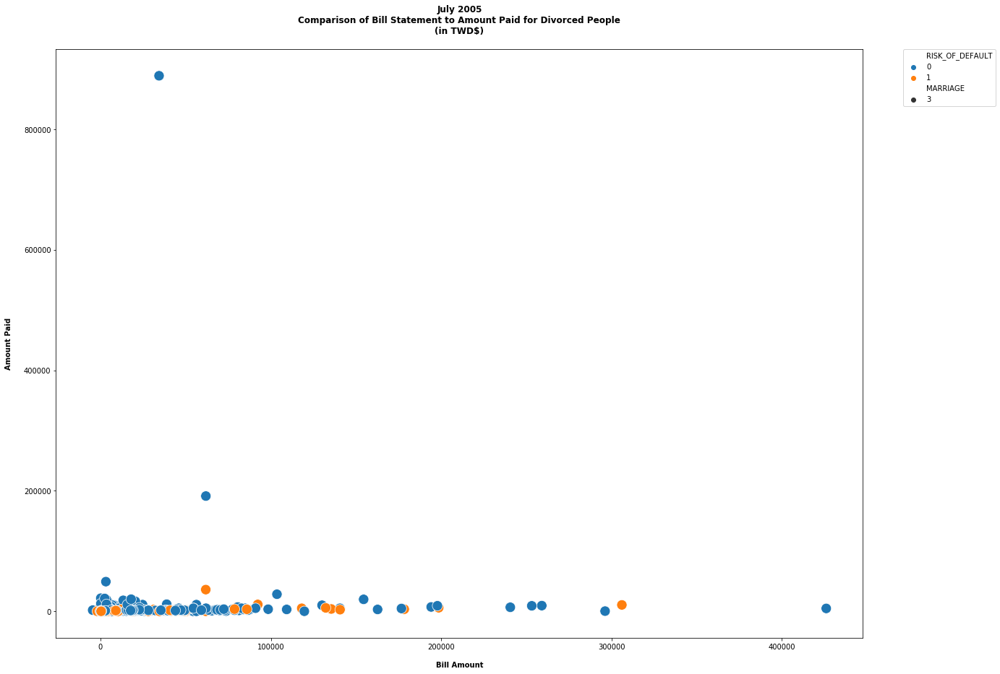

In [476]:
x = divorced.BILL_AMT3
y = divorced.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

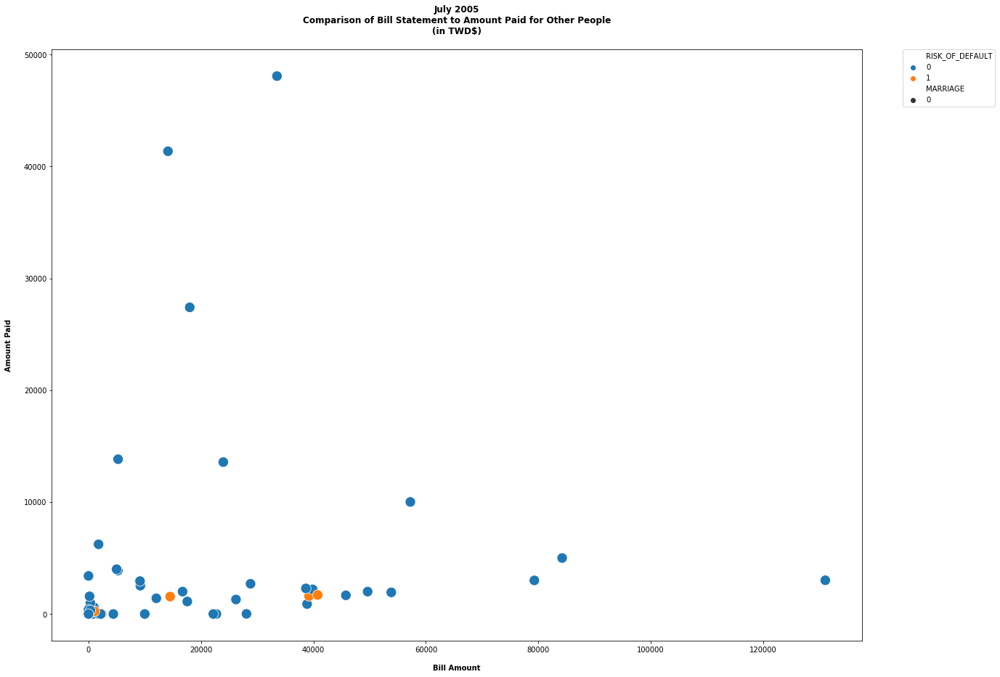

In [477]:
x = otherM.BILL_AMT3
y = otherM.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

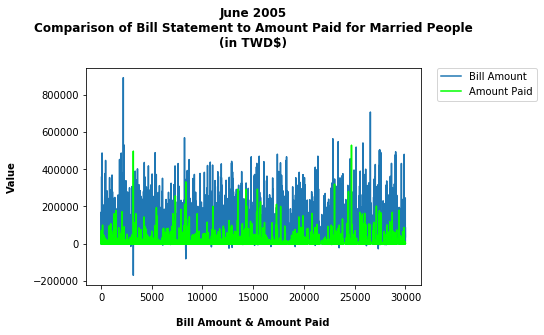

In [478]:
plt.plot(married.BILL_AMT4, label = 'Bill Amount')
plt.plot(married.PAY_AMT4, color = 'lime', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

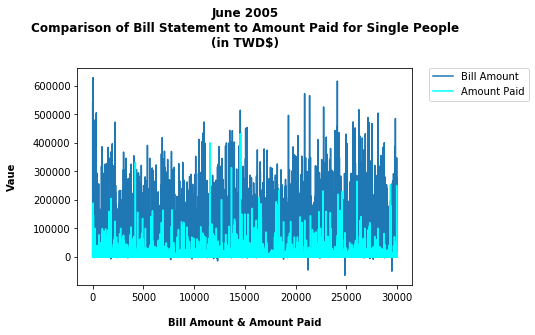

In [479]:
plt.plot(single.BILL_AMT4, label = 'Bill Amount')
plt.plot(single.PAY_AMT4, color = 'cyan', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Vaue\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

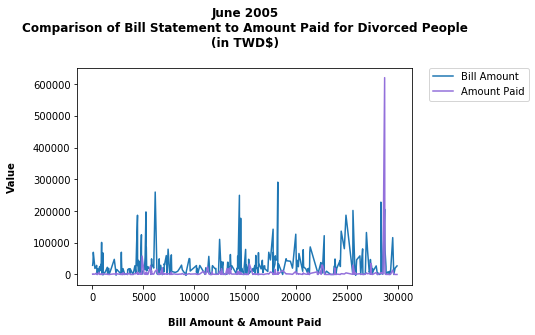

In [480]:
plt.plot(divorced.BILL_AMT4, label = 'Bill Amount')
plt.plot(divorced.PAY_AMT4, color = 'mediumpurple', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

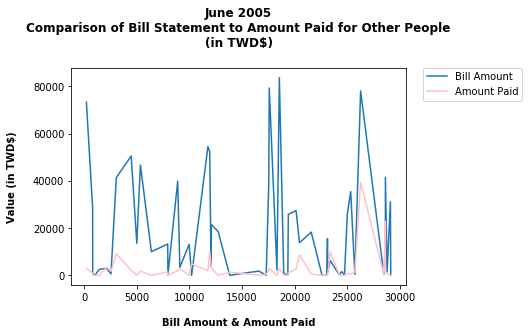

In [481]:
plt.plot(otherM.BILL_AMT4, label = 'Bill Amount')
plt.plot(otherM.PAY_AMT4, color = 'pink', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value (in TWD$)\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

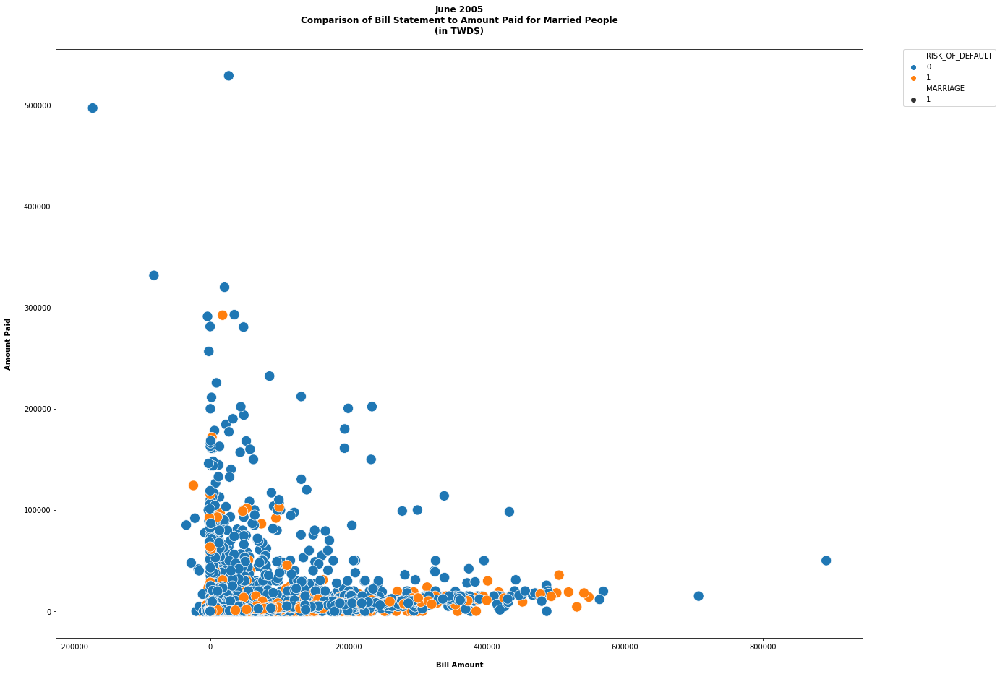

In [482]:
x = married.BILL_AMT4
y = married.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

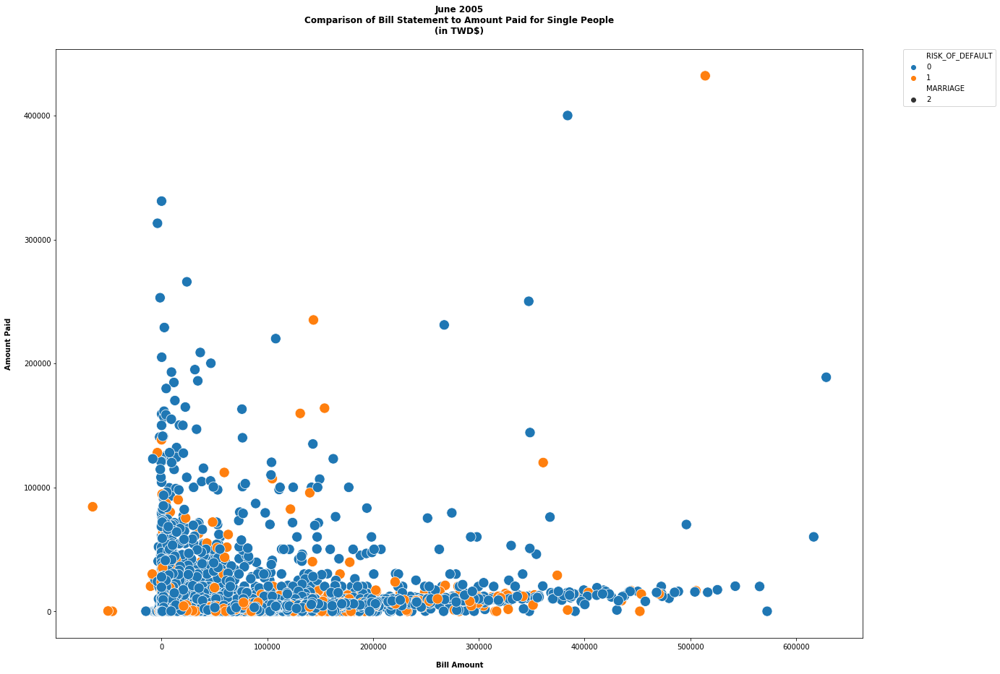

In [483]:
x = single.BILL_AMT4
y = single.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

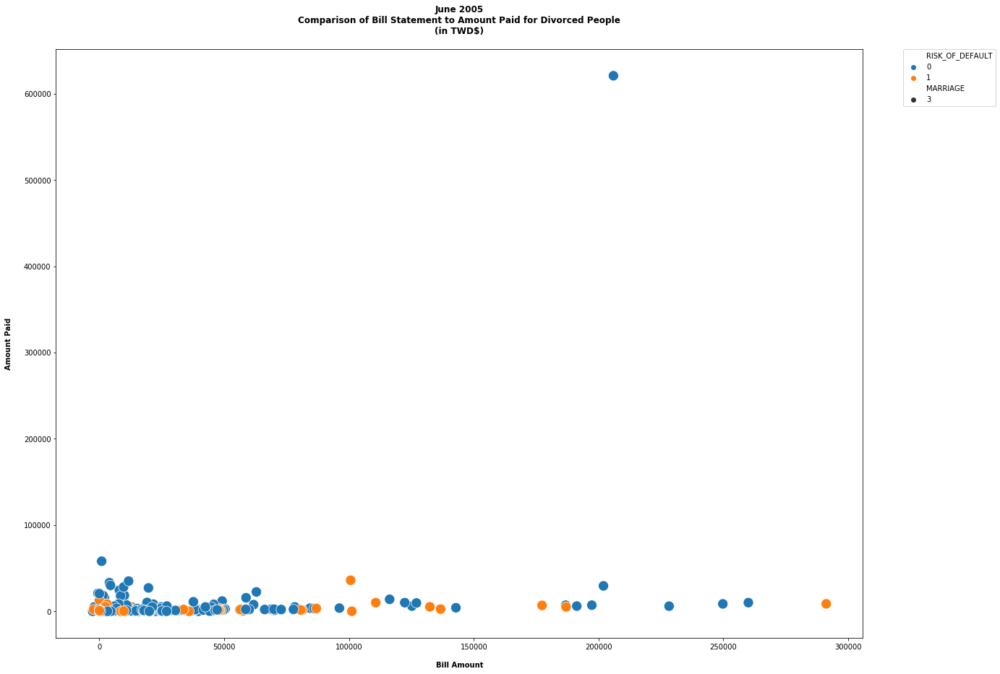

In [484]:
x = divorced.BILL_AMT4
y = divorced.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

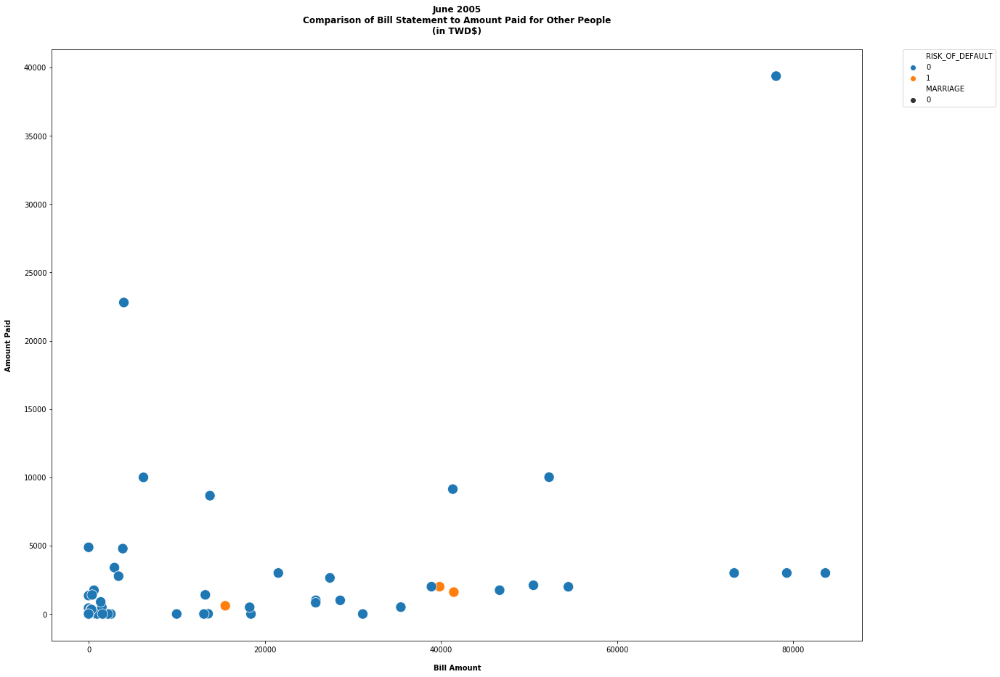

In [485]:
x = otherM.BILL_AMT4
y = otherM.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

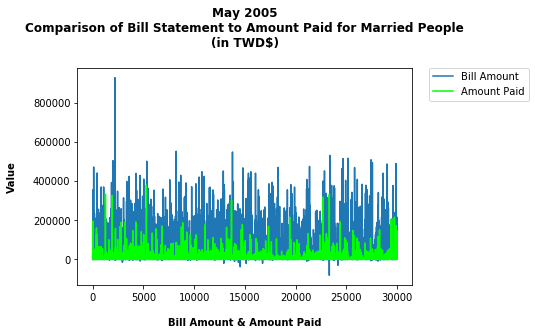

In [486]:
plt.plot(married.BILL_AMT5, label = 'Bill Amount')
plt.plot(married.PAY_AMT5, color = 'lime', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

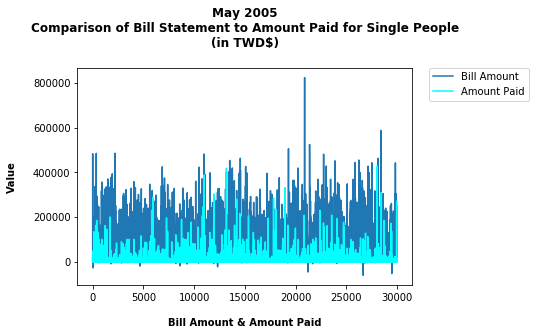

In [487]:
plt.plot(single.BILL_AMT5, label = 'Bill Amount')
plt.plot(single.PAY_AMT5, color = 'cyan', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

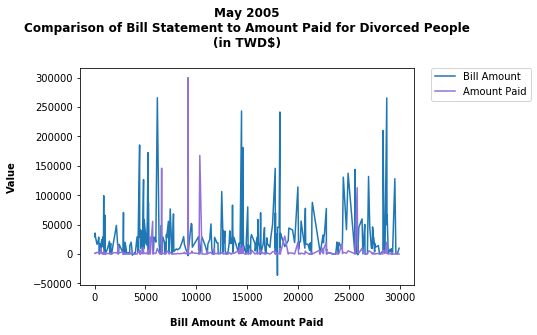

In [488]:
plt.plot(divorced.BILL_AMT5, label = 'Bill Amount')
plt.plot(divorced.PAY_AMT5, color = 'mediumpurple', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

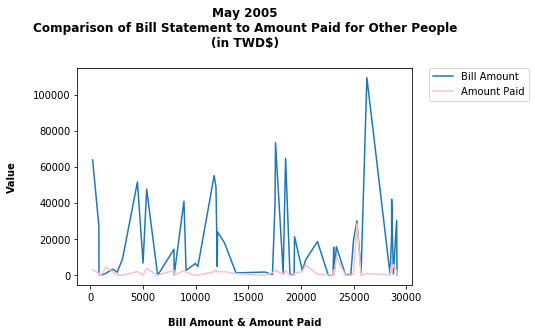

In [489]:
plt.plot(otherM.BILL_AMT5, label = 'Bill Amount')
plt.plot(otherM.PAY_AMT5, color = 'pink', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

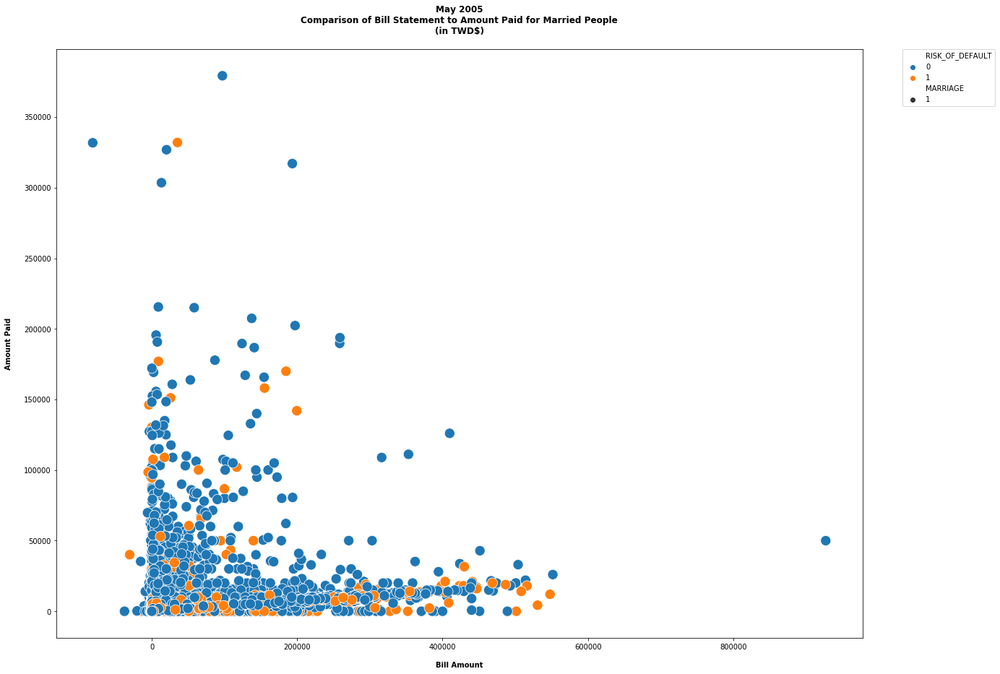

In [490]:
x = married.BILL_AMT5
y = married.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

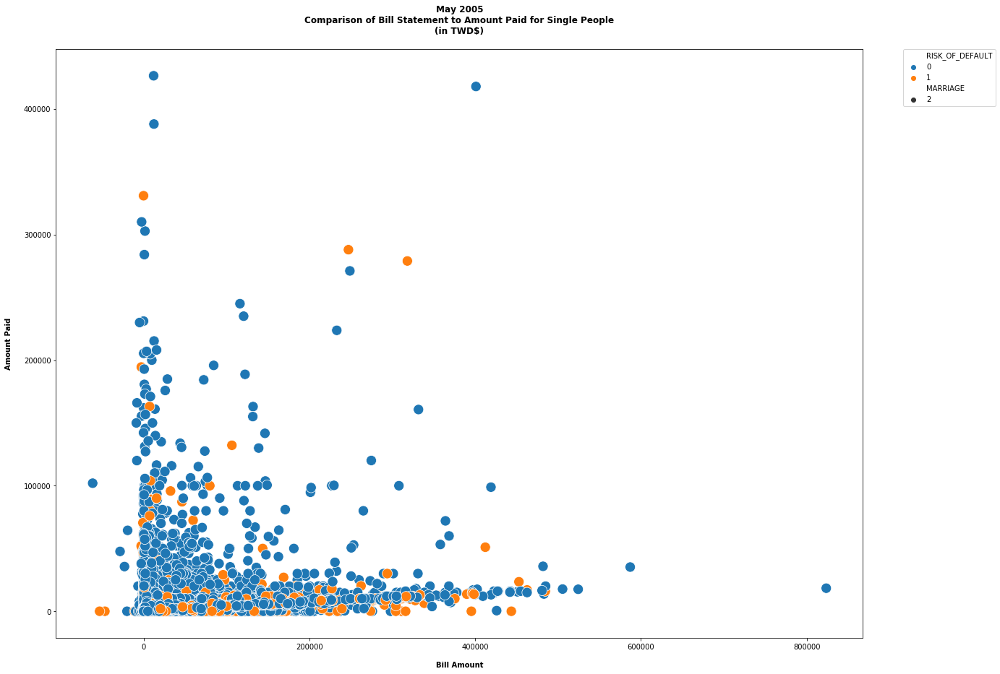

In [491]:
x = single.BILL_AMT5
y = single.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

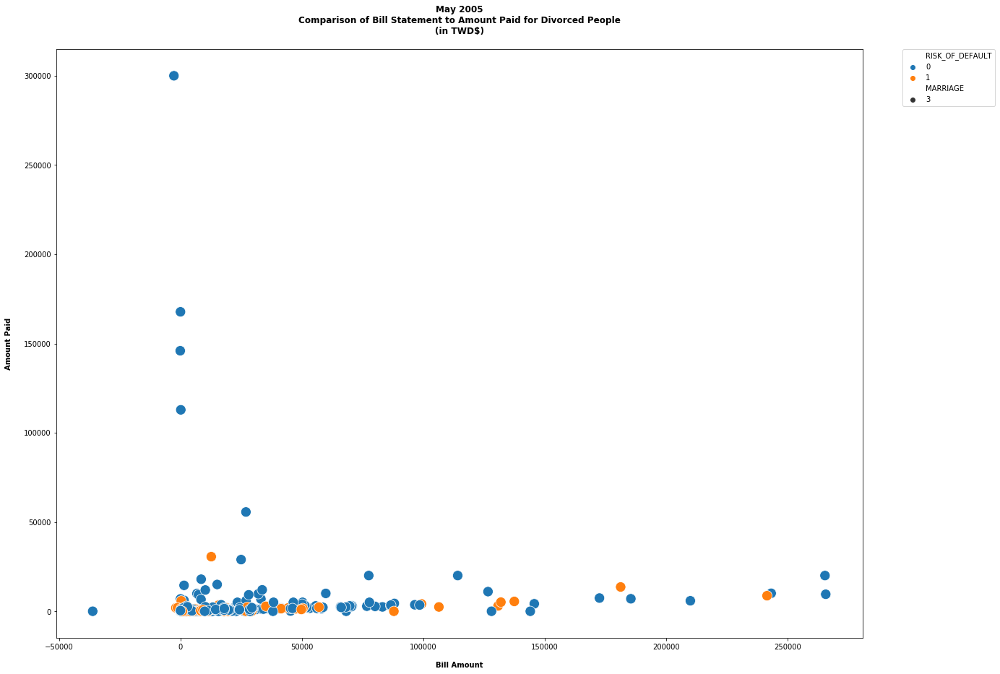

In [492]:
x = divorced.BILL_AMT5
y = divorced.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

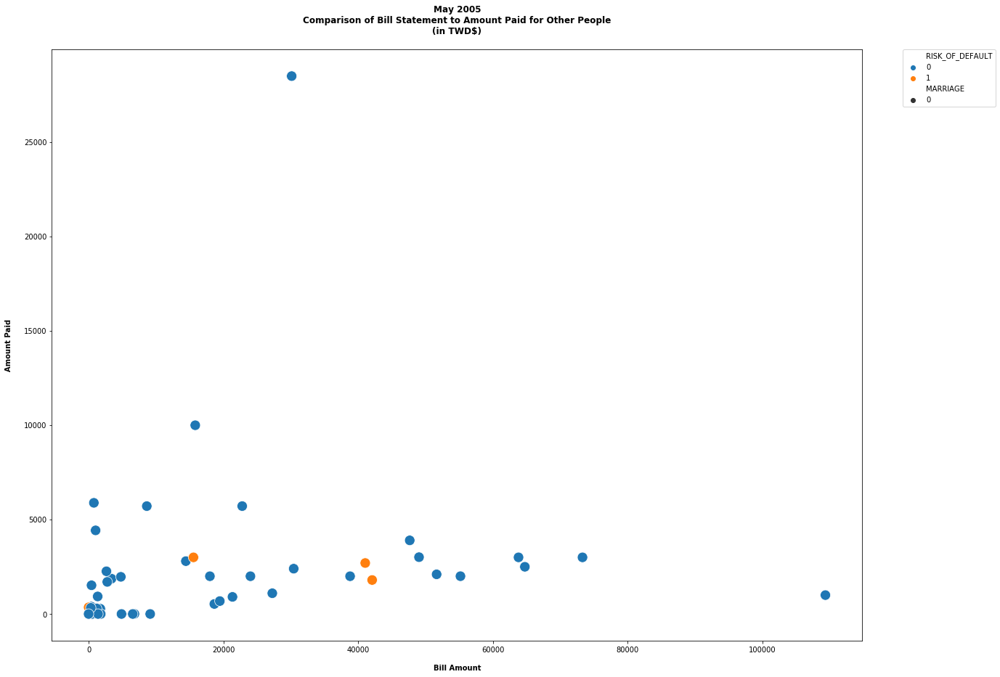

In [493]:
x = otherM.BILL_AMT5
y = otherM.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

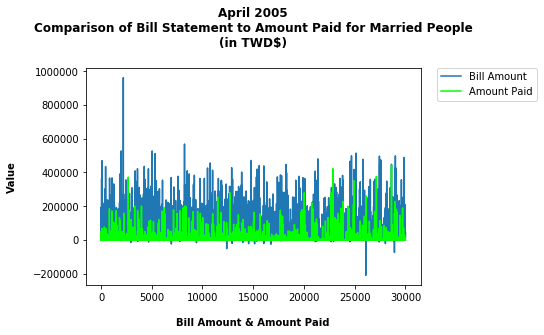

In [494]:
plt.plot(married.BILL_AMT6, label = 'Bill Amount')
plt.plot(married.PAY_AMT6, color = 'lime', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

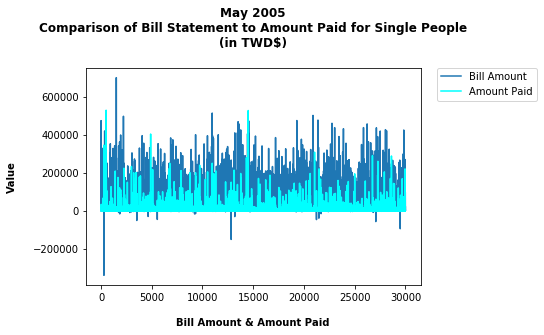

In [495]:
plt.plot(single.BILL_AMT6, label = 'Bill Amount')
plt.plot(single.PAY_AMT6, color = 'cyan', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

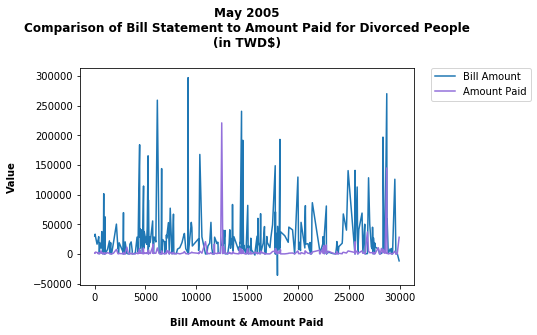

In [496]:
plt.plot(divorced.BILL_AMT6, label = 'Bill Amount')
plt.plot(divorced.PAY_AMT6, color = 'mediumpurple', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

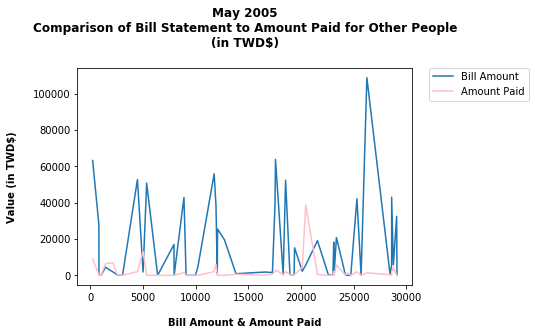

In [497]:
plt.plot(otherM.BILL_AMT6, label = 'Bill Amount')
plt.plot(otherM.PAY_AMT6, color = 'pink', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value (in TWD$)\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

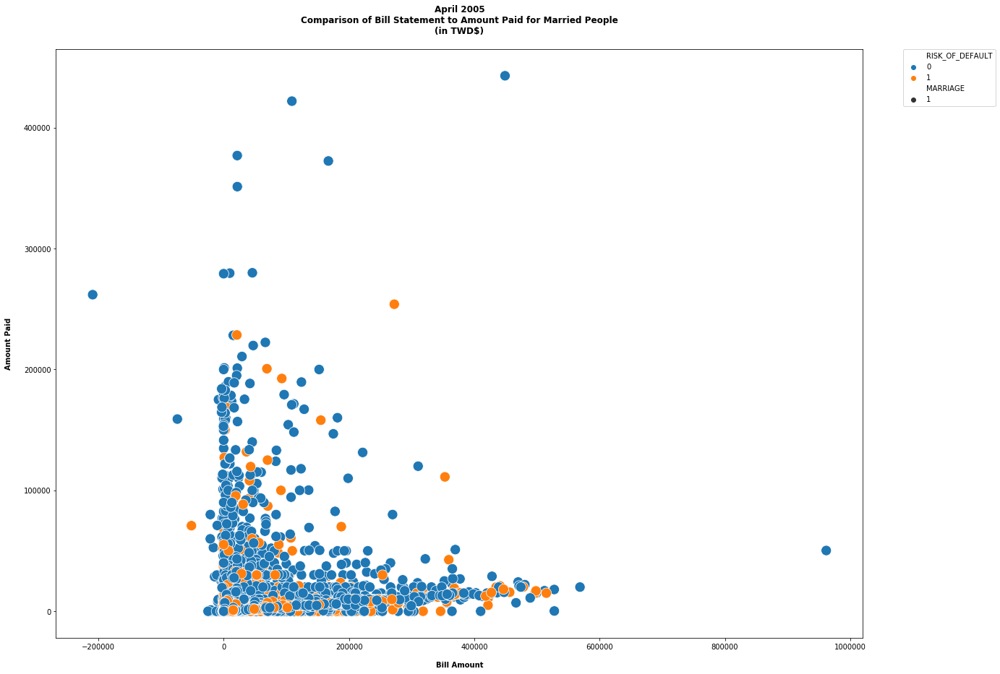

In [498]:
x = married.BILL_AMT6
y = married.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = married)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Married People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

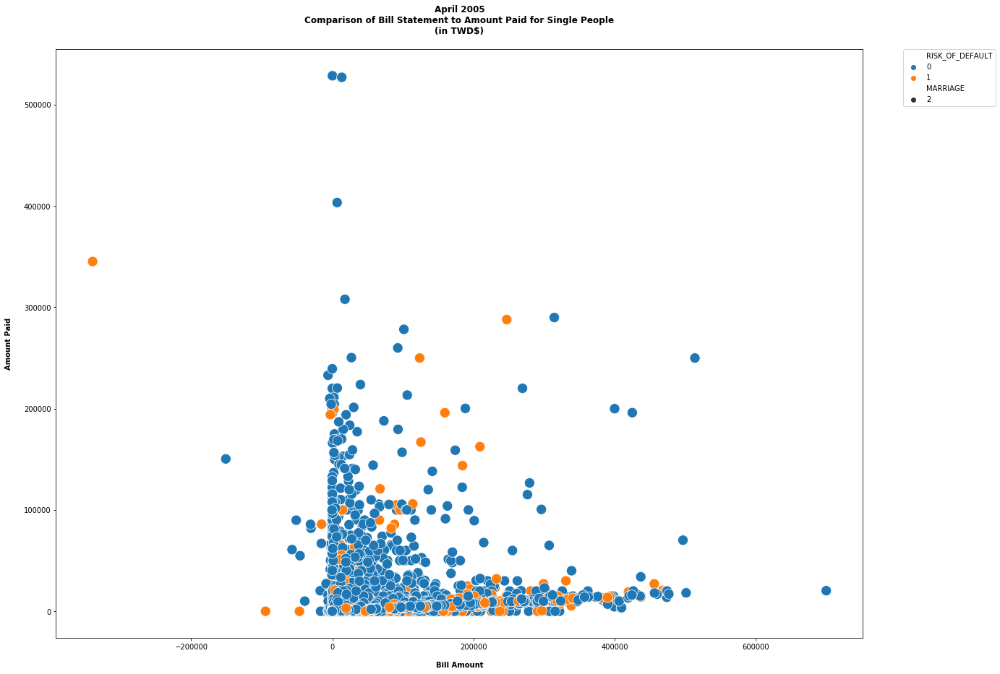

In [499]:
x = single.BILL_AMT6
y = single.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = single)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Single People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

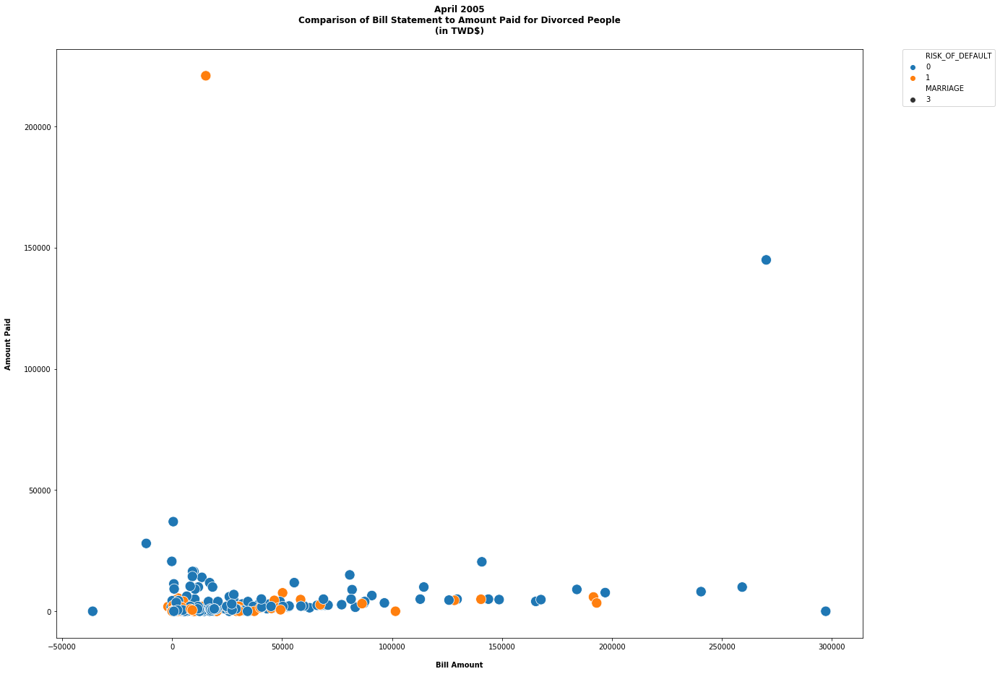

In [500]:
x = divorced.BILL_AMT6
y = divorced.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = divorced)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Divorced People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

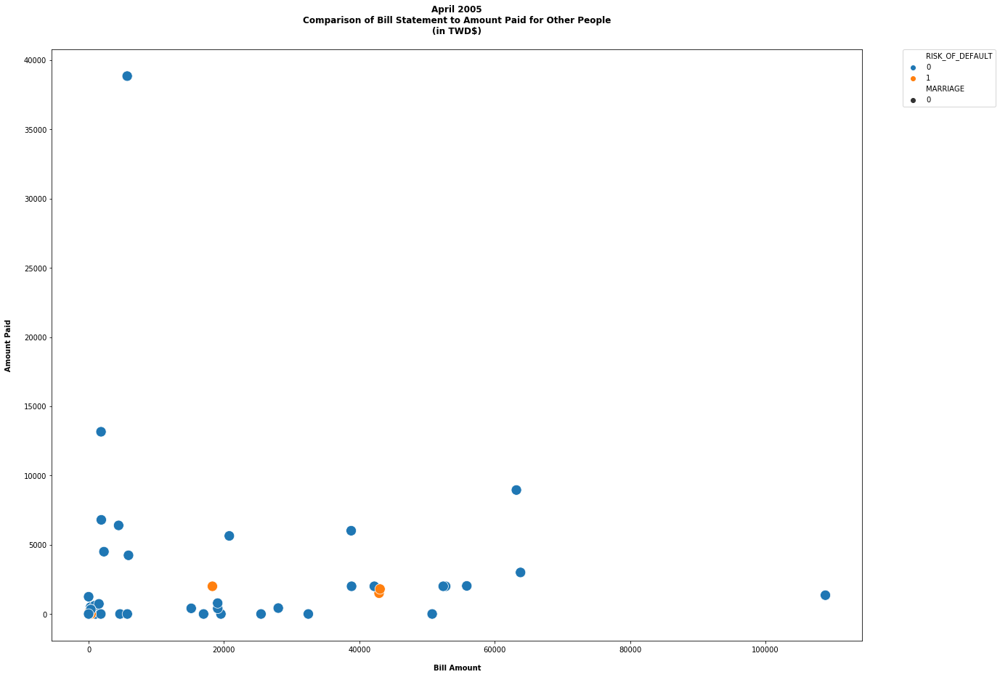

In [501]:
x = otherM.BILL_AMT6
y = otherM.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'MARRIAGE', s = 200, data = otherM)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Other People\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

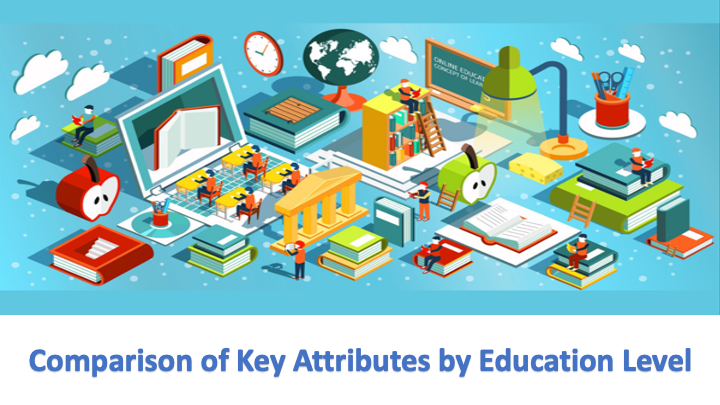

In [502]:
from IPython.display import Image
Image('Education Level.png')

# Distribution of Education Levels

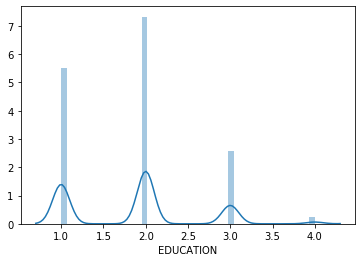

ED_GROUP
GRADUATE SCHOOL    10585
UNIVERSITY         14030
HIGH SCHOOL         4917
OTHER                468
Name: EDUCATION, dtype: int64

In [503]:
education_level_dist = sns.distplot(binned_credit['EDUCATION'])
marital_dist.set_title("Distribution for Education Levels\n", fontweight = 'bold')

plt.show()

binned_credit.groupby('ED_GROUP')['EDUCATION'].count()

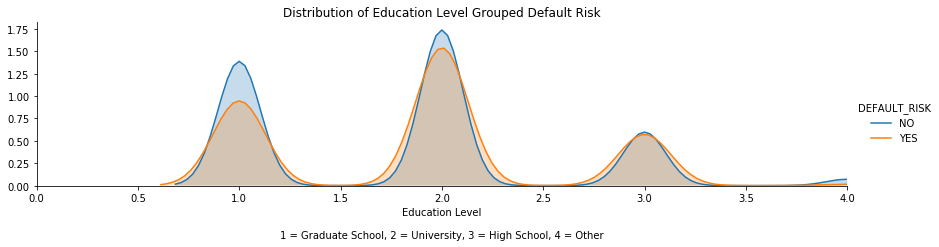

In [504]:
fig = sns.FacetGrid(binned_credit, hue='DEFAULT_RISK', aspect=4)
fig.map(sns.kdeplot, 'EDUCATION', shade=True)
oldest = binned_credit['EDUCATION'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Education Level Grouped Default Risk')
fig.add_legend()
plt.xlabel('Education Level\n\n1 = Graduate School, 2 = University, 3 = High School, 4 = Other')

plt.show()

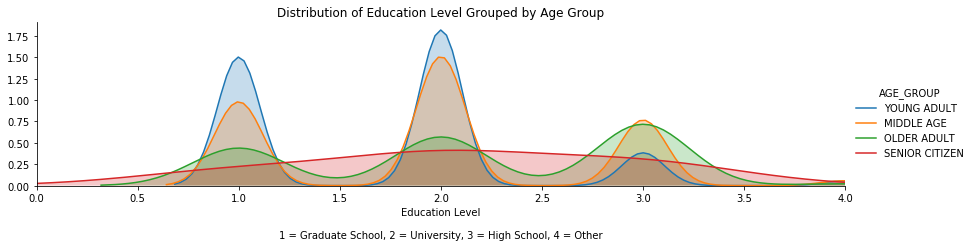

In [505]:
fig = sns.FacetGrid(binned_credit, hue='AGE_GROUP', aspect=4)
fig.map(sns.kdeplot, 'EDUCATION', shade=True)
oldest = binned_credit['EDUCATION'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Education Level Grouped by Age Group')
fig.add_legend()
plt.xlabel('Education Level\n\n1 = Graduate School, 2 = University, 3 = High School, 4 = Other')

plt.show()

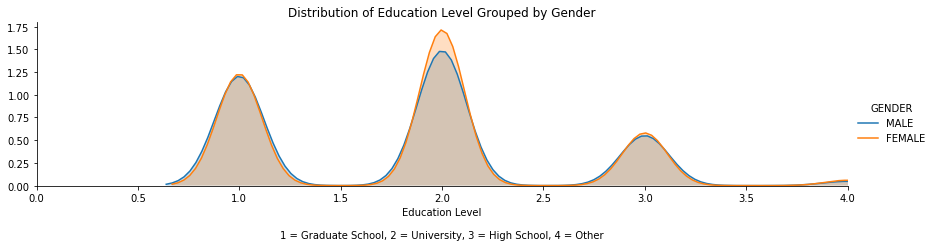

In [506]:
fig = sns.FacetGrid(binned_credit, hue='GENDER', aspect=4)
fig.map(sns.kdeplot, 'EDUCATION', shade=True)
oldest = binned_credit['EDUCATION'].max()
fig.set(xlim=(0,oldest))
fig.set(title='Distribution of Education Level Grouped by Gender')
fig.add_legend()
plt.xlabel('Education Level\n\n1 = Graduate School, 2 = University, 3 = High School, 4 = Other')

plt.show()

# Counting the Number of Defaults per Educational Level

In [507]:
default_MS = binned_credit.loc[binned_credit['RISK_OF_DEFAULT'] == 1]

default_MS.groupby('ED_GROUP')['DEFAULT_RISK'].count()

ED_GROUP
GRADUATE SCHOOL    2036
UNIVERSITY         3330
HIGH SCHOOL        1237
OTHER                33
Name: DEFAULT_RISK, dtype: int64

In [508]:
title = '\nNumber of People at Risk of Default by EDUCATION LEVEL'

bolded_string = "\033[1m" + title + "\033[0m"

print(bolded_string)

default_MS.pivot_table('RISK_OF_DEFAULT', 'ED_GROUP', aggfunc = pd.value_counts, margins = True)


Number of People at Risk of Default by EDUCATION LEVEL


,RISK_OF_DEFAULT
ED_GROUP,
GRADUATE SCHOOL,2036
UNIVERSITY,3330
HIGH SCHOOL,1237
OTHER,33
All,6636


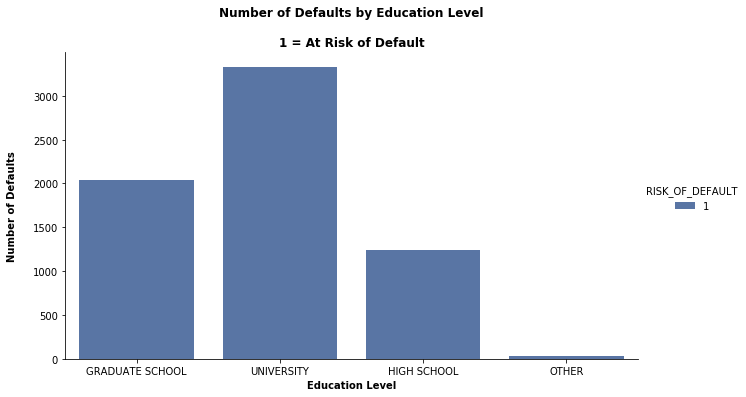

In [509]:
ms = sns.catplot('ED_GROUP', data = default_MS, hue='RISK_OF_DEFAULT', palette='deep', kind='count', aspect=1.75)
ms.set_xlabels('Education Level', fontweight = 'bold')

plt.title("Number of Defaults by Education Level\n\n1 = At Risk of Default", fontweight = 'bold')
plt.ylabel('Number of Defaults\n', fontweight = 'bold')

plt.show()

# Creating the Education Level Subsets

In [511]:
grad_school = binned_credit.loc[binned_credit['EDUCATION'] == 1]

university = binned_credit.loc[binned_credit['EDUCATION'] == 2]

high_school = binned_credit.loc[binned_credit['EDUCATION'] == 3]

otherEL = binned_credit.loc[binned_credit['EDUCATION'] == 4]

In [512]:
grad_school

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
5,6,50000,"($0, $50K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,37,...,19619,20024,2500,1815,657,1000,1000,800,0,NO
6,7,500000,"($450K, $500K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,29,...,483003,473944,55000,40000,38000,20239,13750,13770,0,NO
11,12,260000,"($250K, $300K]",2,FEMALE,1,GRADUATE SCHOOL,2,SINGLE,51,...,22287,13668,21818,9966,8583,22301,0,3640,0,NO
14,15,250000,"($200K, $250K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,29,...,56875,55512,3000,3000,3000,3000,3000,3000,0,NO
16,17,20000,"($0, $50K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,24,...,17905,19104,3200,0,1500,0,1650,0,1,YES
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29986,29987,360000,"($350K, $400K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,35,...,0,0,0,0,0,0,0,0,0,NO
29987,29988,130000,"($100K, $150K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,34,...,93708,97353,3000,2000,93000,4000,5027,4005,0,NO
29988,29989,250000,"($200K, $250K]",1,MALE,1,GRADUATE SCHOOL,1,MARRIED,34,...,175005,179687,65000,8800,9011,6000,7000,6009,0,NO
29989,29990,150000,"($100K, $150K]",1,MALE,1,GRADUATE SCHOOL,2,SINGLE,35,...,0,0,9054,0,783,0,0,0,0,NO


In [513]:
university

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
0,1,20000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,24,...,0,0,0,689,0,0,0,0,1,YES
1,2,120000,"($100K, $150K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,26,...,3455,3261,0,1000,1000,1000,0,2000,1,YES
2,3,90000,"($50K, $100K]",2,FEMALE,2,UNIVERSITY,2,SINGLE,34,...,14948,15549,1518,1500,1000,1000,1000,5000,0,NO
3,4,50000,"($0, $50K]",2,FEMALE,2,UNIVERSITY,1,MARRIED,37,...,28959,29547,2000,2019,1200,1100,1069,1000,0,NO
4,5,50000,"($0, $50K]",1,MALE,2,UNIVERSITY,1,MARRIED,57,...,19146,19131,2000,36681,10000,9000,689,679,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29990,29991,140000,"($100K, $150K]",1,MALE,2,UNIVERSITY,1,MARRIED,41,...,49675,46121,6000,7000,4228,1505,2000,2000,0,NO
29991,29992,210000,"($200K, $250K]",1,MALE,2,UNIVERSITY,1,MARRIED,34,...,2500,2500,0,0,0,0,0,0,1,YES
29994,29995,80000,"($50K, $100K]",1,MALE,2,UNIVERSITY,2,SINGLE,34,...,82607,81158,7000,3500,0,7000,0,4000,1,YES
29997,29998,30000,"($0, $50K]",1,MALE,2,UNIVERSITY,2,SINGLE,37,...,20582,19357,0,0,22000,4200,2000,3100,1,YES


In [514]:
high_school

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
8,9,140000,"($100K, $150K]",2,FEMALE,3,HIGH SCHOOL,1,MARRIED,28,...,11793,3719,3329,0,432,1000,1000,1000,0,NO
9,10,20000,"($0, $50K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,35,...,13007,13912,0,0,0,13007,1122,0,0,NO
10,11,200000,"($150K, $200K]",2,FEMALE,3,HIGH SCHOOL,2,SINGLE,34,...,1828,3731,2306,12,50,300,3738,66,0,NO
15,16,50000,"($0, $50K]",2,FEMALE,3,HIGH SCHOOL,3,DIVORCED,23,...,29531,30211,0,1500,1100,1200,1300,1100,0,NO
20,21,130000,"($100K, $150K]",2,FEMALE,3,HIGH SCHOOL,2,SINGLE,39,...,11802,930,3000,1537,1000,2000,930,33764,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29980,29981,50000,"($0, $50K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,42,...,19971,19694,10000,4000,5000,3000,4500,2000,0,NO
29992,29993,10000,"($0, $50K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,43,...,0,0,2000,0,0,0,0,0,0,NO
29995,29996,220000,"($200K, $250K]",1,MALE,3,HIGH SCHOOL,1,MARRIED,39,...,31237,15980,8500,20000,5003,3047,5000,1000,0,NO
29996,29997,150000,"($100K, $150K]",1,MALE,3,HIGH SCHOOL,2,SINGLE,43,...,5190,0,1837,3526,8998,129,0,0,0,NO


In [515]:
otherEL

,ID,LIMIT_BAL,CREDIT_LEVEL,SEX,GENDER,EDUCATION,ED_GROUP,MARRIAGE,MARR_GROUP,AGE,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,RISK_OF_DEFAULT,DEFAULT_RISK
47,48,150000,"($100K, $150K]",2,FEMALE,4,OTHER,2,SINGLE,46,...,0,0,1013,1170,0,0,0,0,1,YES
69,70,20000,"($0, $50K]",1,MALE,4,OTHER,2,SINGLE,22,...,11205,5982,0,1200,1000,500,1000,0,0,NO
358,359,110000,"($100K, $150K]",2,FEMALE,4,OTHER,2,SINGLE,24,...,82333,84462,3000,2900,2900,3000,3500,4000,0,NO
385,386,410000,"($400K, $450K]",2,FEMALE,4,OTHER,1,MARRIED,42,...,234939,240176,15000,14000,9000,8500,9000,8300,0,NO
448,449,200000,"($150K, $200K]",1,MALE,4,OTHER,1,MARRIED,42,...,30900,0,5000,1485,1956,1500,0,2102,0,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29836,29837,180000,"($150K, $200K]",1,MALE,4,OTHER,1,MARRIED,34,...,0,0,0,0,0,0,0,0,0,NO
29839,29840,150000,"($100K, $150K]",1,MALE,4,OTHER,1,MARRIED,36,...,139219,142172,5500,3800,3900,4000,4100,4100,0,NO
29847,29848,310000,"($300K, $350K]",1,MALE,4,OTHER,1,MARRIED,46,...,18293,14332,10414,21229,91254,18293,14332,15785,0,NO
29920,29921,50000,"($0, $50K]",1,MALE,4,OTHER,1,MARRIED,45,...,51020,0,3000,3428,2002,1023,0,0,1,YES


# Comparison of Credit Limits by Education Level

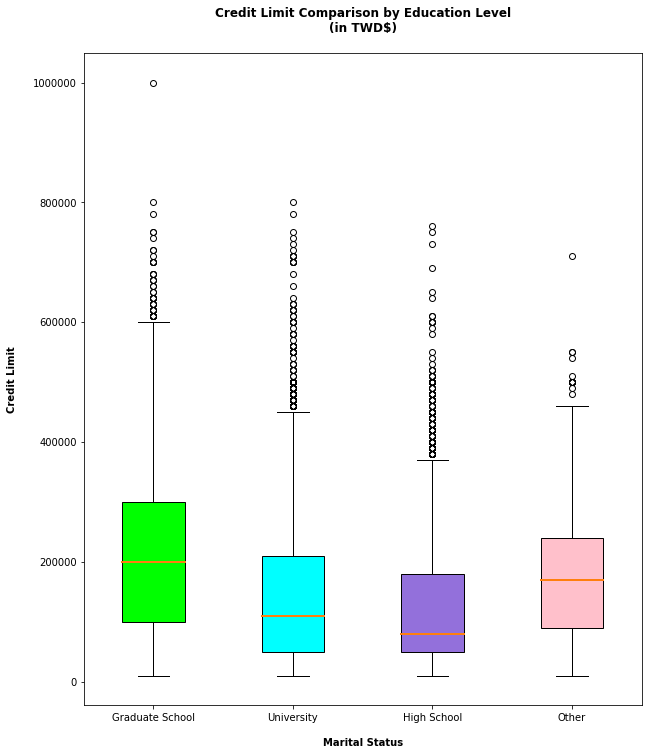

In [516]:
plt.figure(figsize = (10,12))

grad_school = grad_school.LIMIT_BAL
university = university.LIMIT_BAL
high_school = high_school.LIMIT_BAL
otherEL = otherEL.LIMIT_BAL

labels = ['Graduate School','University','High School','Other']
plt.title('Credit Limit Comparison by Education Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nMarital Status',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparison of the Monthly Bill Statements by Education Level

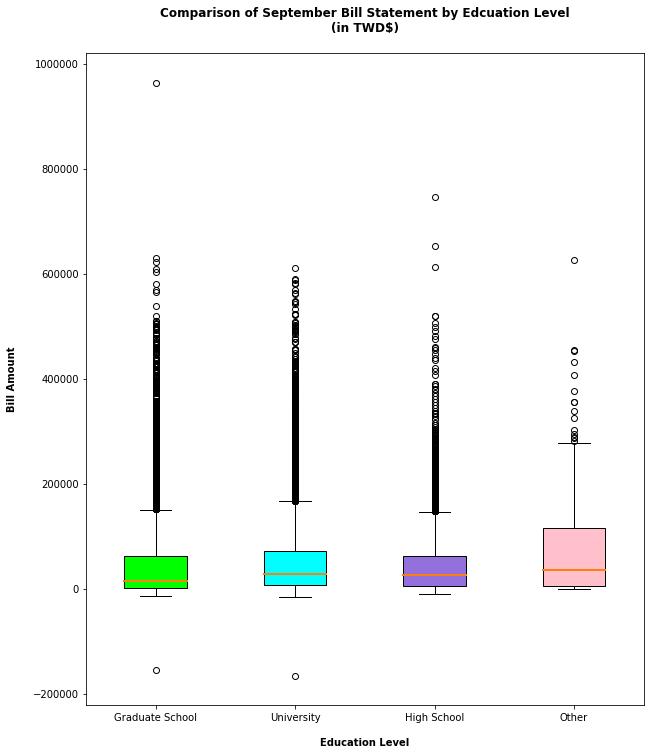

In [518]:
plt.figure(figsize = (10,12))

grad_school = grad_school.BILL_AMT1
university = university.BILL_AMT1
high_school = high_school.BILL_AMT1
otherEL = otherEL.BILL_AMT1

labels = ['Graduate School', 'University', 'High School', 'Other']
plt.title('Comparison of September Bill Statement by Edcuation Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nEducation Level',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

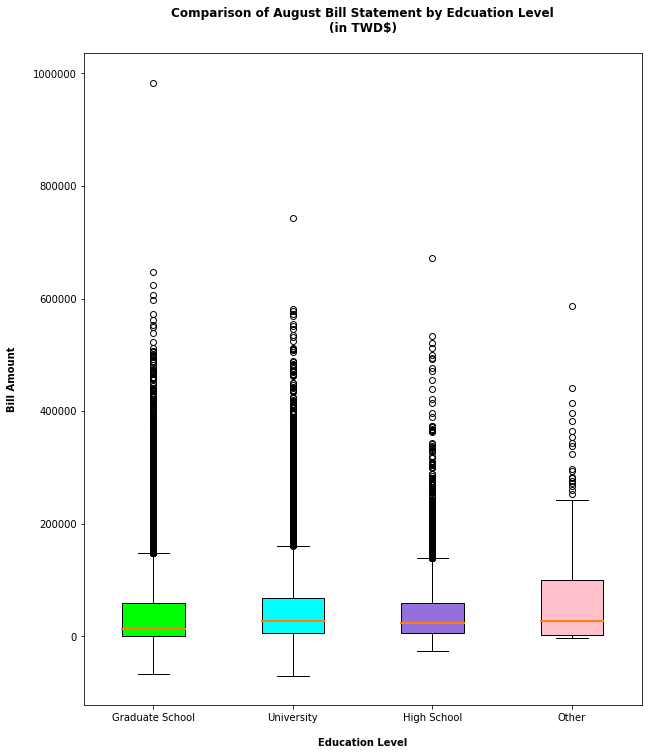

In [520]:
plt.figure(figsize = (10,12))

grad_school = grad_school.BILL_AMT2
university = university.BILL_AMT2
high_school = high_school.BILL_AMT2
otherEL = otherEL.BILL_AMT2

labels = ['Graduate School', 'University', 'High School', 'Other']
plt.title('Comparison of August Bill Statement by Edcuation Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nEducation Level',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

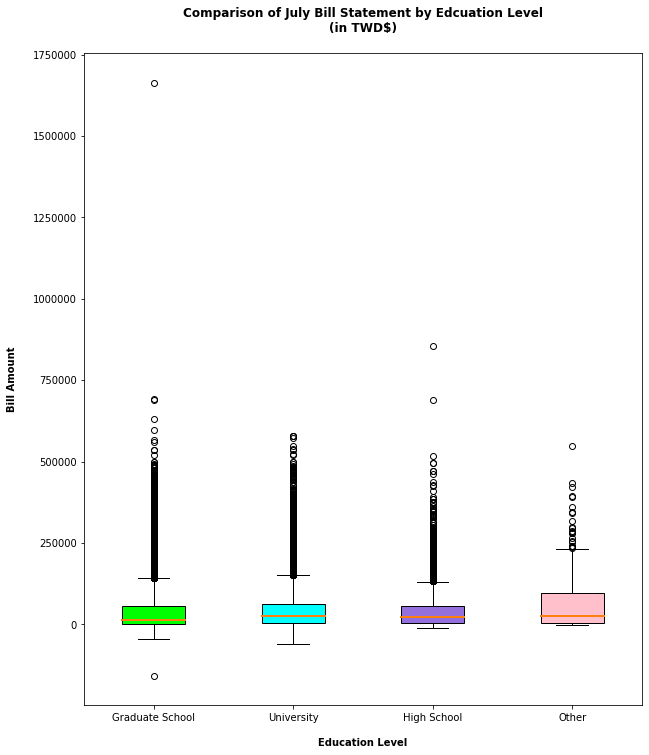

In [522]:
plt.figure(figsize = (10,12))

grad_school = grad_school.BILL_AMT3
university = university.BILL_AMT3
high_school = high_school.BILL_AMT3
otherEL = otherEL.BILL_AMT3

labels = ['Graduate School', 'University', 'High School', 'Other']
plt.title('Comparison of July Bill Statement by Edcuation Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nEducation Level',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

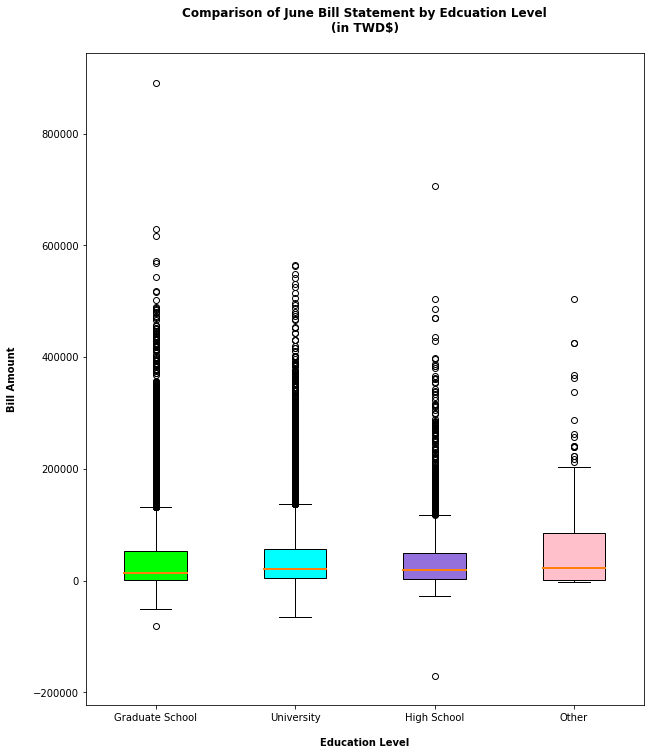

In [524]:
plt.figure(figsize = (10,12))

grad_school = grad_school.BILL_AMT4
university = university.BILL_AMT4
high_school = high_school.BILL_AMT4
otherEL = otherEL.BILL_AMT4

labels = ['Graduate School', 'University', 'High School', 'Other']
plt.title('Comparison of June Bill Statement by Edcuation Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nEducation Level',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

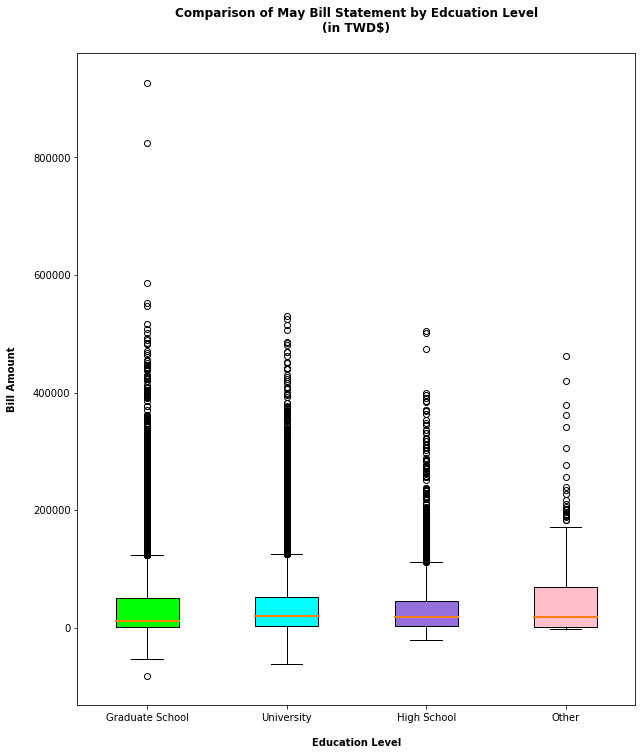

In [526]:
plt.figure(figsize = (10,12))

grad_school = grad_school.BILL_AMT5
university = university.BILL_AMT5
high_school = high_school.BILL_AMT5
otherEL = otherEL.BILL_AMT5

labels = ['Graduate School', 'University', 'High School', 'Other']
plt.title('Comparison of May Bill Statement by Edcuation Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nEducation Level',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

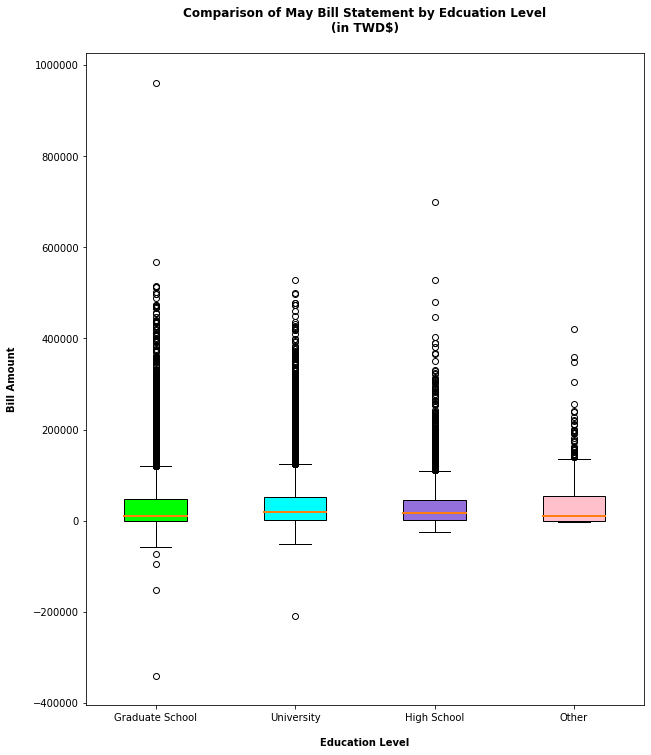

In [530]:
plt.figure(figsize = (10,12))

grad_school = grad_school.BILL_AMT6
university = university.BILL_AMT6
high_school = high_school.BILL_AMT6
otherEL = otherEL.BILL_AMT6

labels = ['Graduate School', 'University', 'High School', 'Other']
plt.title('Comparison of May Bill Statement by Edcuation Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nEducation Level',fontweight = 'bold')
plt.ylabel('Bill Amount\n', fontweight = 'bold')

boxes = plt.boxplot([grad_school, university, high_school, otherEL], labels = labels, patch_artist = True, medianprops = {'linewidth': 2})
colors = ['lime', 'cyan', 'mediumpurple', 'pink']
for box in (boxes):
    for patch, color in zip(boxes['boxes'], colors):
        patch.set_facecolor(color)

plt.show()

# Comparison - Monthly Bill Statements to Credit Limits by Education Level

## September 2005

### Line Plots

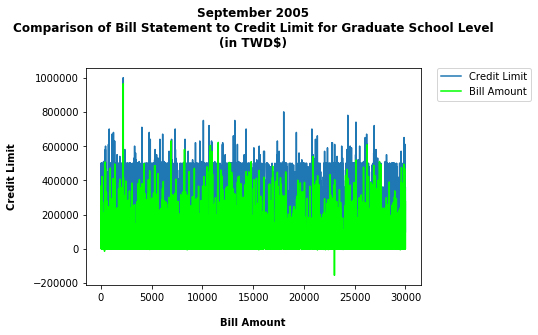

In [532]:
plt.plot(grad_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(grad_school.BILL_AMT1, color = 'lime', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

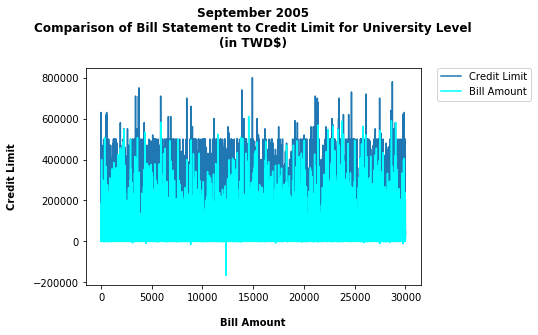

In [533]:
plt.plot(university.LIMIT_BAL, label = 'Credit Limit')
plt.plot(university.BILL_AMT1, color = 'cyan', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

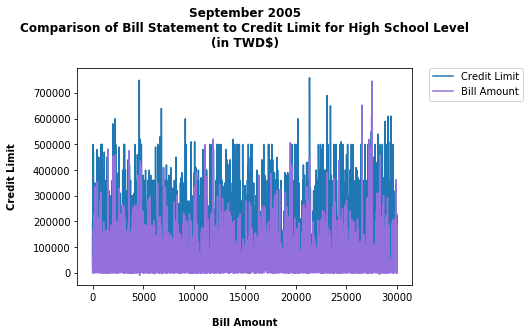

In [534]:
plt.plot(high_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(high_school.BILL_AMT1, color = 'mediumpurple', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

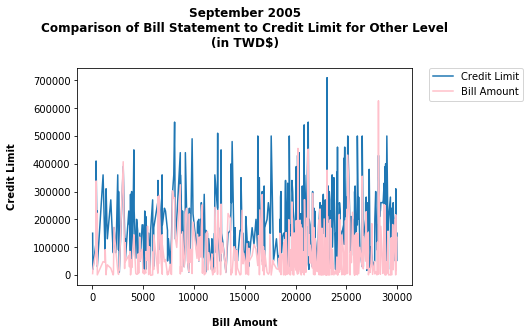

In [535]:
plt.plot(otherEL.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherEL.BILL_AMT1, color = 'pink', label = 'Bill Amount')

plt.title('September 2005\nComparison of Bill Statement to Credit Limit for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

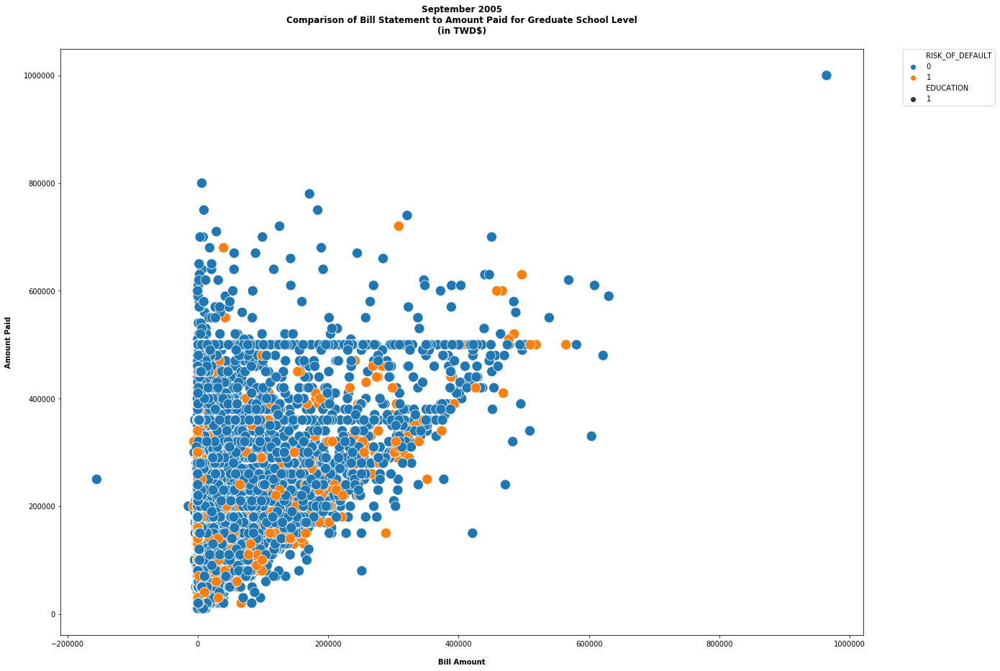

In [536]:
x = grad_school.BILL_AMT1
y = grad_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Greduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

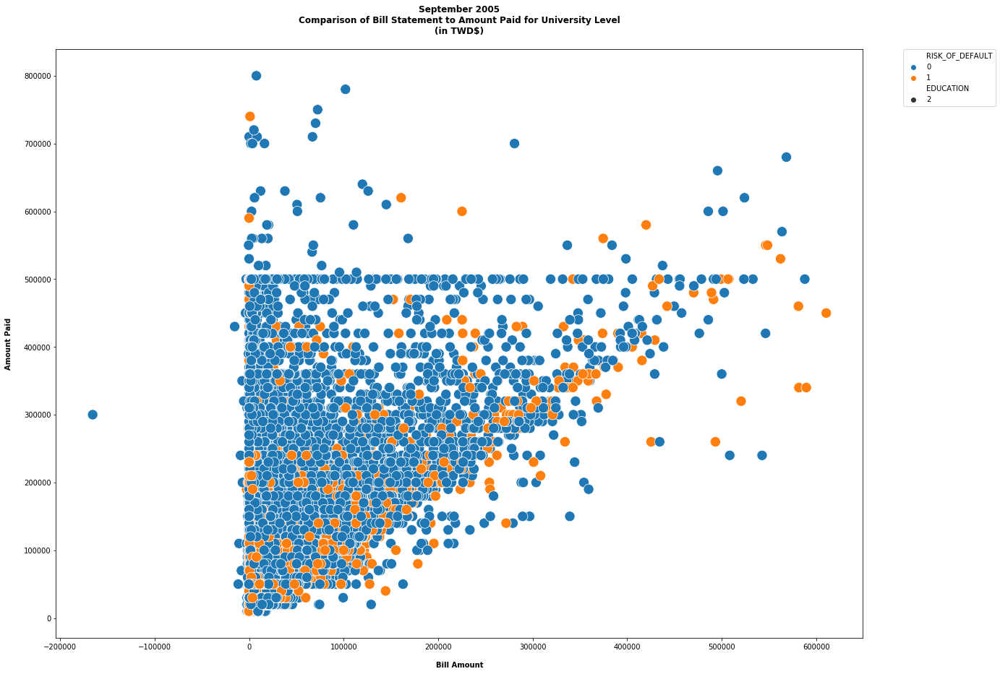

In [537]:
x = university.BILL_AMT1
y = university.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

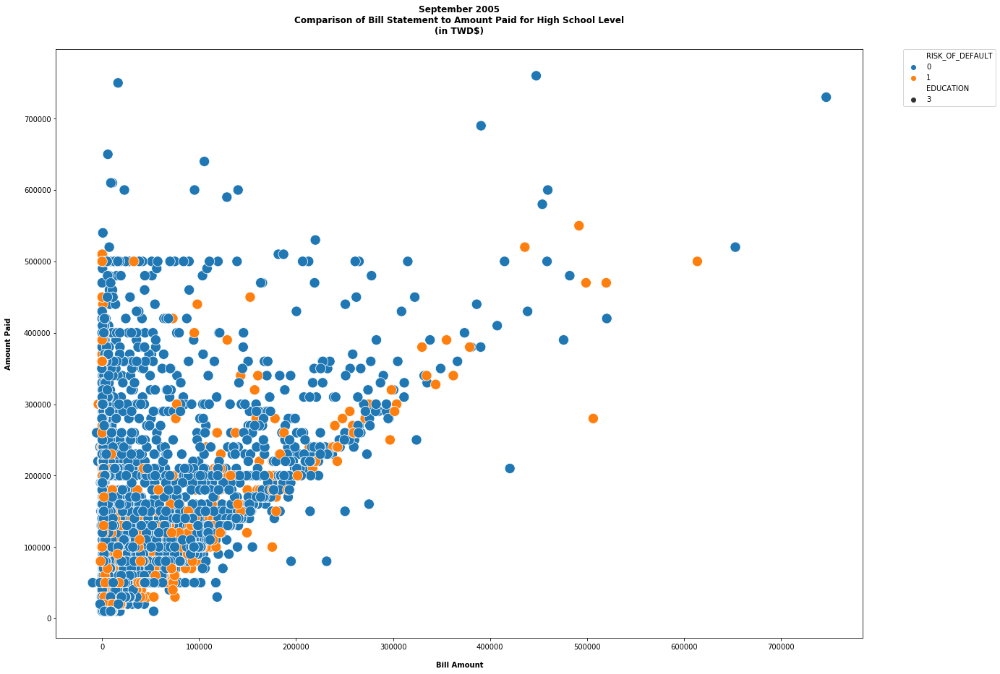

In [538]:
x = high_school.BILL_AMT1
y = high_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

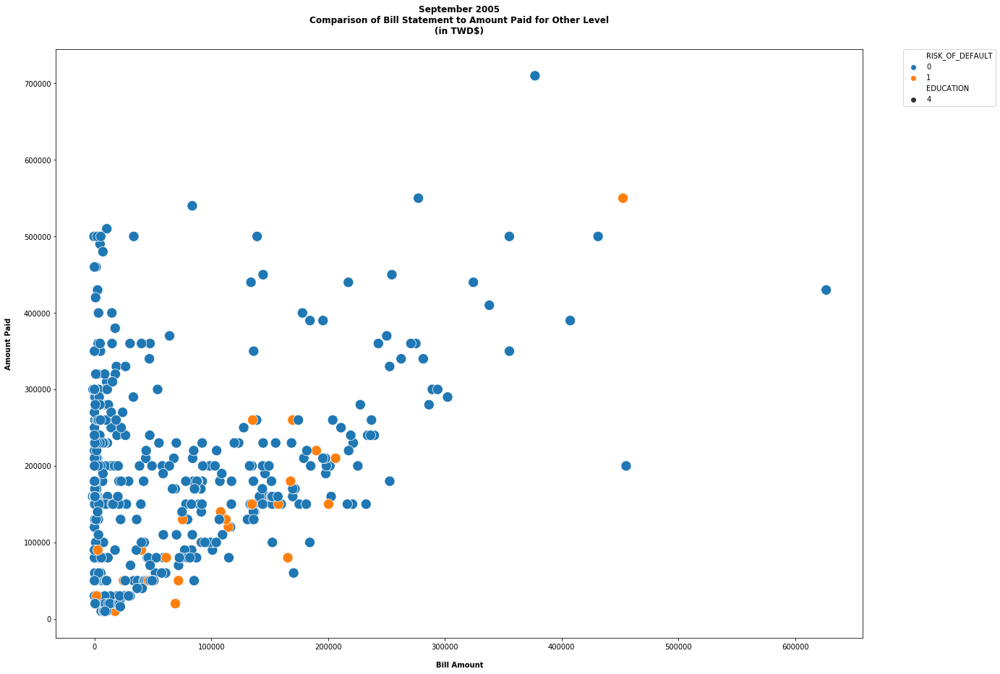

In [539]:
x = otherEL.BILL_AMT1
y = otherEL.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

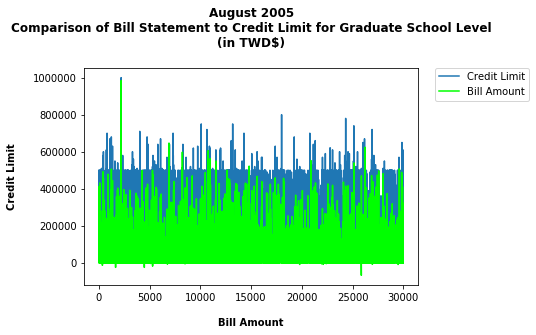

In [540]:
plt.plot(grad_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(grad_school.BILL_AMT2, color = 'lime', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

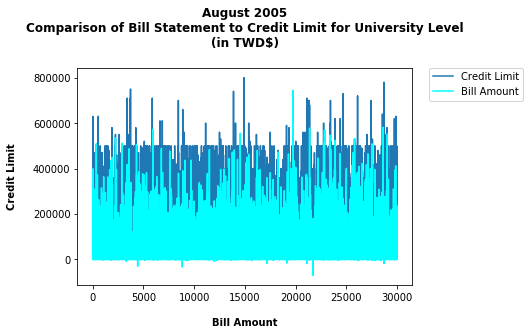

In [541]:
plt.plot(university.LIMIT_BAL, label = 'Credit Limit')
plt.plot(university.BILL_AMT2, color = 'cyan', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

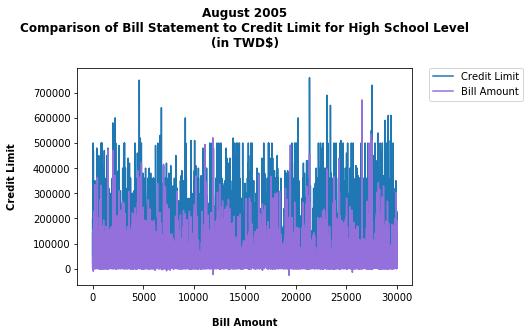

In [542]:
plt.plot(high_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(high_school.BILL_AMT2, color = 'mediumpurple', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

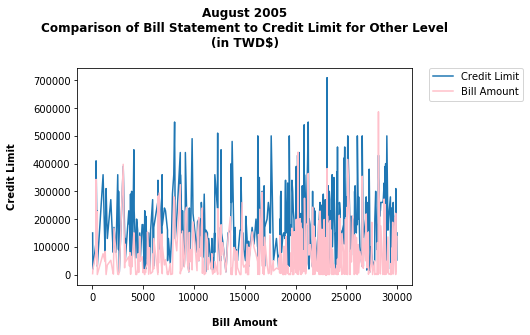

In [543]:
plt.plot(otherEL.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherEL.BILL_AMT2, color = 'pink', label = 'Bill Amount')

plt.title('August 2005\nComparison of Bill Statement to Credit Limit for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

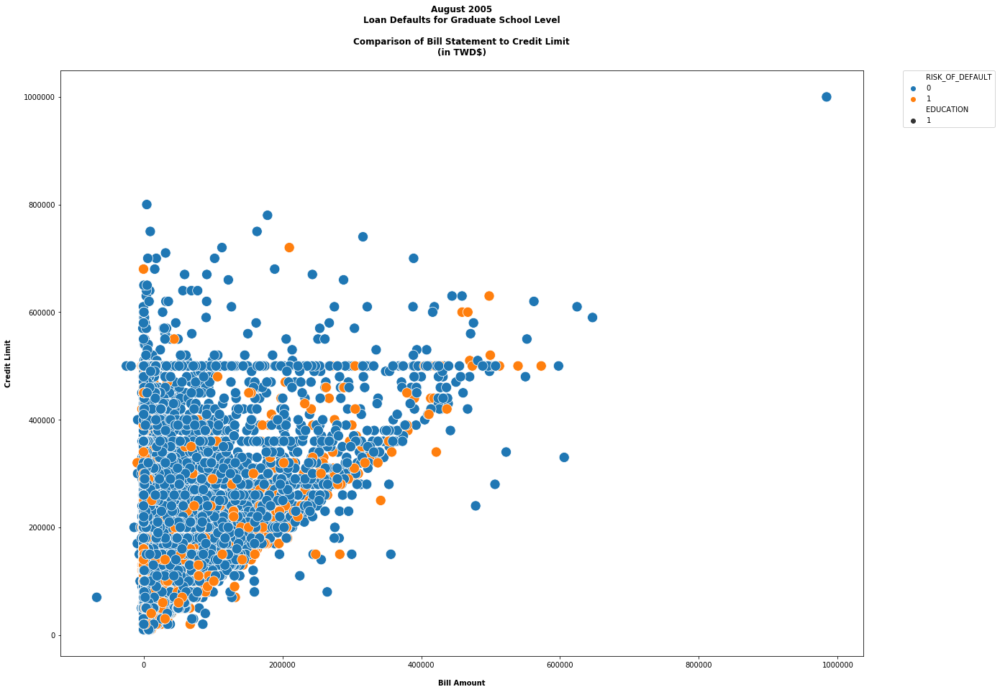

In [544]:
x = grad_school.BILL_AMT2
y = grad_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('August 2005\nLoan Defaults for Graduate School Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

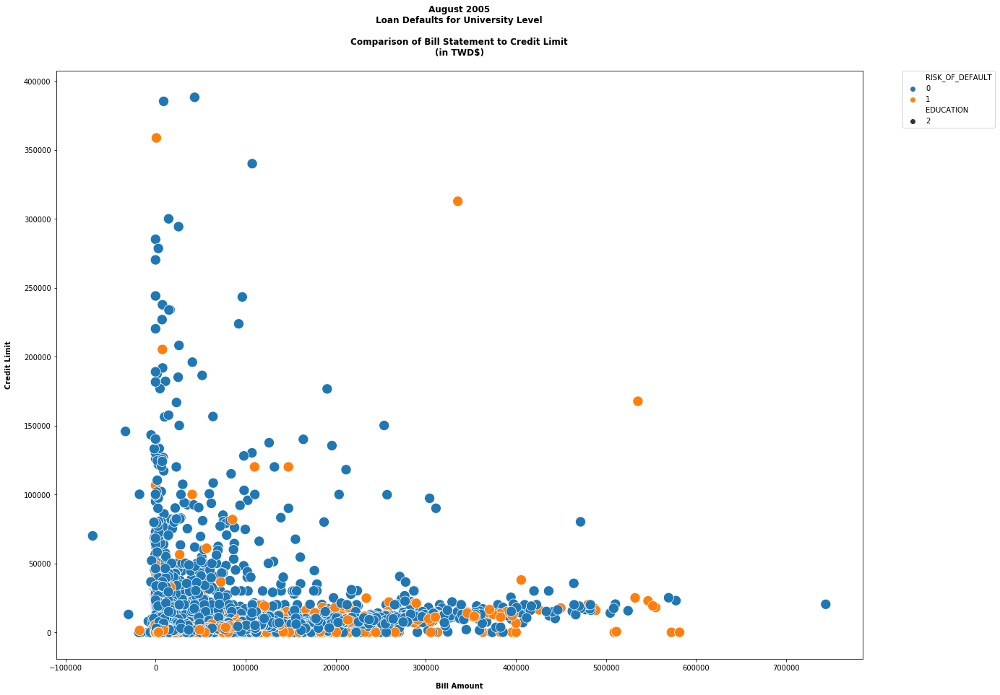

In [545]:
x = university.BILL_AMT2
y = university.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('August 2005\nLoan Defaults for University Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

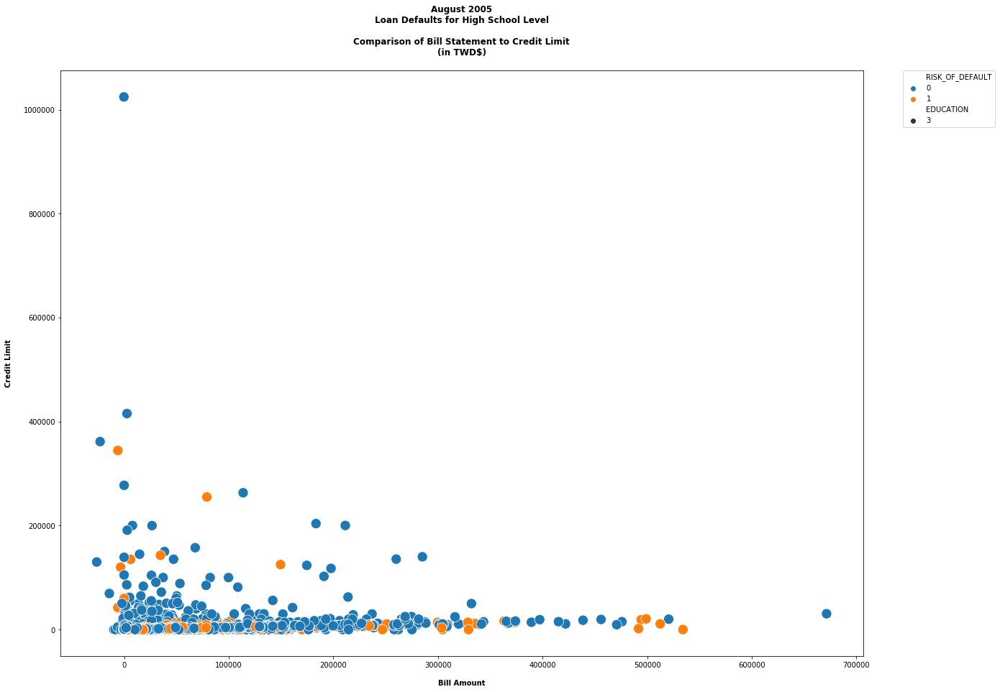

In [546]:
x = high_school.BILL_AMT2
y = high_school.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('August 2005\nLoan Defaults for High School Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

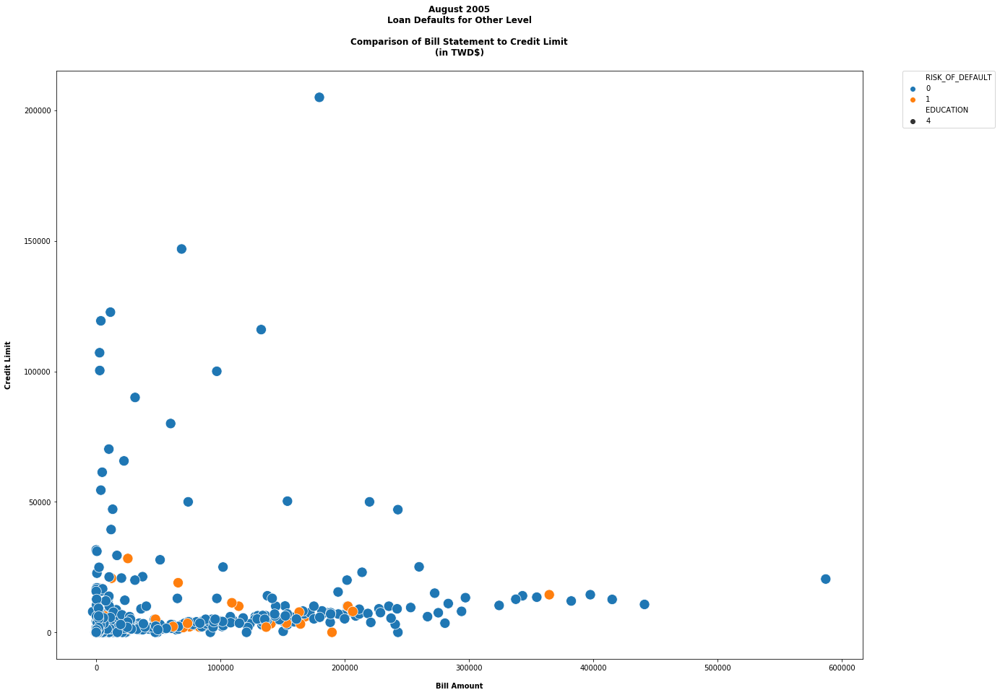

In [547]:
x = otherEL.BILL_AMT2
y = otherEL.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('August 2005\nLoan Defaults for Other Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

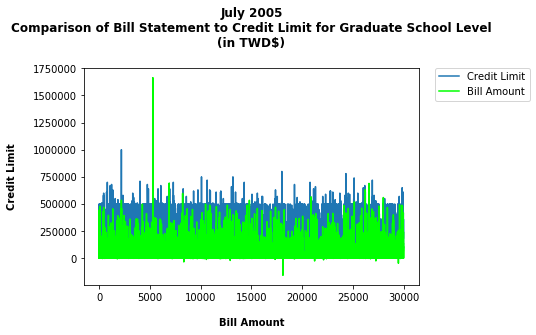

In [548]:
plt.plot(grad_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(grad_school.BILL_AMT3, color = 'lime', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

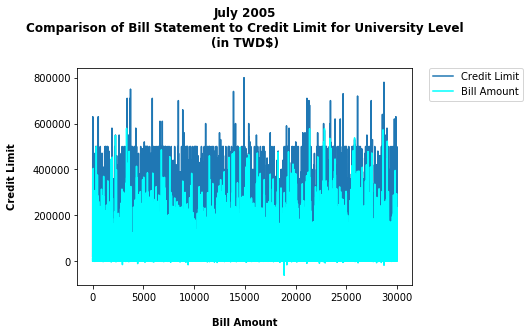

In [549]:
plt.plot(university.LIMIT_BAL, label = 'Credit Limit')
plt.plot(university.BILL_AMT3, color = 'cyan', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

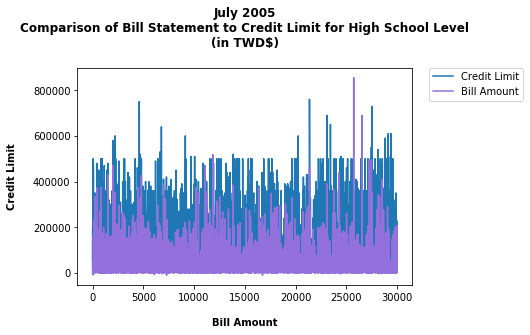

In [550]:
plt.plot(high_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(high_school.BILL_AMT3, color = 'mediumpurple', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

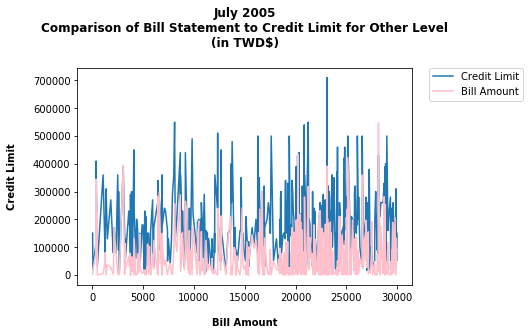

In [551]:
plt.plot(otherEL.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherEL.BILL_AMT3, color = 'pink', label = 'Bill Amount')

plt.title('July 2005\nComparison of Bill Statement to Credit Limit for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

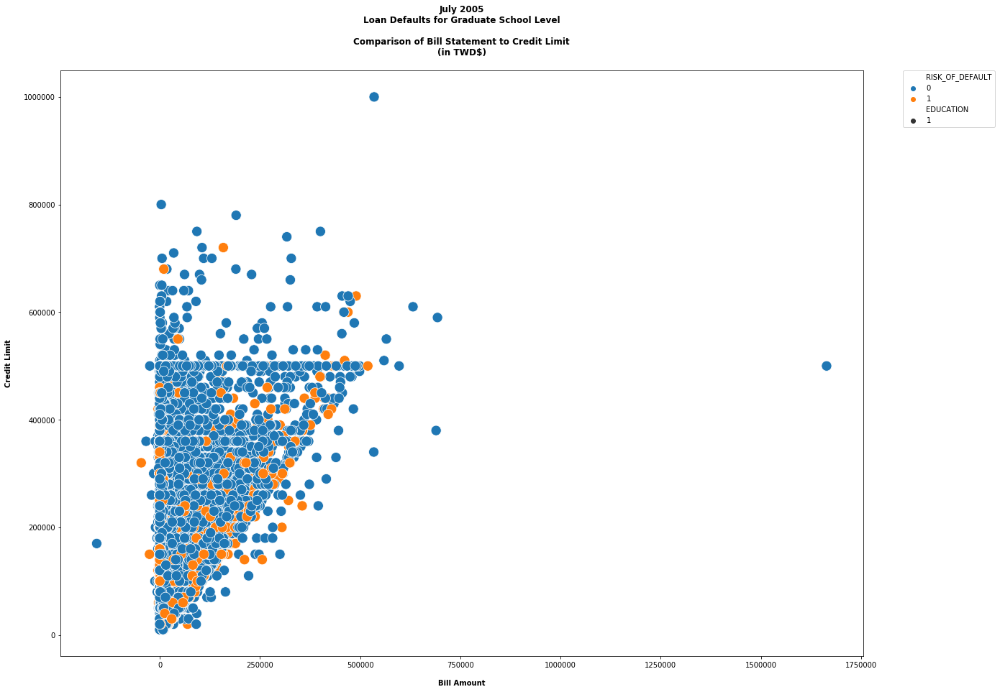

In [552]:
x = grad_school.BILL_AMT3
y = grad_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('July 2005\nLoan Defaults for Graduate School Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

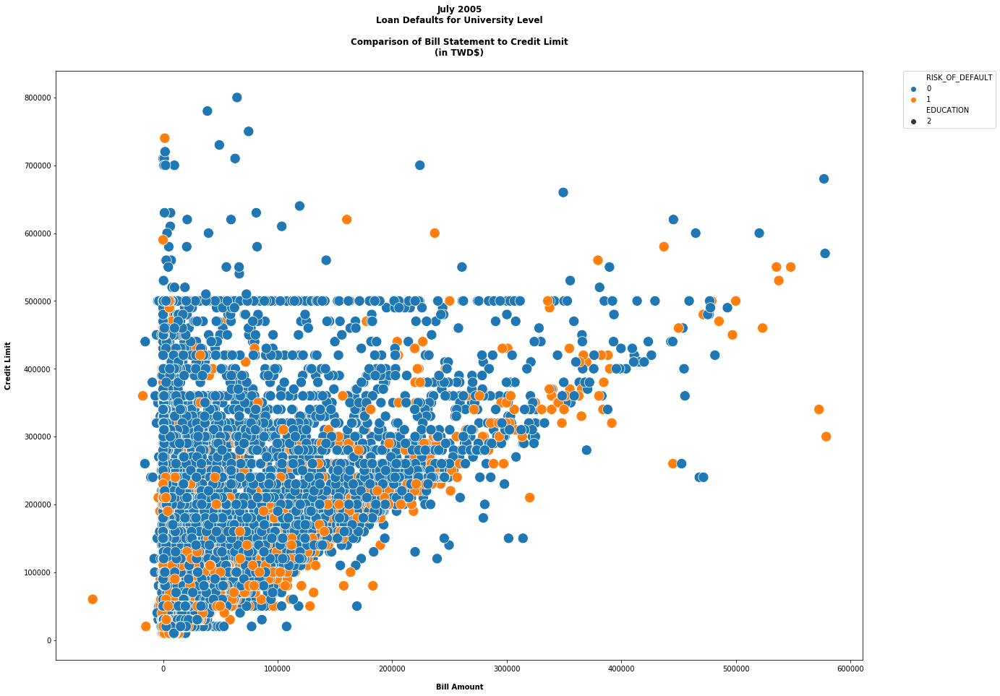

In [553]:
x = university.BILL_AMT3
y = university.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('July 2005\nLoan Defaults for University Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

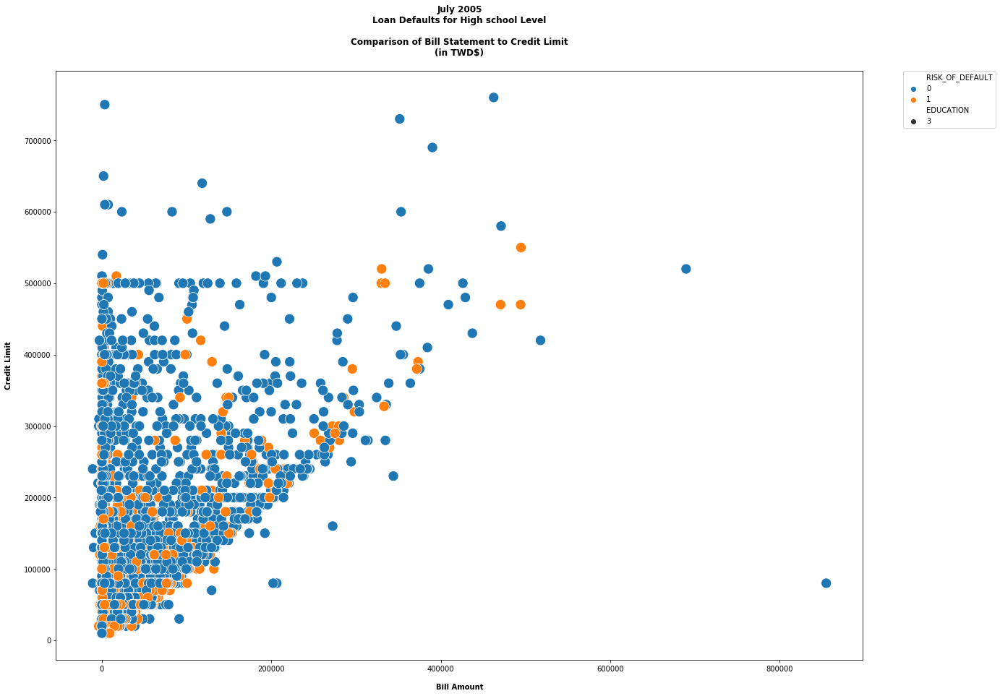

In [554]:
x = high_school.BILL_AMT3
y = high_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('July 2005\nLoan Defaults for High school Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

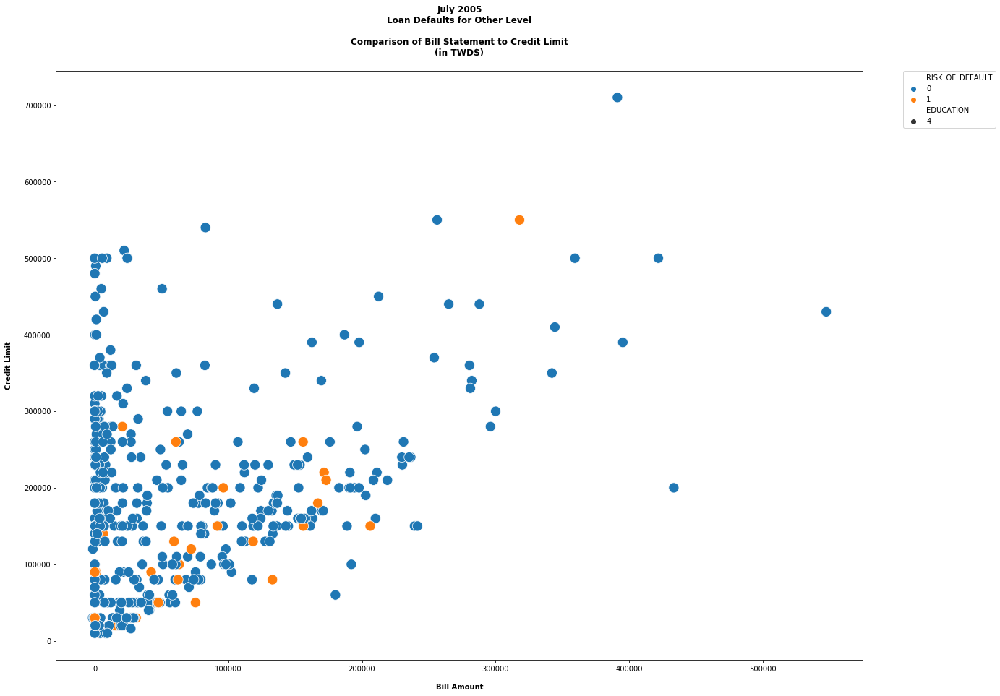

In [555]:
x = otherEL.BILL_AMT3
y = otherEL.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('July 2005\nLoan Defaults for Other Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

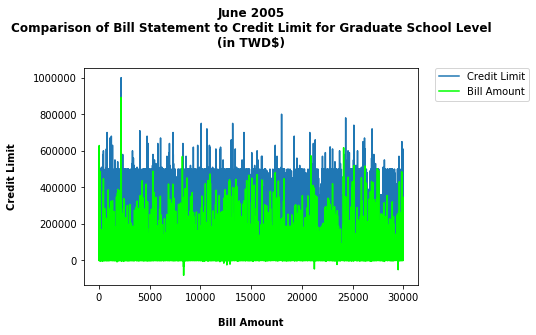

In [556]:
plt.plot(grad_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(grad_school.BILL_AMT4, color = 'lime', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

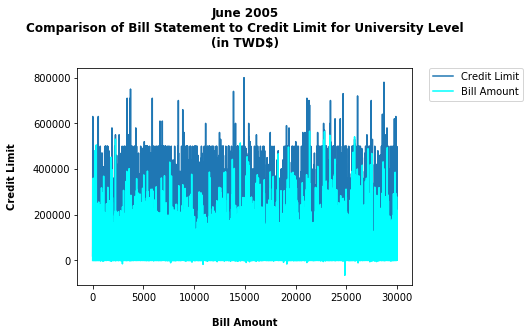

In [557]:
plt.plot(university.LIMIT_BAL, label = 'Credit Limit')
plt.plot(university.BILL_AMT4, color = 'cyan', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

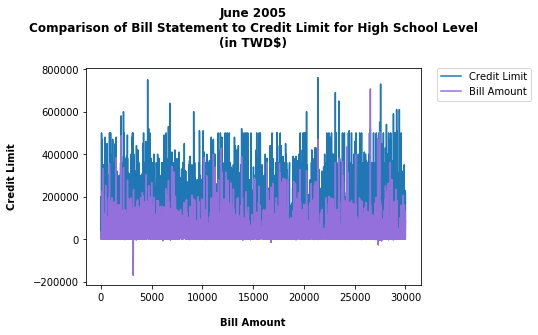

In [558]:
plt.plot(high_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(high_school.BILL_AMT4, color = 'mediumpurple', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

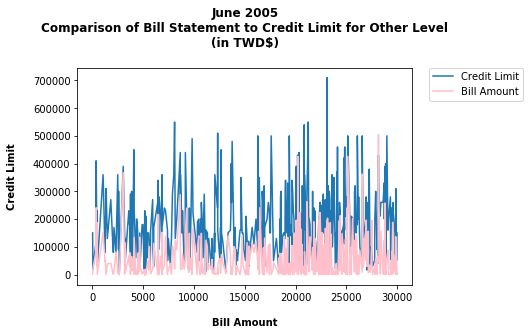

In [559]:
plt.plot(otherEL.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherEL.BILL_AMT4, color = 'pink', label = 'Bill Amount')

plt.title('June 2005\nComparison of Bill Statement to Credit Limit for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

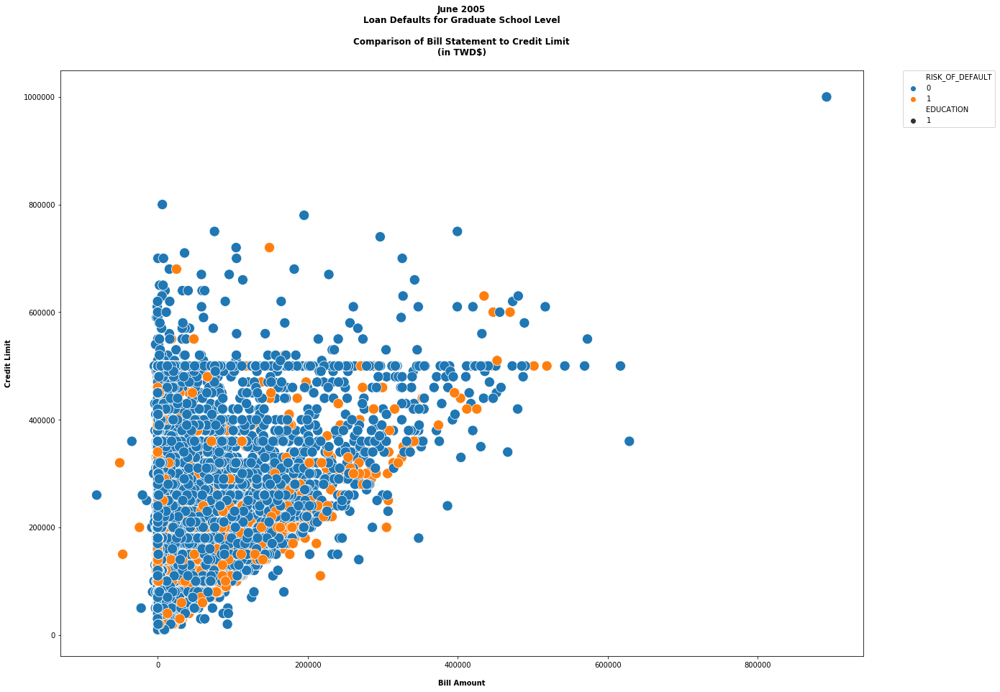

In [560]:
x = grad_school.BILL_AMT4
y = grad_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('June 2005\nLoan Defaults for Graduate School Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

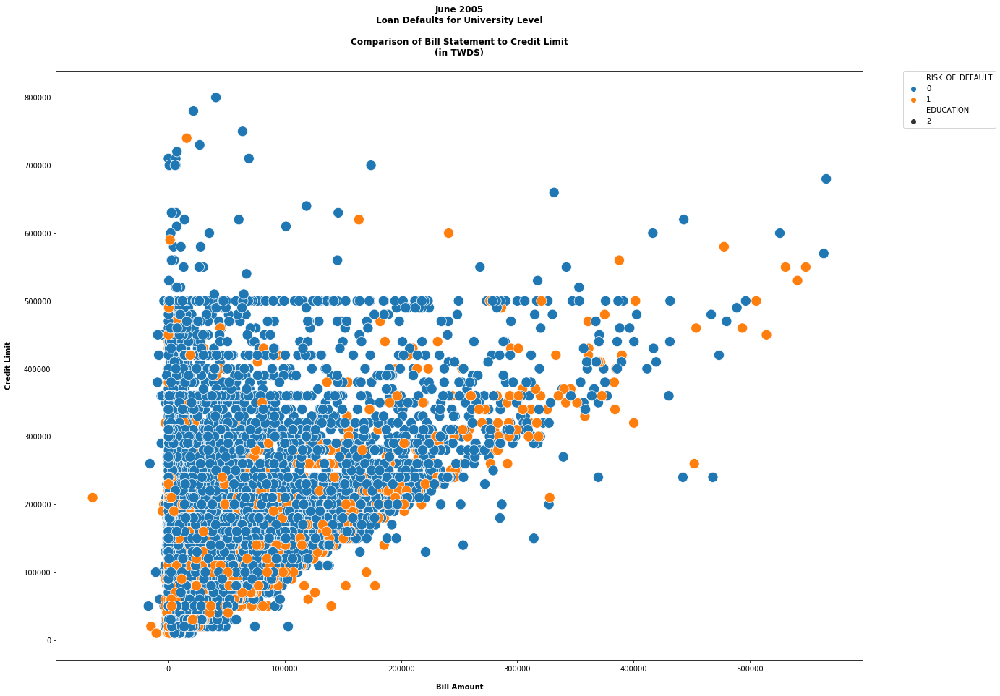

In [561]:
x = university.BILL_AMT4
y = university.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('June 2005\nLoan Defaults for University Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

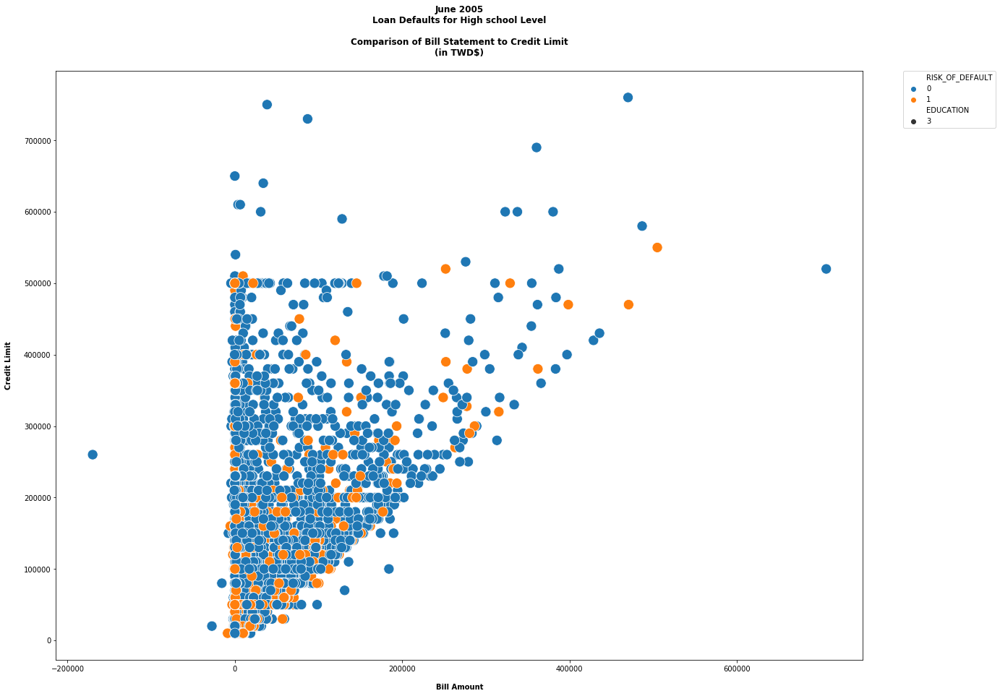

In [562]:
x = high_school.BILL_AMT4
y = high_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('June 2005\nLoan Defaults for High school Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

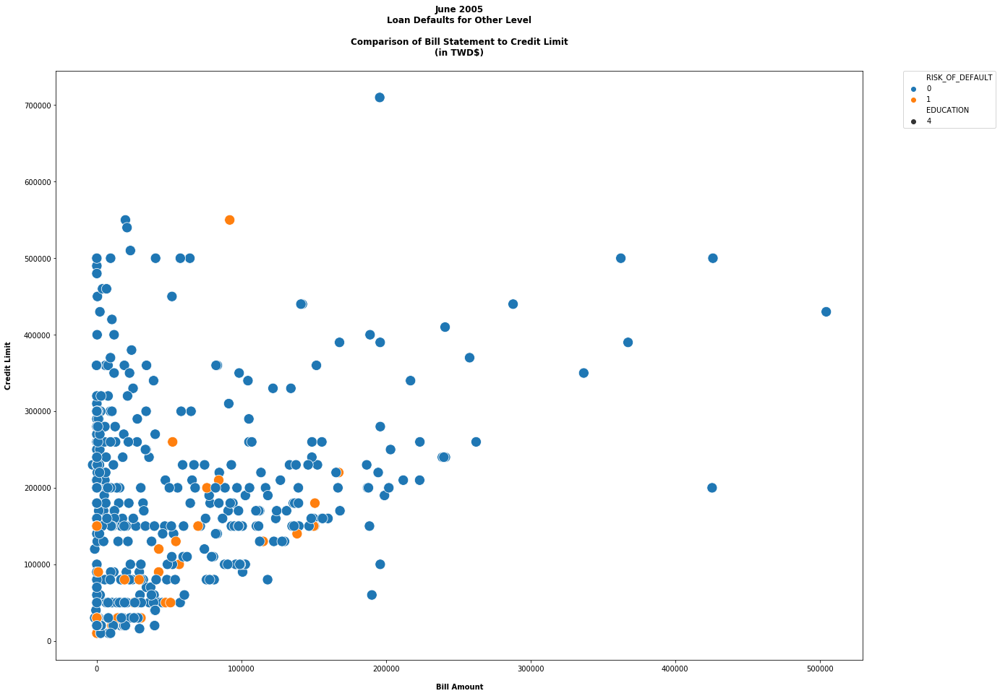

In [563]:
x = otherEL.BILL_AMT4
y = otherEL.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('June 2005\nLoan Defaults for Other Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

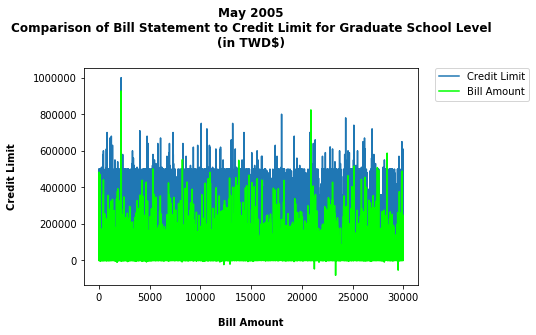

In [564]:
plt.plot(grad_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(grad_school.BILL_AMT5, color = 'lime', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

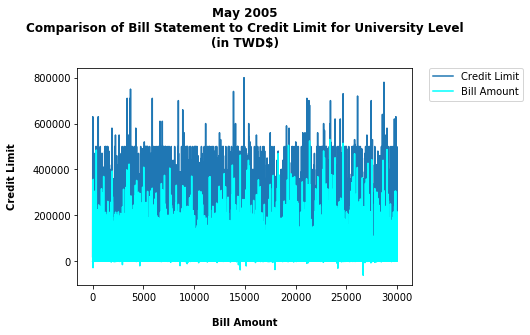

In [565]:
plt.plot(university.LIMIT_BAL, label = 'Credit Limit')
plt.plot(university.BILL_AMT5, color = 'cyan', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

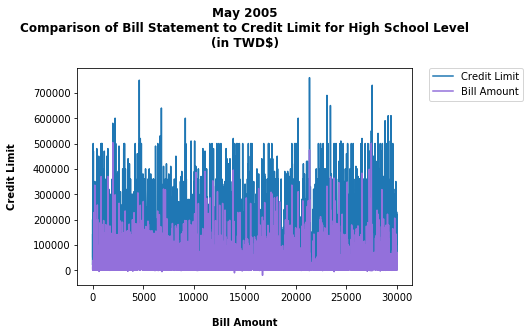

In [566]:
plt.plot(high_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(high_school.BILL_AMT5, color = 'mediumpurple', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

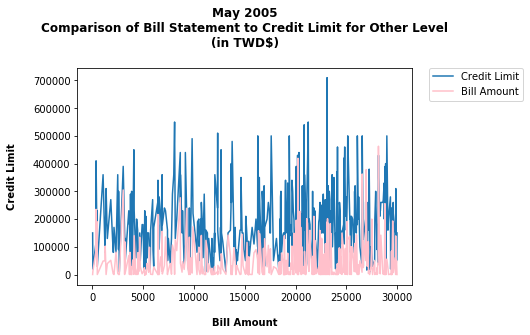

In [567]:
plt.plot(otherEL.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherEL.BILL_AMT5, color = 'pink', label = 'Bill Amount')

plt.title('May 2005\nComparison of Bill Statement to Credit Limit for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

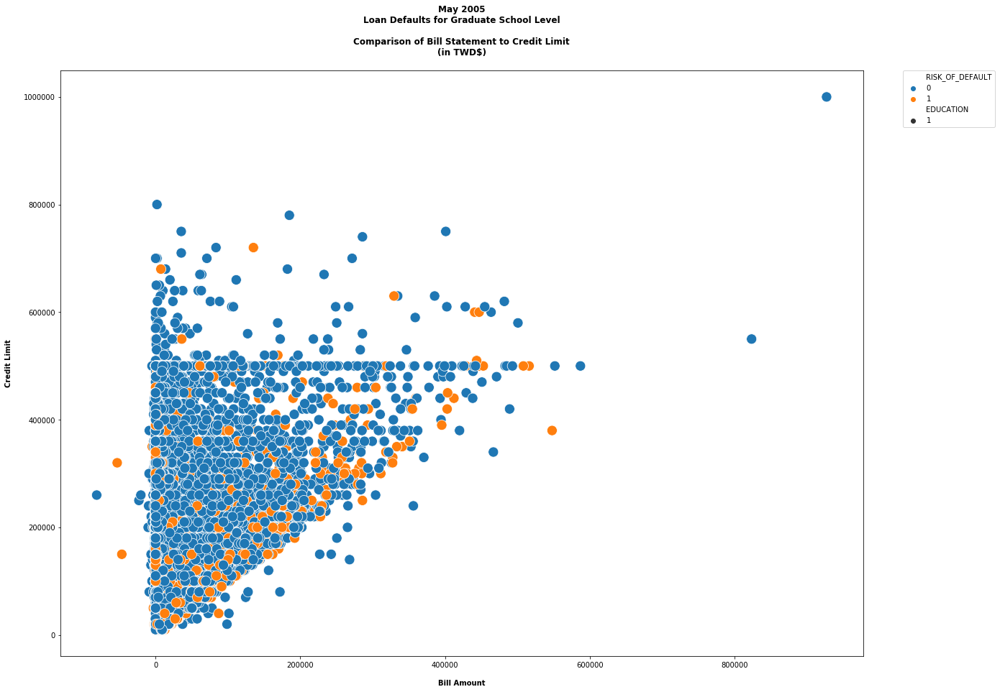

In [568]:
x = grad_school.BILL_AMT5
y = grad_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('May 2005\nLoan Defaults for Graduate School Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

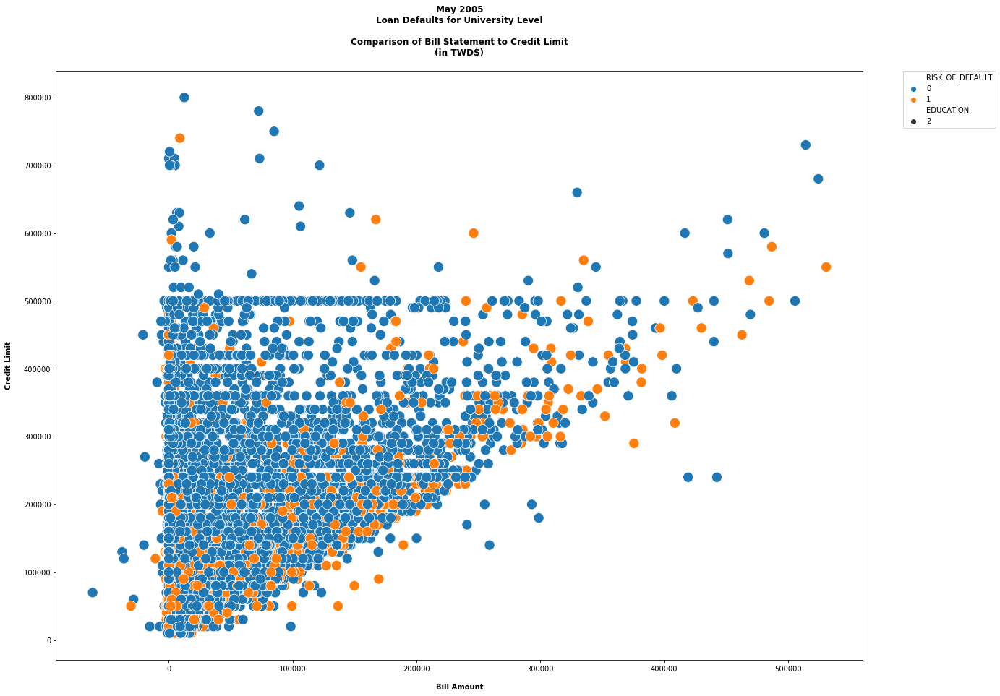

In [569]:
x = university.BILL_AMT5
y = university.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('May 2005\nLoan Defaults for University Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

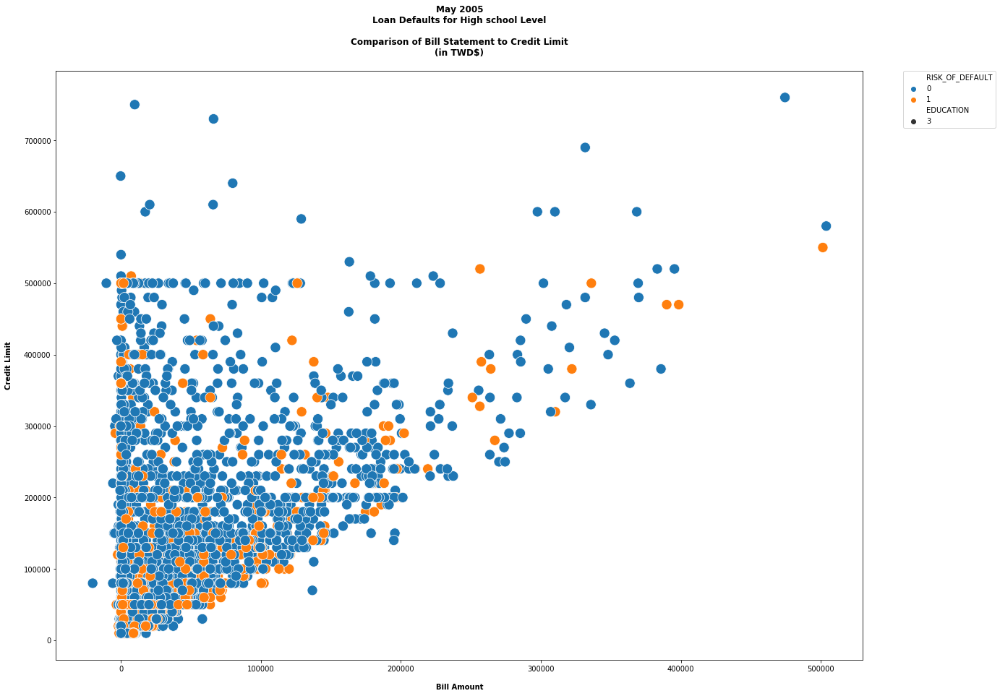

In [570]:
x = high_school.BILL_AMT5
y = high_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('May 2005\nLoan Defaults for High school Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

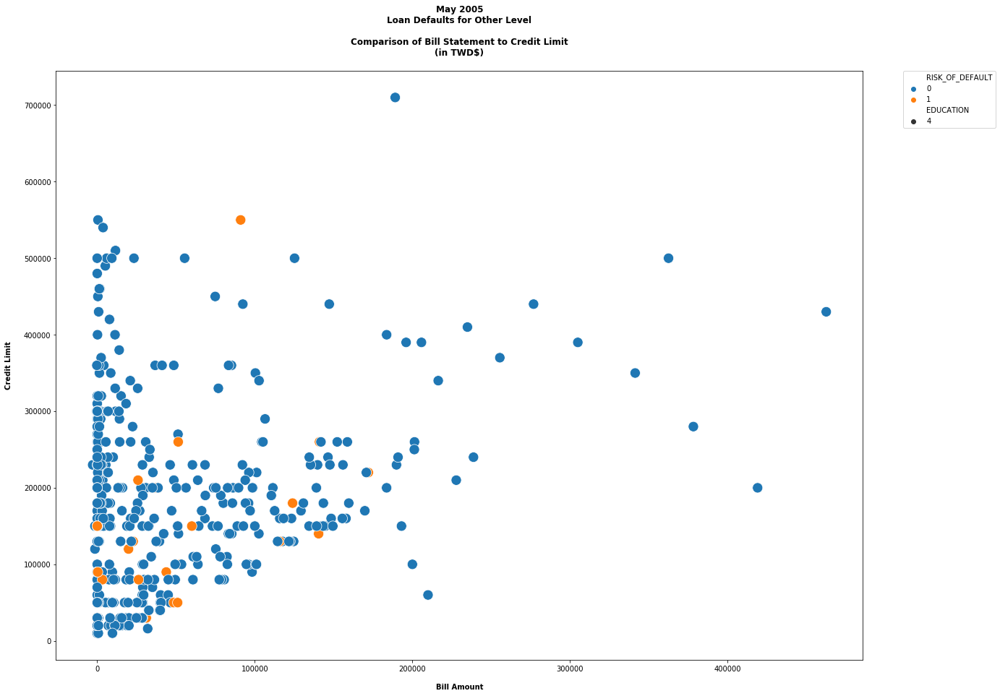

In [571]:
x = otherEL.BILL_AMT5
y = otherEL.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('May 2005\nLoan Defaults for Other Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

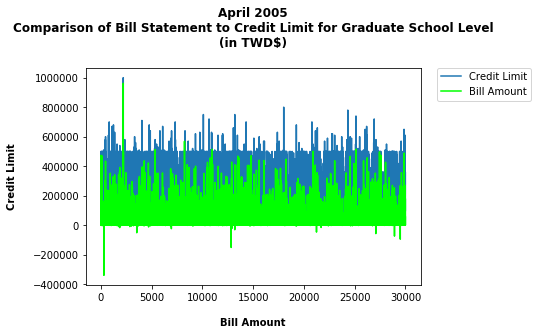

In [572]:
plt.plot(grad_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(grad_school.BILL_AMT6, color = 'lime', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

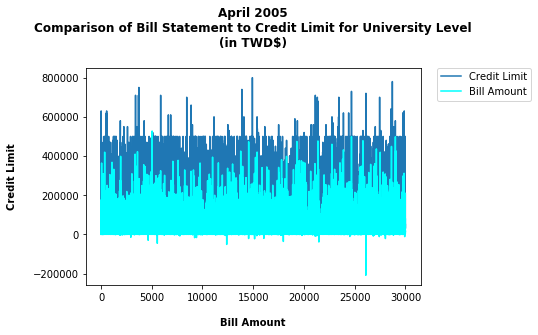

In [573]:
plt.plot(university.LIMIT_BAL, label = 'Credit Limit')
plt.plot(university.BILL_AMT6, color = 'cyan', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

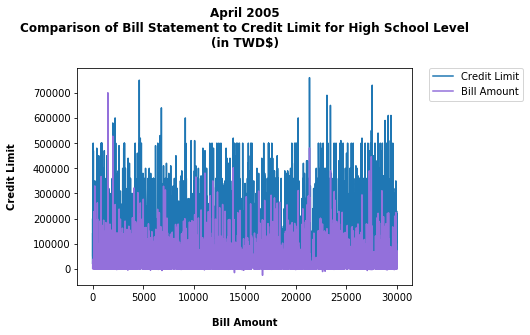

In [574]:
plt.plot(high_school.LIMIT_BAL, label = 'Credit Limit')
plt.plot(high_school.BILL_AMT6, color = 'mediumpurple', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

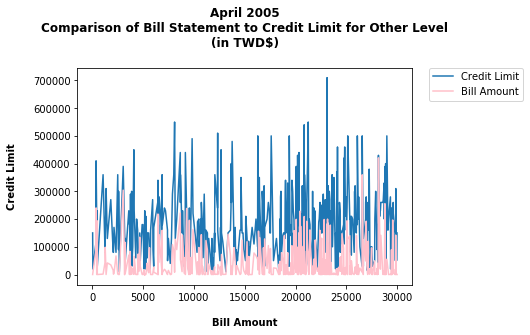

In [575]:
plt.plot(otherEL.LIMIT_BAL, label = 'Credit Limit')
plt.plot(otherEL.BILL_AMT6, color = 'pink', label = 'Bill Amount')

plt.title('April 2005\nComparison of Bill Statement to Credit Limit for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

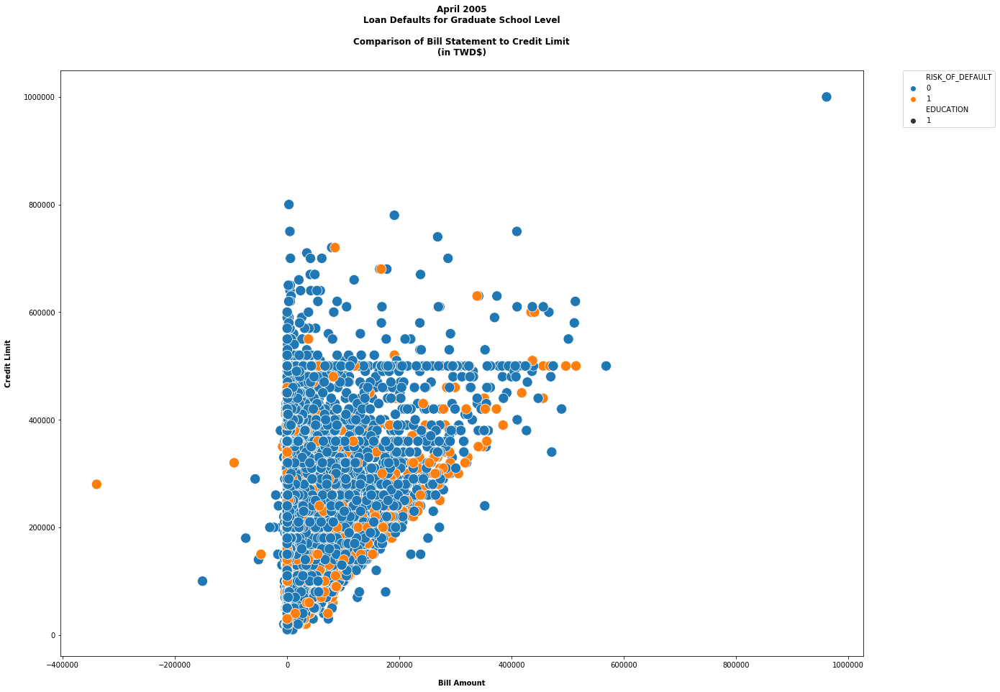

In [576]:
x = grad_school.BILL_AMT6
y = grad_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('April 2005\nLoan Defaults for Graduate School Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

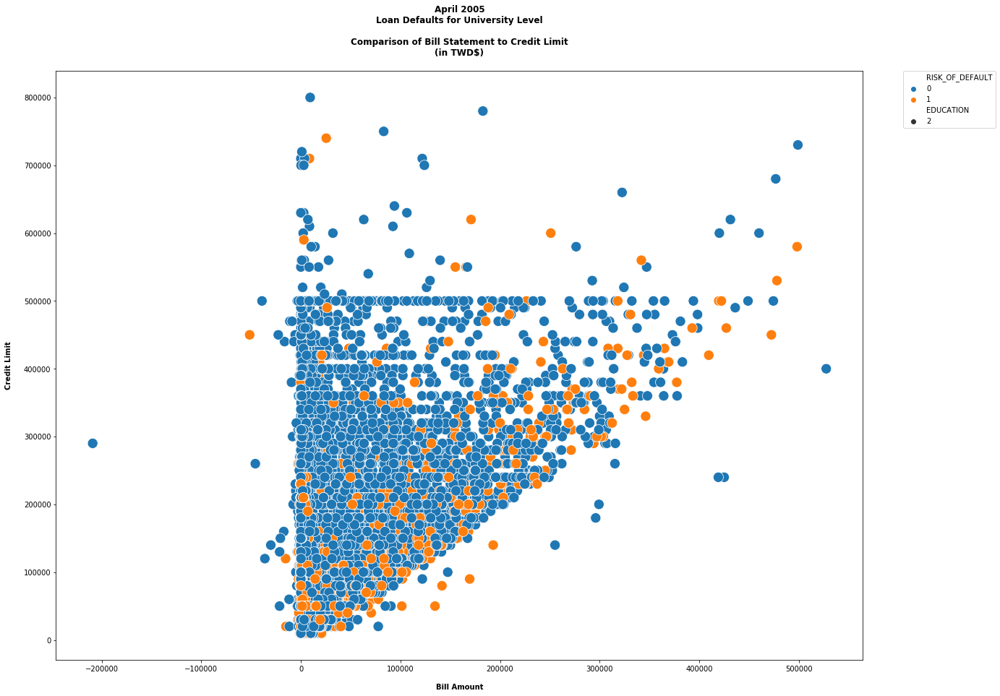

In [577]:
x = university.BILL_AMT6
y = university.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('April 2005\nLoan Defaults for University Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

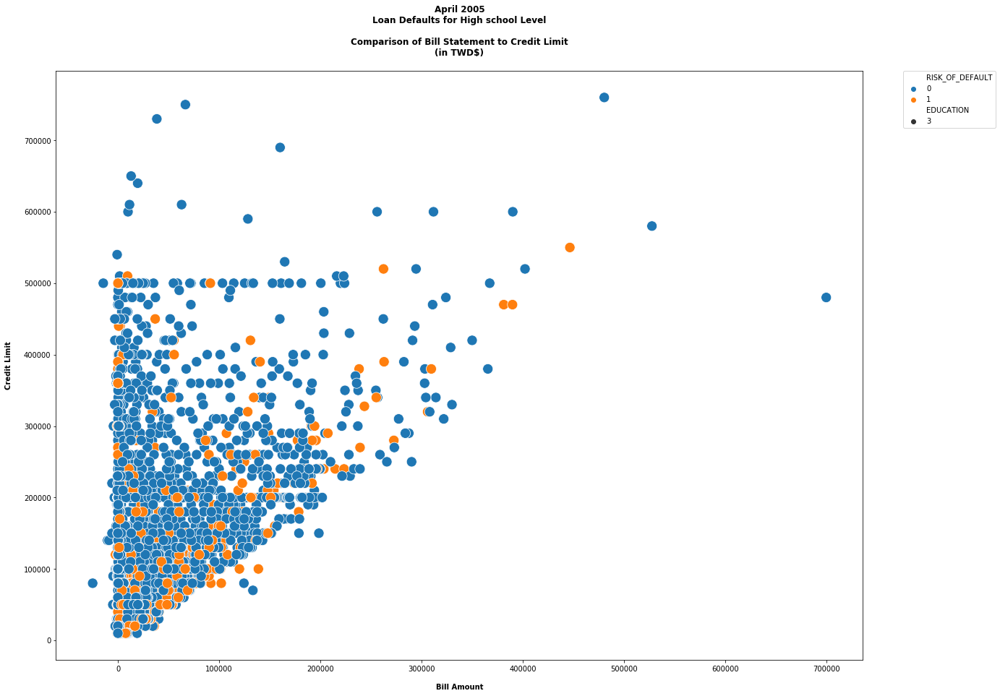

In [578]:
x = high_school.BILL_AMT6
y = high_school.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('April 2005\nLoan Defaults for High school Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

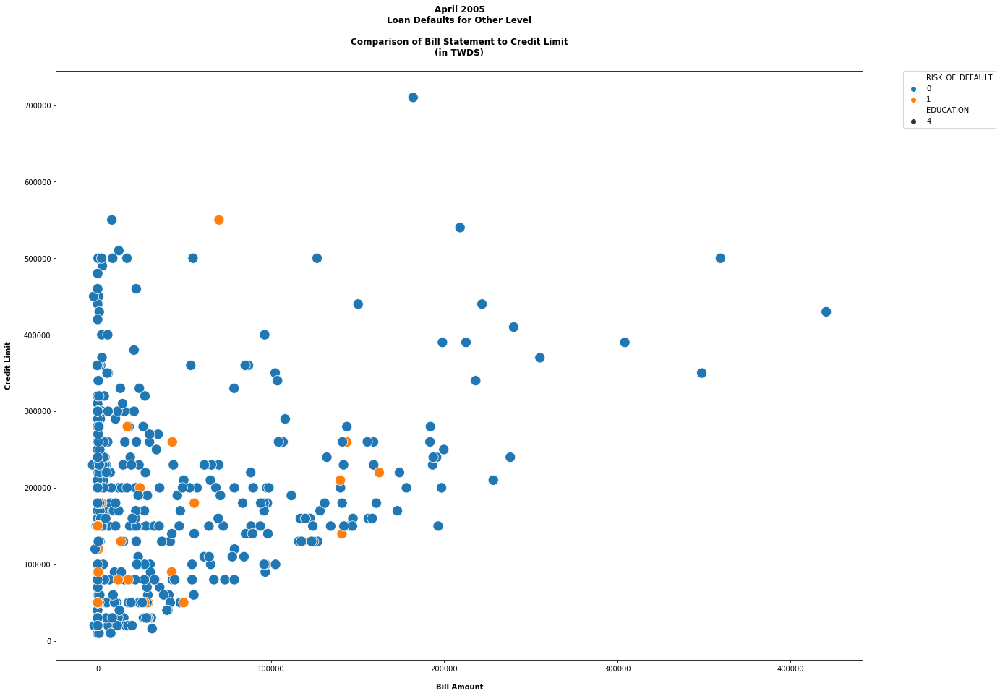

In [579]:
x = otherEL.BILL_AMT6
y = otherEL.LIMIT_BAL

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('April 2005\nLoan Defaults for Other Level\n\nComparison of Bill Statement to Credit Limit\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Credit Limit\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

# Comparison - Monthly Bill Statements & Paid Amounts by Education Level

## September 2005

### Line Plots

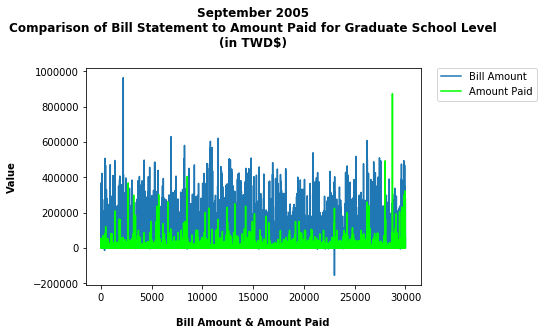

In [580]:
plt.plot(grad_school.BILL_AMT1, label = 'Bill Amount')
plt.plot(grad_school.PAY_AMT1, color = 'lime', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

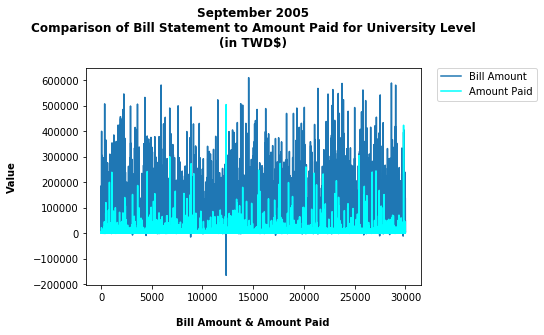

In [581]:
plt.plot(university.BILL_AMT1, label = 'Bill Amount')
plt.plot(university.PAY_AMT1, color = 'cyan', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

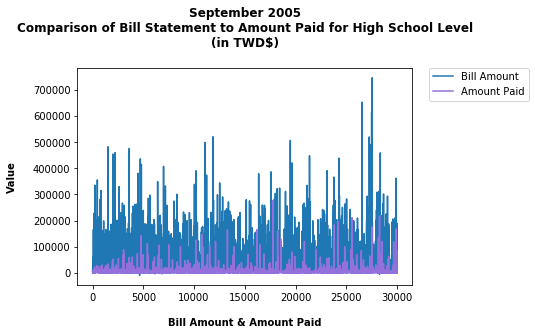

In [582]:
plt.plot(high_school.BILL_AMT1, label = 'Bill Amount')
plt.plot(high_school.PAY_AMT1, color = 'mediumpurple', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

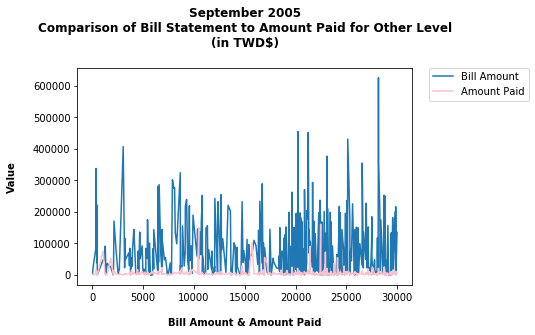

In [583]:
plt.plot(otherEL.BILL_AMT1, label = 'Bill Amount')
plt.plot(otherEL.PAY_AMT1, color = 'pink', label = 'Amount Paid')

plt.title('September 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

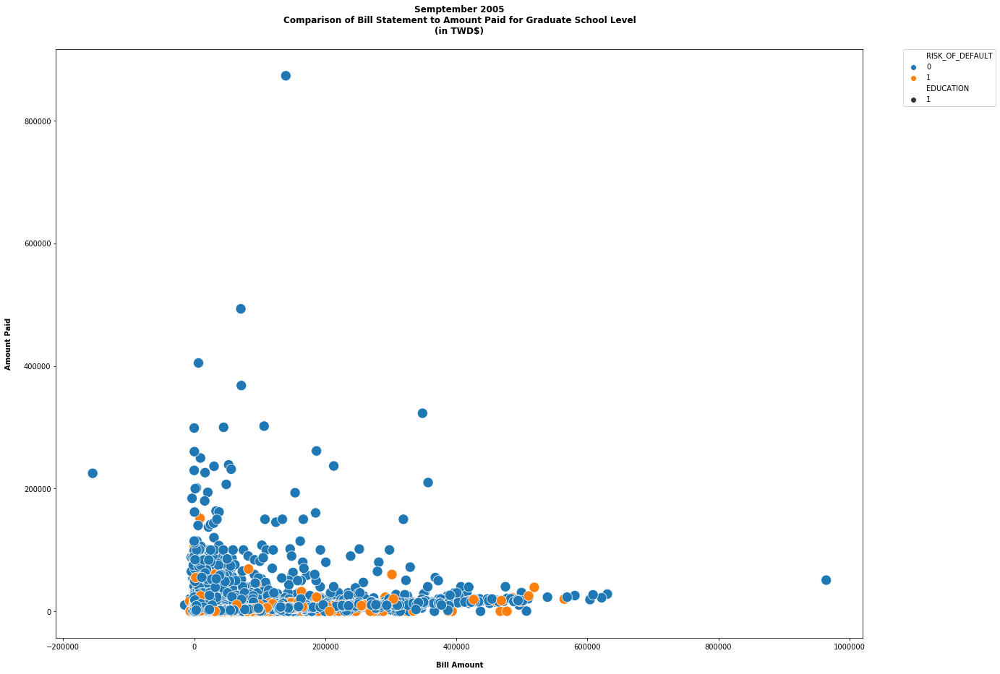

In [584]:
x = grad_school.BILL_AMT1
y = grad_school.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('Semptember 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

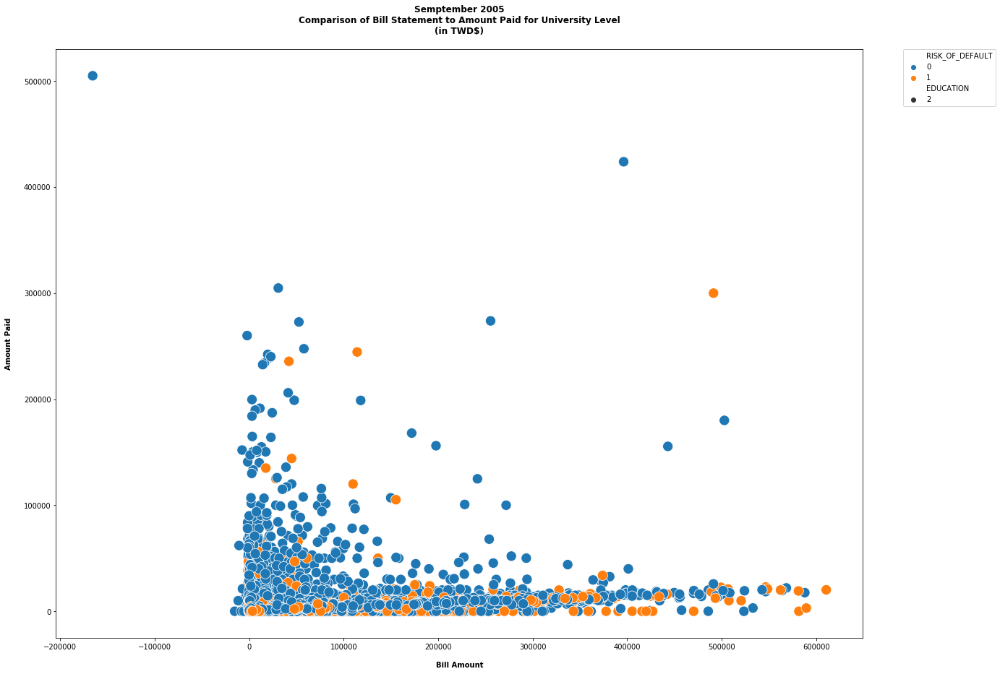

In [585]:
x = university.BILL_AMT1
y = university.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('Semptember 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

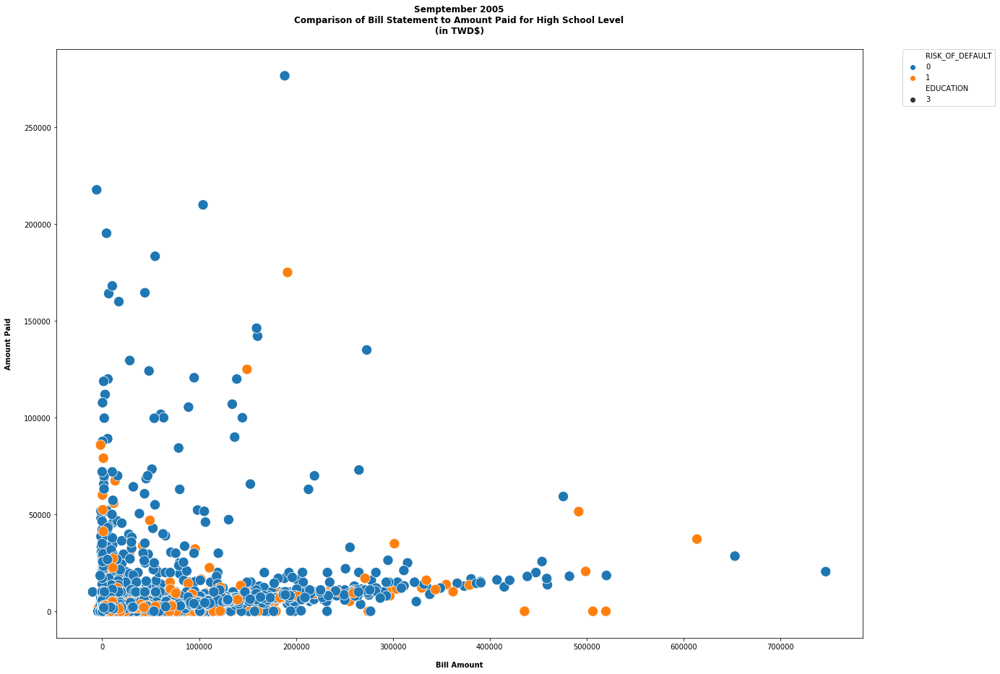

In [586]:
x = high_school.BILL_AMT1
y = high_school.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('Semptember 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

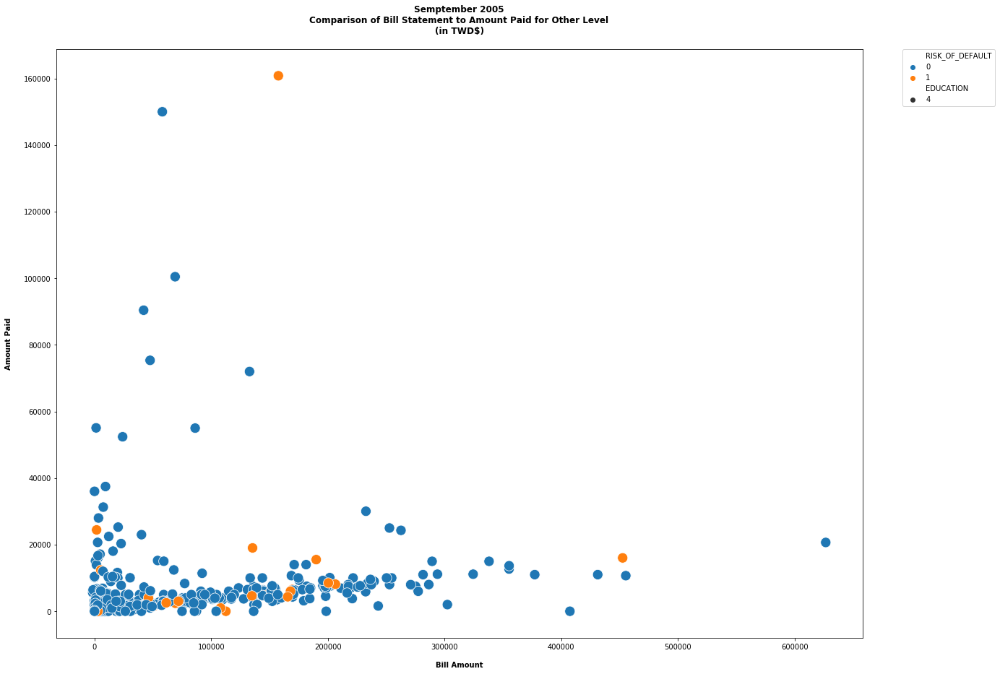

In [587]:
x = otherEL.BILL_AMT1
y = otherEL.PAY_AMT1

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('Semptember 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## August 2005

### Line Plots

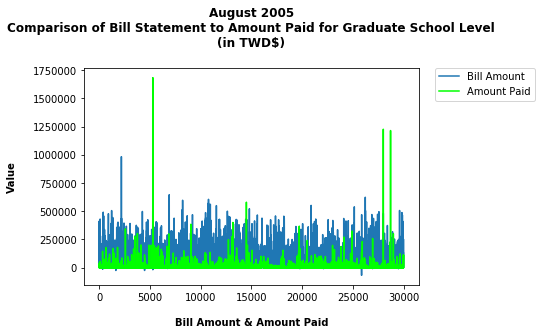

In [588]:
plt.plot(grad_school.BILL_AMT2, label = 'Bill Amount')
plt.plot(grad_school.PAY_AMT2, color = 'lime', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

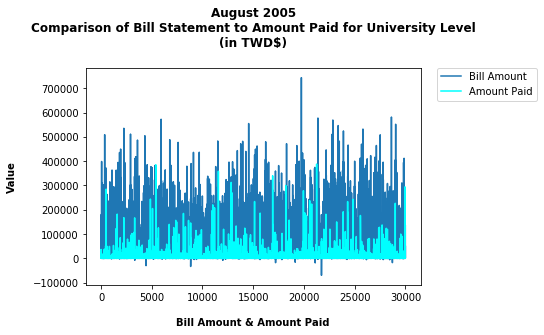

In [589]:
plt.plot(university.BILL_AMT2, label = 'Bill Amount')
plt.plot(university.PAY_AMT2, color = 'cyan', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

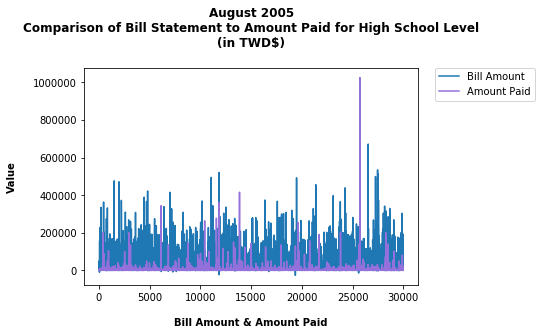

In [590]:
plt.plot(high_school.BILL_AMT2, label = 'Bill Amount')
plt.plot(high_school.PAY_AMT2, color = 'mediumpurple', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

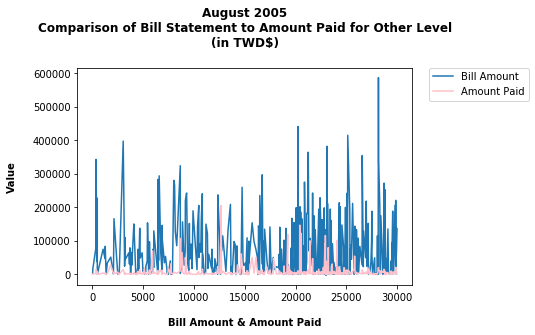

In [591]:
plt.plot(otherEL.BILL_AMT2, label = 'Bill Amount')
plt.plot(otherEL.PAY_AMT2, color = 'pink', label = 'Amount Paid')

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

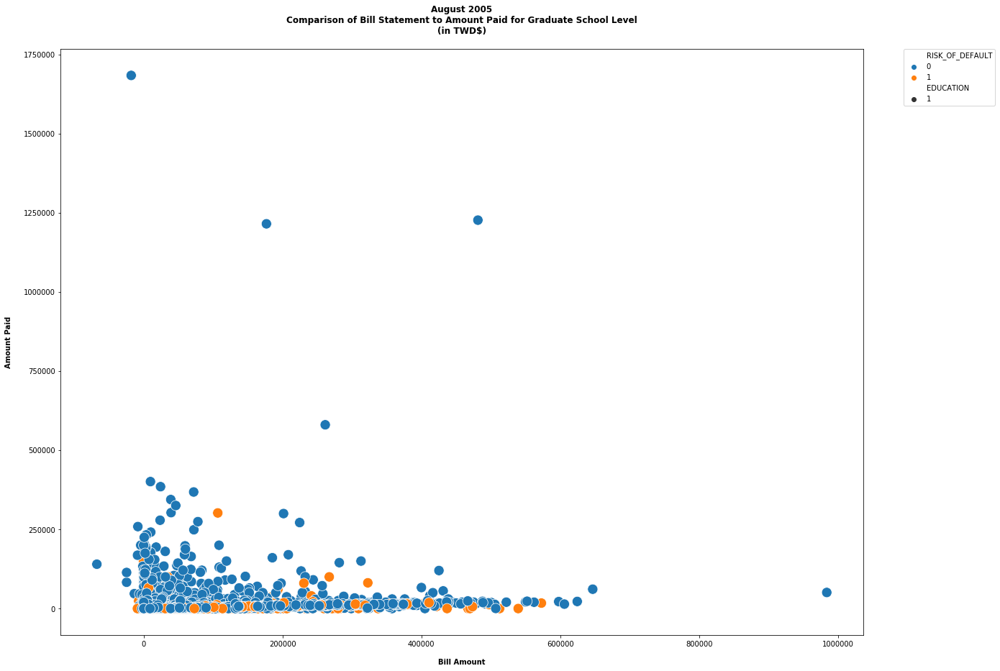

In [592]:
x = grad_school.BILL_AMT2
y = grad_school.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

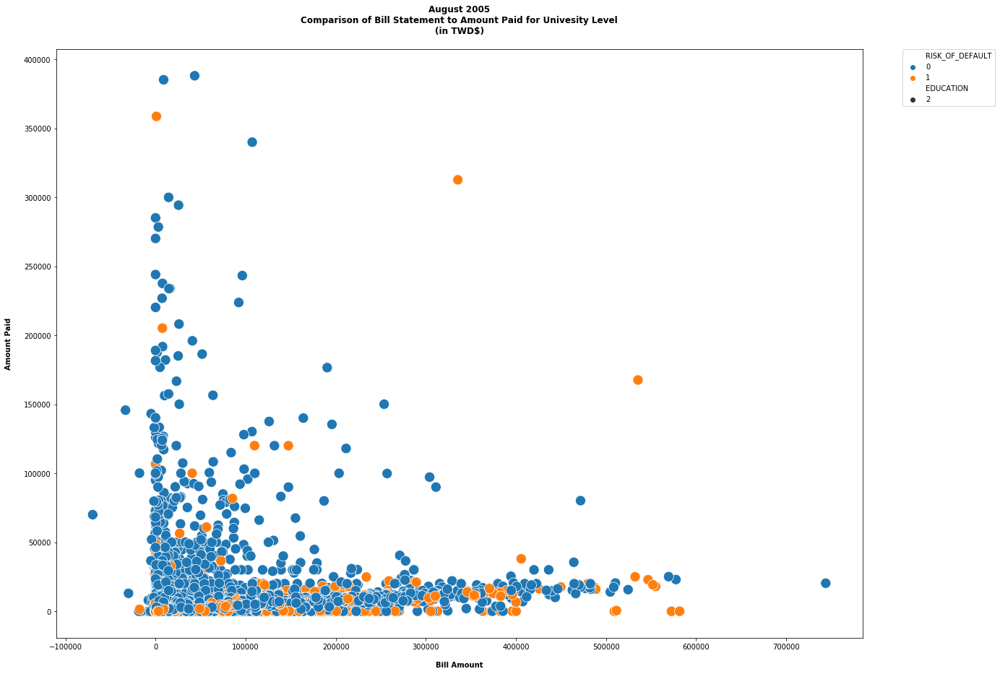

In [593]:
x = university.BILL_AMT2
y = university.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Univesity Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

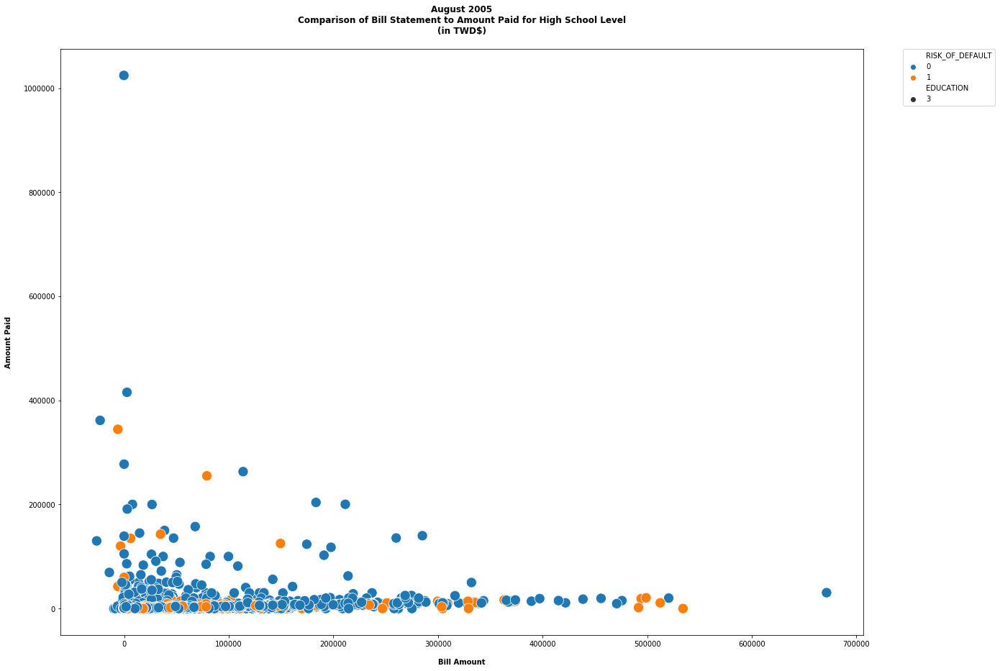

In [594]:
x = high_school.BILL_AMT2
y = high_school.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

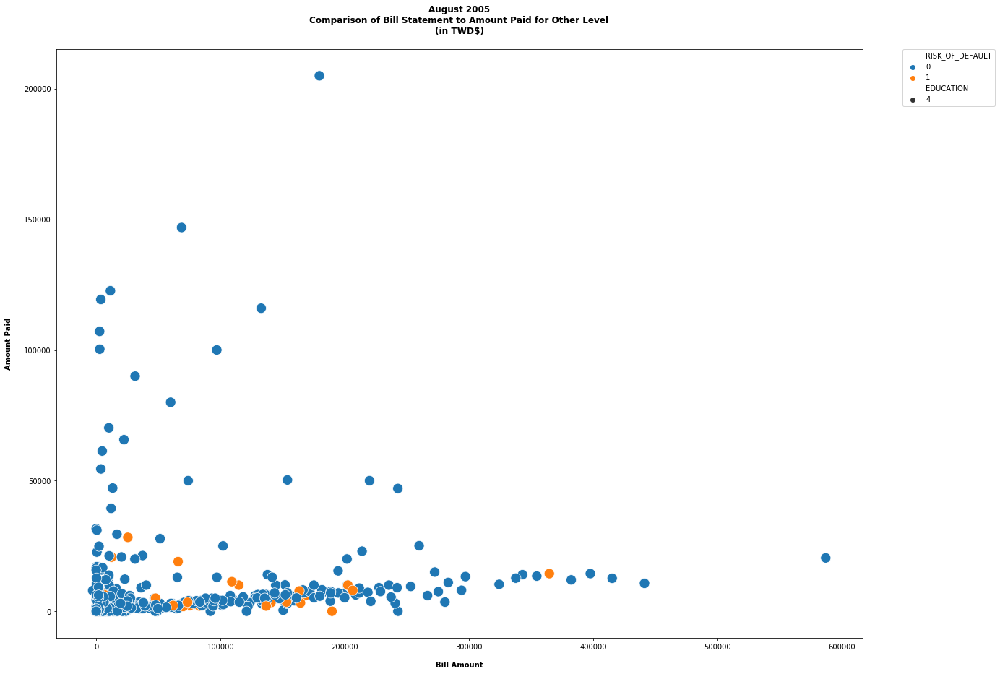

In [595]:
x = otherEL.BILL_AMT2
y = otherEL.PAY_AMT2

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('August 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## July 2005

### Line Plots

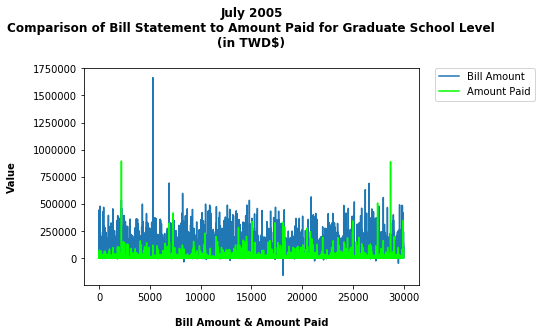

In [596]:
plt.plot(grad_school.BILL_AMT3, label = 'Bill Amount')
plt.plot(grad_school.PAY_AMT3, color = 'lime', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

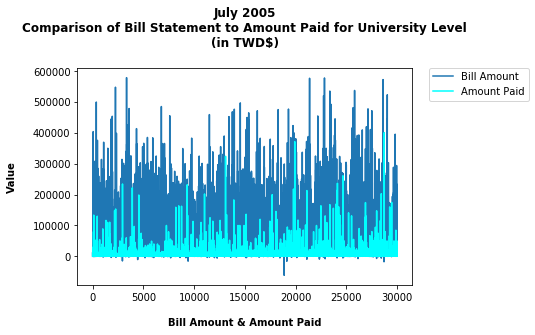

In [597]:
plt.plot(university.BILL_AMT3, label = 'Bill Amount')
plt.plot(university.PAY_AMT3, color = 'cyan', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

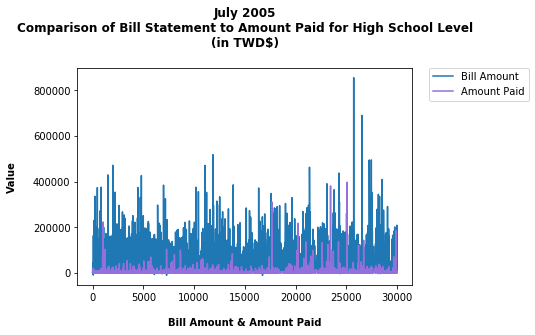

In [598]:
plt.plot(high_school.BILL_AMT3, label = 'Bill Amount')
plt.plot(high_school.PAY_AMT3, color = 'mediumpurple', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

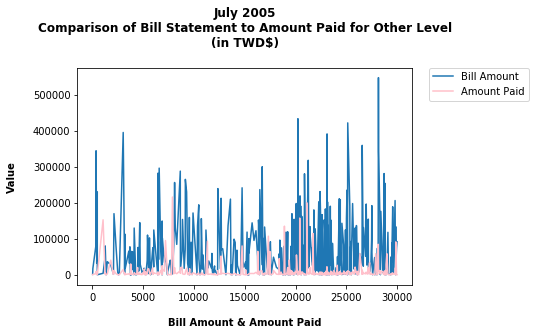

In [599]:
plt.plot(otherEL.BILL_AMT3, label = 'Bill Amount')
plt.plot(otherEL.PAY_AMT3, color = 'pink', label = 'Amount Paid')

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

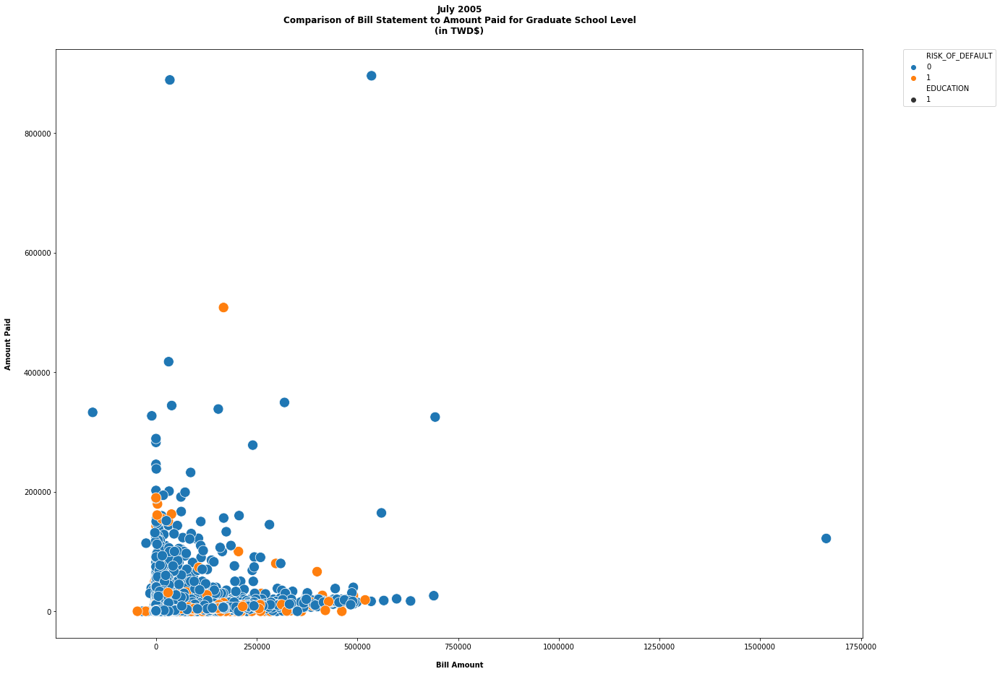

In [600]:
x = grad_school.BILL_AMT3
y = grad_school.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

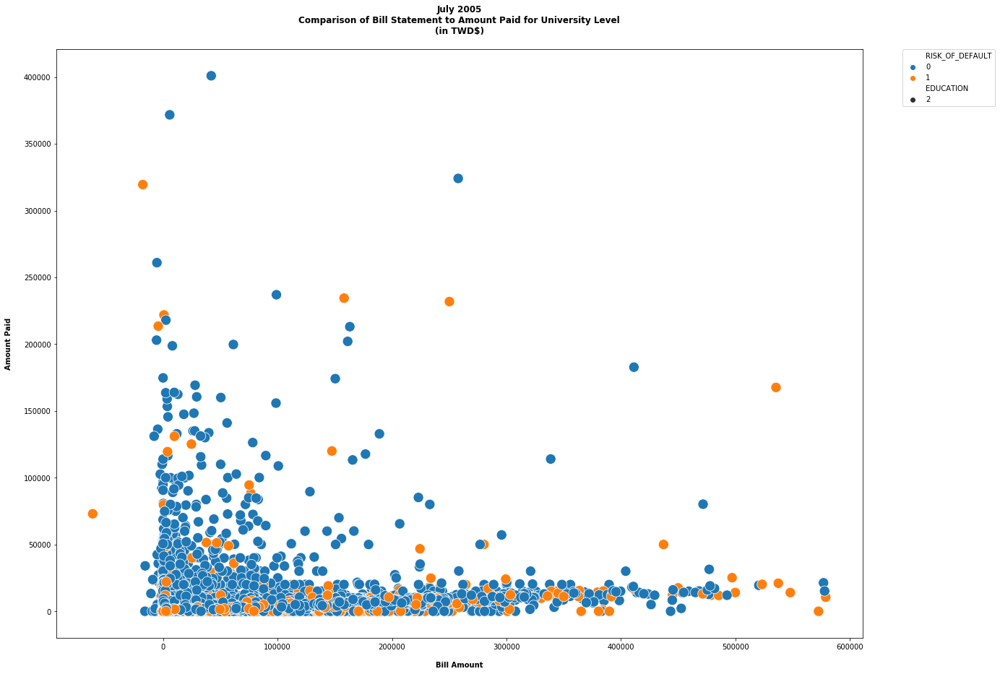

In [601]:
x = university.BILL_AMT3
y = university.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

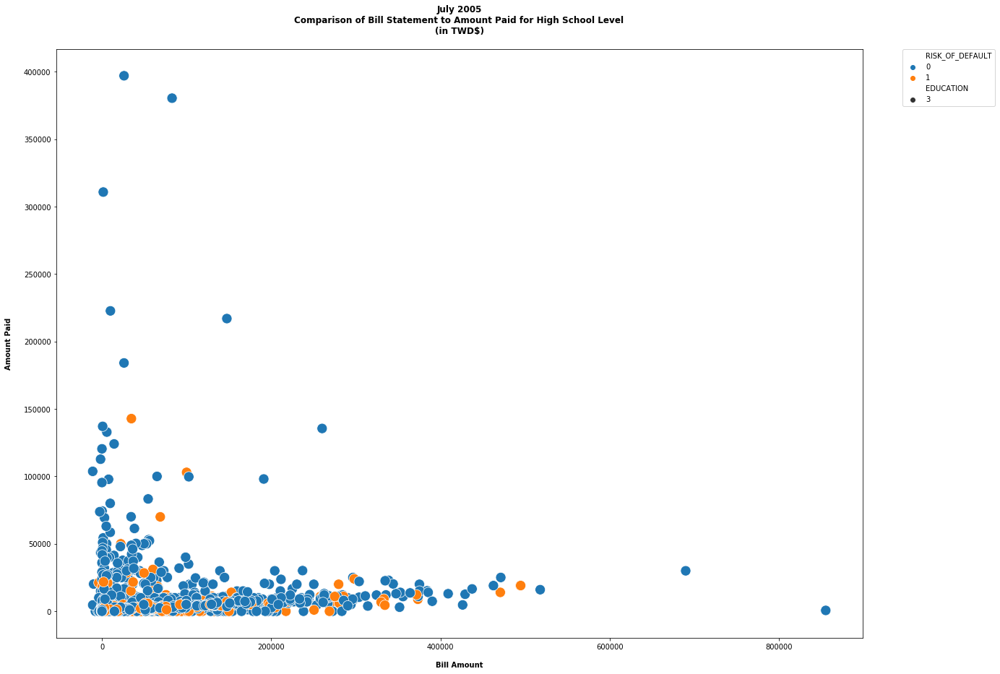

In [602]:
x = high_school.BILL_AMT3
y = high_school.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

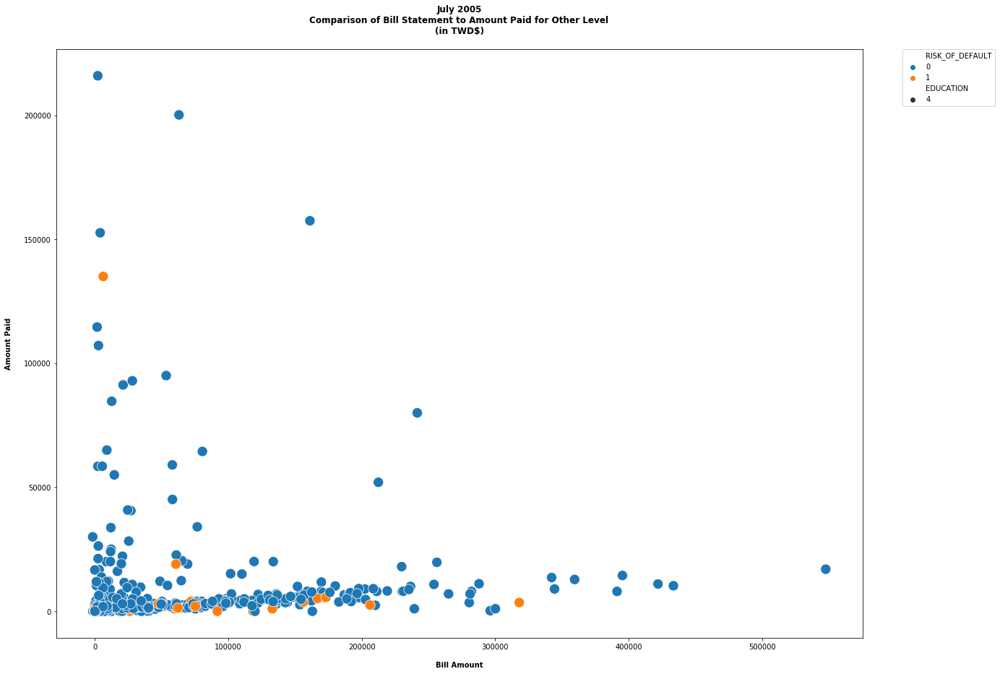

In [603]:
x = otherEL.BILL_AMT3
y = otherEL.PAY_AMT3

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('July 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## June 2005

### Line Plots

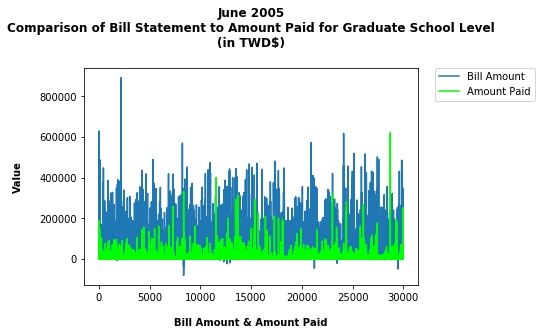

In [604]:
plt.plot(grad_school.BILL_AMT4, label = 'Bill Amount')
plt.plot(grad_school.PAY_AMT4, color = 'lime', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

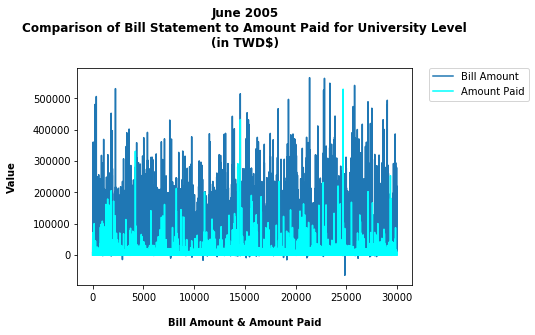

In [605]:
plt.plot(university.BILL_AMT4, label = 'Bill Amount')
plt.plot(university.PAY_AMT4, color = 'cyan', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

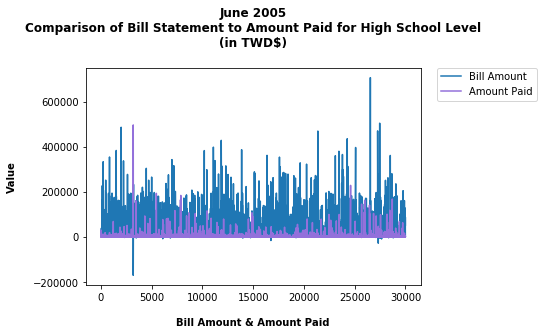

In [606]:
plt.plot(high_school.BILL_AMT4, label = 'Bill Amount')
plt.plot(high_school.PAY_AMT4, color = 'mediumpurple', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

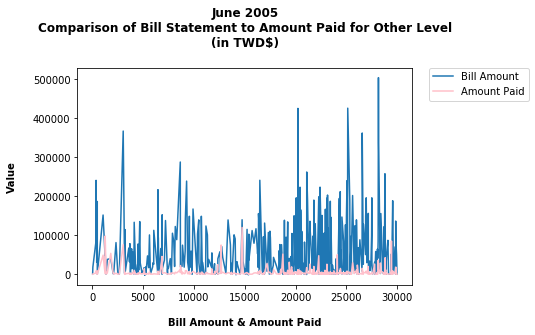

In [607]:
plt.plot(otherEL.BILL_AMT4, label = 'Bill Amount')
plt.plot(otherEL.PAY_AMT4, color = 'pink', label = 'Amount Paid')

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

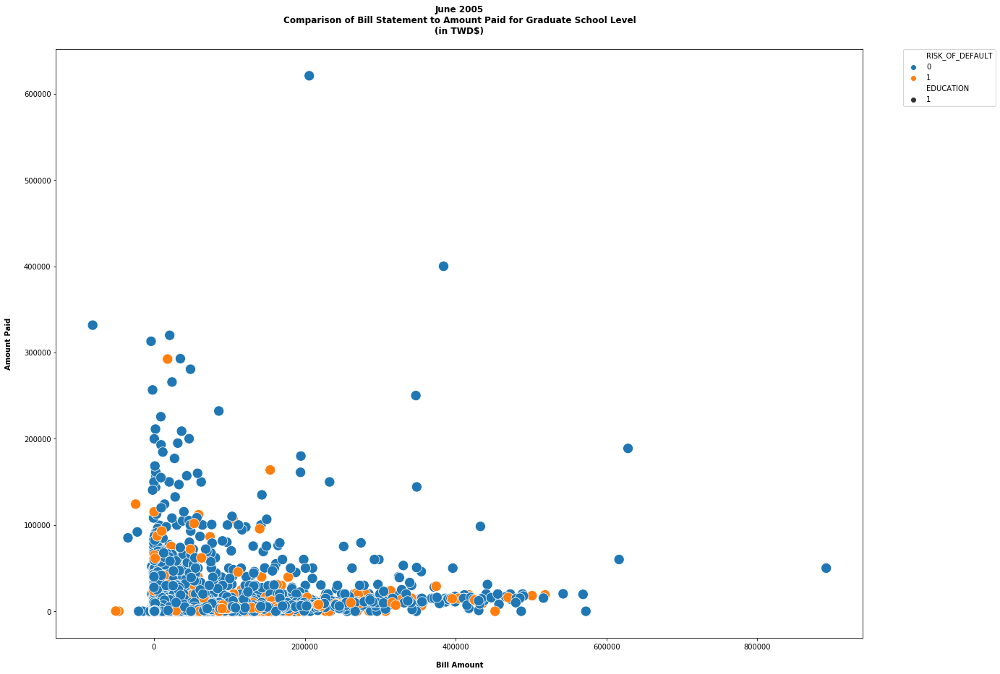

In [608]:
x = grad_school.BILL_AMT4
y = grad_school.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

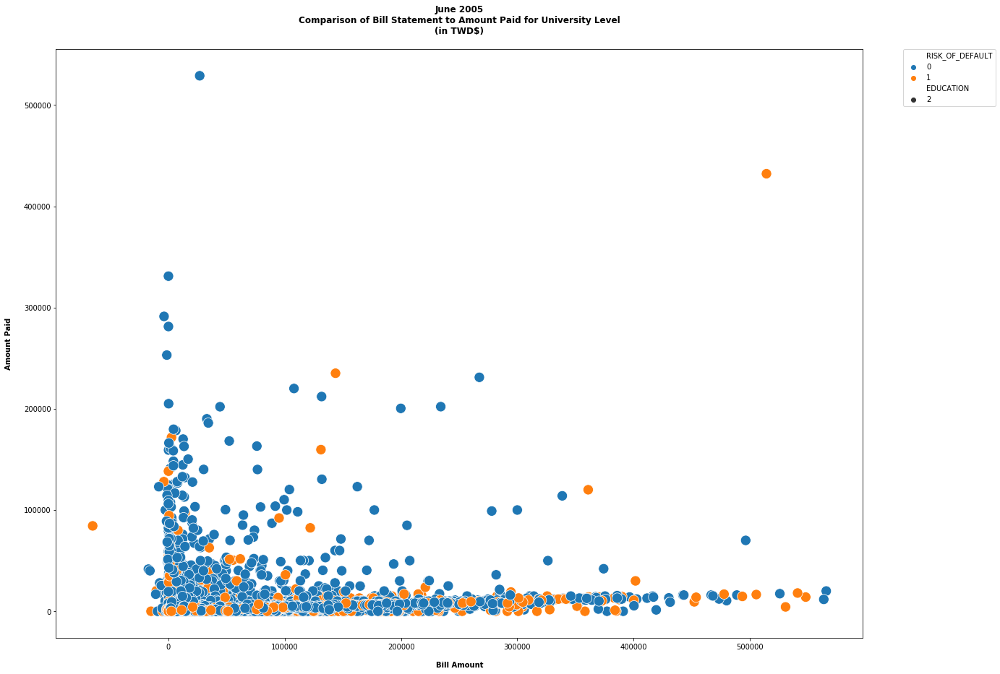

In [609]:
x = university.BILL_AMT4
y = university.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

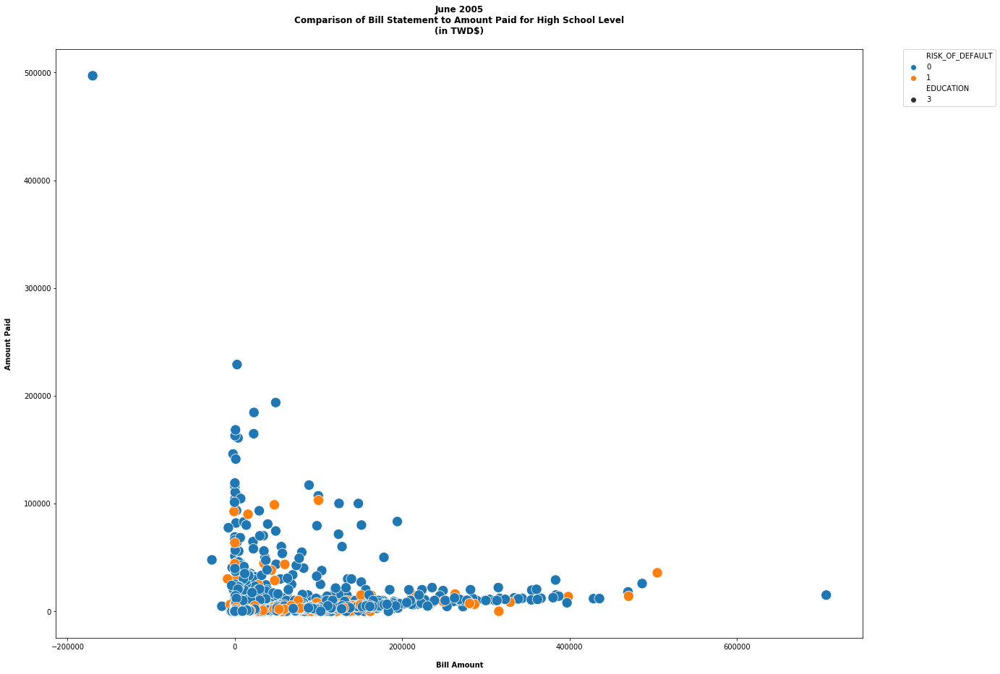

In [610]:
x = high_school.BILL_AMT4
y = high_school.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

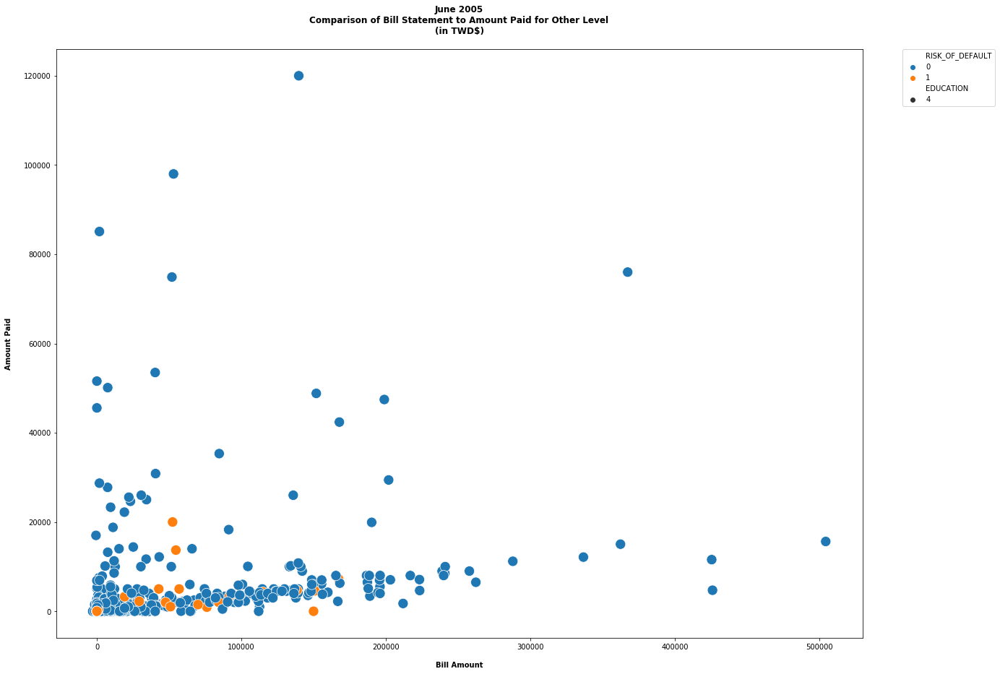

In [611]:
x = otherEL.BILL_AMT4
y = otherEL.PAY_AMT4

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('June 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## May 2005

### Line Plots

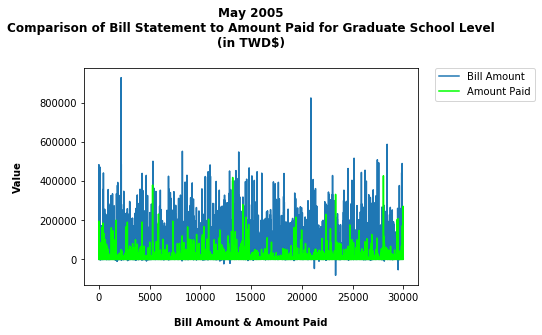

In [612]:
plt.plot(grad_school.BILL_AMT5, label = 'Bill Amount')
plt.plot(grad_school.PAY_AMT5, color = 'lime', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

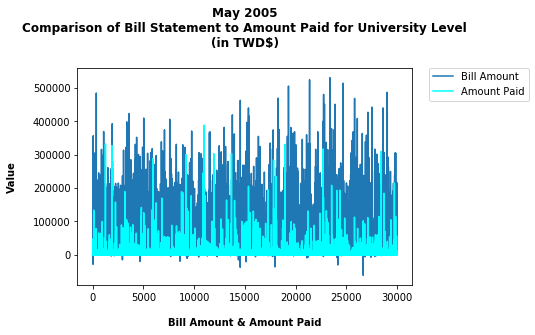

In [613]:
plt.plot(university.BILL_AMT5, label = 'Bill Amount')
plt.plot(university.PAY_AMT5, color = 'cyan', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

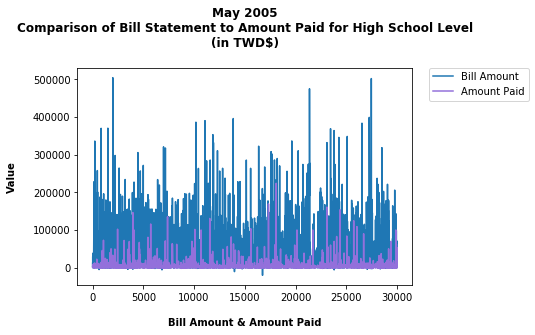

In [614]:
plt.plot(high_school.BILL_AMT5, label = 'Bill Amount')
plt.plot(high_school.PAY_AMT5, color = 'mediumpurple', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

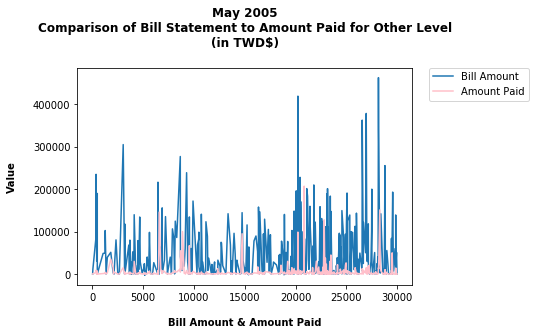

In [615]:
plt.plot(otherEL.BILL_AMT5, label = 'Bill Amount')
plt.plot(otherEL.PAY_AMT5, color = 'pink', label = 'Amount Paid')

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

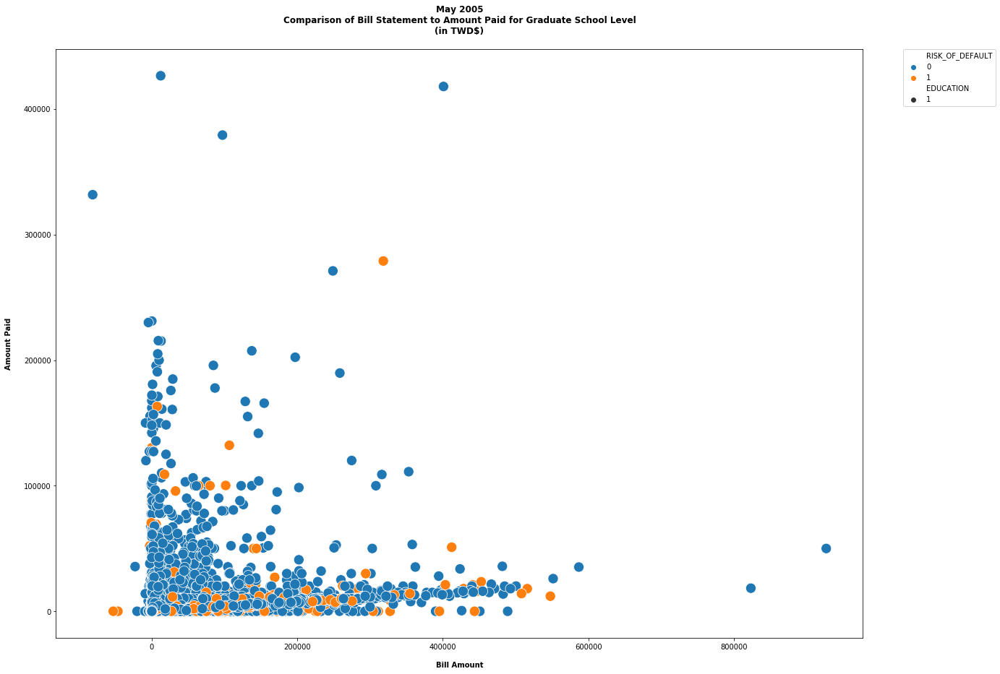

In [616]:
x = grad_school.BILL_AMT5
y = grad_school.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

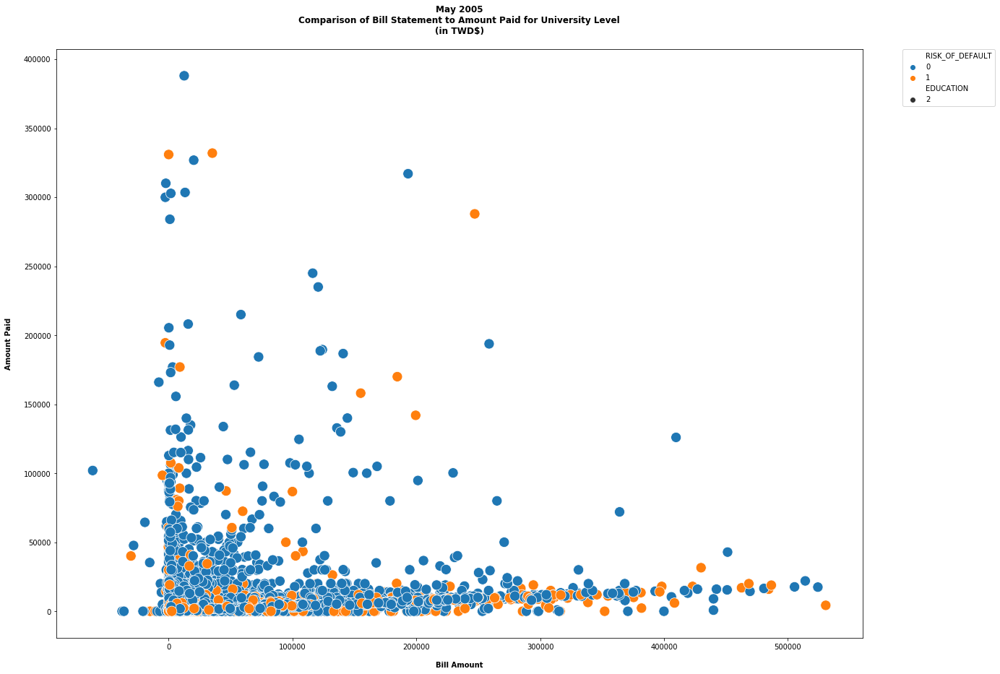

In [617]:
x = university.BILL_AMT5
y = university.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

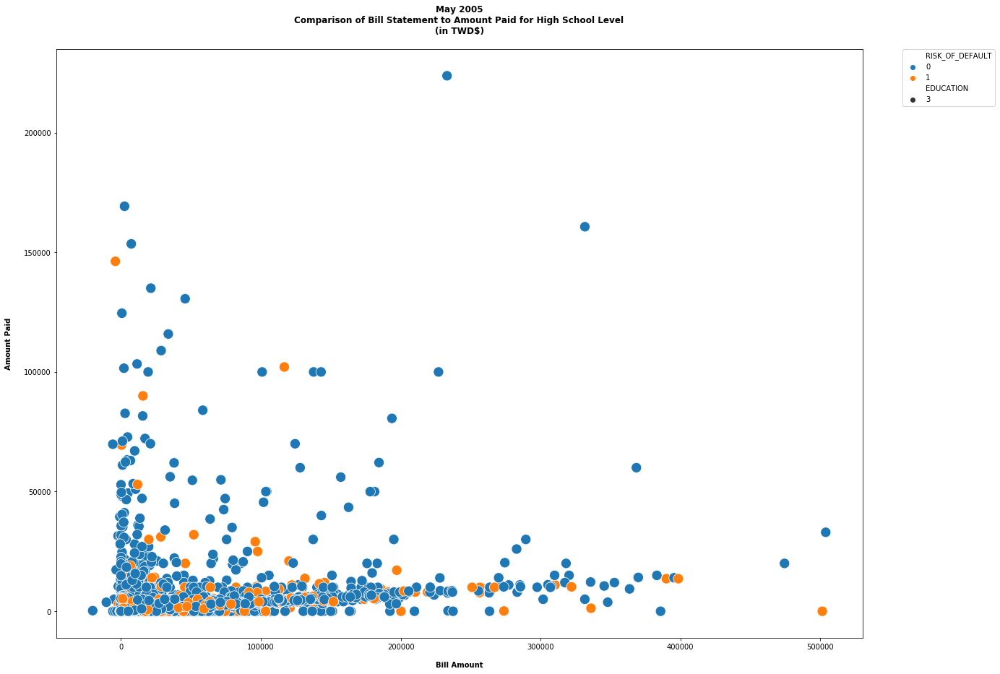

In [618]:
x = high_school.BILL_AMT5
y = high_school.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

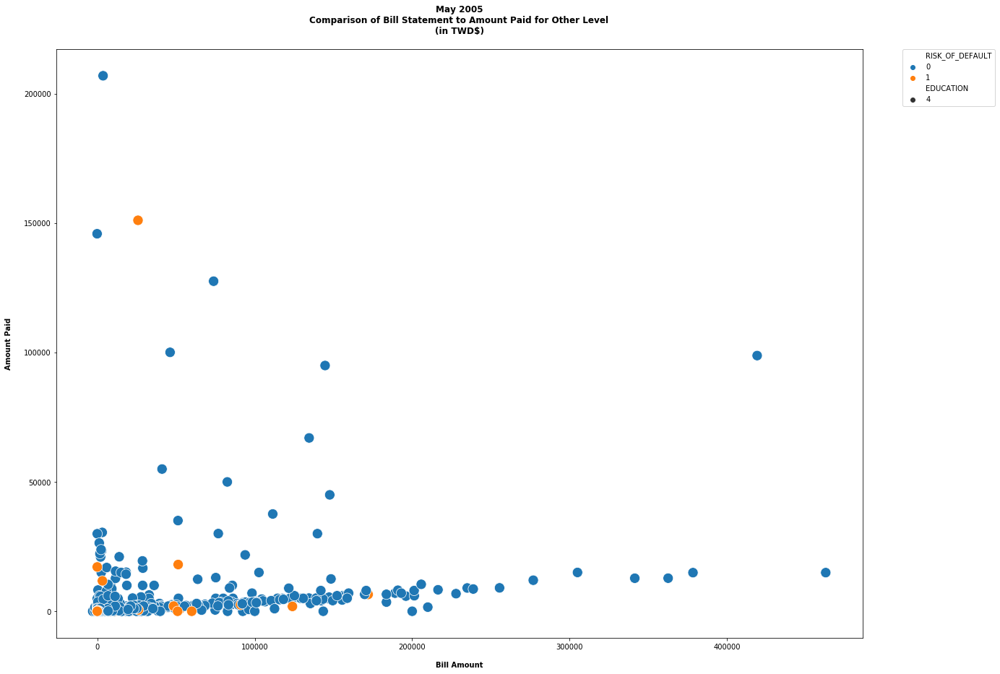

In [619]:
x = otherEL.BILL_AMT5
y = otherEL.PAY_AMT5

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('May 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

## April 2005

### Line Plots

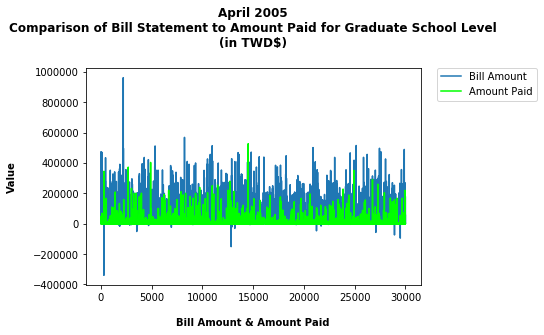

In [620]:
plt.plot(grad_school.BILL_AMT6, label = 'Bill Amount')
plt.plot(grad_school.PAY_AMT6, color = 'lime', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

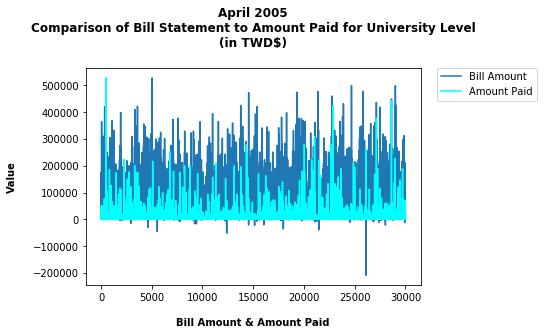

In [621]:
plt.plot(university.BILL_AMT6, label = 'Bill Amount')
plt.plot(university.PAY_AMT6, color = 'cyan', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

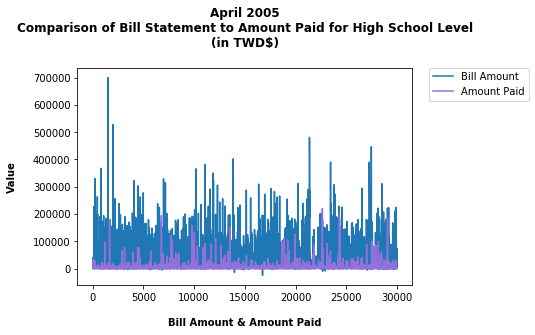

In [622]:
plt.plot(high_school.BILL_AMT6, label = 'Bill Amount')
plt.plot(high_school.PAY_AMT6, color = 'mediumpurple', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

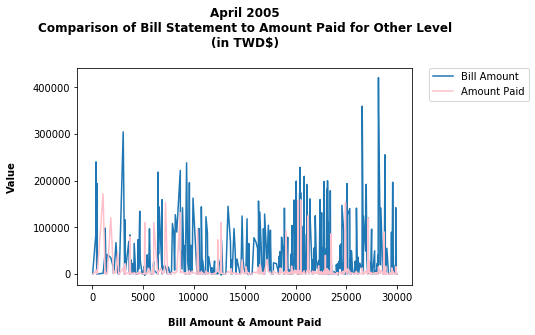

In [623]:
plt.plot(otherEL.BILL_AMT6, label = 'Bill Amount')
plt.plot(otherEL.PAY_AMT6, color = 'pink', label = 'Amount Paid')

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n', fontweight = 'bold')
plt.xlabel('\nBill Amount & Amount Paid',fontweight = 'bold')
plt.ylabel('Value\n',fontweight = 'bold')
plt.legend()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.show()

### Scatterplots

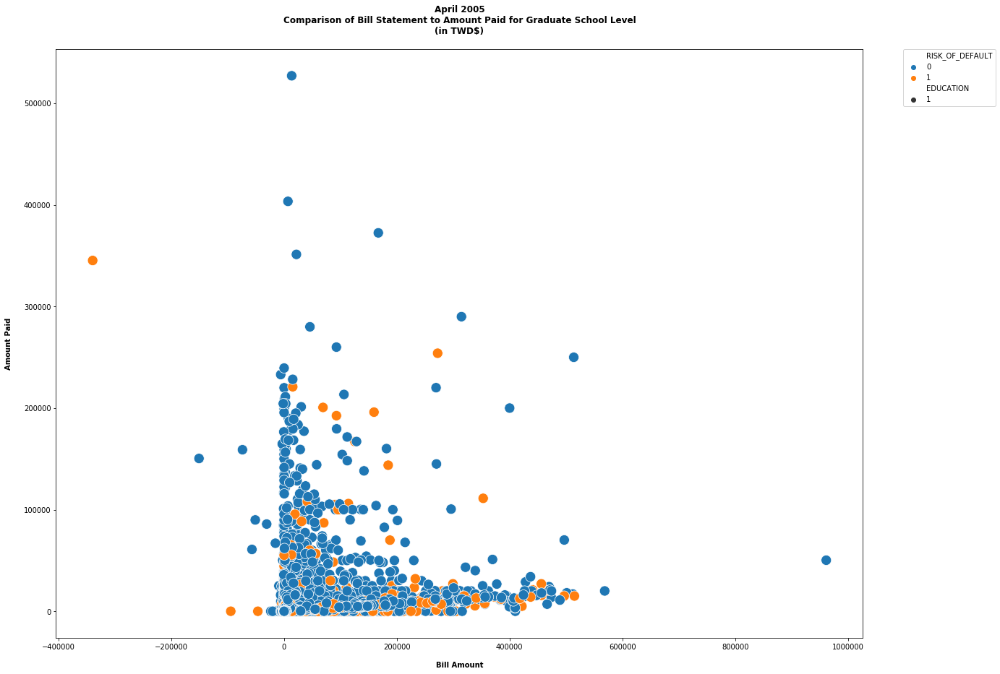

In [624]:
x = grad_school.BILL_AMT6
y = grad_school.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = grad_school)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Graduate School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

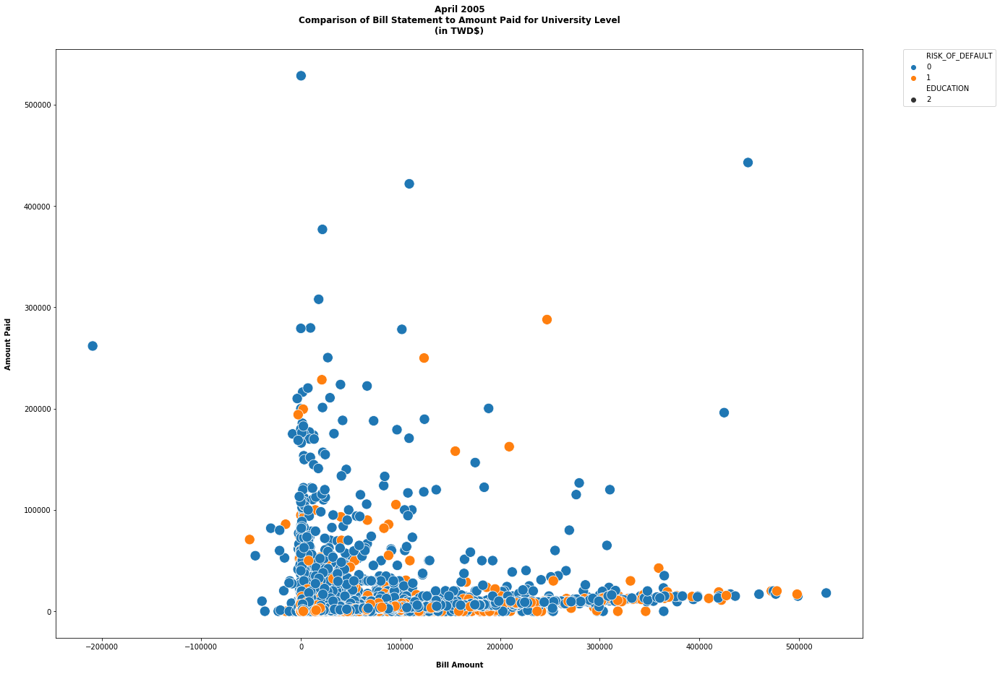

In [625]:
x = university.BILL_AMT6
y = university.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = university)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for University Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

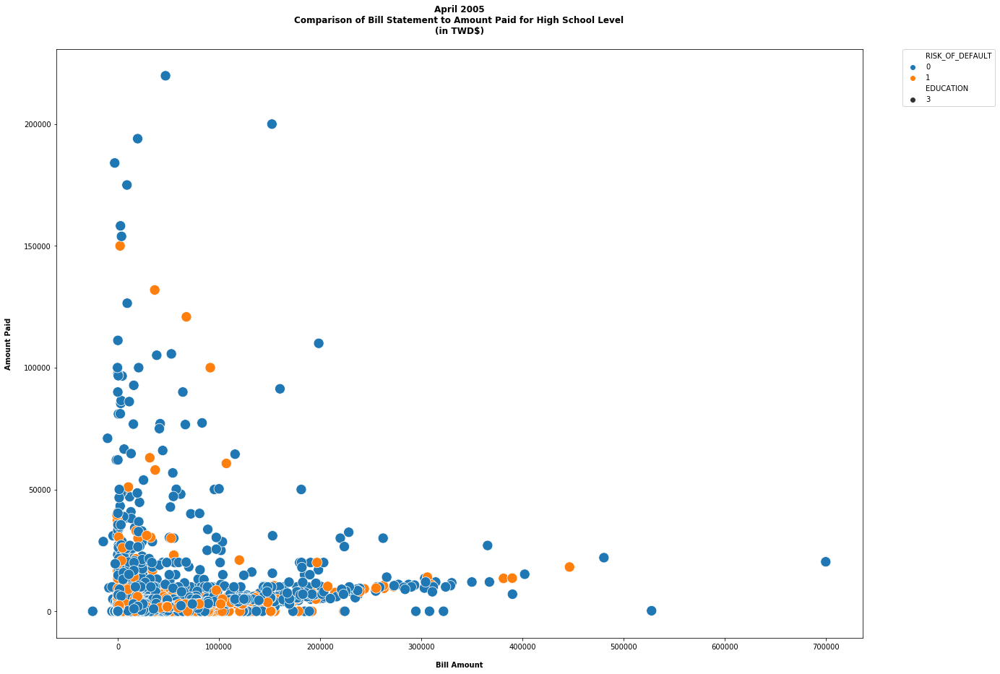

In [626]:
x = high_school.BILL_AMT6
y = high_school.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = high_school)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for High School Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()

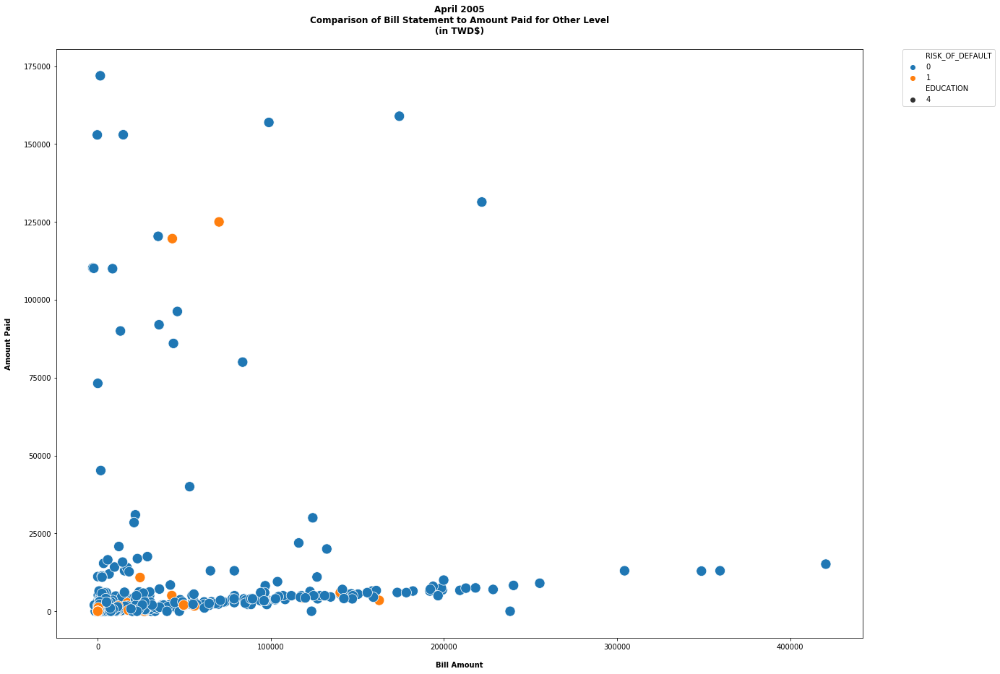

In [627]:
x = otherEL.BILL_AMT6
y = otherEL.PAY_AMT6

%matplotlib inline
plt.figure(figsize=(20,15))

sns.scatterplot(x,y, hue = 'RISK_OF_DEFAULT', style = 'EDUCATION', s = 200, data = otherEL)

plt.title('April 2005\nComparison of Bill Statement to Amount Paid for Other Level\n(in TWD$)\n',fontweight = 'bold')
plt.xlabel('\nBill Amount',fontweight = 'bold')
plt.ylabel('Amount Paid\n', fontweight = 'bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

X = plt.show()



# EDA Findings



To get a better understanding of why there is an increase in customer default rates, the team felt that it was necessary to include in this analysis a review of customer spending even though it is something that cannot be influenced.  A review of a customer’s spending habits relative to their credit limits and pay statements helped us to identify things that Credit One could impact.  The methodology used is described below.


To ascertain where the problems lied, the dataset was reviewed from five different perspectives.  First, the team looked at the dataset in its entirety or from a “global” standpoint.  Next, we broke it down into different age groups.  These groups and their associated ages are as follows:  young adults (18 to 35 yrs.), middle aged (36 to 55 yrs.), older adults (56 to 72 yrs.), and senior citizens (73+ yrs.).  The third is gender.  We broke it out between males and females.  The fourth group is marital status.  We created a subgroup for each status:  married, single, divorced, and other.  The fifth and final manner in which we reviewed the data is by education level.  We created a subset for each of the levels: graduate school, university, high school, and other.

For the global view, the team compared each month’s bill statement to the customer credit limits.  Next, by month, we compared the customers’ bill and pay statements.

For the remaining four subgroups, in addition to the things done for the global review, we also compared each groups’ bill statements by month.

By analyzing the dataset in this manner, we discovered two likely causes for the increase in default rates.  The first one concerns spending.  There are a number of customers that are spending close to their credit limits.  In fact, there are even some that seemed to have exceeded their credit limit.  The second concerns the amount that customers are paying against their bills.  Overall, there are high number of customers that do not appear to be making payments that are commensurate with their spending.  In some cases, there is a large gap between their monthly bill and payment amounts.  This gap is plainly seen in the line plots that were done by month for each group.

Lastly, a computational analysis was done in Excel to specifically calculate the customers whose spending equaled or exceeded their credit limit.

As a result of using the above methodology, we were able to ascertain that the highest number of defaults were experienced by young and middle-aged female adults with a university level education.  The Excel computations found that 4,629 of these females were single and 3,602 were married.

Without additional data regarding a customers total accumulated debt, we do not know whether or not they are spending beyond their means and cannot afford to make higher payments.  However, we are able to conclude that it appears to be likely that there are some that have issues managing their finances.  If the modeling that follows EDA proves this to be the case, perhaps one of the things that Credit One may do to mitigate the risk of customer defaults is to provide resources to customers on how to best manage their money.



# Data Issues

The team found a couple of issues with the dataset.  The biggest one by far concerns outliers.  For example, in one month the vast majority of the spending was at 600K or less.  However, there was a single data point that showed spending at around 1M.  The outliers also occurred in the form of credits on the customer bill statements.  This one issue can cause a couple of things.  First, it can throw off the mean, standard deviation, and other statistical measurements of the data.  Second, it can also completely change the results of any modeling thus yielding misleading measurements of accuracy and kappa.

The other issue is in regards to the bill and pay statement columns showing 0.

# Attributes Being Considered for Removal

1.  The rows that show 0 in any bill or pay statement column
2.  The repayment status columns.

For the first one, as with the outliers, we are concerned that the zeros may throw off the reults of the modeling

For the second one, there are several instances in these columns where the repayment status shows "paid in full" across all six periods.  However, the customer still shows as a default risk.  So, the team is questioning the validity and usefulness of these columns.

Before anything is removed, we plan to model with the full dataset.  Once this is done, we will remove the attributes and rows mentioned above then rerun the model.  We will compare the results of the two models and determine which one yields the best accuracy for the purposes of predicting customer defaults.